# **5. TDE-HMM Analysis (8 states)**

Jupyter notebook with a single run of a **TDE-HMM analysis** for the SDMT dataset using the OSL  Dynamics Toolbox from the Oxford Centre for Human Brain Activity (OHBA) Ananalysis Group.

**Reference**: Gohil C., Huang R., Roberts E., van Es M.W.J., Quinn A.J., Vidaurre D., Woolrich M.W. (2023) osl-dynamics: A toolbox for modelling fast dynamic brain activity. eLife 12:RP91949 https://doi.org/10.7554/eLife.91949.2

### **Required input files/folders to run this Notebook**:
- **DIR_parceled_raw**: folder with all fully processed .fif files (from Notebook 1. Preprocessing MEG Python) --> Needed in order to extract event timestamps
- **input_path**: The .fif files that are used as input for the TDE-HMM data preparation. These files are renamed + had all STIM channels removed.
- **subjectinfo.mat**: file with all clinical patient information 
- **all_epochs_paths**: folder containg all MNE epoch objects where the stimulus onset is seen as the DIODE signal
- **mask_file**: "MNI152_T1_8mm_brain_nii.gz" is the brain mask used to plot the spatial power
- **Parcels_38_names.txt**: .txt file with the names of the 38 parcels of the parcellation file
- **parcellation file**: "fmri_d100_parcellation_with_PCC_reduced_2mm_ss5mm_ds8mm.nii.gz" **with 38 parcels** needs to be 4D (3 dimensions for spatial coordinates and 1 for each parcel) with sform_code = 1

#### Import statements

In [1]:
## work in a virtual environment with pre-installed osl_dynamics

# import useful libraries 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
import seaborn as sns
from scipy.io import loadmat
import tensorflow
import glob
import mne
import pickle
import os

import glmtools as glm
import glmtools.design as glm_

# import osl dynamics functions
import osl_dynamics
from osl_dynamics.data import Data
from osl_dynamics.models.hmm import Config
from osl_dynamics.models.hmm import Model
from osl_dynamics import simulation
from osl_dynamics.utils import plotting
from osl_dynamics.models import load
from osl_dynamics.inference import modes
from osl_dynamics.data import task
from osl_dynamics.analysis import spectral
from osl_dynamics.analysis import power
from osl_dynamics.analysis import connectivity
from osl_dynamics.analysis import statistics

/home/olivierb/.local/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


#### <font color='red'> **Input variables !**

In [2]:
remove_STIM_chans = False   
model_training = True      # False if you have already trained a model, and you want to load it in
n_states = 8
model_name = "Dynamic_Models/HMM_TDE_ALL_8states_25epochs"

### Load in data for all subjects - **Orthogonalized & Sign-Flipped**

In [3]:
DIR_parceled_raw = "/home/olivierb/FULLY_PROCESSED/processed_WITH_orth_WITH_sf/"
all_parceled_raw = sorted(glob.glob(DIR_parceled_raw + '*.fif'))

wanted_sub_IDs = [subject[-12:-8] for subject in all_parceled_raw]

### Remove subjects that should be excluded

In [4]:
## Subjects indices to remove 
# The subjects excluded in the post-processing analyses relate to prior findings by: Master student Sarah Dierickx (2023), PhD student Fahimeh Akbarian from AIMS VUB. 
# As well as additional findings throughout this Thesis (Olivier Burta, 2024):
# - missing DIODE channel (in the event extraction step)
# - missing BUTTON press response channels
# - flat PSD-spectrum
subjects_to_exclude = [0, 5, 38, 41, 49, 62, 68, 83, 84, 106, 107, 114, 119,   # subjects with missing DIODE channel OR having less DIODE events than the amount of trials  
                       30]                                                     # subjects with completely flat PSD spectrum
all_data = []

# List of file-paths for remaining subjects
for idx in range(len(all_parceled_raw)):
    if idx not in subjects_to_exclude:
        all_data.append(all_parceled_raw[idx])

# List of subjects IDs for remaining subjects
subject_IDs_group_analysis = []
for idx in range(len(wanted_sub_IDs)):
    if idx not in subjects_to_exclude:
        subject_IDs_group_analysis.append(wanted_sub_IDs[idx])
        
print(len(subject_IDs_group_analysis))

110


### Remove STIM channels and save all files in ./Input_files_HMM/final/

#### Only **run once** for a **new dataset**

Why are we doing this? Because all input files need to only contain the signal channels

In [5]:
if remove_STIM_chans:
    
    for i in range(len(all_data)):

        raw = mne.io.read_raw_fif(all_data[i], verbose=False)
        code = all_data[i][-12:-8]

        # Identify stimulus channels
        stim_channels = [ch for ch in raw.ch_names if ch.startswith('STI')]

        # Exclude stimulus channels
        raw_without_stim = raw.copy().drop_channels(stim_channels)

        # Save the modified raw data (without STIM channels)
        raw_without_stim.save('/home/olivierb/Input_files_HMM/final/sub_' + code + '_raw.fif', overwrite=True)

### **Data as input to HMM**: input_path variable

In [6]:
input_path = "/home/olivierb/Input_files_HMM/final/"
input_data_HMM = sorted(glob.glob(input_path + 'sub_*_raw.fif'))
print(len(input_data_HMM))

110


# TDE data preparation

### **Convert input data using Data() function**

In [7]:
from osl_dynamics.data import Data

training_data = Data(input_data_HMM)   # all subjects!

Loading files: 100%|██████████| 110/110 [01:56<00:00,  1.06s/it]


### **Data preparation before HMM inference**

In [8]:
methods = {
    "tde_pca": {"n_embeddings": 15, "n_pca_components": 80},
    "standardize": {},
    
}
training_data.prepare(methods)

Calculating PCA components: 100%|██████████| 110/110 [01:22<00:00,  1.33it/s]
2024-05-05 14:58:28 INFO osl-dynamics [base.py:650:tde_pca]: Explained variance: 57.1%
Standardize: 100%|██████████| 110/110 [00:12<00:00,  9.12it/s]


### **Config object**

The **important hyperparameters** to specify are:

* **n_states**, the number of states. must be pre-specified. We advise starting with something **between 6-14**.

* **sequence_length and batch_size**. Determines the amount of bathces and window length for model parameter updates during training.

* **learn_means and learn_covariances**. Typically, if we train on **AE data** we set learn_means and learn_covariances to **True**, whereas if you’re training on **TDE/PCA data**, then we only learn the covariances, i.e. we set **learn_means=False**.

* **learning_rate**. On large datasets, we find a lower learning rate leads to a lower final loss. We recommend a value **between 1e-2 and 1e-4**.

* **n_epochs**, the number of epochs. This is the number of times you loop through the data.

In [14]:
from osl_dynamics.models.hmm import Config

# Create a config object
config = Config(
    n_states=n_states,
    n_channels=training_data.n_channels,
    sequence_length=2000,
    learn_means=False,
    learn_covariances=True,
    batch_size=64,                                 
    learning_rate=5e-4,
    n_epochs=200,                                     
)

## **Building/Initialising/Training** the model

In [15]:
%%time
from osl_dynamics.models.hmm import Model
from osl_dynamics.models import load

## Only do all of this if a model needs to be trained
if model_training:
    # Build a Model class and print a summary
    model = Model(config)
    model.summary()

    # Initialise the training --> Helpfulf to start the full training with a good initialisation
    init_history = model.random_state_time_course_initialization(training_data, n_epochs=1, n_init=3)

    # Train the model
    history = model.fit(training_data)
    
    # Save trained model
    model.save(model_name)

## If model exists already, load it instead
else:
    model = load(model_name)

Model: "HMM"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 inputs (InputLayer)            [(None, 2000, 88)]   0           []                               
                                                                                                  
 tf.split_2 (TFOpLambda)        [(None, 2000, 80),   0           ['inputs[0][0]']                 
                                 (None, 2000, 8)]                                                 
                                                                                                  
 static_loss_scaling_factor (St  ()                  0           ['tf.split_2[0][0]']             
 aticLossScalingFactorLayer)                                                                      
                                                                                                

2024-05-05 18:51:42 INFO osl-dynamics [hmm.py:422:random_state_time_course_initialization]: Random state time course initialization
2024-05-05 18:51:44 INFO osl-dynamics [hmm.py:435:random_state_time_course_initialization]: Using 153 out of 153 batches
2024-05-05 18:51:44 INFO osl-dynamics [hmm.py:440:random_state_time_course_initialization]: Initialization 0
2024-05-05 18:51:47 INFO osl-dynamics [hmm.py:1013:set_random_state_time_course_initialization]: Setting random means and covariances


Epoch 1/1
153/153 [==============================] - 1487s 9s/step - rho: 0.2853 - lr: 0.0050 - loss: 218661.4405


2024-05-05 19:17:59 INFO osl-dynamics [hmm.py:440:random_state_time_course_initialization]: Initialization 1
2024-05-05 19:18:01 INFO osl-dynamics [hmm.py:1013:set_random_state_time_course_initialization]: Setting random means and covariances


Epoch 1/1
153/153 [==============================] - 1493s 9s/step - rho: 0.2853 - lr: 0.0050 - loss: 218762.1629


2024-05-05 19:44:21 INFO osl-dynamics [hmm.py:440:random_state_time_course_initialization]: Initialization 2
2024-05-05 19:44:23 INFO osl-dynamics [hmm.py:1013:set_random_state_time_course_initialization]: Setting random means and covariances


Epoch 1/1
153/153 [==============================] - 1527s 10s/step - rho: 0.2853 - lr: 0.0050 - loss: 218690.0907


2024-05-05 20:11:16 INFO osl-dynamics [hmm.py:463:random_state_time_course_initialization]: Using initialization 0


Epoch 1/25
153/153 [==============================] - 1511s 10s/step - rho: 0.2853 - lr: 0.0050 - loss: 201401.6668
Epoch 2/25
153/153 [==============================] - 1493s 9s/step - rho: 0.1995 - lr: 0.0045 - loss: 190650.1733
Epoch 3/25
153/153 [==============================] - 1467s 9s/step - rho: 0.1577 - lr: 0.0041 - loss: 185839.5632
Epoch 4/25
153/153 [==============================] - 1455s 9s/step - rho: 0.1322 - lr: 0.0037 - loss: 183646.6767
Epoch 5/25
153/153 [==============================] - 1450s 9s/step - rho: 0.1149 - lr: 0.0034 - loss: 181541.2846
Epoch 6/25
153/153 [==============================] - 1448s 9s/step - rho: 0.1022 - lr: 0.0030 - loss: 179894.8749
Epoch 7/25
153/153 [==============================] - 1410s 9s/step - rho: 0.0925 - lr: 0.0027 - loss: 178842.8936
Epoch 8/25
153/153 [==============================] - 1398s 9s/step - rho: 0.0847 - lr: 0.0025 - loss: 177616.1826
Epoch 9/25
153/153 [==============================] - 1442s 9s/step - rho: 0.07

### Extract **alpha** - alpha contains the raw hidden state time courses across the entire concatenated MEG data

In [16]:
alpha = model.get_alpha(training_data)
#alpha = pickle.load(open(model_name + "/data/alpha.pkl","rb"))

Getting alpha: 100%|██████████| 110/110 [04:09<00:00,  2.27s/it]


In [17]:
## Save extracted alpha inside the folder path
# Save the python lists as a pickle files -> can be inside the folder of the saved model !!

os.makedirs(model_name + "/data", exist_ok=True)
pickle.dump(alpha, open(model_name + "/data/alpha.pkl", "wb"))

# **0. Verify alpha timecourse (of FLAT state)**

This extra section served to investigate why one of the extracted states showed a flat ERF activation, close to 0 spatial power, and abnormal coherence spectra.

In [ ]:
idx_state_flat = 2 # State 3
idx_state_good = 5

fig,ax = plt.subplots(nrows=np.shape(alpha)[0], ncols=2, figsize=(9,4*np.shape(alpha)[0]))

# loop over all subjects
for subject in range(np.shape(alpha)[0]):
    ax[subject,0].plot(alpha[subject][:,idx_state_flat])
    ax[subject,1].plot(alpha[subject][:,idx_state_good])
plt.show()

In [16]:
all_flat = []
all_good = []

#for subject in range(np.shape(alpha)[0]):
for subject in range(20):
    all_flat.append(alpha[subject][:,idx_state_flat])
    all_good.append(alpha[subject][:,idx_state_good])

out_flat = np.concatenate(all_flat).ravel().tolist()
out_good = np.concatenate(all_good).ravel().tolist()

Text(0.5, 1.0, 'State 6')

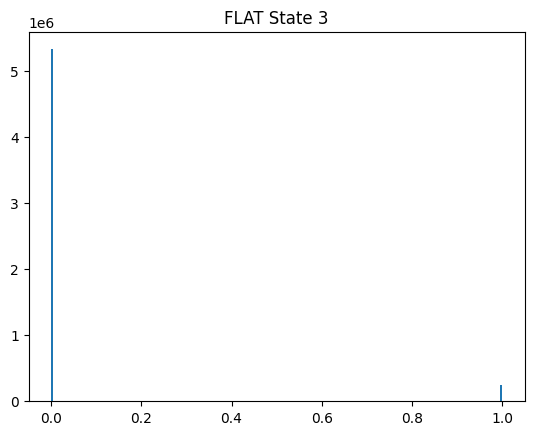

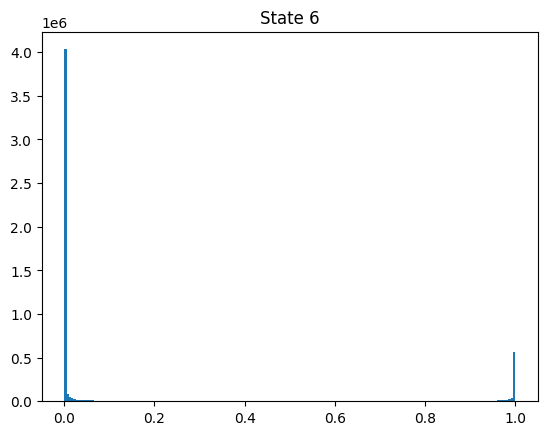

In [17]:
plt.hist(out_flat, bins=200)
plt.title('FLAT State 3')
plt.figure()
plt.hist(out_good, bins=200)
plt.title('State 6')

### **Extract the timepoints where state probability = 1**

(298000,)


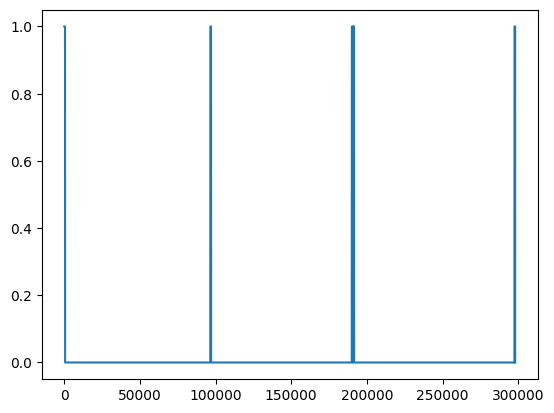

In [18]:
stc = modes.argmax_time_courses(alpha)

stc_single = stc[0][:,idx_state_flat] # 1st subject

print(np.shape(stc_single))

plt.plot(stc_single)

### **Extract timepoints of annotated bad signal quality**

Opening raw data file /home/olivierb/Input_files_HMM/final/sub_0925_raw.fif...
    Range : 26250 ... 325749 =    105.000 ...  1302.996 secs
Ready.
<Info | 11 non-empty values
 bads: []
 ch_names: parcel_0, parcel_1, parcel_2, parcel_3, parcel_4, parcel_5, ...
 chs: 38 misc
 custom_ref_applied: False
 description: Vectorview system OSL BATCH PROCESSING APPLIED ON 06/11/2023 ...
 dig: 0 items
 file_id: 4 items (dict)
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2015-04-21 09:25:17 UTC
 meas_id: 4 items (dict)
 nchan: 38
 projs: []
 sfreq: 250.0 Hz
>
Timepoints with 'bad_segment_mag' annotation: [0.0, 1189.995972, 1193.995972]
Timepoints with 'bad_segment_grad' annotation: [385.996002, 759.995972, 763.995972]
3
3


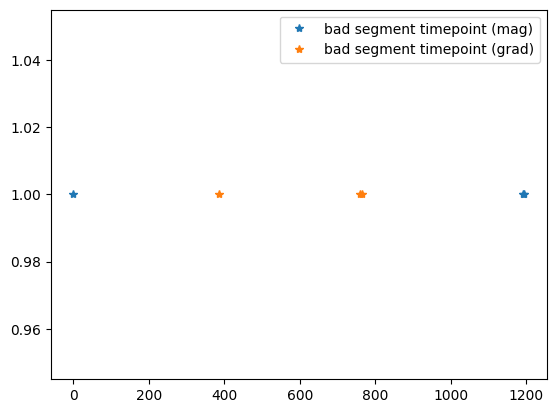

In [44]:
loaded = mne.io.read_raw_fif(input_data_HMM[0])
print(loaded.info)

# Get annotations
annotations = loaded.annotations

# Find timepoints with 'bad_segment_mag' or 'bad_segment_grad' annotations
bad_segment_mag_idx = [i for i, description in enumerate(annotations.description) if 'bad_segment_mag' in description]
bad_segment_grad_idx = [i for i, description in enumerate(annotations.description) if 'bad_segment_grad' in description]

# Get timepoints corresponding to the indices
bad_segment_mag_timepoints = annotations.onset[bad_segment_mag_idx]
bad_segment_grad_timepoints = annotations.onset[bad_segment_grad_idx]

bad_segment_mag_timepoints = [timepoint - loaded.first_samp/250.0 for timepoint in bad_segment_mag_timepoints]
bad_segment_grad_timepoints = [timepoint - loaded.first_samp/250.0 for timepoint in bad_segment_grad_timepoints]

print("Timepoints with 'bad_segment_mag' annotation:", bad_segment_mag_timepoints)
print("Timepoints with 'bad_segment_grad' annotation:", bad_segment_grad_timepoints)

print(len(bad_segment_mag_timepoints))
print(len(bad_segment_grad_timepoints))

plt.plot(bad_segment_mag_timepoints, np.ones_like(bad_segment_mag_timepoints),'*', label='bad segment timepoint (mag)')
plt.plot(bad_segment_grad_timepoints, np.ones_like(bad_segment_grad_timepoints),'*', label='bad segment timepoint (grad)')
plt.legend()

### **Now for all subjects**

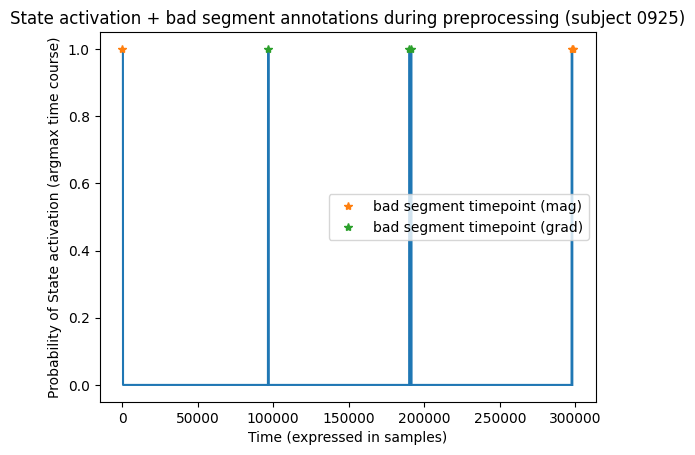

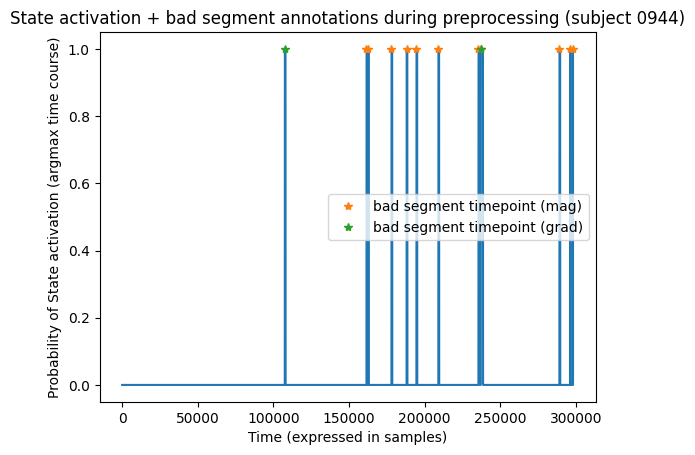

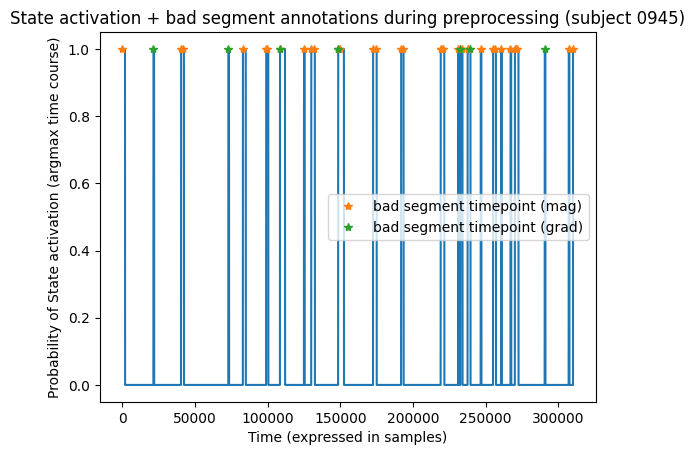

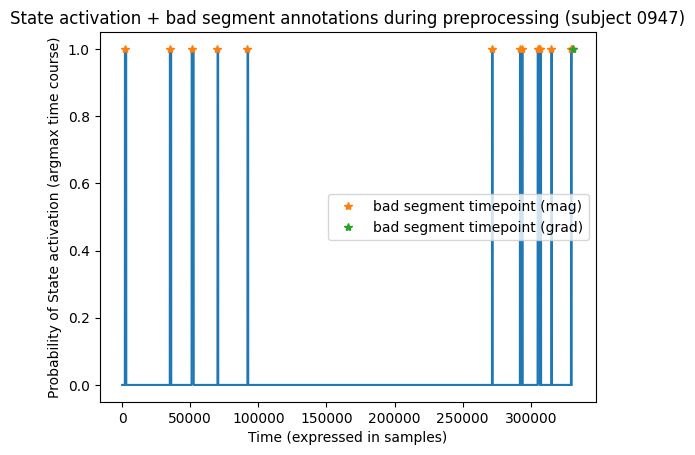

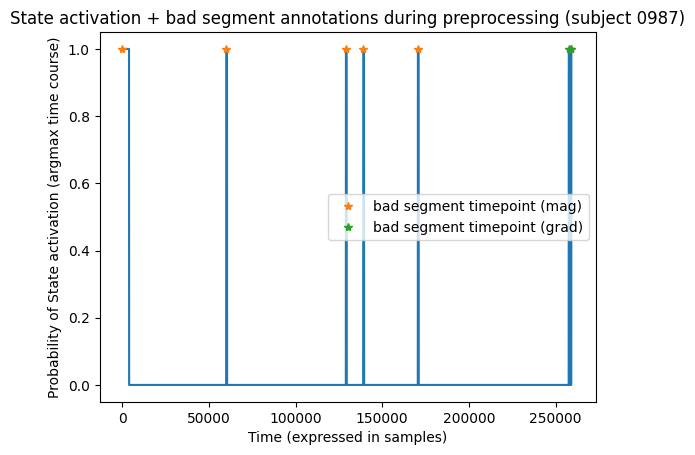

...

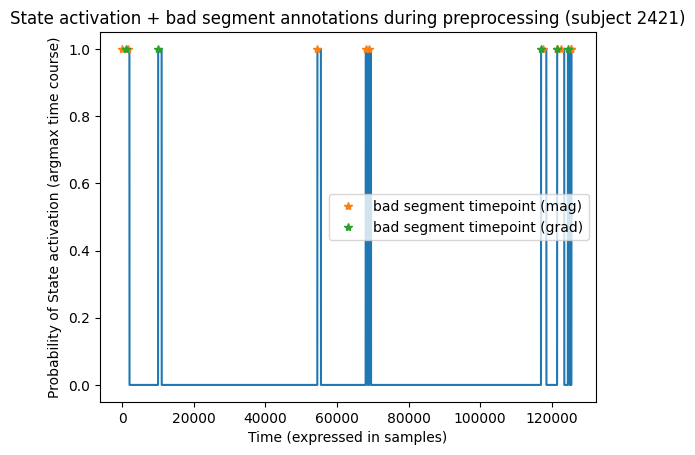

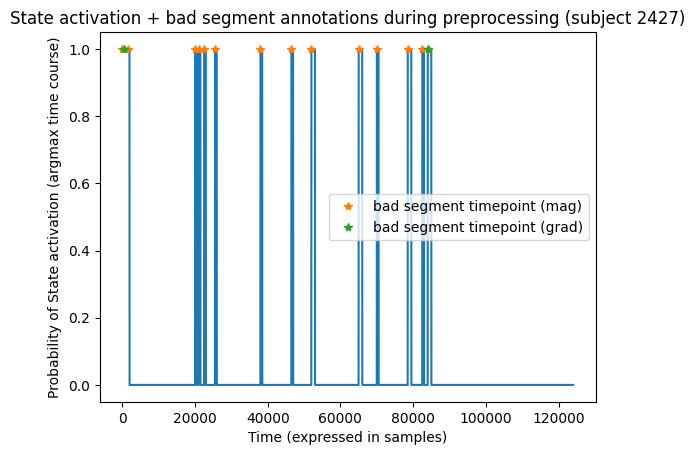

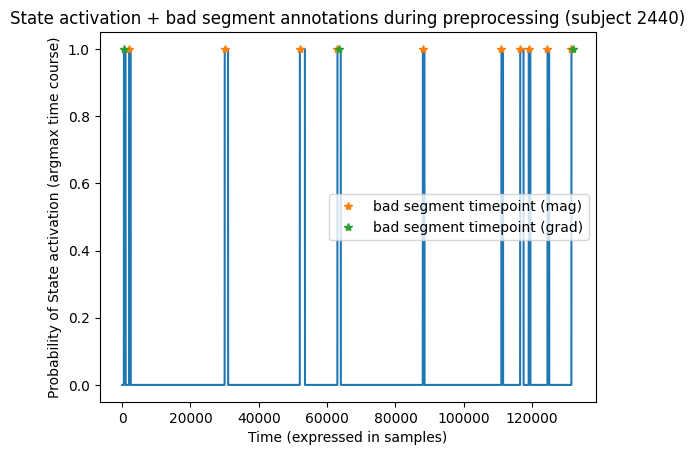

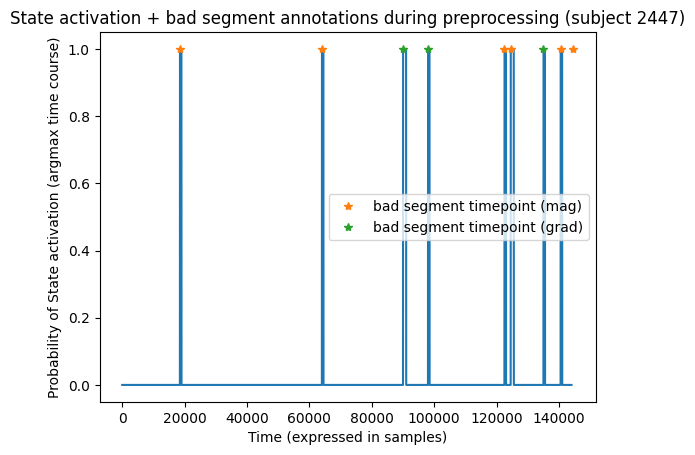

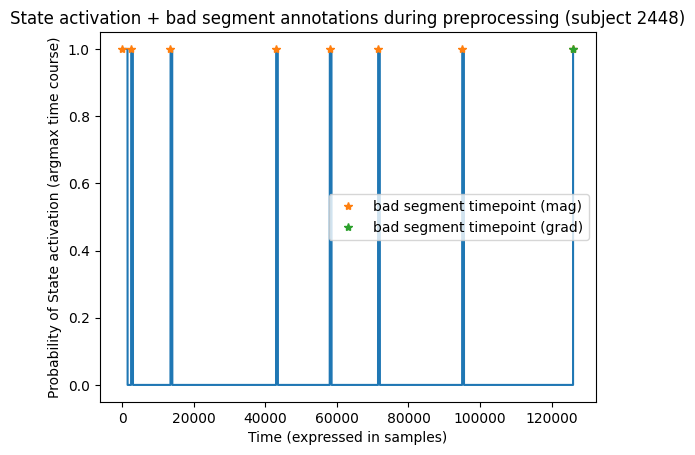

In [54]:
for subject in range(np.shape(alpha)[0]):

    stc_single = stc[subject][:,idx_state_flat]
    
    plt.figure()
    plt.plot(stc_single)

    loaded = mne.io.read_raw_fif(input_data_HMM[subject], verbose=False)

    # Get annotations
    annotations = loaded.annotations

    # Find timepoints with 'bad_segment_mag' or 'bad_segment_grad' annotations
    bad_segment_mag_idx = [i for i, description in enumerate(annotations.description) if 'bad_segment_mag' in description]
    bad_segment_grad_idx = [i for i, description in enumerate(annotations.description) if 'bad_segment_grad' in description]

    # Get timepoints corresponding to the indices
    bad_segment_mag_timepoints = annotations.onset[bad_segment_mag_idx]
    bad_segment_grad_timepoints = annotations.onset[bad_segment_grad_idx]
    
    bad_segment_mag_timepoints = [(timepoint - loaded.first_samp/250.0)*250.0 for timepoint in bad_segment_mag_timepoints]
    bad_segment_grad_timepoints = [(timepoint - loaded.first_samp/250.0)*250.0 for timepoint in bad_segment_grad_timepoints]

    #print("Timepoints with 'bad_segment_mag' annotation:", bad_segment_mag_timepoints)
    #print("Timepoints with 'bad_segment_grad' annotation:", bad_segment_grad_timepoints)

    #print(len(bad_segment_mag_timepoints))
    #print(len(bad_segment_grad_timepoints))

    plt.plot(bad_segment_mag_timepoints, np.ones_like(bad_segment_mag_timepoints),'*', label='bad segment timepoint (mag)')
    plt.plot(bad_segment_grad_timepoints, np.ones_like(bad_segment_grad_timepoints),'*', label='bad segment timepoint (grad)')
    plt.legend()
    plt.title(f'State activation + bad segment annotations during preprocessing (subject {subject_IDs_group_analysis[subject]})')
    plt.xlabel('Time (expressed in samples)')
    plt.ylabel('Probability of State activation (argmax time course)')
    plt.show()

### **Let's also plot a time-window before & after the start of a few "bad segment" instances**

33
7


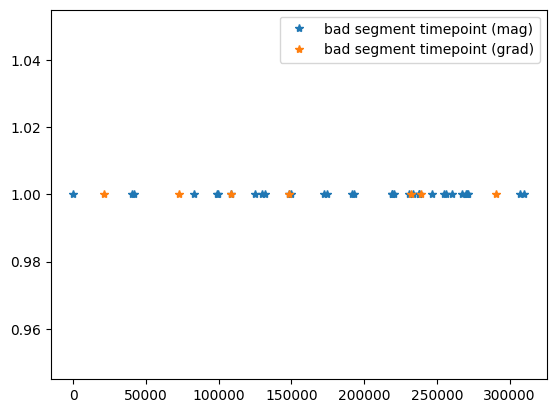

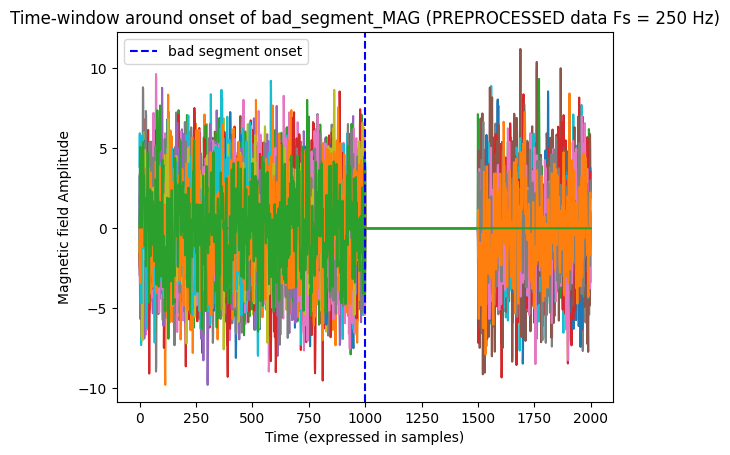

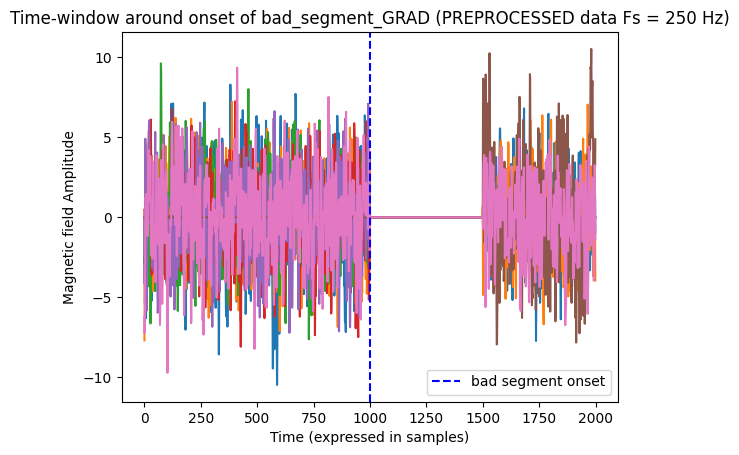

In [99]:
# ex. subject 3

loaded = mne.io.read_raw_fif(input_data_HMM[2], verbose=False)

# Get annotations
annotations = loaded.annotations

# Find timepoints with 'bad_segment_mag' or 'bad_segment_grad' annotations
bad_segment_mag_idx = [i for i, description in enumerate(annotations.description) if 'bad_segment_mag' in description]
bad_segment_grad_idx = [i for i, description in enumerate(annotations.description) if 'bad_segment_grad' in description]

# Get timepoints corresponding to the indices
bad_segment_mag_timepoints = annotations.onset[bad_segment_mag_idx]
bad_segment_grad_timepoints = annotations.onset[bad_segment_grad_idx]

bad_segment_mag_timepoints = [(timepoint - loaded.first_samp/250.0)*250 for timepoint in bad_segment_mag_timepoints]
bad_segment_grad_timepoints = [(timepoint - loaded.first_samp/250.0)*250 for timepoint in bad_segment_grad_timepoints]

#print("Timepoints with 'bad_segment_mag' annotation:", bad_segment_mag_timepoints)
#print("Timepoints with 'bad_segment_grad' annotation:", bad_segment_grad_timepoints)

print(len(bad_segment_mag_timepoints))
print(len(bad_segment_grad_timepoints))

plt.plot(bad_segment_mag_timepoints, np.ones_like(bad_segment_mag_timepoints),'*', label='bad segment timepoint (mag)')
plt.plot(bad_segment_grad_timepoints, np.ones_like(bad_segment_grad_timepoints),'*', label='bad segment timepoint (grad)')
plt.legend()

toplot_MEG = loaded.get_data()
plt.figure()
for segment in range(len(bad_segment_mag_timepoints)):
    plt.plot(toplot_MEG[5][int(bad_segment_mag_timepoints[segment] - 1000):int(bad_segment_mag_timepoints[segment]+1000)])
plt.axvline(x = 1000, color = 'b', linestyle='dashed', label='bad segment onset')
plt.xlabel('Time (expressed in samples)')
plt.ylabel('Magnetic field Amplitude')
plt.title('Time-window around onset of bad_segment_MAG (PREPROCESSED data Fs = 250 Hz)')
plt.legend()
    
plt.figure()
for segment in range(len(bad_segment_grad_timepoints)):
    plt.plot(toplot_MEG[5][int(bad_segment_grad_timepoints[segment] - 1000):int(bad_segment_grad_timepoints[segment]+1000)])
plt.axvline(x = 1000, color = 'b', linestyle='dashed', label='bad segment onset')
plt.xlabel('Time (expressed in samples)')
plt.ylabel('Magnetic field Amplitude')
plt.title('Time-window around onset of bad_segment_GRAD (PREPROCESSED data Fs = 250 Hz)')
plt.legend()

### **Check the data that was preprocessed, but not parceled**

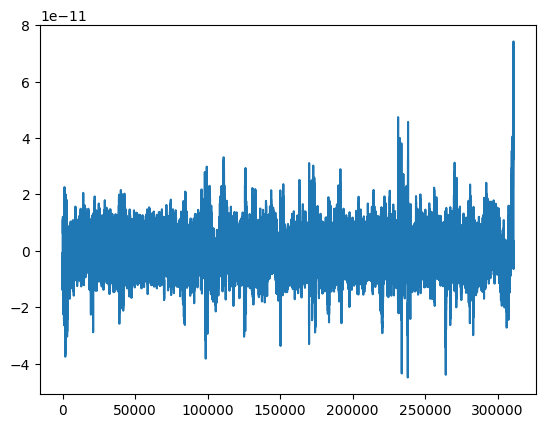

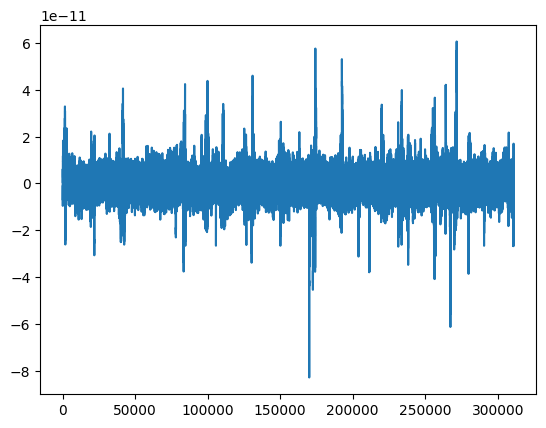

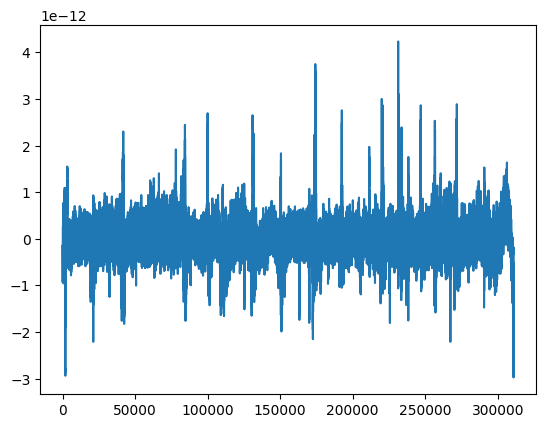

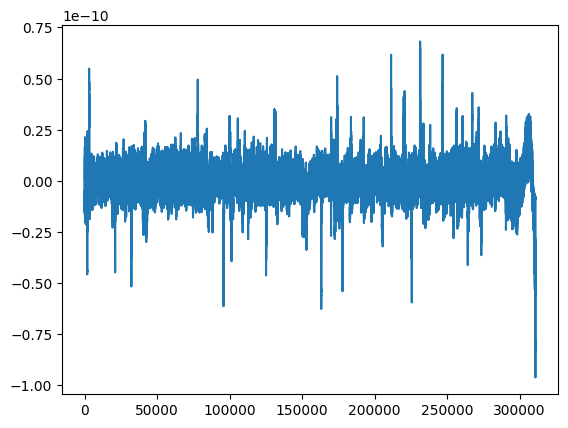

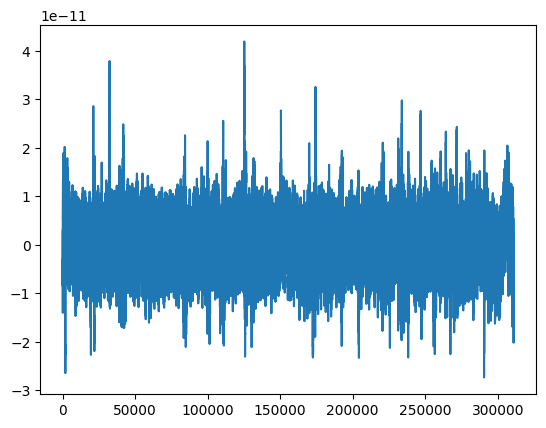

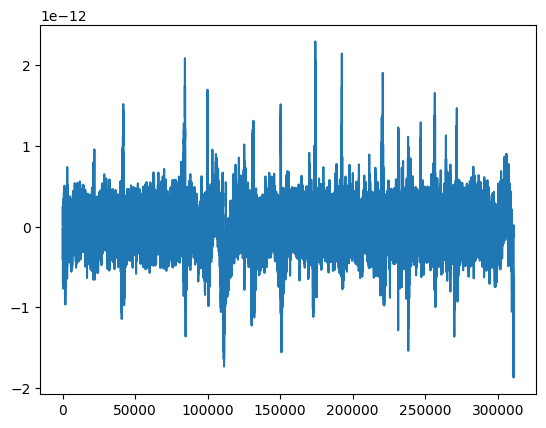

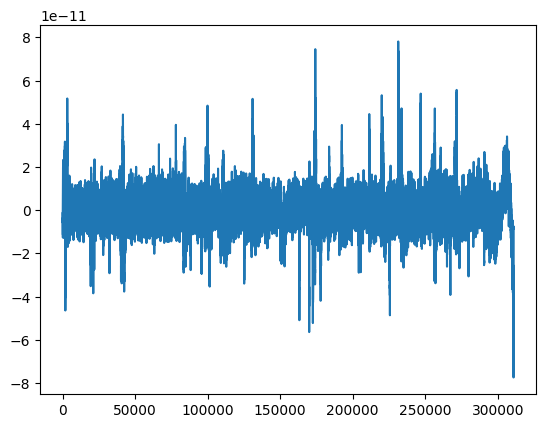

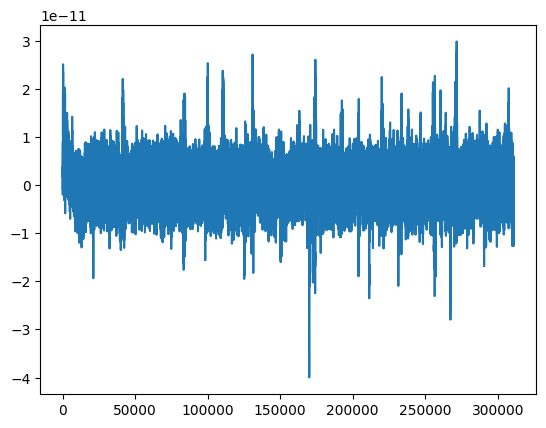

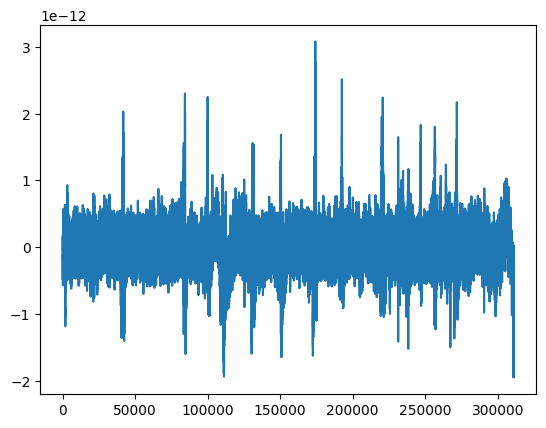

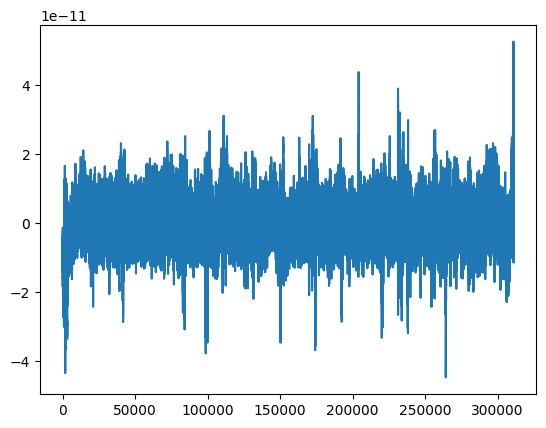

In [110]:
for i in range(10):
    plt.figure()
    plt.plot(preproc_MEG[i])
    plt.show()

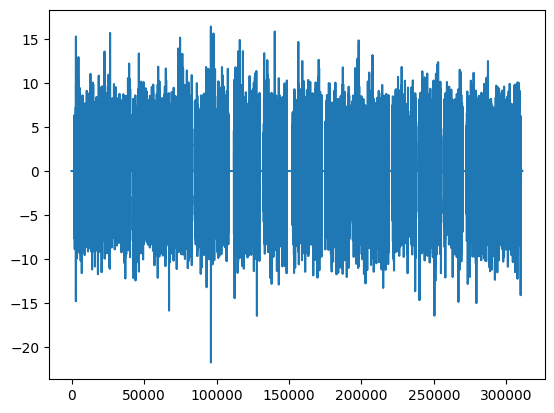

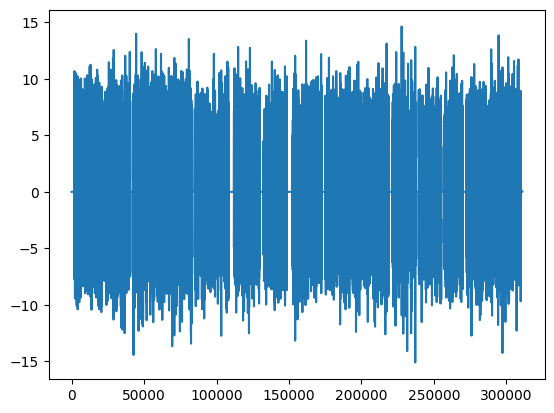

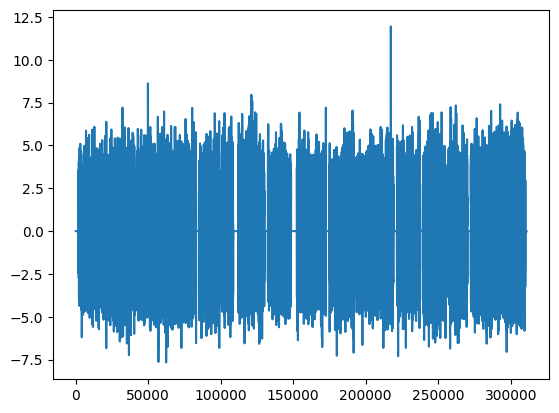

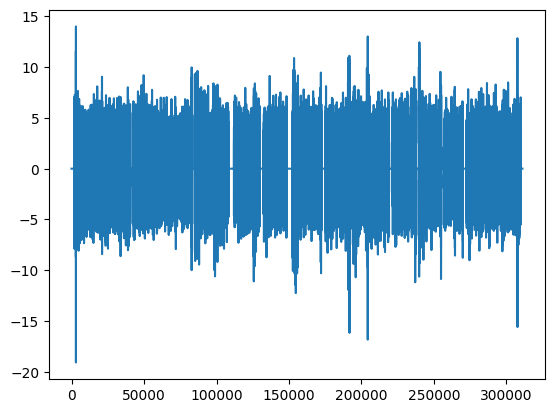

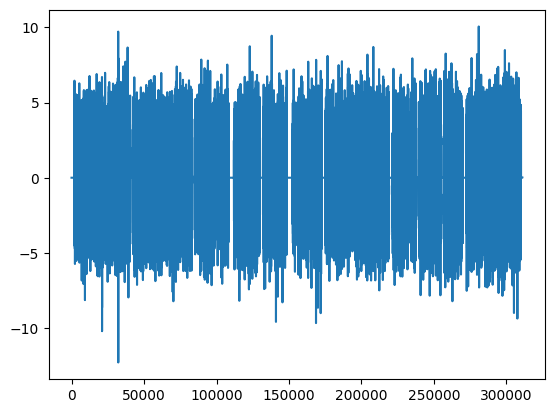

In [111]:
for i in range(5):
    plt.figure()
    plt.plot(toplot_MEG[i])
    plt.show()

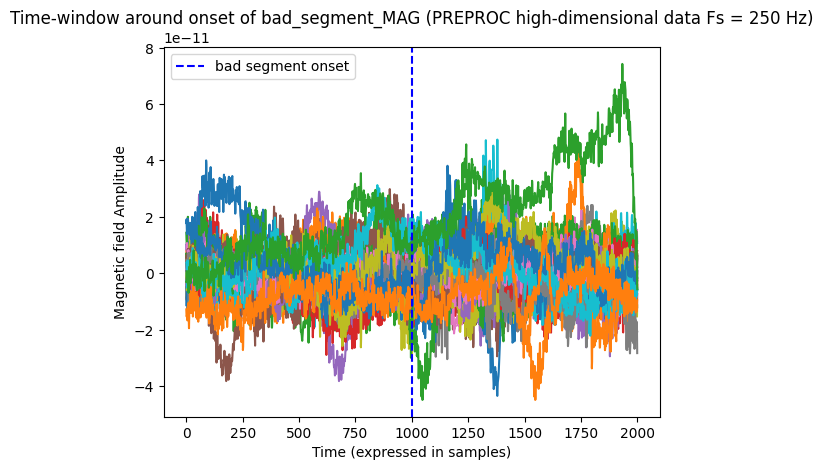

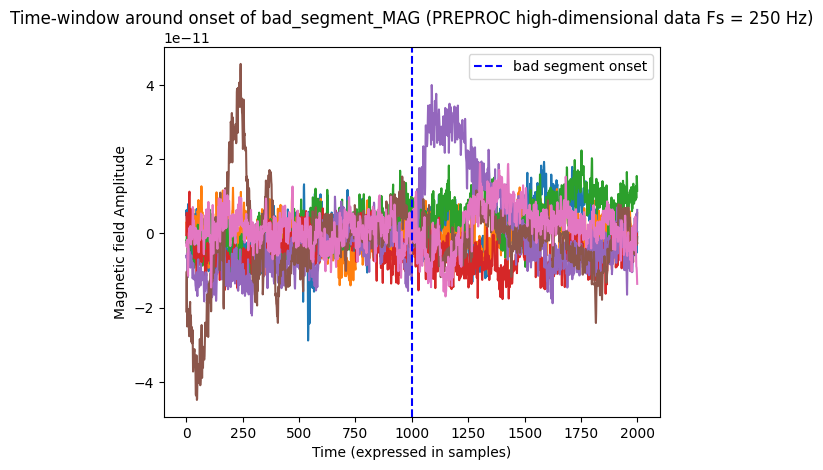

In [112]:
preproc_MEG_raw = mne.io.read_raw_fif("/home/olivierb/processed_data/meg_0945_SDMT_tsss_mc/meg_0945_SDMT_tsss_mc_preproc_raw.fif", verbose=False)

preproc_MEG = preproc_MEG_raw.get_data()

# Get timepoints corresponding to the indices
bad_segment_mag_timepoints = annotations.onset[bad_segment_mag_idx]
bad_segment_grad_timepoints = annotations.onset[bad_segment_grad_idx]

bad_segment_mag_timepoints = [(timepoint - loaded.first_samp/250)*250 for timepoint in bad_segment_mag_timepoints]
bad_segment_grad_timepoints = [(timepoint - loaded.first_samp/250)*250 for timepoint in bad_segment_grad_timepoints]

plt.figure()
for segment in range(len(bad_segment_mag_timepoints)):
    plt.plot(preproc_MEG[0][int(bad_segment_mag_timepoints[segment] - 1000):int(bad_segment_mag_timepoints[segment] + 1000)])
plt.axvline(x = 1000, color = 'b', linestyle='dashed', label='bad segment onset')
plt.xlabel('Time (expressed in samples)')
plt.ylabel('Magnetic field Amplitude')
plt.title('Time-window around onset of bad_segment_MAG (PREPROC high-dimensional data Fs = 250 Hz)')
plt.legend()

plt.figure()
for segment in range(len(bad_segment_grad_timepoints)):
    plt.plot(preproc_MEG[0][int(bad_segment_grad_timepoints[segment] - 1000):int(bad_segment_grad_timepoints[segment] + 1000)])
plt.axvline(x = 1000, color = 'b', linestyle='dashed', label='bad segment onset')
plt.xlabel('Time (expressed in samples)')
plt.ylabel('Magnetic field Amplitude')
plt.title('Time-window around onset of bad_segment_MAG (PREPROC high-dimensional data Fs = 250 Hz)')
plt.legend()

## Do the SAME but for **completely raw data** (because now the bad segment is simply flattened out for some reason? For 500 samples (which aligns with the **segment_len** parameter of 500 given in the preprocessing)

### relevant piece of code: def detect_artefacts in osl/preprocessing/osl_wrappers.py

In [82]:
raw_data = raw_dataset_dir = mne.io.read_raw_fif("/home/data/vub_ms/MEGDATA_ANA/SDMT/DATA/meg_0945_SDMT_tsss_mc.fif")
raw_data.info

print(np.shape(raw_data.get_data()))
print(np.shape(loaded.get_data()))

Opening raw data file /home/data/vub_ms/MEGDATA_ANA/SDMT/DATA/meg_0945_SDMT_tsss_mc.fif...
    Range : 132000 ... 1375999 =    132.000 ...  1375.999 secs
Ready.


/tmp/ipykernel_2107657/1702676105.py:1: RuntimeWarning: This filename (/home/data/vub_ms/MEGDATA_ANA/SDMT/DATA/meg_0945_SDMT_tsss_mc.fif) does not conform to MNE naming conventions. All raw files should end with raw.fif, raw_sss.fif, raw_tsss.fif, _meg.fif, _eeg.fif, _ieeg.fif, raw.fif.gz, raw_sss.fif.gz, raw_tsss.fif.gz, _meg.fif.gz, _eeg.fif.gz or _ieeg.fif.gz
  raw_data = raw_dataset_dir = mne.io.read_raw_fif("/home/data/vub_ms/MEGDATA_ANA/SDMT/DATA/meg_0945_SDMT_tsss_mc.fif")


(333, 1244000)
(38, 311000)


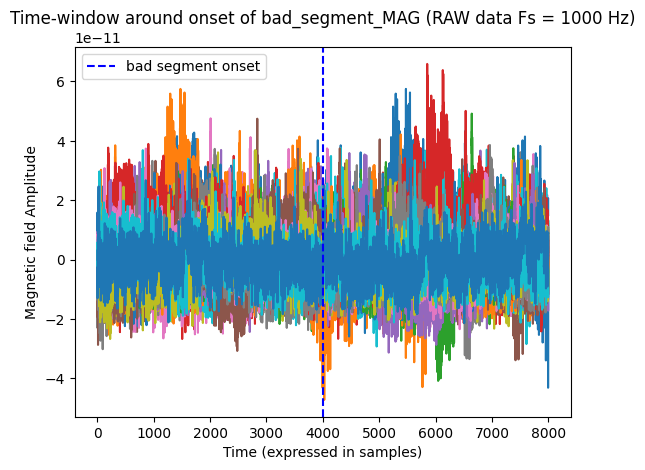

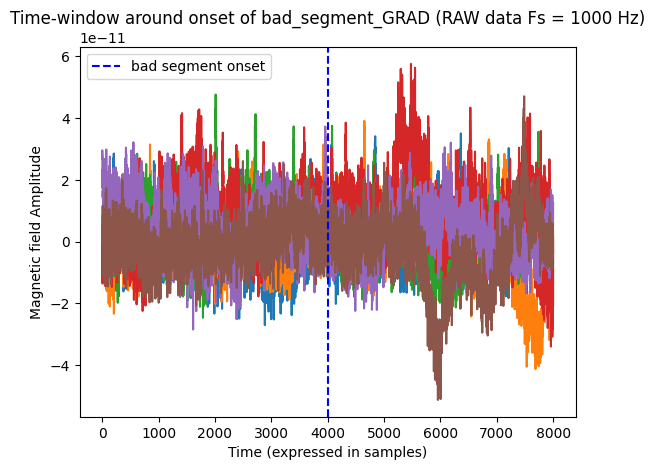

In [97]:
raw_MEG = raw_data.get_data()

# Get timepoints corresponding to the indices
bad_segment_mag_timepoints = annotations.onset[bad_segment_mag_idx]
bad_segment_grad_timepoints = annotations.onset[bad_segment_grad_idx]

bad_segment_mag_timepoints = [(timepoint - loaded.first_samp/1000.0)*1000 for timepoint in bad_segment_mag_timepoints]
bad_segment_grad_timepoints = [(timepoint - loaded.first_samp/1000.0)*1000 for timepoint in bad_segment_grad_timepoints]


plt.figure()
for segment in range(len(bad_segment_mag_timepoints)):
    plt.plot(raw_MEG[0][int(bad_segment_mag_timepoints[segment] - 4000):int(bad_segment_mag_timepoints[segment] + 4000)])
plt.axvline(x = 4000, color = 'b', linestyle='dashed', label='bad segment onset')
plt.xlabel('Time (expressed in samples)')
plt.ylabel('Magnetic field Amplitude')
plt.title('Time-window around onset of bad_segment_MAG (RAW data Fs = 1000 Hz)')
plt.legend()

plt.figure()
for segment in range(len(bad_segment_grad_timepoints)):
    plt.plot(raw_MEG[0][int(bad_segment_grad_timepoints[segment] - 4000):int(bad_segment_grad_timepoints[segment] + 4000)])
plt.axvline(x = 4000, color = 'b', linestyle='dashed', label='bad segment onset')
plt.xlabel('Time (expressed in samples)')
plt.ylabel('Magnetic field Amplitude')
plt.title('Time-window around onset of bad_segment_GRAD (RAW data Fs = 1000 Hz)')
plt.legend()

# **1. Summary statistics**

1. Fractional occupacy
2. Mean lifetime
3. Mean interval
4. Switching rate
5. Group comparisons (on the 4 summary metrics)

#### Plot raw alpha timecourse

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

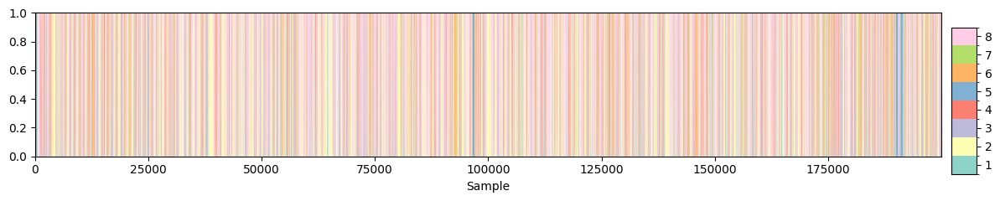

In [20]:
from osl_dynamics.utils import plotting

# Plot the state probability time course for the 1st subject (and a limited amount of samples)
plotting.plot_alpha(alpha[0], n_samples=200000)

#### Enforce 1 state per timepoint (argmax)

(<Figure size 1200x250 with 2 Axes>, [<Axes: xlabel='Sample'>])

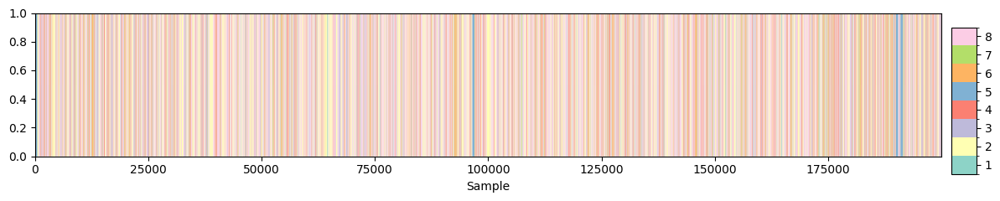

In [21]:
from osl_dynamics.inference import modes

# Hard classify the state probabilities (needed before you calculate summary statistics)
stc = modes.argmax_time_courses(alpha)

# Plot the state time course for the first subject (8 seconds)
plotting.plot_alpha(stc[0], n_samples=200000)

### **1.1 Fractional occupacy**

In [22]:
# Calculate fractional occupancies
fo = modes.fractional_occupancies(stc)
print(fo.shape)
print('subjects', 'amount_states')

(110, 8)
subjects amount_states


In [23]:
## Print the GROUP AVERAGE (all subjects) Fractional Occupancy
print(np.mean(fo, axis=0))

[0.19032232 0.1582407  0.16413614 0.16720963 0.05694389 0.07589035
 0.02355835 0.16369861]


2024-05-06 09:53:33 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-05-06 09:53:33 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


(<Figure size 700x400 with 1 Axes>, <Axes: xlabel='State', ylabel='FO'>)

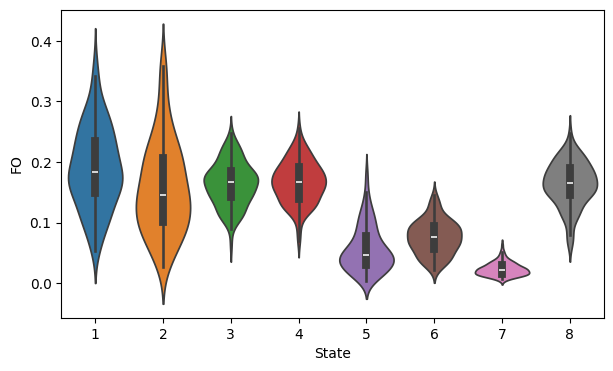

In [24]:
# Plot the distribution of fractional occupancy (FO) across subjects (violin plot shows spread of f0 across subjects)
plotting.plot_violin(fo.T, x_label="State", y_label="FO")

In [26]:
print(fo[:][:, np.array([True, True, True, True, False, True, True, True])].shape)

(110, 7)


2024-05-06 09:55:55 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-05-06 09:55:55 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
/tmp/ipykernel_2243037/2936777808.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels, fontsize=13)
/tmp/ipykernel_2243037/2936777808.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)


Text(0.5, 1.0, 'Fractional Occupancy - FO')

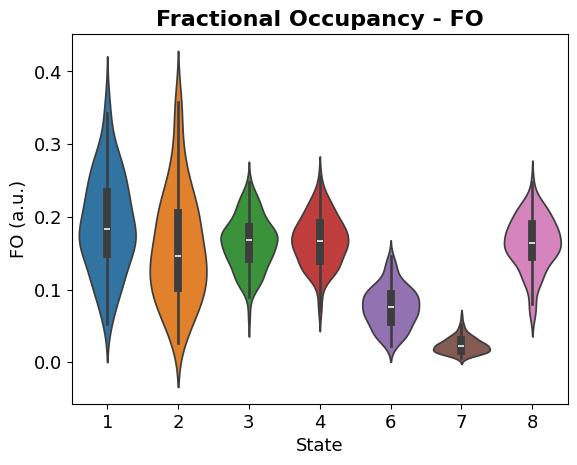

In [27]:
labels=['1', '2', '3', '4', '6', '7', '8']
fo_new = fo[:][:, np.array([True, True, True, True, False, True, True, True])]
ax = sns.violinplot(fo_new)
ax.set_xticklabels(labels, fontsize=13)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)
ax.set_xlabel('State', fontsize=13)
ax.set_ylabel('FO (a.u.)', fontsize=13)
ax.set_title('Fractional Occupancy - FO', fontsize=16, weight='bold')

### **1.2 Mean lifetime**

2024-05-06 09:56:08 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-05-06 09:56:08 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[  65.03354747   82.68635662   72.87268574   65.08896335 3177.90233214
   75.92202364   54.79349408   63.374315  ]


(<Figure size 700x400 with 1 Axes>,
 <Axes: xlabel='State', ylabel='Mean Lifetime (ms)'>)

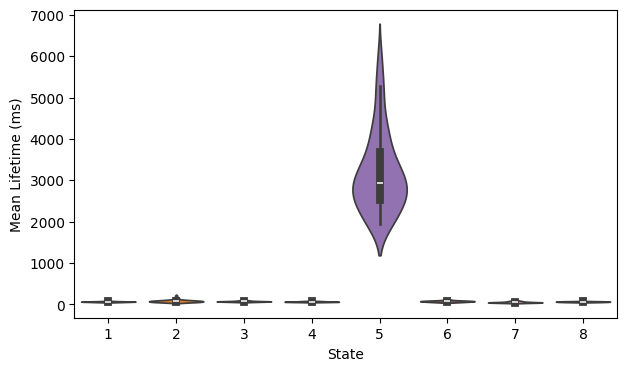

In [28]:
# Calculate mean lifetimes (in seconds)
mlt = modes.mean_lifetimes(stc, sampling_frequency=250)

# Convert to ms
mlt *= 1000

# Print the group average
print(np.mean(mlt, axis=0))

# Plot distribution across subjects
plotting.plot_violin(mlt.T, x_label="State", y_label="Mean Lifetime (ms)")

2024-05-06 09:56:28 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-05-06 09:56:28 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
/tmp/ipykernel_2243037/3211227311.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels, fontsize=13)
/tmp/ipykernel_2243037/3211227311.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)


Text(0.5, 1.0, 'Mean Lifetime - MLT')

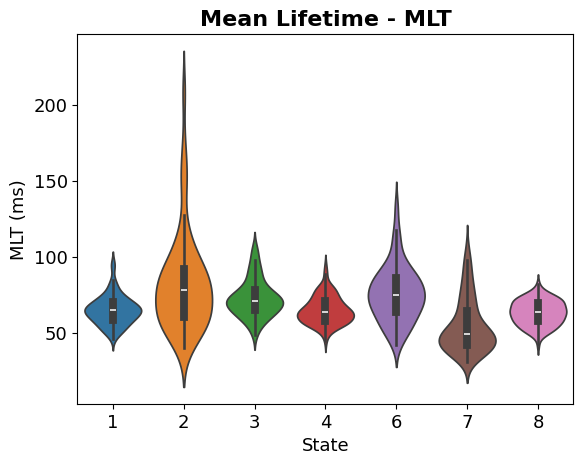

In [29]:
labels=['1', '2', '3', '4', '6', '7', '8']
mlt_new = mlt[:][:, np.array([True, True, True, True, False, True, True, True])]
ax = sns.violinplot(mlt_new)
ax.set_xticklabels(labels, fontsize=13)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)
ax.set_xlabel('State', fontsize=13)
ax.set_ylabel('MLT (ms)', fontsize=13)
ax.set_title('Mean Lifetime - MLT', fontsize=16, weight='bold')

### **1.3 Mean interval**

2024-05-06 09:56:42 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-05-06 09:56:42 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[  309.44190629   493.53052413   376.97353045   330.83247609
 79165.07227981   984.96669495  2533.47711865   332.70825644]


(<Figure size 700x400 with 1 Axes>,
 <Axes: xlabel='State', ylabel='Mean Interval (s)'>)

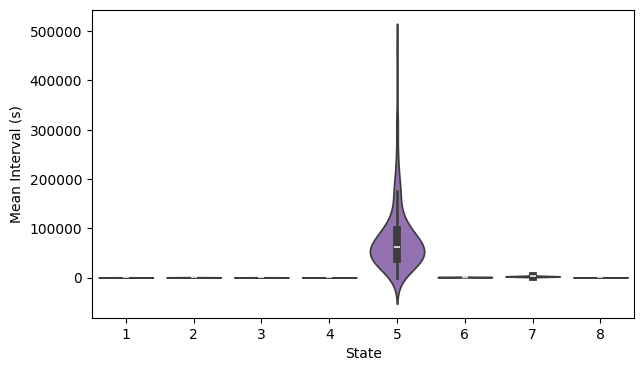

In [30]:
# Calculate mean intervals (in seconds)
mintv = modes.mean_intervals(stc, sampling_frequency=250)

# Convert to ms
mintv *= 1000

# Print the group average
print(np.mean(mintv, axis=0))

# Plot distribution across subjects
plotting.plot_violin(mintv.T, x_label="State", y_label="Mean Interval (s)")

2024-05-06 09:57:00 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-05-06 09:57:00 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
/tmp/ipykernel_2243037/2460597851.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels, fontsize=13)
/tmp/ipykernel_2243037/2460597851.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)


Text(0.5, 1.0, 'Mean Interval - MI')

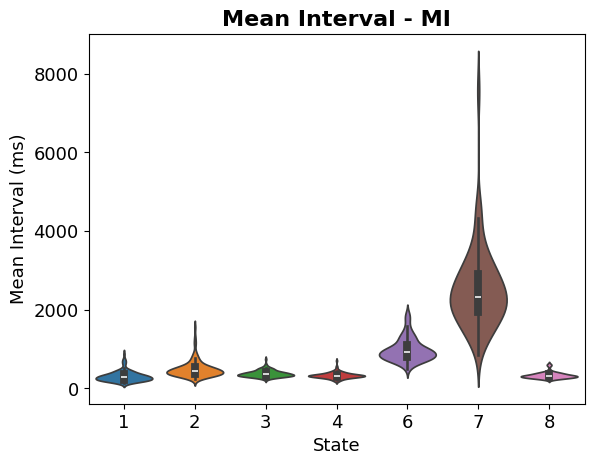

In [31]:
labels=['1', '2', '3', '4', '6', '7', '8']
mintv_new = mintv[:][:, np.array([True, True, True, True, False, True, True, True])]
ax = sns.violinplot(mintv_new)
ax.set_xticklabels(labels, fontsize=13)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)
ax.set_xlabel('State', fontsize=13)
ax.set_ylabel('Mean Interval (ms)', fontsize=13)
ax.set_title('Mean Interval - MI', fontsize=16, weight='bold')

### **1.4 Switching rates**

2024-05-06 09:57:18 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-05-06 09:57:18 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


[2.86095887 1.84392572 2.25588314 2.57264923 0.01665417 0.98023773
 0.42996577 2.56510178]


(<Figure size 700x400 with 1 Axes>,
 <Axes: xlabel='State', ylabel='Switching rates'>)

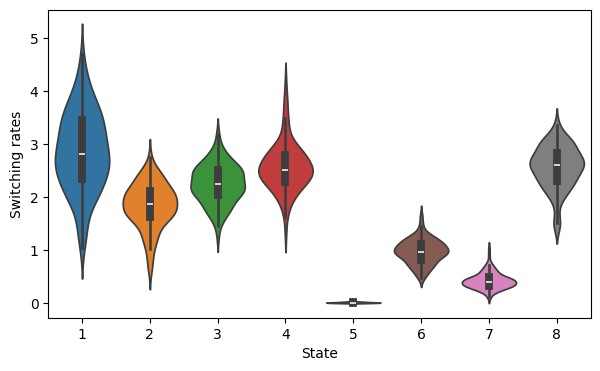

In [32]:
sw_rate = modes.switching_rates(stc, sampling_frequency=250)

# Print the group average
print(np.mean(sw_rate, axis=0))

# Plot distribution across subjects
plotting.plot_violin(sw_rate.T, x_label="State", y_label="Switching rates")

2024-05-06 09:57:37 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-05-06 09:57:37 INFO matplotlib.category [category.py:223:update]: Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
/tmp/ipykernel_2243037/3637999492.py:4: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(labels, fontsize=13)
/tmp/ipykernel_2243037/3637999492.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)


Text(0.5, 1.0, 'Switching rate - SR')

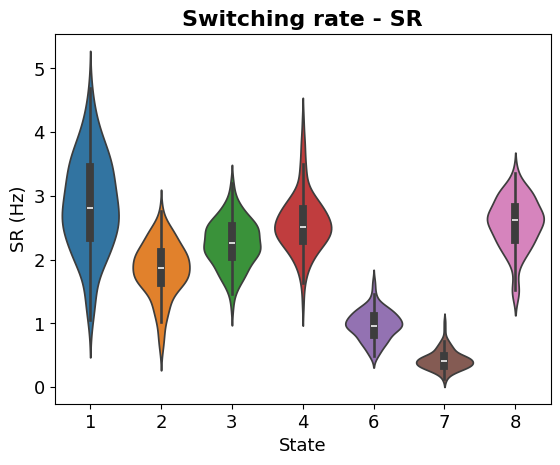

In [33]:
labels=['1', '2', '3', '4', '6', '7', '8']
sw_rate_new = sw_rate[:][:, np.array([True, True, True, True, False, True, True, True])]
ax = sns.violinplot(sw_rate_new)
ax.set_xticklabels(labels, fontsize=13)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)
ax.set_xlabel('State', fontsize=13)
ax.set_ylabel('SR (Hz)', fontsize=13)
ax.set_title('Switching rate - SR', fontsize=16, weight='bold')

### **1.5 Group comparisons**

## **HC vs. MS**

#### First you need to extract groups (HC/MS)

In [34]:
## First we split the subjects into 2 groups based on the 'subjectinfo.mat'

# Need subject_IDs_group_analysis

from scipy.io import loadmat
import pandas as pd
import numpy as np

def patientinfo_to_df(patientinfo_mat_path):
    
    array = loadmat(patientinfo_mat_path)['subjectinfo'][0]
    
    indices_relevant_cols = [0,3,4,5,6,7,16,19,21,26]
    relevant_col_names = ['code', 'disdur', 'type', 'age', 'edu', 'SDMT', 'gender_isfemale', 'isms', 'EDSS', 'benzos']
    
    # for each of the relevant columns 
    extracted_out = []
    for column in range(len(indices_relevant_cols)):
        extracted_col = [array[patient][indices_relevant_cols[column]] for patient in range(len(array))]
        extracted_out.append(extracted_col)
    
    df_out = pd.DataFrame()
    for col in range(len(indices_relevant_cols)):
        df_out[relevant_col_names[col]] = extracted_out[col]
    
    # Recursively unpack value from nested arrays 
    def unpack_nested(val):
        if isinstance(val, np.ndarray):
            return unpack_nested(val[0])
        else:
            return val
                    
    df_out = df_out.map(unpack_nested)
    
    return df_out

In [35]:
df_patientinfo = patientinfo_to_df("/home/olivierb/Downloads/subjectinfo.mat")
from IPython.display import display

# Get only 110 subjects for which we have both succesful parceled MEG data & eventtables
filtered_df = df_patientinfo[df_patientinfo['code'].isin(subject_IDs_group_analysis)].reset_index(drop=True)

# Get all row indices with isms = 0 ==> healthy controls
df_control_idx = filtered_df.index[filtered_df['isms'] == 0].tolist()
#print(df_control_idx)
print(len(df_control_idx))

# Get all row indices with isms = 1 ==> MS patients
df_ms_idx = filtered_df.index[filtered_df['isms'] == 1].tolist()
#print(df_ms_idx)
print(len(df_ms_idx))

37
73


#### Group assignments is expected to be [1,1,1,2,2,1,1,...]

In [36]:
# 1 = HC
# 2 = MS

assignments = []
for subject in range(len(subject_IDs_group_analysis)):
    if subject in df_control_idx:
        assignments.append(1)
    else:
        assignments.append(2)

assignments = np.array(assignments)
print(assignments)

[2 2 2 2 2 2 2 2 2 2 2 2 2 1 2 1 2 1 1 2 1 1 1 2 1 1 2 2 2 2 2 1 2 2 2 2 2
 2 2 2 2 2 2 2 1 2 2 2 2 2 2 2 1 2 2 2 2 2 2 2 2 1 1 2 2 1 2 2 1 1 1 2 1 1
 1 1 2 1 2 1 2 1 2 1 1 2 1 1 1 1 1 2 2 1 2 2 2 2 2 2 2 2 1 1 2 2 1 2 2 1]


#### **Statistical significance testing - max stat permutation with correction for multiple comparisons**

In [37]:
from osl_dynamics.analysis import statistics

# Test for a difference in any of the summary statistics
# It's important to combine all the summary statistics into one test to make sure we're correcting for multiple comparisons!
sum_stats = [fo, mlt, mintv, sw_rate]
sum_stats = np.swapaxes(sum_stats, 0, 1)  # make sure subjects is the first axis

# Do stats testing
diff, pvalues = statistics.group_diff_max_stat_perm(
    sum_stats,
    assignments, # uses the group assignments from previous cell
    n_perm=10000,
)

# Are any summary stat differences significant?
print("Number of significant differences:", np.sum(pvalues < 0.05))

Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 10000 permutations
	Taking max-stat across ['features 1', 'features 2'] dimensions
Using tstats as metric
Number of significant differences: 1


In [40]:
# 2nd metric (mean lifetime) - State 7
print(pvalues[1][6])

0.030000000000000027


In [58]:
print(np.shape(sum_stats))

(110, 4, 6)


In [41]:
# Print the mean (across all subjects) of each metric per state

metric_names = ['FO', 'MLT', 'MI', 'SR']

    
for metric in range(len(metric_names)):
    data_metric = sum_stats[:, metric]
    for state in range(n_states):
        data_state = data_metric[:,state]
        print(metric_names[metric], '-', 'state', state+1, ':', np.round(np.mean(data_state),2),
                 '+/-', np.round(np.std(data_state),2))

FO - state 1 : 0.19 +/- 0.07
FO - state 2 : 0.16 +/- 0.08
FO - state 3 : 0.16 +/- 0.04
FO - state 4 : 0.17 +/- 0.03
FO - state 5 : 0.06 +/- 0.04
FO - state 6 : 0.08 +/- 0.03
FO - state 7 : 0.02 +/- 0.01
FO - state 8 : 0.16 +/- 0.04
MLT - state 1 : 65.03 +/- 9.46
MLT - state 2 : 82.69 +/- 32.37
MLT - state 3 : 72.87 +/- 12.23
MLT - state 4 : 65.09 +/- 9.07
MLT - state 5 : 3177.9 +/- 961.72
MLT - state 6 : 75.92 +/- 18.35
MLT - state 7 : 54.79 +/- 17.5
MLT - state 8 : 63.37 +/- 8.05
MI - state 1 : 309.44 +/- 129.26
MI - state 2 : 493.53 +/- 207.0
MI - state 3 : 376.97 +/- 83.29
MI - state 4 : 330.83 +/- 73.93
MI - state 5 : 79165.07 +/- 67713.96
MI - state 6 : 984.97 +/- 289.55
MI - state 7 : 2533.48 +/- 1039.5
MI - state 8 : 332.71 +/- 77.1
SR - state 1 : 2.86 +/- 0.74
SR - state 2 : 1.84 +/- 0.42
SR - state 3 : 2.26 +/- 0.37
SR - state 4 : 2.57 +/- 0.45
SR - state 5 : 0.02 +/- 0.01
SR - state 6 : 0.98 +/- 0.23
SR - state 7 : 0.43 +/- 0.15
SR - state 8 : 2.57 +/- 0.4


In [42]:
# Print the group means and standard deviation for each summary metric, per state
sum_stats[df_control_idx][:][0][0]   # 1st for metric, 2nd for state number

groups = [df_control_idx, df_ms_idx]
group_names = ['HC', 'PwMS']
metric_names = ['FO', 'MLT', 'MI', 'SR']
for group in range(len(groups)):
    group_stats = sum_stats[groups[group]]
    for metric in range(len(metric_names)):
        group_metric = group_stats[:, metric]
        for state in range(n_states):
            group_state = group_metric[:,state]
            print(group_names[group], '-', metric_names[metric], '-', 'state', state+1, ':', np.round(np.mean(group_state),2),
                 '+/-', np.round(np.std(group_state),2))

HC - FO - state 1 : 0.2 +/- 0.06
HC - FO - state 2 : 0.15 +/- 0.07
HC - FO - state 3 : 0.17 +/- 0.03
HC - FO - state 4 : 0.16 +/- 0.04
HC - FO - state 5 : 0.06 +/- 0.04
HC - FO - state 6 : 0.07 +/- 0.02
HC - FO - state 7 : 0.02 +/- 0.01
HC - FO - state 8 : 0.17 +/- 0.04
HC - MLT - state 1 : 66.79 +/- 9.19
HC - MLT - state 2 : 80.25 +/- 31.47
HC - MLT - state 3 : 72.67 +/- 11.8
HC - MLT - state 4 : 65.88 +/- 9.2
HC - MLT - state 5 : 3152.14 +/- 1052.84
HC - MLT - state 6 : 76.7 +/- 17.26
HC - MLT - state 7 : 47.47 +/- 12.17
HC - MLT - state 8 : 63.72 +/- 8.45
HC - MI - state 1 : 288.81 +/- 103.23
HC - MI - state 2 : 486.87 +/- 183.87
HC - MI - state 3 : 361.32 +/- 64.73
HC - MI - state 4 : 348.67 +/- 92.38
HC - MI - state 5 : 75620.36 +/- 77203.04
HC - MI - state 6 : 988.7 +/- 266.61
HC - MI - state 7 : 2645.1 +/- 1115.29
HC - MI - state 8 : 326.37 +/- 78.14
HC - SR - state 1 : 2.95 +/- 0.66
HC - SR - state 2 : 1.85 +/- 0.39
HC - SR - state 3 : 2.32 +/- 0.31
HC - SR - state 4 : 2.47 +/-

# **2. Temporal characteristics - Evoked response Analysis**
    - Extracted filtered epochs (no bad_segments epochs & only 128 first trials)
    - Seperate correct vs. incorrect trials (1st level)
    - Epoch the state's timecourse + baseline correct
    - significance testing (max statistic permutation testing) between the states at each timepoint
    - HC vs. MS for each state seperately (2nd level)

### Extract timestamps for correct & incorrect trials

### <font color='red'> For **all epochs**

In [43]:
def get_raw_stimuli(all_parceled_paths, nr_subject: int, df_events_all):
    
    ## Extract event timestamps
    #######################################
    
    raw = mne.io.read_raw_fif(all_parceled_paths[nr_subject])
    start_time_sample = raw.first_samp
    
    df_events = df_events_all[nr_subject]
    list_correct = df_events.loc[df_events['trial_type'] == 'trial_correct']['epoch_time'].to_list()      # epoch_time based on diode!
    list_incorrect = df_events.loc[df_events['trial_type'] == 'trial_incorrect']['epoch_time'].to_list()
    
    # Only keep the 38 parcels, no STIM channels
    ch_names_python = []
    for i in range(38):
        ch_names_python.append('parcel_' + str(i))
    raw = raw.pick(ch_names_python) 
    
    ## keep all trials
    ######################################

    #merged_list = sorted(np.concatenate((list_correct,list_incorrect)))
    
    # keep all trials
    #if len(merged_list) > 128:
        #result_elements = merged_list[:128]

        # Remove the elements from list_correct and list_incorrect that do not belong to the first 128 elements of merged_list
        #list_correct = [element for element in list_correct if element in result_elements]
        #list_incorrect = [element for element in list_incorrect if element in result_elements]
    
    # Extract events -> correction for unwanted time-shift applied here when loading the  -> no need to add start_timestamps here !!
    events_correct = [raw.time_as_index(timestamp)[0] for timestamp in list_correct]
    events_incorrect = [raw.time_as_index(timestamp)[0] for timestamp in list_incorrect]
    
    return [np.array(events_correct), np.array(events_incorrect)]

### <font color='red'> For **filtered epochs:**
    - do not use "bad segments" epochs
    - same amount of epochs across all subjects (= 128)

In [44]:
def extract_filtered_epochs(all_data_files, all_epochs_files, nr_subject):
    
    # Load .fif file (needed for extracting start_time_sample)
    raw = mne.io.read_raw_fif(all_data_files[nr_subject])
    start_time_sample = raw.first_samp
    
    # Load previously saved events (correctly saved)
    loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
    events = loaded_epochs.events
    
    # Correct for the timeshift
    sample_indices = events[:,0] - start_time_sample
    
    # Add trials to correct OR incorrect list
    event_type = events[:,2]
    events_correct = []
    events_incorrect = []
    for idx in range(len(event_type)):
        if event_type[idx] == 1:        # correct trial
            events_correct.append(sample_indices[idx])
        else:
            events_incorrect.append(sample_indices[idx])
    
    return [np.array(events_correct), np.array(events_incorrect)]

In [45]:
all_epochs_paths = sorted(glob.glob('/home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/' + '*.fif'))
#print(len(all_epochs_paths))
event_indices_filtered = []

subs = len(subject_IDs_group_analysis)
for i in range(subs):
    event_indices_filtered.append(extract_filtered_epochs(input_data_HMM, all_epochs_paths, i))

# Correct & incorrect trials per subject are both in this array
event_indices_filtered_all = [np.concatenate(subject_epochs) for subject_epochs in event_indices_filtered] 

Opening raw data file /home/olivierb/Input_files_HMM/final/sub_0925_raw.fif...
    Range : 26250 ... 325749 =    105.000 ...  1302.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_0925_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
128 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_0944_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 32500 ... 330749 =    130.000 ...  1322.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_0944_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
127 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_0945_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 33000 ... 343999 =    132.000 ...  1375.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_0945_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
110 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_0947_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 22250 ... 353499 =     89.000 ...  1413.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_0947_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
126 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_0987_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 18250 ... 279249 =     73.000 ...  1116.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_0987_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
126 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_0992_raw.fif...
    Range : 38750 ... 321749 =    155.000 ...  1286.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_0992_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
120 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_0995_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 22000 ... 296499 =     88.000 ...  1185.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_0995_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
110 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_0997_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 10500 ... 283499 =     42.000 ...  1133.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_0997_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_0999_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 4250 ... 268999 =     17.000 ...  1075.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_0999_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
128 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1000_raw.fif...
    Range : 10750 ... 273999 =     43.000 ...  1095.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1000_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
126 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1001_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 25000 ... 281999 =    100.000 ...  1127.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1001_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
118 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1002_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 59250 ... 386749 =    237.000 ...  1546.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1002_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
127 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1005_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 15750 ... 288749 =     63.000 ...  1154.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1005_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
114 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1006_raw.fif...
    Range : 43500 ... 314249 =    174.000 ...  1256.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1006_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


Not setting metadata
120 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1007_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 39750 ... 319499 =    159.000 ...  1277.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1007_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1008_raw.fif...
    Range : 34250 ... 280749 =    137.000 ...  1122.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1008_sub-epo.fif ...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1009_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 4000 ... 280499 =     16.000 ...  1121.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1009_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
117 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1010_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 31500 ... 270499 =    126.000 ...  1081.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1010_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
117 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1017_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 32500 ... 327499 =    130.000 ...  1309.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1017_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
128 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1018_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 36500 ... 318249 =    146.000 ...  1272.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1018_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1023_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 32750 ... 290749 =    131.000 ...  1162.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1023_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1024_raw.fif...
    Range : 42000 ... 327999 =    168.000 ...  1311.996 secs
Ready.


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1024_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1025_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 25750 ... 264749 =    103.000 ...  1058.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1025_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
104 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1028_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 34000 ... 337999 =    136.000 ...  1351.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1028_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
126 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1031_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 25500 ... 283999 =    102.000 ...  1135.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1031_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1033_raw.fif...
    Range : 12000 ... 216999 =     48.000 ...   867.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1033_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
126 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1052_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 42250 ... 314499 =    169.000 ...  1257.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1052_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1053_raw.fif...
    Range : 12750 ... 252749 =     51.000 ...  1010.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1053_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1073_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 29500 ... 302249 =    118.000 ...  1208.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1073_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
127 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1078_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 29250 ... 281249 =    117.000 ...  1124.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1078_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
121 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1082_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 14750 ... 283999 =     59.000 ...  1135.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1082_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
117 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1097_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 17750 ... 293749 =     71.000 ...  1174.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1097_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_1106_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 36250 ... 342749 =    145.000 ...  1370.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_1106_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2096_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 4500 ... 134249 =     18.000 ...   536.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2096_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
116 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2102_raw.fif...
    Range : 5500 ... 163249 =     22.000 ...   652.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2102_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


Not setting metadata
108 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2121_raw.fif...
    Range : 8000 ... 173249 =     32.000 ...   692.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2121_sub-epo.fif ...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
126 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2122_raw.fif...
    Range : 6250 ... 179499 =     25.000 ...   717.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2122_sub-epo.fif ...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2144_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 12000 ... 141999 =     48.000 ...   567.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2144_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
120 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2147_raw.fif...
    Range : 5500 ... 149999 =     22.000 ...   599.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2147_sub-epo.fif ...
    Found the data of interest:


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
119 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2150_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 4750 ... 143999 =     19.000 ...   575.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2150_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
115 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2151_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 7250 ... 149249 =     29.000 ...   596.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2151_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
123 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2163_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 9250 ... 141499 =     37.000 ...   565.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2163_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
103 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2164_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 4000 ... 160499 =     16.000 ...   641.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2164_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2169_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 32750 ... 189249 =    131.000 ...   756.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2169_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2172_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 9000 ... 138999 =     36.000 ...   555.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2172_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
115 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2173_raw.fif...
    Range : 13500 ... 163999 =     54.000 ...   655.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2173_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


120 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2179_raw.fif...
    Range : 6250 ... 143749 =     25.000 ...   574.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2179_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
115 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2189_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 4000 ... 132749 =     16.000 ...   530.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2189_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
122 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2190_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 7500 ... 147499 =     30.000 ...   589.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2190_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
99 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2192_raw.fif...
    Range : 6500 ... 168999 =     26.000 ...   675.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2192_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
122 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2193_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 9000 ... 163999 =     36.000 ...   655.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2193_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
105 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2201_raw.fif...
    Range : 4000 ... 138749 =     16.000 ...   554.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2201_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
118 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2203_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 19750 ... 152249 =     79.000 ...   608.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2203_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
123 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2206_raw.fif...
    Range : 2500 ... 127749 =     10.000 ...   510.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2206_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


Not setting metadata
126 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2211_raw.fif...
    Range : 8750 ... 179999 =     35.000 ...   719.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2211_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
122 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2215_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 11750 ... 154749 =     47.000 ...   618.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2215_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
123 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2220_raw.fif...
    Range : 13250 ... 137749 =     53.000 ...   550.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2220_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
111 matching events found


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2221_raw.fif...
    Range : 5500 ... 146749 =     22.000 ...   586.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2221_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
121 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2224_raw.fif...
    Range : 3250 ... 138249 =     13.000 ...   552.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2224_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


Not setting metadata
118 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2226_raw.fif...
    Range : 3500 ... 153249 =     14.000 ...   612.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2226_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2227_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 3000 ... 132999 =     12.000 ...   531.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2227_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
123 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2235_raw.fif...
    Range : 6500 ... 146999 =     26.000 ...   587.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2235_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
113 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2238_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 5500 ... 137499 =     22.000 ...   549.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2238_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
103 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2239_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 5750 ... 144999 =     23.000 ...   579.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2239_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
123 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2241_raw.fif...
    Range : 5500 ... 141999 =     22.000 ...   567.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2241_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
106 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2252_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 4250 ... 137749 =     17.000 ...   550.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2252_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
115 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2257_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 6750 ... 140749 =     27.000 ...   562.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2257_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
122 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2264_raw.fif...
    Range : 5500 ... 132499 =     22.000 ...   529.996 secs
Ready.


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2264_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
115 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2266_raw.fif...
    Range : 4750 ... 130999 =     19.000 ...   523.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2266_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
123 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2267_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 4500 ... 128999 =     18.000 ...   515.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2267_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
112 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2268_raw.fif...
    Range : 5750 ... 134249 =     23.000 ...   536.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2268_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
121 matching events found


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2277_raw.fif...
    Range : 3500 ... 140499 =     14.000 ...   561.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2277_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
110 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2278_raw.fif...
    Range : 4500 ... 146999 =     18.000 ...   587.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2278_sub-epo.fif ...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
119 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2279_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 8750 ... 129749 =     35.000 ...   518.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2279_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
110 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2292_raw.fif...
    Range : 6750 ... 150249 =     27.000 ...   600.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2292_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2300_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 4000 ... 137249 =     16.000 ...   548.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2300_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
120 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2305_raw.fif...
    Range : 4500 ... 148499 =     18.000 ...   593.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2305_sub-epo.fif ...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
110 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2306_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 9000 ... 139499 =     36.000 ...   557.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2306_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
127 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2311_raw.fif...
    Range : 2250 ... 129499 =      9.000 ...   517.996 secs
Ready.


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2311_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2312_raw.fif...
    Range : 2750 ... 136749 =     11.000 ...   546.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2312_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


Not setting metadata
121 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2313_raw.fif...
    Range : 4500 ... 169249 =     18.000 ...   676.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2313_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2314_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 12250 ... 130999 =     49.000 ...   523.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2314_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
127 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2317_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 8750 ... 132999 =     35.000 ...   531.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2317_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
119 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2318_raw.fif...
    Range : 6000 ... 116499 =     24.000 ...   465.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2318_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
121 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2319_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 8000 ... 138249 =     32.000 ...   552.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2319_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
120 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2324_raw.fif...
    Range : 5500 ... 156749 =     22.000 ...   626.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2324_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
116 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2325_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 6500 ... 136249 =     26.000 ...   544.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2325_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
122 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2327_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 2750 ... 129499 =     11.000 ...   517.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2327_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
123 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2328_raw.fif...
    Range : 2500 ... 131499 =     10.000 ...   525.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2328_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
123 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2341_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 3250 ... 129499 =     13.000 ...   517.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2341_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
126 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2342_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 5000 ... 123749 =     20.000 ...   494.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2342_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2343_raw.fif...
    Range : 3000 ... 127999 =     12.000 ...   511.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2343_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2346_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 10000 ... 156999 =     40.000 ...   627.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2346_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
126 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2359_raw.fif...
    Range : 4750 ... 149999 =     19.000 ...   599.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2359_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2363_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 5500 ... 137999 =     22.000 ...   551.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2363_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
117 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2364_raw.fif...
    Range : 3750 ... 135749 =     15.000 ...   542.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2364_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
112 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2378_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 4500 ... 142749 =     18.000 ...   570.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2378_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2379_raw.fif...
    Range : 3000 ... 162499 =     12.000 ...   649.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2379_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
105 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2384_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 21750 ... 159999 =     87.000 ...   639.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2384_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
121 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2386_raw.fif...
    Range : 6000 ... 156499 =     24.000 ...   625.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2386_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
116 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2388_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 2250 ... 145249 =      9.000 ...   580.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2388_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2396_raw.fif...
    Range : 12250 ... 146999 =     49.000 ...   587.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2396_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


Not setting metadata
127 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2410_raw.fif...
    Range : 2750 ... 136749 =     11.000 ...   546.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2410_sub-epo.fif ...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
128 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2414_raw.fif...
    Range : 5000 ... 148999 =     20.000 ...   595.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2414_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
119 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2416_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 8000 ... 177999 =     32.000 ...   711.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2416_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
106 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2421_raw.fif...
    Range : 180500 ... 307749 =    722.000 ...  1230.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2421_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
119 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2427_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 3250 ... 127999 =     13.000 ...   511.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2427_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
114 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2440_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 4500 ... 136999 =     18.000 ...   547.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2440_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
117 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2447_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 12750 ... 158249 =     51.000 ...   632.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2447_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
122 matching events found
No baseline correction applied
0 projection items activated
Opening raw data file /home/olivierb/Input_files_HMM/final/sub_2448_raw.fif...


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


    Range : 3500 ... 130249 =     14.000 ...   520.996 secs
Ready.
Reading /home/olivierb/FULLY_PROCESSED/Epoched_data/DIODE/epochs_2448_sub-epo.fif ...
    Found the data of interest:
        t =    -500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
124 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)
/tmp/ipykernel_2243037/47478276.py:8: RuntimeWarning: The events passed to the Epochs constructor are not chronologically ordered.
  loaded_epochs = mne.read_epochs(all_epochs_files[nr_subject], preload=True)


In [46]:
print(np.shape(event_indices_filtered))
#print(event_indices_filtered_all)

(110, 2)


/home/olivierb/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:2009: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = asarray(a).shape


## <font color='green'> **For correct trials**

In [64]:
# Extract correct & incorrect trials seperately
timings_filtered_correct = [event_indices_filtered[sub][0] for sub in range(len(event_indices_filtered))]
timings_filtered_incorrect = [event_indices_filtered[sub][1] for sub in range(len(event_indices_filtered))]

### **Aligning the state time course to the event timings**

In [65]:
## 1)
## Pad-locking of alpha (alligning with original MEG timecourse)
# n_embeddings=15 -> 7 (= 15/2 - 1) datapoints are lost from the start and end of each subjet's timeseries
timings_filtered_correct_pad = [v - 7 for v in timings_filtered_correct]

## 2)
# Substracting this value might lead to the first event occuring as a negative sample index
# This corresponds to an event we chopped off when we time-delay embedded

# Remove events that we missed due to time-delay embedding
timings_filtered_correct_pad = [v[v > 0] for v in timings_filtered_correct_pad]

## 3)
# We also lose a few data points from the end of each subject's time series due to us separating it into sequences. 
# -> Let's remove events that we cut off when we separated the training data into sequences
timings_filtered_correct_pad = [v[v < s.shape[0]] for v,s in zip(timings_filtered_correct_pad, stc)]
#print(event_indices_tde)

### Epoching

In [66]:
# Epoch around events
stc_epochs = []
for s, v in zip(stc, timings_filtered_correct_pad):                 # filtered CORRECT and pad-locked alpha!
    stc_epochs.append(task.epoch(s, v, pre=125, post=750))
    
# Concatenate over subjects
concat_stc_epochs = np.concatenate(stc_epochs)
print(concat_stc_epochs.shape)

# Average over epochs
avg_stc_epoch = np.nanmean(concat_stc_epochs, axis=0)
print(avg_stc_epoch.shape)

(6287, 875, 8)
(875, 8)


### Plot

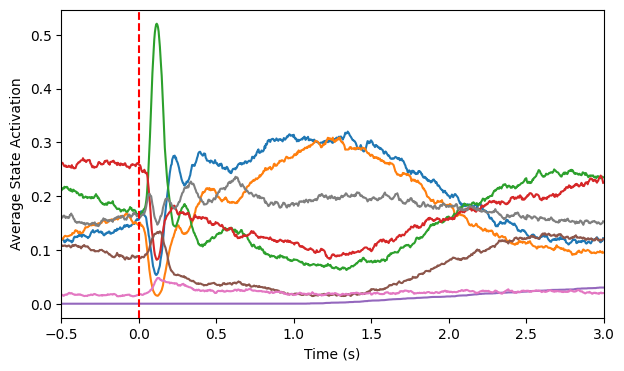

In [67]:
fs = 250
n_states = avg_stc_epoch.shape[1]  # number of states
t = (np.arange(avg_stc_epoch.shape[0]) - 250/2) / fs  # time axis

# Plot the visual task
fig, ax = plotting.plot_line(
    [t] * n_states,
    avg_stc_epoch.T,
    x_range=[-0.5, 3],
    x_label="Time (s)",
    y_label="Average State Activation",
)
ax.axvline(color="r", linestyle="--")

### Plot for **baseline corrected**

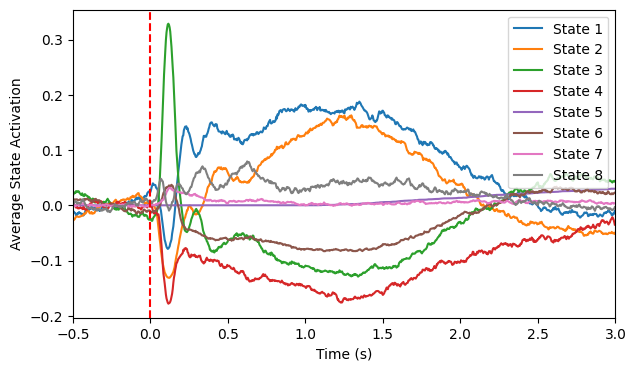

In [68]:
# Calculate the baseline
pre = 125  # number of samples before the event
base_corr = np.nanmean(avg_stc_epoch[:pre], axis=0, keepdims=True)

# Remove it from the epoched state time courses
corr_avg_stc_epoch = avg_stc_epoch - base_corr

# Plot the visual task
fig, ax = plotting.plot_line(
    [t] * n_states,
    corr_avg_stc_epoch.T,
    labels=[f"State {i}" for i in range(1, n_states + 1)],
    x_range=[-0.5, 3],
    x_label="Time (s)",
    y_label="Average State Activation",
)
ax.axvline(color="r", linestyle="--")

#### **Statistical significance testing on evoked responses**

In [70]:
from osl_dynamics.analysis import statistics

# We already have the trial specific epochs separated by subjects in stc_epochs,
# we just need to average each subject's trials separately
subj_stc_epochs = []
for epochs in stc_epochs:
    subj_stc_epochs.append(np.nanmean(epochs, axis=0))
subj_stc_epochs = np.array(subj_stc_epochs)
print(subj_stc_epochs.shape)

# Baseline correct using the samples before the event
subj_stc_epochs -= np.mean(subj_stc_epochs[:, :pre], axis=1, keepdims=True)

# Calculate p-values
pvalues = statistics.evoked_response_max_stat_perm(subj_stc_epochs, n_perm=1000)
print(pvalues.shape)

# Do any time points/states come out as significant?
print("Number of time points with at least 1 state with p-value < 0.05:", np.sum(np.any(pvalues < 0.05, axis=-1)))

(110, 875, 8)
Permuting contrast <class 'glmtools.design.Contrast'>(Mean,MainEffect) with mode=sign-flip
	Computing 1000 permutations
	Taking max-stat across ['time', 'features 1'] dimensions
Using copes as metric
(875, 8)
Number of time points with at least 1 state with p-value < 0.05: 543


In [71]:
print(np.shape(subj_stc_epochs))
print(np.shape(np.mean(subj_stc_epochs,axis=0)))

(110, 875, 8)
(875, 8)


Text(1.46, 0.27, 'Mean RT')

<Figure size 640x480 with 0 Axes>

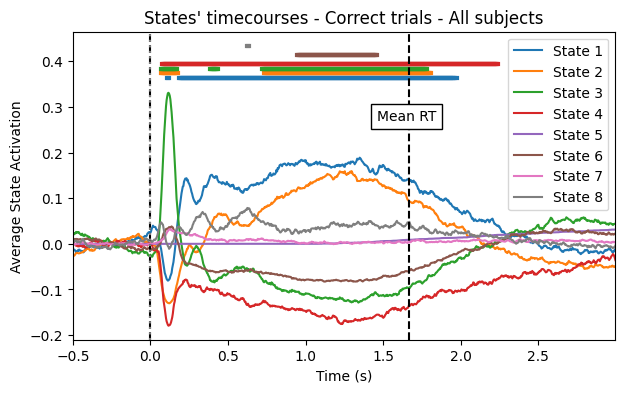

In [72]:
plt.figure()
plotting.plot_evoked_response(
    t,
    np.mean(subj_stc_epochs, axis=0),
    pvalues,
    labels=[f"State {i + 1}" for i in range(subj_stc_epochs.shape[-1])],
    significance_level=0.05,
    x_label="Time (s)",
    y_label="Average State Activation",
    title="States' timecourses - Correct trials - All subjects"
)
plt.axvline(color="gray", linestyle="dotted")
plt.axvline(x=1.668, color="k", linestyle="--")   # 1,668 is the mean reaction time for all correct trials
plt.text(1.46, 0.27, 'Mean RT', fontsize = 10, bbox = dict(facecolor = 'white'))

(110, 875, 7)


Text(1.46, 0.27, 'Mean RT')

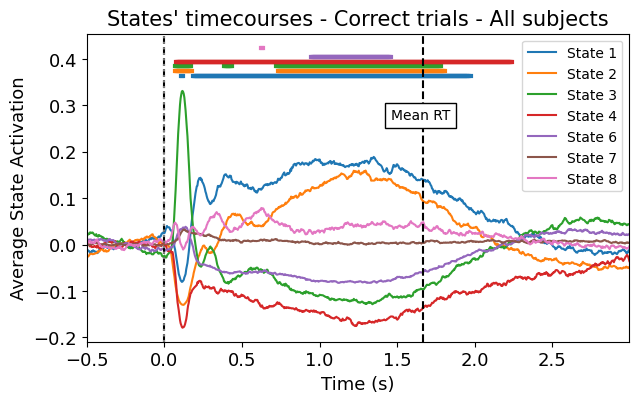

In [73]:
subj_stc_epochs_NEW = subj_stc_epochs[:][:,:, np.array([True, True, True, True, False, True, True, True])]
print(subj_stc_epochs_NEW.shape)

pvalues_NEW = pvalues[:][:, np.array([True, True, True, True, False, True, True, True])]

plotting.plot_evoked_response(
    t,
    np.mean(subj_stc_epochs_NEW, axis=0),
    pvalues_NEW,
    labels=[f"State {i + 1}" for i in [0,1,2,3,5,6,7]],
    significance_level=0.05,
    x_label="Time (s)",
    y_label="Average State Activation",
    title="States' timecourses - Correct trials - All subjects"
)
plt.xlabel("Time (s)", fontsize=13)
plt.ylabel("Average State Activation", fontsize=13)
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)
plt.title("States' timecourses - Correct trials - All subjects", fontsize=15)

plt.axvline(color="gray", linestyle="dotted")
plt.axvline(x=1.668, color="k", linestyle="--")   # 1,668 is the mean reaction time for all correct trials
plt.text(1.46, 0.27, 'Mean RT', fontsize = 10, bbox = dict(facecolor = 'white'))

### **Same but ZOOMED in**

In [56]:
# Epoch around events
stc_epochs = []
for s, v in zip(stc, timings_filtered_correct_pad):                 # filtered CORRECT and pad-locked alpha!
    stc_epochs.append(task.epoch(s, v, pre=50, post=125))
    
# Concatenate over subjects
concat_stc_epochs = np.concatenate(stc_epochs)
print(concat_stc_epochs.shape)

# Average over epochs
avg_stc_epoch = np.nanmean(concat_stc_epochs, axis=0)
print(avg_stc_epoch.shape)

(6287, 175, 8)
(175, 8)


### Plot

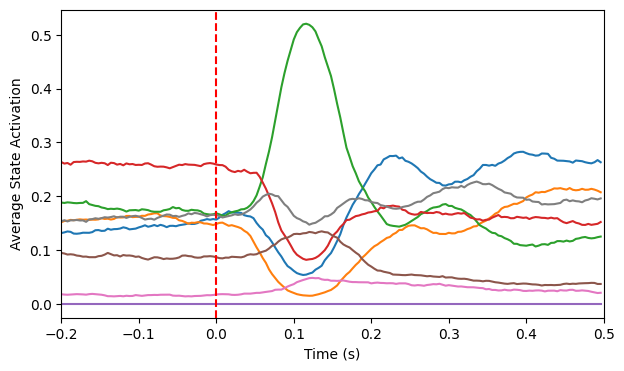

In [57]:
fs = 250
n_states = avg_stc_epoch.shape[1]  # number of states
t = (np.arange(avg_stc_epoch.shape[0]) - 50) / fs  # time axis

# Plot the visual task
fig, ax = plotting.plot_line(
    [t] * n_states,
    avg_stc_epoch.T,
    x_range=[-0.2, 0.5],
    x_label="Time (s)",
    y_label="Average State Activation",
)
ax.axvline(color="r", linestyle="--")

### Plot for **baseline corrected**

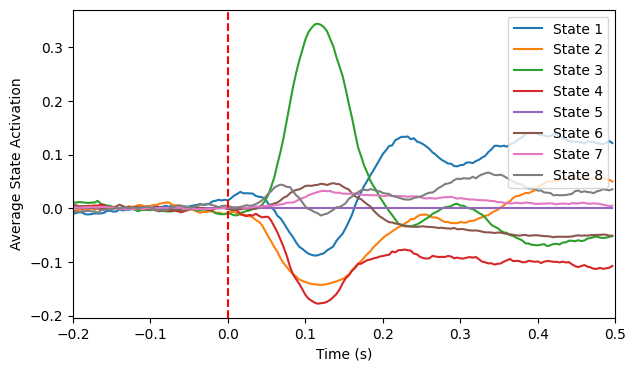

In [58]:
# Calculate the baseline
pre = 50  # number of samples before the event
base_corr = np.nanmean(avg_stc_epoch[:pre], axis=0, keepdims=True)

# Remove it from the epoched state time courses
corr_avg_stc_epoch = avg_stc_epoch - base_corr

# Plot the visual task
fig, ax = plotting.plot_line(
    [t] * n_states,
    corr_avg_stc_epoch.T,
    labels=[f"State {i}" for i in range(1, n_states + 1)],
    x_range=[-0.2, 0.5],
    x_label="Time (s)",
    y_label="Average State Activation",
)
ax.axvline(color="r", linestyle="--")

#### **Statistical significance testing on evoked responses**

In [59]:
from osl_dynamics.analysis import statistics

# We already have the trial specific epochs separated by subjects in stc_epochs,
# we just need to average each subject's trials separately
subj_stc_epochs = []
for epochs in stc_epochs:
    subj_stc_epochs.append(np.nanmean(epochs, axis=0))
subj_stc_epochs = np.array(subj_stc_epochs)
print(subj_stc_epochs.shape)

# Baseline correct using the samples before the event
subj_stc_epochs -= np.mean(subj_stc_epochs[:, :pre], axis=1, keepdims=True)

# Calculate p-values
pvalues = statistics.evoked_response_max_stat_perm(subj_stc_epochs, n_perm=1000)
print(pvalues.shape)

# Do any time points/states come out as significant?
print("Number of time points with at least 1 state with p-value < 0.05:", np.sum(np.any(pvalues < 0.05, axis=-1)))

(110, 175, 8)
Permuting contrast <class 'glmtools.design.Contrast'>(Mean,MainEffect) with mode=sign-flip
	Computing 1000 permutations
	Taking max-stat across ['time', 'features 1'] dimensions
Using copes as metric
(175, 8)
Number of time points with at least 1 state with p-value < 0.05: 109


In [60]:
print(np.shape(subj_stc_epochs))
print(np.shape(np.mean(subj_stc_epochs,axis=0)))

(110, 175, 8)
(175, 8)


<Figure size 640x480 with 0 Axes>

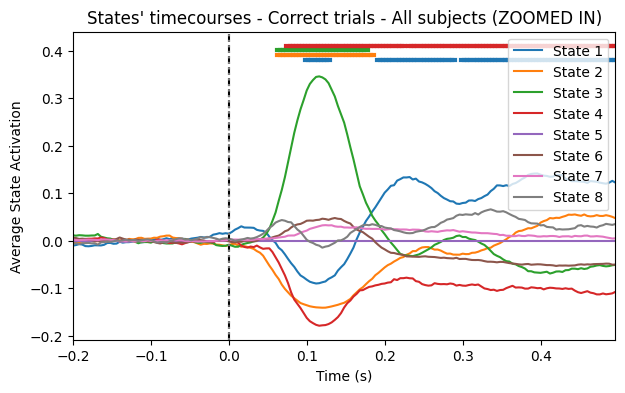

In [61]:
plt.figure()
plotting.plot_evoked_response(
    t,
    np.mean(subj_stc_epochs, axis=0),
    pvalues,
    labels=[f"State {i + 1}" for i in range(subj_stc_epochs.shape[-1])],
    significance_level=0.05,
    x_label="Time (s)",
    y_label="Average State Activation",
    title="States' timecourses - Correct trials - All subjects (ZOOMED IN)"
)
plt.axvline(color="gray", linestyle="dotted")
#plt.axvline(x=1.668, color="k", linestyle="--")   # 1,668 is the mean reaction time for all correct trials
#plt.text(1.46, 0.27, 'Mean RT', fontsize = 10, bbox = dict(facecolor = 'white'))

(110, 175, 8)
(110, 175, 7)


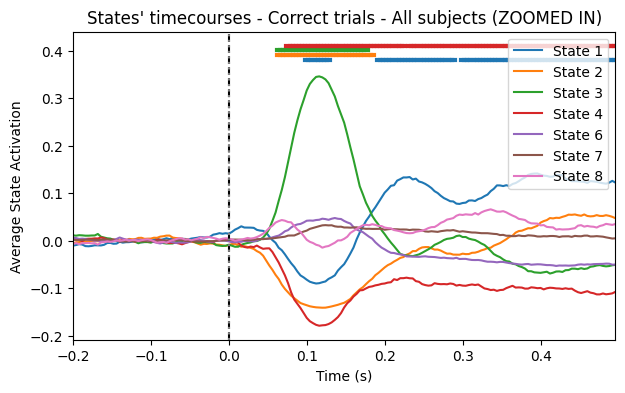

In [62]:
print(np.shape(subj_stc_epochs))

#labels=['1', '2', '4', '5', '6']
subj_stc_epochs_NEW = subj_stc_epochs[:][:,:, np.array([True, True, True, True, False, True, True, True])]
print(subj_stc_epochs_NEW.shape)

pvalues_NEW = pvalues[:][:, np.array([True, True, True, True, False, True, True, True])]

plotting.plot_evoked_response(
    t,
    np.mean(subj_stc_epochs_NEW, axis=0),
    pvalues_NEW,
    labels=[f"State {i + 1}" for i in [0,1,2,3,5,6,7]],
    significance_level=0.05,
    x_label="Time (s)",
    y_label="Average State Activation",
    title="States' timecourses - Correct trials - All subjects (ZOOMED IN)"
)
plt.axvline(color="gray", linestyle="dotted")
#plt.axvline(x=1.668, color="k", linestyle="--")   # 1,668 is the mean reaction time for all correct trials
#plt.text(1.46, 0.27, 'Mean RT', fontsize = 10, bbox = dict(facecolor = 'white'))

### **Group comparison (HC vs. MS)**

(37, 875, 8)
(73, 875, 8)
(875, 8)


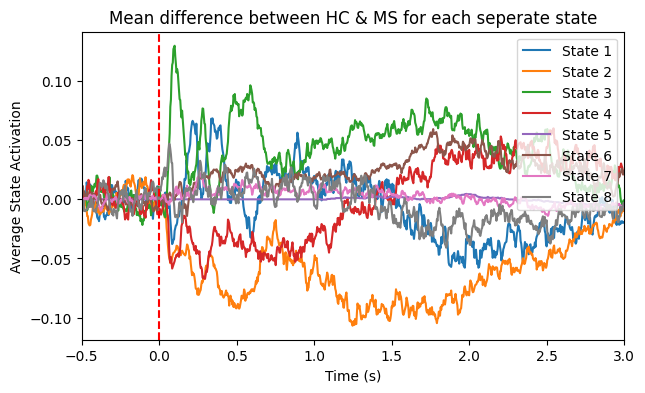

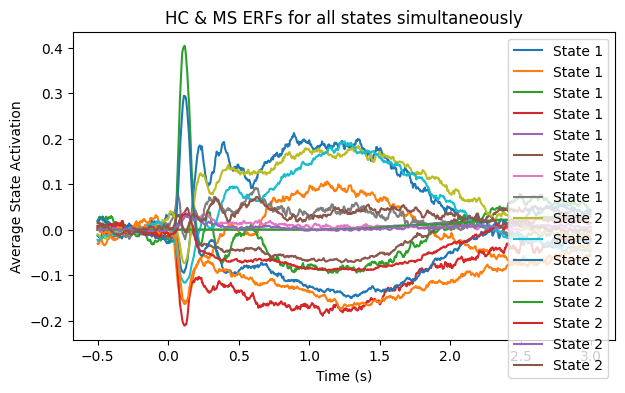

In [74]:
# ex. for state 1
epochs_correct_control = [subj_stc_epochs[sub] for sub in range(len(subj_stc_epochs)) if sub in df_control_idx]
epochs_correct_ms = [subj_stc_epochs[sub] for sub in range(len(subj_stc_epochs)) if sub in df_ms_idx]

print(np.shape(epochs_correct_control))
print(np.shape(epochs_correct_ms))

group_diff = []
for i in range(n_states):
    group_diff.append(np.mean(epochs_correct_control,axis=0)[:,i] - np.mean(epochs_correct_ms,axis=0)[:,i])

# Plot the visual task
fig, ax = plotting.plot_line(
    [t] * n_states,
    np.array(group_diff),
    labels=[f"State {i}" for i in range(1, n_states + 1)],
    x_range=[-0.5, 3],
    x_label="Time (s)",
    y_label="Average State Activation",
    title = 'Mean difference between HC & MS for each seperate state'
)
ax.axvline(color="r", linestyle="--")

plotting.plot_line(
    [t,t],
    [np.mean(epochs_correct_control, axis=0),np.mean(epochs_correct_ms, axis=0)],
    labels=[f"State {i + 1}" for i in range(2)],
    x_label="Time (s)",
    y_label="Average State Activation",
    title = 'HC & MS ERFs for all states simultaneously'
)

print(np.shape(np.mean(epochs_correct_control,axis=0)))

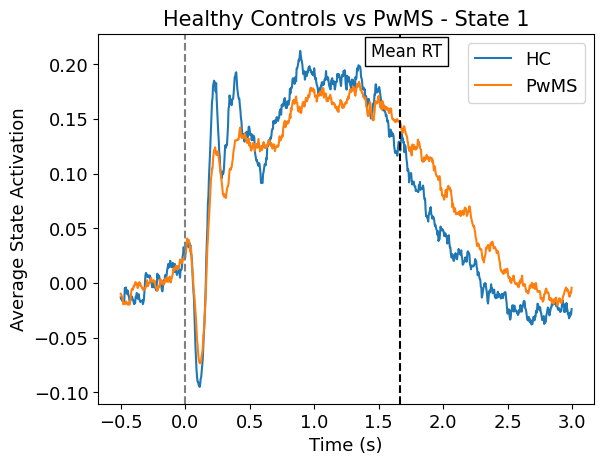

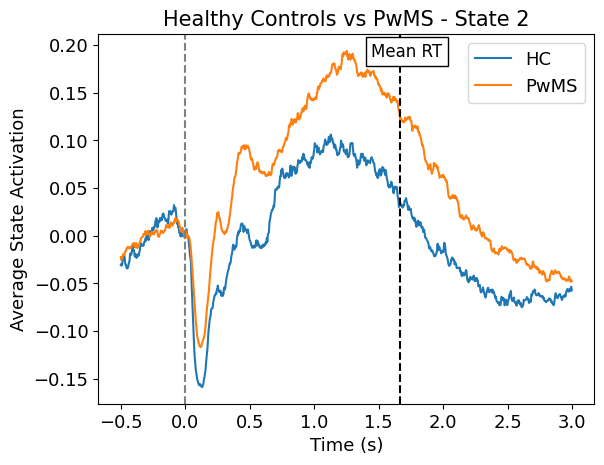

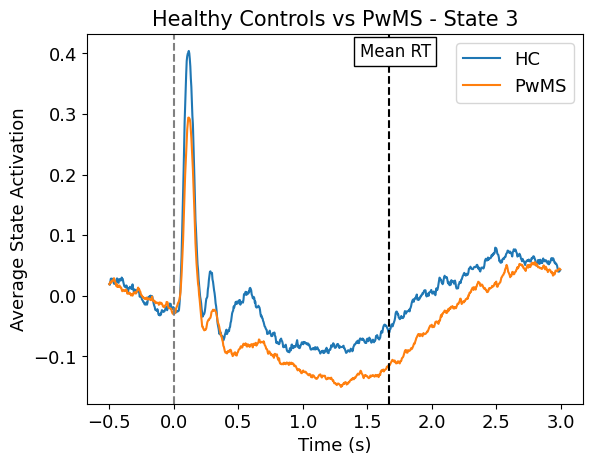

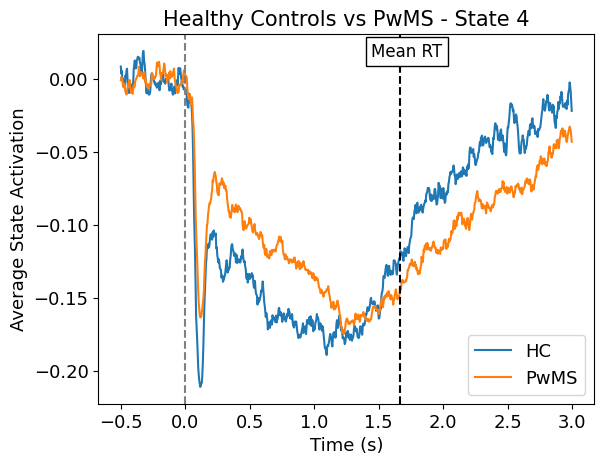

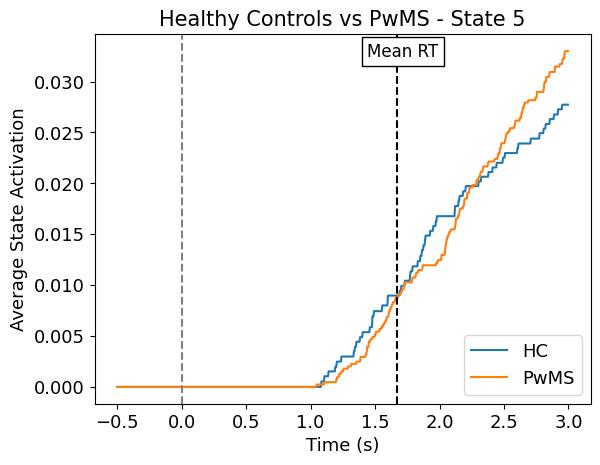

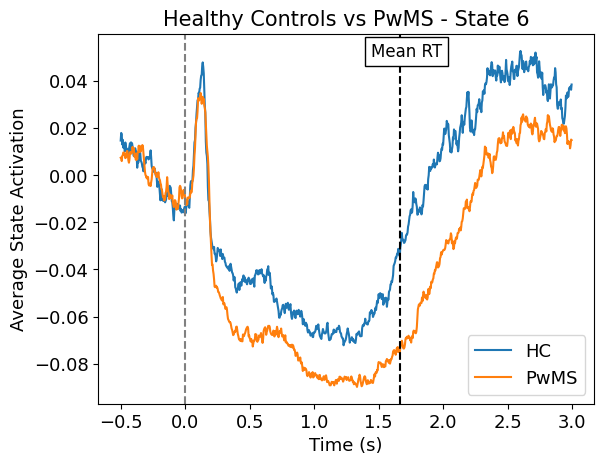

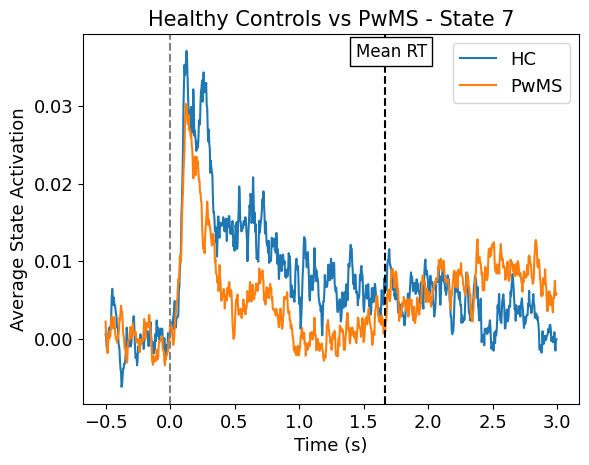

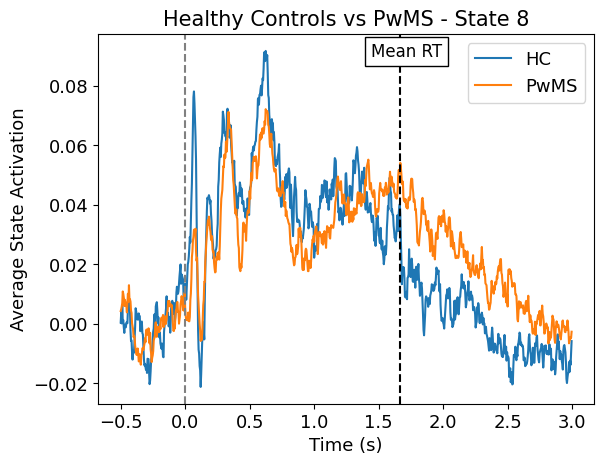

In [75]:
## Plot MS vs. HC per state
for i in range(n_states):
    plt.figure()
    plt.plot(t,np.mean(epochs_correct_control,axis=0)[:,i],label='HC')
    plt.plot(t,np.mean(epochs_correct_ms,axis=0)[:,i],label='PwMS')
    plt.title(f'Healthy Controls vs PwMS - State {i+1}', fontsize=15)
    plt.legend(fontsize=13)
    plt.axvline(color="gray", linestyle="--")
    plt.axvline(x=1.668, color="k", linestyle="--")   # 1,668 is the mean reaction time for all correct trials
    plt.text(0.55, 0.94, 'Mean RT', fontsize = 12, bbox = dict(facecolor = 'white'), transform = plt.gca().transAxes)
    plt.xlabel('Time (s)', fontsize=13)
    plt.ylabel('Average State Activation', fontsize=13)
    
    plt.xticks(fontsize=13)
    plt.yticks(fontsize=13)

In [76]:
## Max stat permutation testing for statistically significant differences
group_diff_pvals = []
for i in range(n_states):
    data_test = subj_stc_epochs[:,:,i]
    print(np.shape(data_test))

    # Do stats testing
    diff, pvalues = statistics.group_diff_max_stat_perm(
        data_test,
        assignments, # uses the group assignments from previous cell
        n_perm=1000,
    )
    group_diff_pvals.append(pvalues)
    print("Number of significant differences:", np.sum(pvalues < 0.05))

(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0


/home/olivierb/.local/lib/python3.9/site-packages/glmtools/fit.py:464: RuntimeWarning: invalid value encountered in divide
  copes / denom,


Using tstats as metric
Number of significant differences: 0
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 1
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0


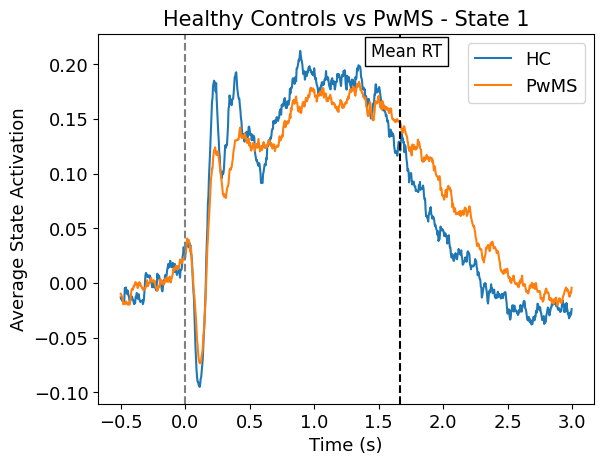

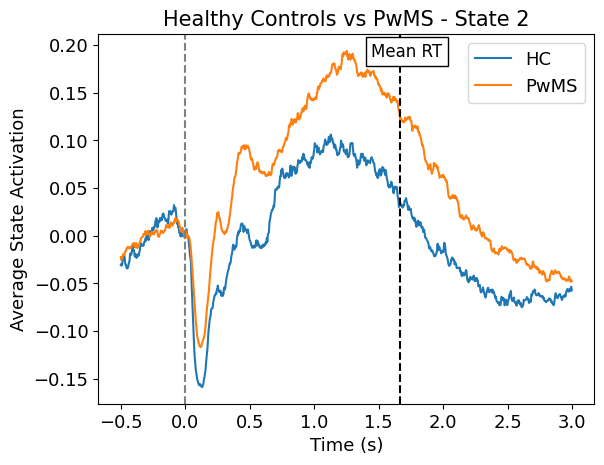

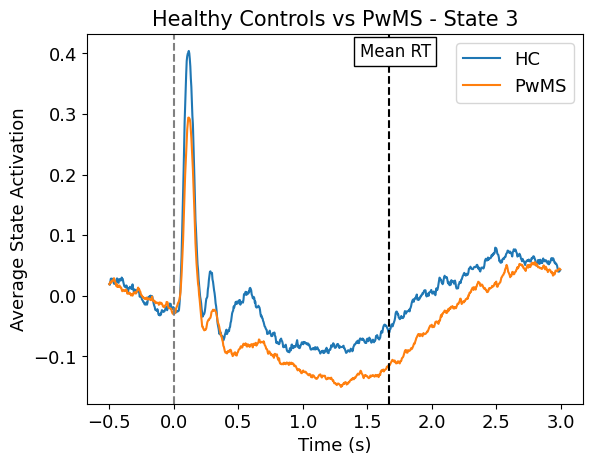

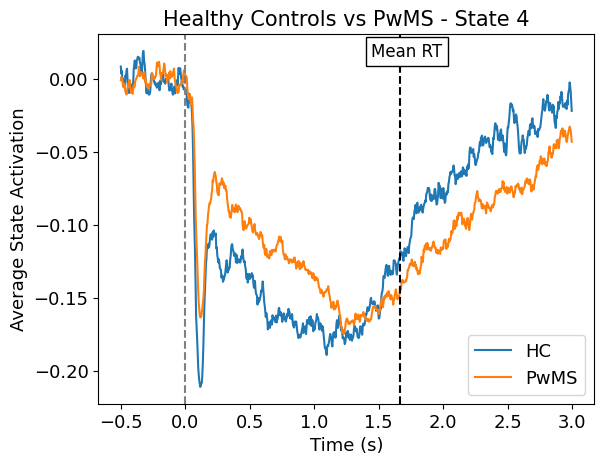

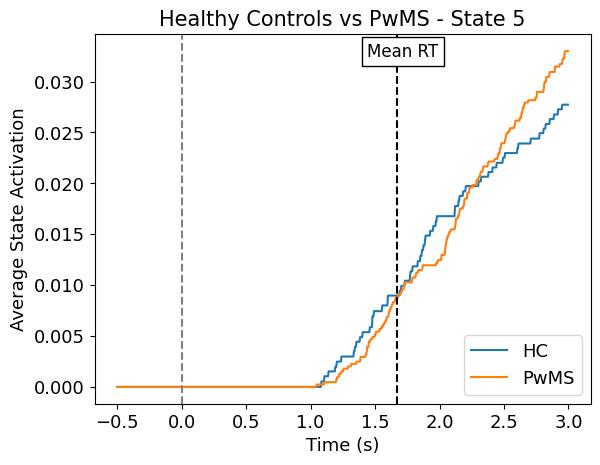

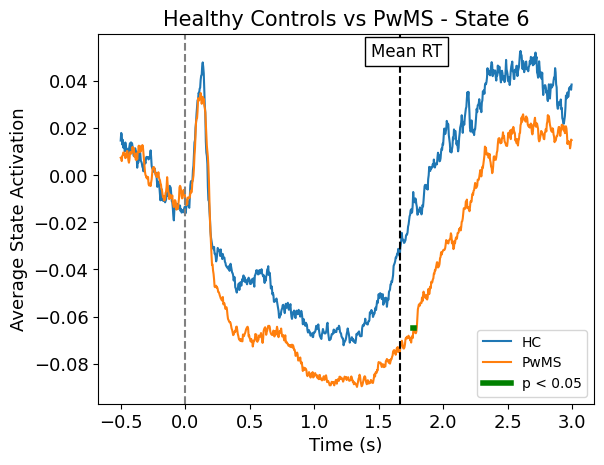

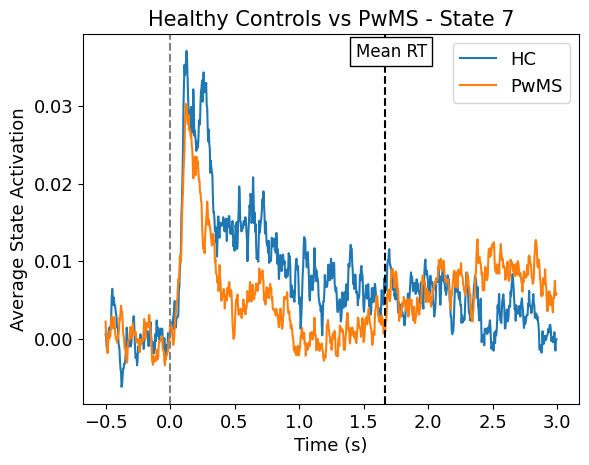

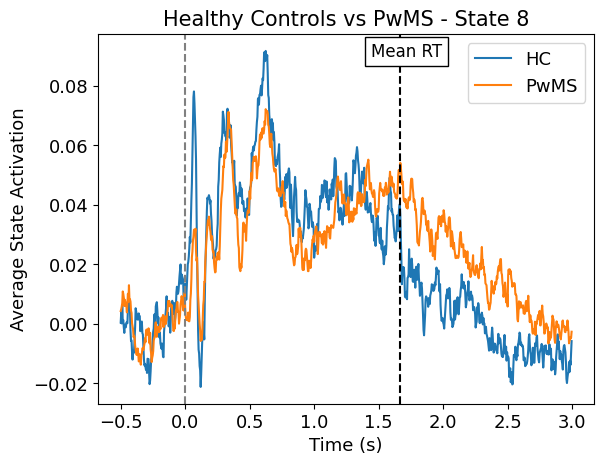

In [77]:
from collections import OrderedDict

## Plot MS vs. HC per state and group comparison stat. sign. diff.
for i in range(n_states):
    plt.figure()
    plt.plot(t,np.mean(epochs_correct_control,axis=0)[:,i],label='HC')
    plt.plot(t,np.mean(epochs_correct_ms,axis=0)[:,i],label='PwMS')
    plt.title(f'Healthy Controls vs PwMS - State {i+1}', fontsize=15)
    plt.xlabel('Time (s)', fontsize=13)
    plt.ylabel('Average State Activation', fontsize=13)
    plt.legend(fontsize=13)
    plt.axvline(color="gray", linestyle="--")
    plt.text(0.55, 0.94, 'Mean RT', fontsize = 12, bbox = dict(facecolor = 'white'), transform = plt.gca().transAxes)    
    plt.xticks(fontsize=13)
    plt.yticks(fontsize=13)
    
    significant = group_diff_pvals[i] < 0.05
    sig_times = t[significant]
    draw = min(np.min(np.mean(epochs_correct_control,axis=0)[:,i]), np.min(np.mean(epochs_correct_ms,axis=0)[:,i]))
    if len(sig_times) > 0:
        dt = t[1] - t[0]
        y = -0.025 + i * 0.01 + draw                 # this value needs to be changed
        for st in sig_times:
            plt.plot((st - dt, st + dt), (y, y), linewidth=4, color='g', label='p < 0.05')
        
        # StackOverflow fix to remove duplicate labels (due to ex. a for loop) in the legend
        handles, labels = plt.gca().get_legend_handles_labels()
        by_label = OrderedDict(zip(labels, handles))
        plt.legend(by_label.values(), by_label.keys())
        
    plt.axvline(x=1.668, color="k", linestyle="--")   # 1,668 is the mean reaction time for all correct trials


## <font color='green'> **For INcorrect trials**

In [78]:
# Extract correct & incorrect trials seperately
timings_filtered_correct = [event_indices_filtered[sub][0] for sub in range(len(event_indices_filtered))]
timings_filtered_incorrect = [event_indices_filtered[sub][1] for sub in range(len(event_indices_filtered))]

### **Aligning the state time course to the event timings**

In [79]:
## 1)
## Pad-locking of alpha (alligning with original MEG timecourse)
# n_embeddings=15 -> 7 (= 15/2 - 1) datapoints are lost from the start and end of each subjet's timeseries
timings_filtered_incorrect_pad = [v - 7 for v in timings_filtered_incorrect]

## 2)
# Substracting this value might lead to the first event occuring as a negative sample index
# This corresponds to an event we chopped off when we time-delay embedded

# Remove events that we missed due to time-delay embedding
timings_filtered_incorrect_pad = [v[v > 0] for v in timings_filtered_incorrect_pad]

## 3)
# We also lose a few data points from the end of each subject's time series due to us separating it into sequences. 
# -> Let's remove events that we cut off when we separated the training data into sequences
timings_filtered_incorrect_pad = [v[v < s.shape[0]] for v,s in zip(timings_filtered_incorrect_pad, stc)]
#print(event_indices_tde)

### Epoch

In [80]:
# Epoch around events
stc_epochs = []
for s, v in zip(stc, timings_filtered_incorrect_pad):                 # filtered INCORRECT and pad-locked alpha!
    stc_epochs.append(task.epoch(s, v, pre=125, post=750))
    
# Concatenate over subjects
concat_stc_epochs = np.concatenate(stc_epochs)
print(concat_stc_epochs.shape)

# Average over epochs
avg_stc_epoch = np.nanmean(concat_stc_epochs, axis=0)
print(avg_stc_epoch.shape)

(6858, 875, 8)
(875, 8)


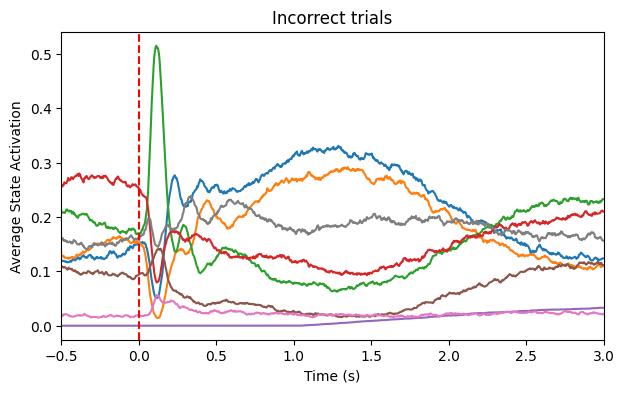

In [81]:
n_states = avg_stc_epoch.shape[1]  # number of states
t = (np.arange(avg_stc_epoch.shape[0]) - 250/2) / fs  # time axis

# Plot the visual task
fig, ax = plotting.plot_line(
    [t] * n_states,
    avg_stc_epoch.T,
    x_range=[-0.5, 3],
    x_label="Time (s)",
    y_label="Average State Activation",
    title="Incorrect trials"
)
ax.axvline(color="r", linestyle="--")

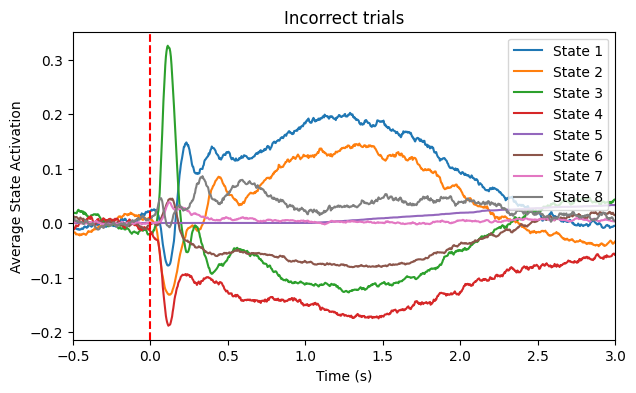

In [82]:
# Calculate the baseline
pre = 125  # number of samples before the event
base_corr = np.nanmean(avg_stc_epoch[:pre], axis=0, keepdims=True)

# Remove it from the epoched state time courses
corr_avg_stc_epoch = avg_stc_epoch - base_corr

# Plot the visual task
fig, ax = plotting.plot_line(
    [t] * n_states,
    corr_avg_stc_epoch.T,
    labels=[f"State {i}" for i in range(1, n_states + 1)],
    x_range=[-0.5, 3],
    x_label="Time (s)",
    y_label="Average State Activation",
    title='Incorrect trials'
)
ax.axvline(color="r", linestyle="--")

In [83]:
from osl_dynamics.analysis import statistics

# We already have the trial specific epochs separated by subjects in stc_epochs,
# we just need to average each subject's trials separately
subj_stc_epochs = []
for epochs in stc_epochs:
    subj_stc_epochs.append(np.nanmean(epochs, axis=0))
subj_stc_epochs = np.array(subj_stc_epochs)
print(subj_stc_epochs.shape)

# Baseline correct using the samples before the event
subj_stc_epochs -= np.mean(subj_stc_epochs[:, :pre], axis=1, keepdims=True)

# Calculate p-values
pvalues = statistics.evoked_response_max_stat_perm(subj_stc_epochs, n_perm=1000)
print(pvalues.shape)

# Do any time points/states come out as significant?
print("Number of time points with at least 1 state with p-value < 0.05:", np.sum(np.any(pvalues < 0.05, axis=-1)))

(110, 875, 8)
Permuting contrast <class 'glmtools.design.Contrast'>(Mean,MainEffect) with mode=sign-flip
	Computing 1000 permutations
	Taking max-stat across ['time', 'features 1'] dimensions
Using copes as metric
(875, 8)
Number of time points with at least 1 state with p-value < 0.05: 626


(<Figure size 700x400 with 1 Axes>,
 <Axes: title={'center': 'Incorrect trials'}, xlabel='Time (s)', ylabel='Average State Activation'>)

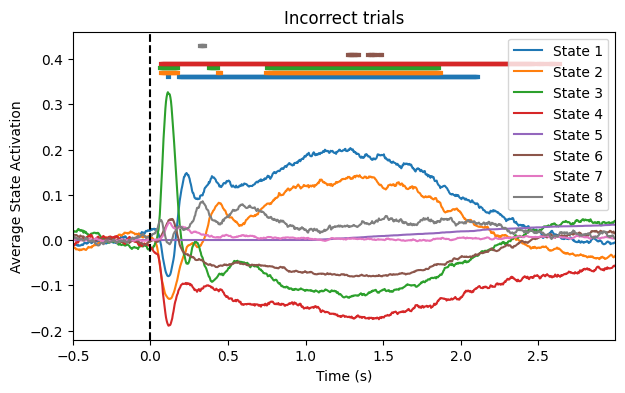

In [84]:
plotting.plot_evoked_response(
    t,
    np.mean(subj_stc_epochs, axis=0),
    pvalues,
    labels=[f"State {i + 1}" for i in range(subj_stc_epochs.shape[-1])],
    significance_level=0.05,
    x_label="Time (s)",
    y_label="Average State Activation",
    title="Incorrect trials",
)

(110, 875, 8)
(110, 875, 7)


Text(0.5, 1.0, "States' timecourses - Inorrect trials - All subjects")

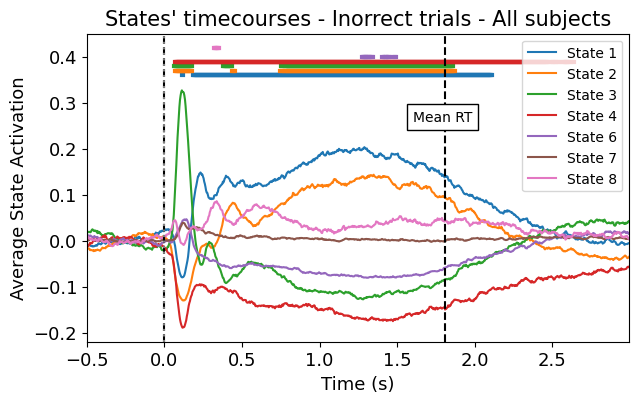

In [85]:
print(np.shape(subj_stc_epochs))

subj_stc_epochs_NEW = subj_stc_epochs[:][:,:, np.array([True, True, True, True, False, True, True, True])]
print(subj_stc_epochs_NEW.shape)

pvalues_NEW = pvalues[:][:, np.array([True, True, True, True, False, True, True, True])]

plotting.plot_evoked_response(
    t,
    np.mean(subj_stc_epochs_NEW, axis=0),
    pvalues_NEW,
    labels=[f"State {i + 1}" for i in [0,1,2,3,5,6,7]],
    significance_level=0.05,
    x_label="Time (s)",
    y_label="Average State Activation",
    title="States' timecourses - Incorrect trials - All subjects"
)
plt.axvline(color="gray", linestyle="dotted")
plt.axvline(x=1.81, color="k", linestyle="--")   # 1,668 is the mean reaction time for all incorrect trials
plt.text(1.60, 0.26, 'Mean RT', fontsize = 10, bbox = dict(facecolor = 'white'))

plt.xlabel("Time (s)", fontsize=13)
plt.ylabel("Average State Activation", fontsize=13)
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)
plt.title("States' timecourses - Inorrect trials - All subjects", fontsize=15)

### **Group comparison (HC vs. MS)**

(37, 875, 8)
(73, 875, 8)
(875, 8)


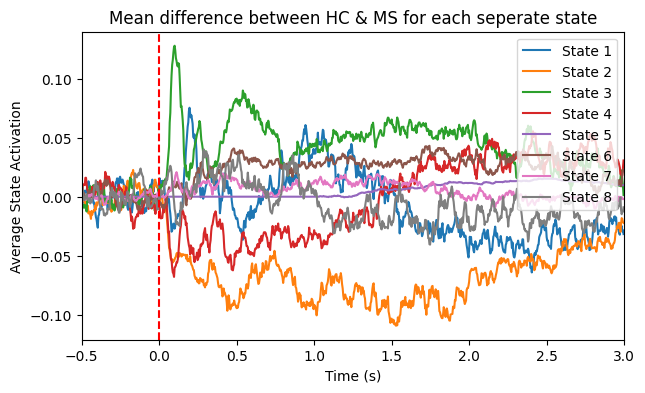

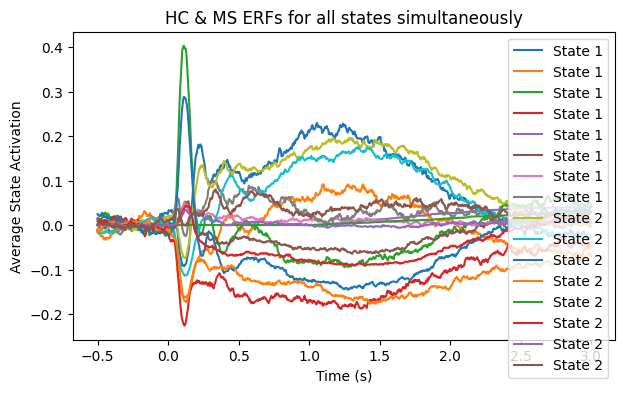

In [86]:
# ex. for state 1
epochs_incorrect_control = [subj_stc_epochs[sub] for sub in range(len(subj_stc_epochs)) if sub in df_control_idx]
epochs_incorrect_ms = [subj_stc_epochs[sub] for sub in range(len(subj_stc_epochs)) if sub in df_ms_idx]

print(np.shape(epochs_incorrect_control))
print(np.shape(epochs_incorrect_ms))

group_diff = []
for i in range(n_states):
    group_diff.append(np.mean(epochs_incorrect_control,axis=0)[:,i] - np.mean(epochs_incorrect_ms,axis=0)[:,i])

# Plot the visual task
fig, ax = plotting.plot_line(
    [t] * n_states,
    np.array(group_diff),
    labels=[f"State {i}" for i in range(1, n_states + 1)],
    x_range=[-0.5, 3],
    x_label="Time (s)",
    y_label="Average State Activation",
    title = 'Mean difference between HC & MS for each seperate state'
)
ax.axvline(color="r", linestyle="--")

plotting.plot_line(
    [t,t],
    [np.mean(epochs_incorrect_control, axis=0),np.mean(epochs_incorrect_ms, axis=0)],
    labels=[f"State {i + 1}" for i in range(2)],
    x_label="Time (s)",
    y_label="Average State Activation",
    title = 'HC & MS ERFs for all states simultaneously'
)

print(np.shape(np.mean(epochs_incorrect_control,axis=0)))

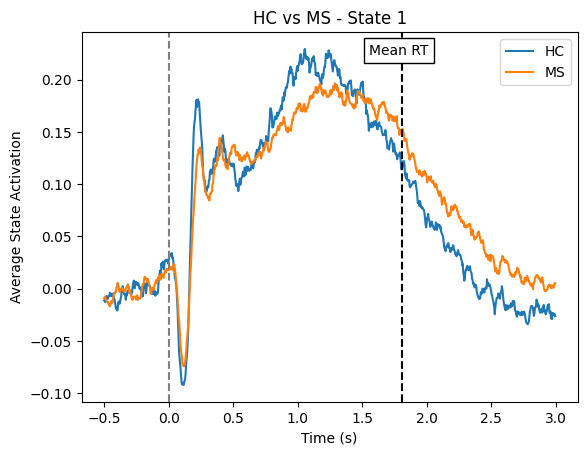

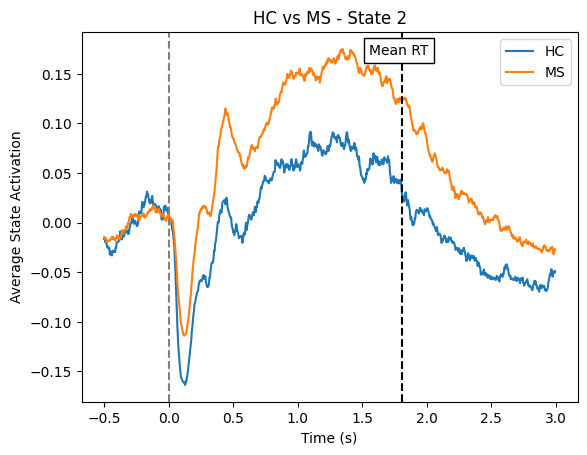

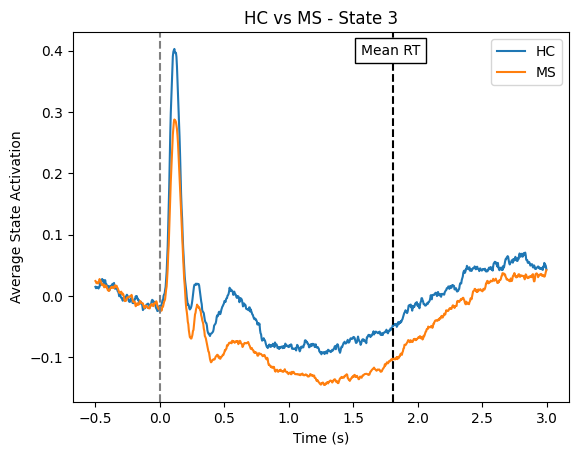

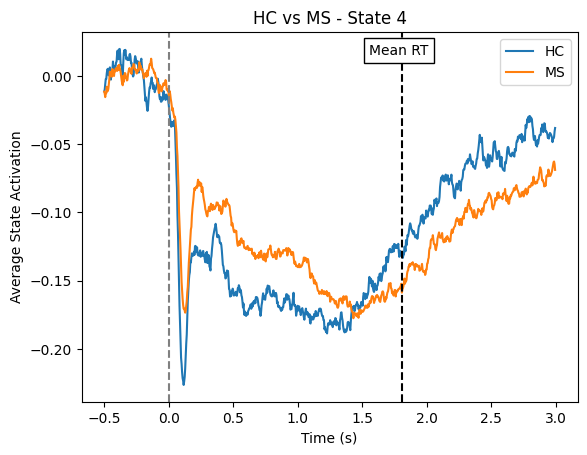

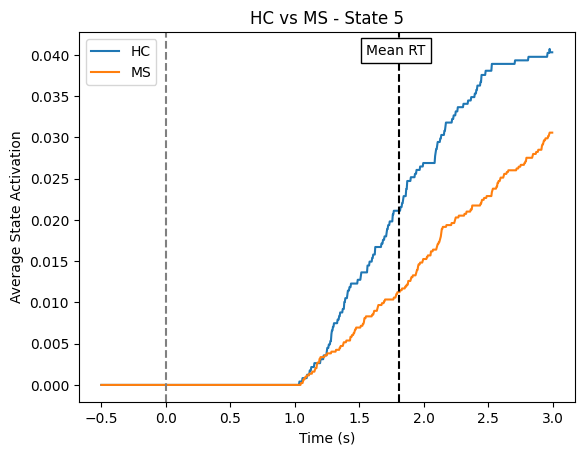

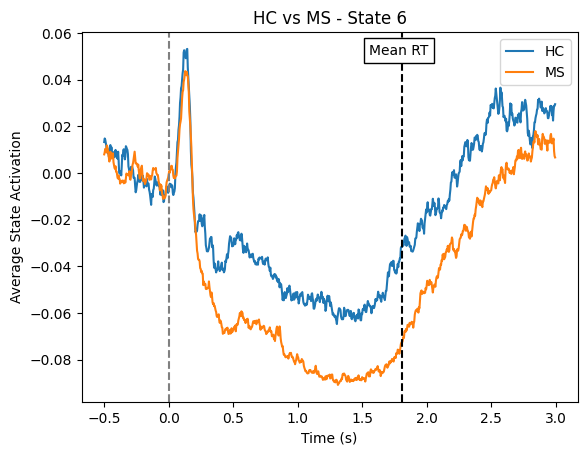

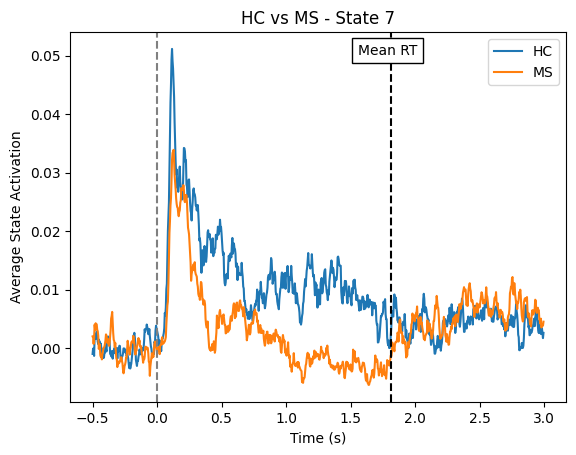

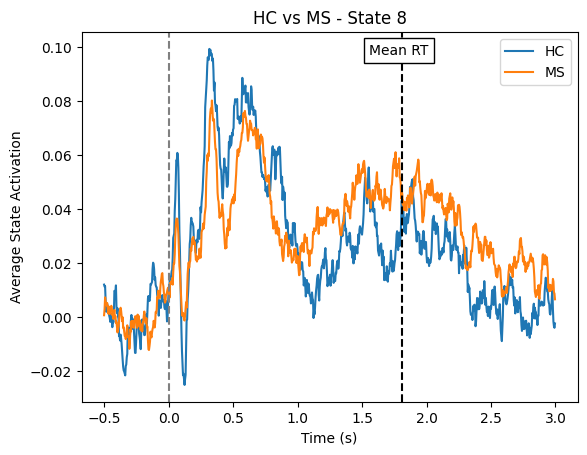

In [87]:
## Plot MS vs. HC per state
for i in range(n_states):
    plt.figure()
    plt.plot(t,np.mean(epochs_incorrect_control,axis=0)[:,i],label='HC')
    plt.plot(t,np.mean(epochs_incorrect_ms,axis=0)[:,i],label='MS')
    plt.title(f'HC vs MS - State {i+1}')
    plt.legend()
    plt.axvline(color="gray", linestyle="--")
    plt.axvline(x=1.81, color="k", linestyle="--")   # 1,668 is the mean reaction time for all incorrect trials
    plt.text(0.58, 0.94, 'Mean RT', fontsize = 10, bbox = dict(facecolor = 'white'), transform = plt.gca().transAxes)
    plt.xlabel('Time (s)')
    plt.ylabel('Average State Activation')

In [88]:
## Max stat permutation testing for statistically significant differences
group_diff_pvals = []
for i in range(n_states):
    data_test = subj_stc_epochs[:,:,i]
    print(np.shape(data_test))

    # Do stats testing
    diff, pvalues = statistics.group_diff_max_stat_perm(
        data_test,
        assignments, # uses the group assignments from previous cell
        n_perm=1000,
    )
    group_diff_pvals.append(pvalues)
    print("Number of significant differences:", np.sum(pvalues < 0.05))

(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0


/home/olivierb/.local/lib/python3.9/site-packages/glmtools/fit.py:464: RuntimeWarning: invalid value encountered in divide
  copes / denom,


Using tstats as metric
Number of significant differences: 36
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(110, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 1000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0


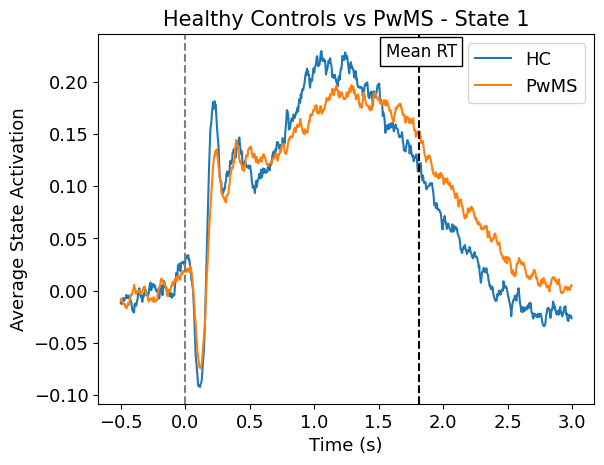

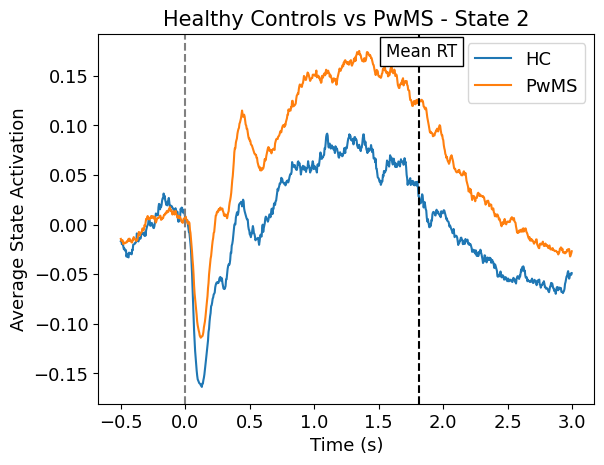

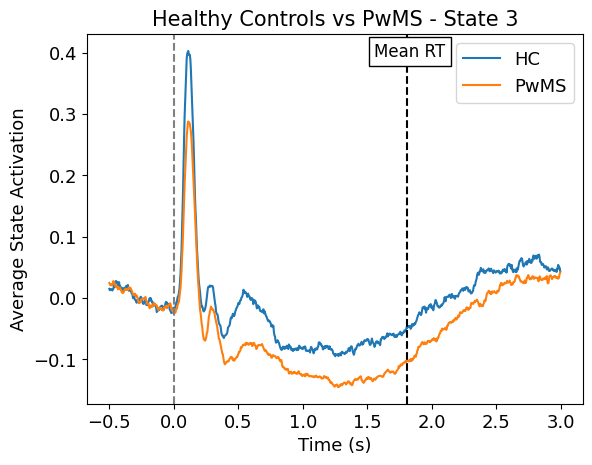

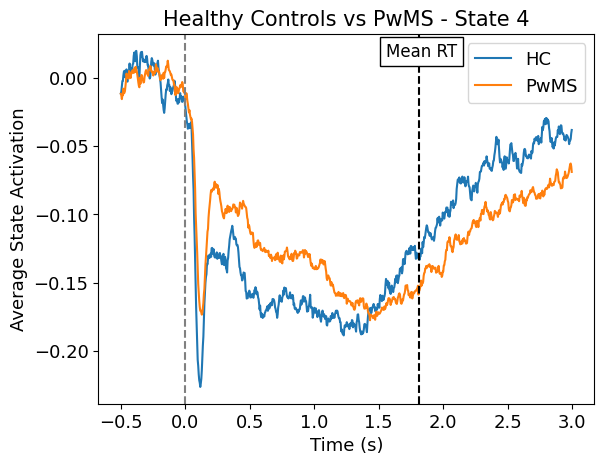

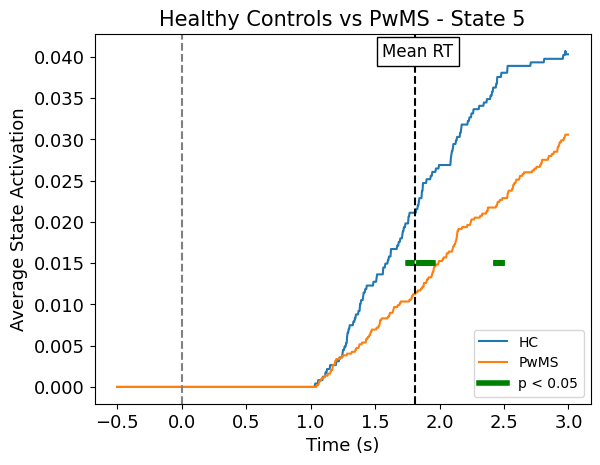

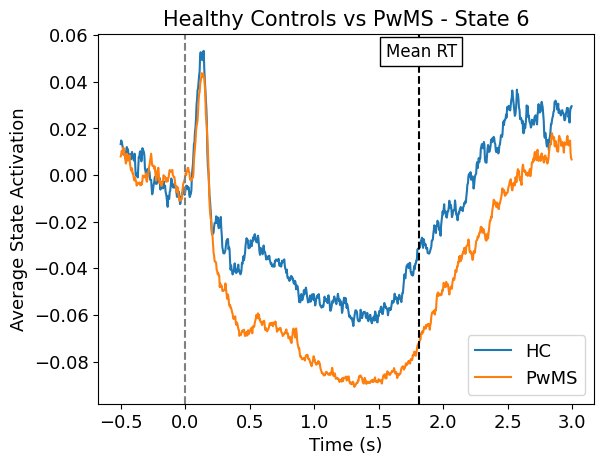

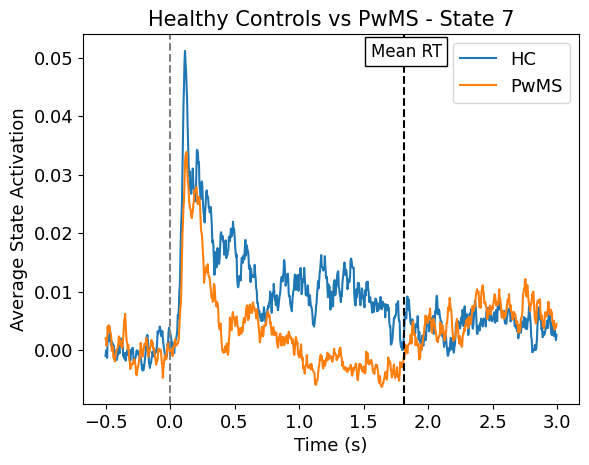

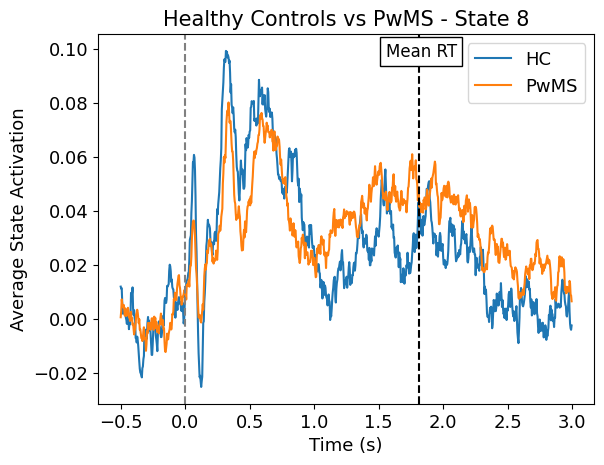

In [89]:
from collections import OrderedDict

## Plot MS vs. HC per state and group comparison stat. sign. diff.
for i in range(n_states):
    plt.figure()
    plt.plot(t,np.mean(epochs_incorrect_control,axis=0)[:,i],label='HC')
    plt.plot(t,np.mean(epochs_incorrect_ms,axis=0)[:,i],label='PwMS')
    plt.title(f'Healthy Controls vs PwMS - State {i+1}', fontsize=15)
    plt.axvline(color="gray", linestyle="--")
    
    plt.xlabel('Time (s)', fontsize=13)
    plt.ylabel('Average State Activation', fontsize=13)
    plt.legend(fontsize=13)
    plt.xticks(fontsize=13)
    plt.yticks(fontsize=13)

    significant = group_diff_pvals[i] < 0.05
    sig_times = t[significant]
    draw = min(np.min(np.mean(epochs_incorrect_control,axis=0)[:,i]), np.min(np.mean(epochs_incorrect_ms,axis=0)[:,i]))
    if len(sig_times) > 0:
        dt = t[1] - t[0]
        y = -0.025 + i * 0.01 + draw                 # this value needs to be changed
        for st in sig_times:
            plt.plot((st - dt, st + dt), (y, y), linewidth=4, color='g', label='p < 0.05')
        
        # StackOverflow fix to remove duplicate labels (due to ex. a for loop) in the legend
        handles, labels = plt.gca().get_legend_handles_labels()
        by_label = OrderedDict(zip(labels, handles))
        plt.legend(by_label.values(), by_label.keys())
        
    plt.axvline(x=1.81, color="k", linestyle="--")   # 1,668 is the mean reaction time for all incorrect trials
    plt.text(0.58, 0.94, 'Mean RT', fontsize = 12, bbox = dict(facecolor = 'white'), transform = plt.gca().transAxes)

## <font color='green'> **For CORRECTS vs. INCORRECT trials (all subjects)**

In [90]:
# Epoch around events
stc_epochs_correct = []
for s, v in zip(stc, timings_filtered_correct_pad):                 
    stc_epochs_correct.append(task.epoch(s, v, pre=125, post=750))

stc_epochs_incorrect = []
for s, v in zip(stc, timings_filtered_incorrect_pad):                 
    stc_epochs_incorrect.append(task.epoch(s, v, pre=125, post=750))   
    
# Concatenate over subjects
concat_stc_epochs_correct = np.concatenate(stc_epochs_correct)
concat_stc_epochs_incorrect = np.concatenate(stc_epochs_incorrect)

# Average over epochs
avg_stc_epoch_correct = np.nanmean(concat_stc_epochs_correct, axis=0)
avg_stc_epoch_incorrect = np.nanmean(concat_stc_epochs_incorrect, axis=0)

# Baseline correct
base_corr = np.nanmean(avg_stc_epoch_correct[:pre], axis=0, keepdims=True)
base_incorr = np.nanmean(avg_stc_epoch_incorrect[:pre], axis=0, keepdims=True)

# Remove it from the epoched state time courses
avg_stc_epoch_correct = avg_stc_epoch_correct - base_corr
avg_stc_epoch_incorrect = avg_stc_epoch_incorrect - base_incorr

In [91]:
print(np.shape(avg_stc_epoch_correct))
print(np.shape(avg_stc_epoch_incorrect))

(875, 8)
(875, 8)


### **All subjects**

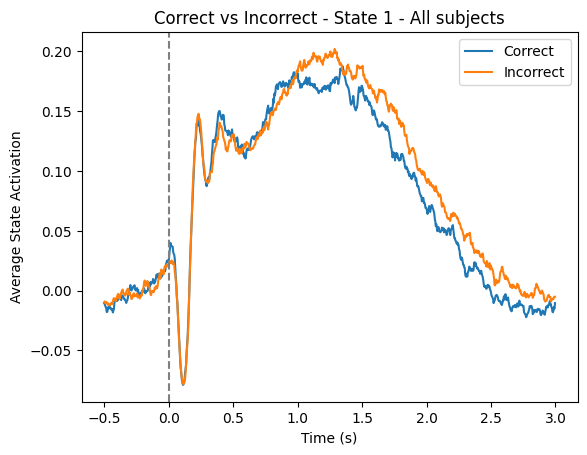

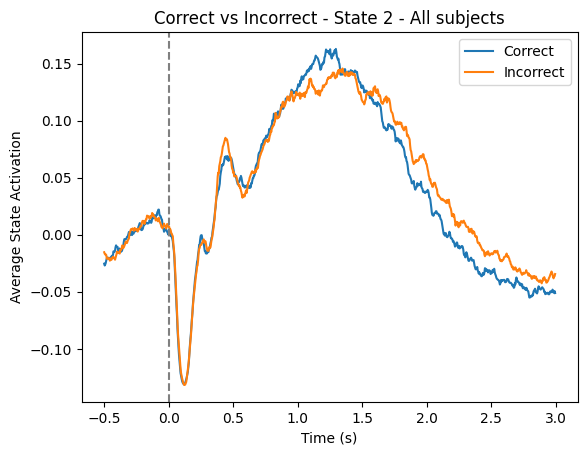

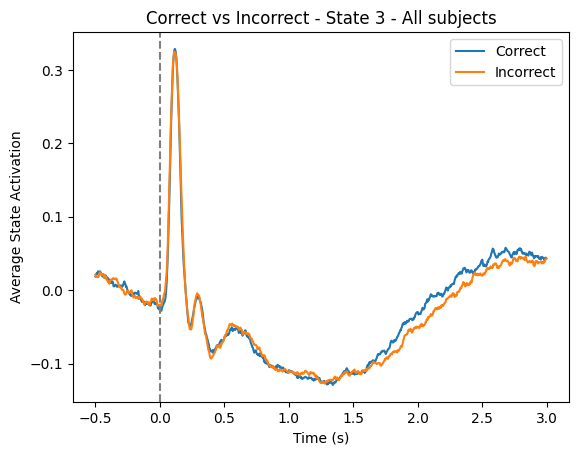

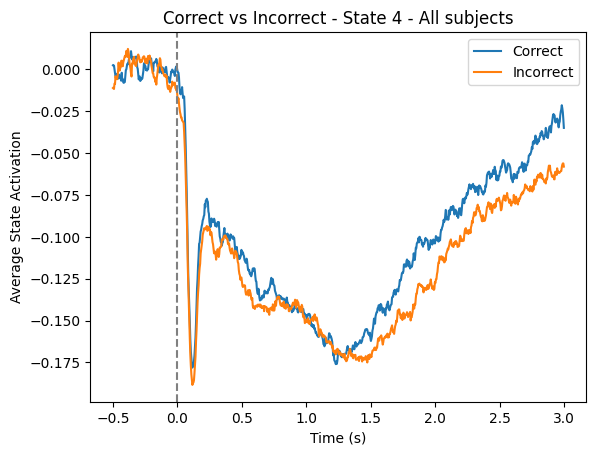

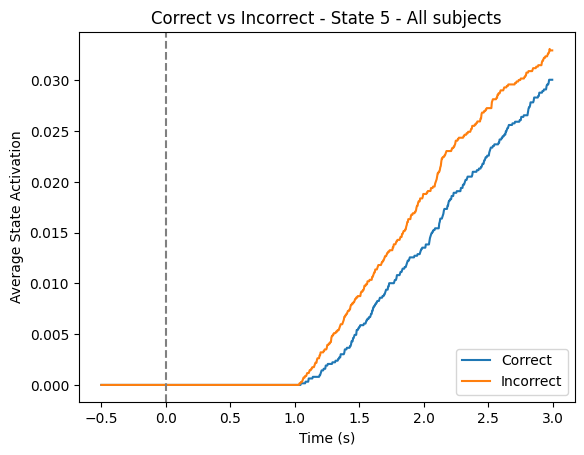

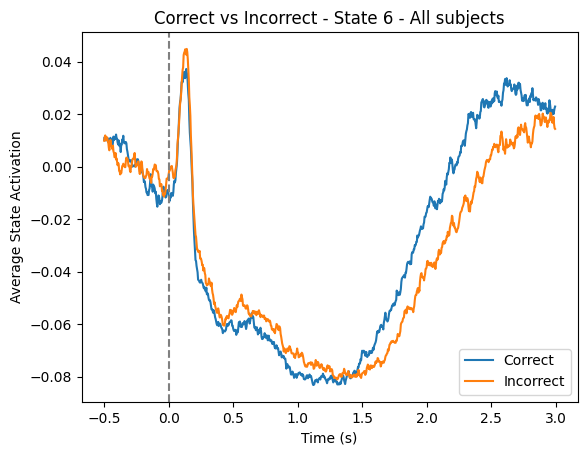

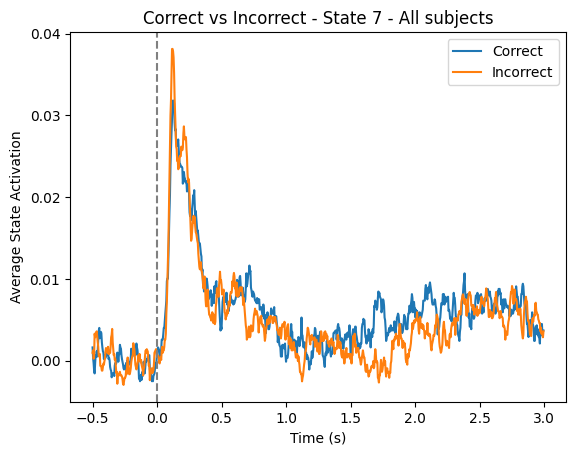

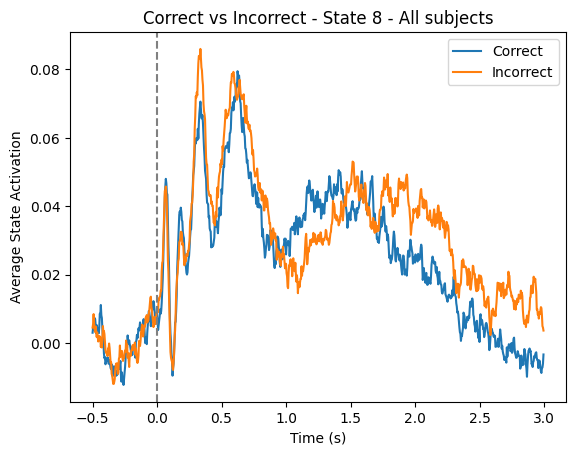

In [92]:
fs = 250
n_states = avg_stc_epoch_correct.shape[1]  # number of states
t = (np.arange(avg_stc_epoch_correct.shape[0]) - 250/2) / fs  # time axis

## Plot Correct vs. Incorrect per state (over all subjects)
for i in range(n_states):
    plt.figure()
    plt.plot(t,avg_stc_epoch_correct[:,i],label='Correct')
    plt.plot(t,avg_stc_epoch_incorrect[:,i],label='Incorrect')
    plt.title(f'Correct vs Incorrect - State {i+1} - All subjects')
    plt.legend()
    plt.axvline(color="gray", linestyle="--")
    plt.xlabel('Time (s)')
    plt.ylabel('Average State Activation')

In [93]:
## Get lists for subject-averages of the data, i.e. average correct and average incorrect epoch per subject 
print(np.shape(concat_stc_epochs_correct))

from osl_dynamics.analysis import statistics

# We already have the trial specific epochs separated by subjects in stc_epochs,
# we just need to average each subject's trials separately
subj_stc_epochs_correct = []
subj_stc_epochs_incorrect = []

for epochs in stc_epochs_correct:
    subj_stc_epochs_correct.append(np.nanmean(epochs, axis=0))
subj_stc_epochs_correct = np.array(subj_stc_epochs_correct)
print(subj_stc_epochs_correct.shape)

for epochs in stc_epochs_incorrect:
    subj_stc_epochs_incorrect.append(np.nanmean(epochs, axis=0))
subj_stc_epochs_incorrect = np.array(subj_stc_epochs_incorrect)
print(subj_stc_epochs_incorrect.shape)

# Baseline correct using the samples before the event
pre = 125  # number of samples before the event
subj_stc_epochs_correct -= np.mean(subj_stc_epochs_correct[:, :pre], axis=1, keepdims=True)
subj_stc_epochs_incorrect -= np.mean(subj_stc_epochs_incorrect[:, :pre], axis=1, keepdims=True)

## Need to make 1 single data_test array which has 110 x 2 elements [1, 1, 1, 1, ..., 1, 2, 2, 2, ..., 2]
concatenated_epochs_corr_incorr = np.concatenate((subj_stc_epochs_correct, subj_stc_epochs_incorrect))
print(np.shape(concatenated_epochs_corr_incorr))

assignments_all = []
for i in range(len(concatenated_epochs_corr_incorr)):
    if i < int(len(concatenated_epochs_corr_incorr)/2):
        assignments_all.append(1)
    else:
        assignments_all.append(2)

(6287, 875, 8)
(110, 875, 8)
(110, 875, 8)
(220, 875, 8)


In [94]:
## Max stat permutation testing for statistically significant differences
stimulus_type_diff_pvals = []
for i in range(n_states):
    data_test = concatenated_epochs_corr_incorr[:,:,i]
    print(np.shape(data_test))

    # Do stats testing
    diff, pvalues = statistics.group_diff_max_stat_perm(
        data_test,
        assignments_all, 
        n_perm=5000,
    )
    stimulus_type_diff_pvals.append(pvalues)
    print("Number of significant differences:", np.sum(pvalues < 0.05))

(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 2


/home/olivierb/.local/lib/python3.9/site-packages/glmtools/fit.py:464: RuntimeWarning: invalid value encountered in divide
  copes / denom,


Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0


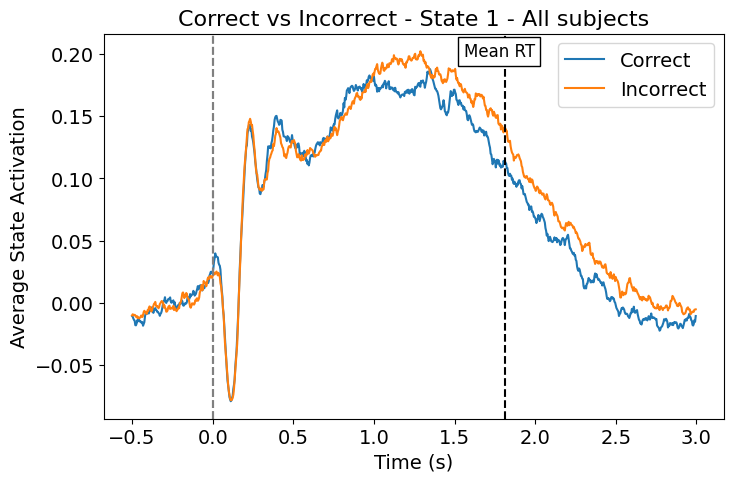

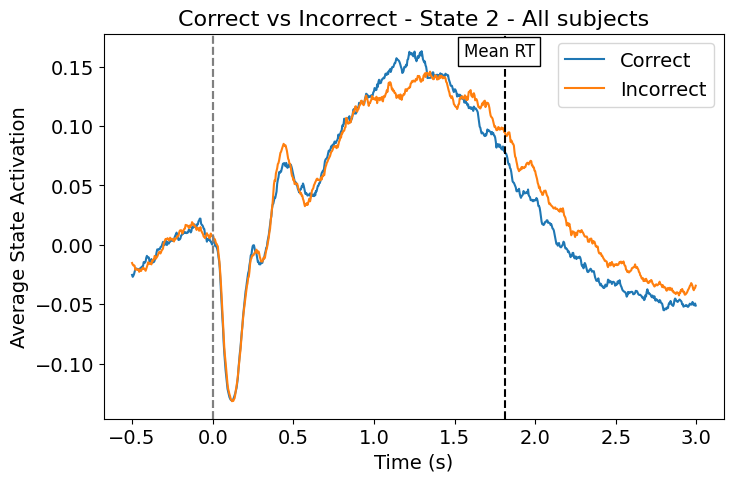

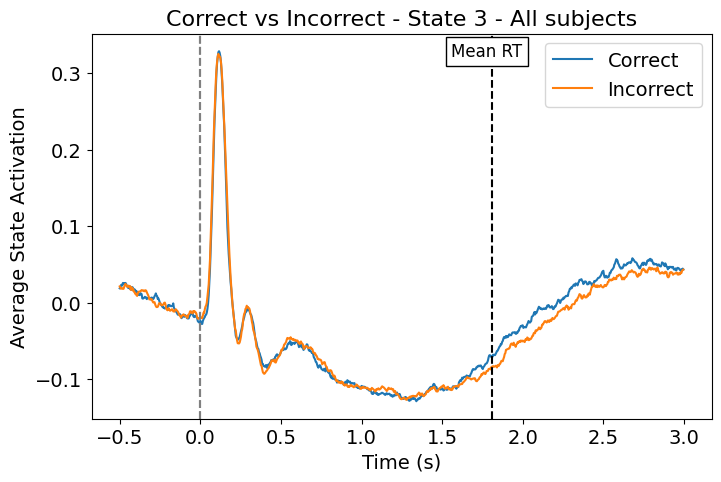

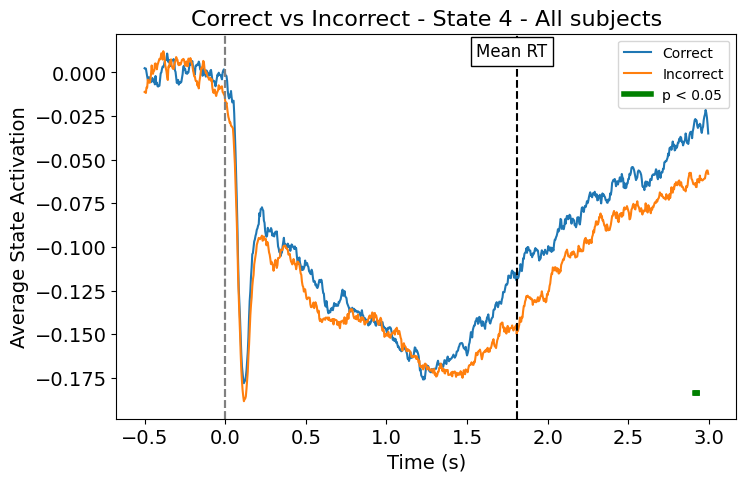

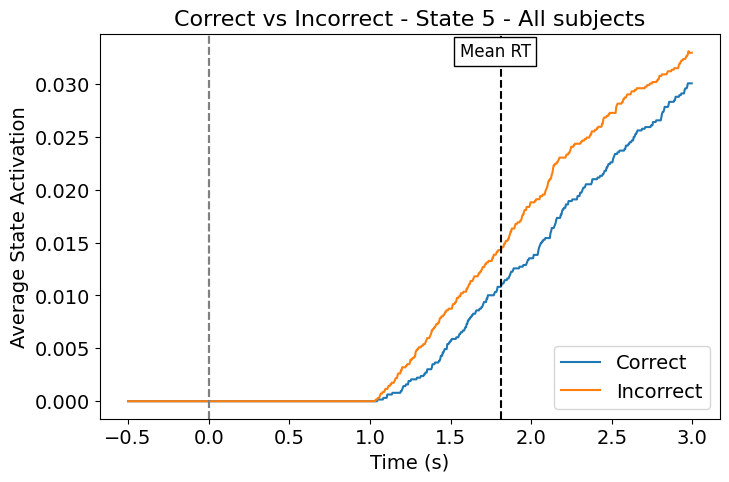

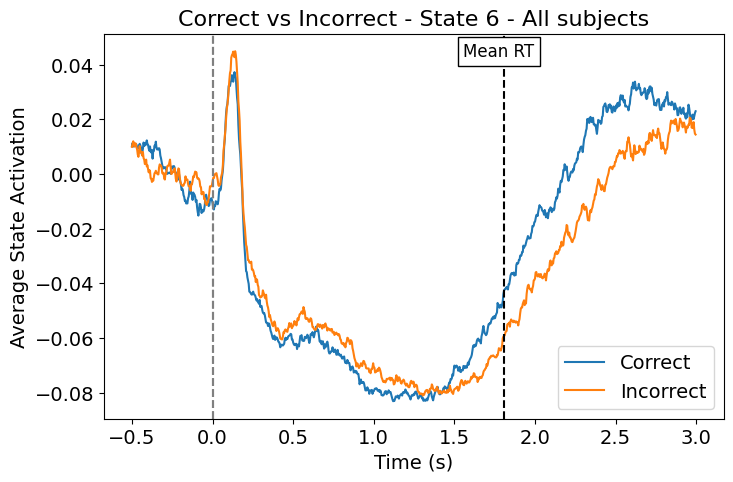

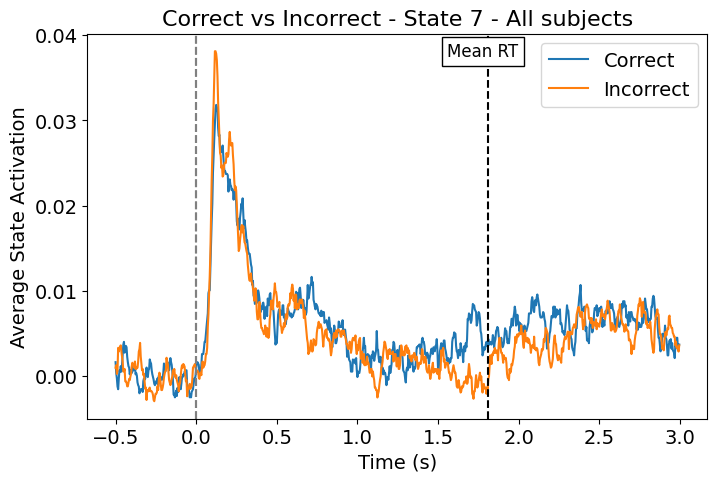

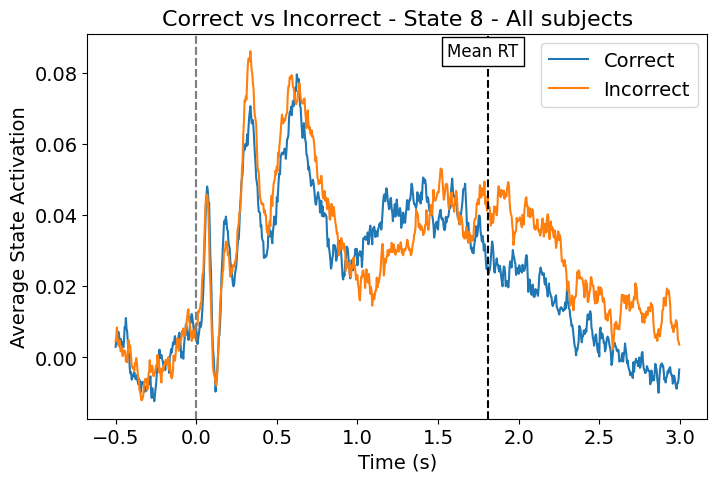

In [95]:
from collections import OrderedDict

## Plot RRMS vs. HC per state and group comparison stat. sign. diff.
for i in range(n_states):
    plt.figure(figsize=(8,5))
    plt.plot(t,avg_stc_epoch_correct[:,i],label='Correct')
    plt.plot(t,avg_stc_epoch_incorrect[:,i],label='Incorrect')
    plt.title(f'Correct vs Incorrect - State {i+1} - All subjects', fontsize=16)
    plt.axvline(color="gray", linestyle="--")

    plt.axvline(color="gray", linestyle="--")
    
    plt.xlabel('Time (s)', fontsize=14)
    plt.ylabel('Average State Activation', fontsize=14)
    plt.legend(fontsize=14)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)

    plt.axvline(x=1.81, color="k", linestyle="--")   # 1,668 is the mean reaction time for all incorrect trials
    plt.text(0.58, 0.94, 'Mean RT', fontsize = 12, bbox = dict(facecolor = 'white'), transform = plt.gca().transAxes)
    
    significant = stimulus_type_diff_pvals[i] < 0.05
    sig_times = t[significant]
    draw = min(np.min(avg_stc_epoch_correct[:,i]), np.min(avg_stc_epoch_incorrect[:,i]))
    if len(sig_times) > 0:
        dt = t[1] - t[0]
        y = -0.025 + i * 0.01 + draw                 # this value needs to be changed
        for st in sig_times:
            plt.plot((st - dt, st + dt), (y, y), linewidth=4, color='g', label='p < 0.05')
        
        # StackOverflow fix to remove duplicate labels (due to ex. a for loop) in the legend
        handles, labels = plt.gca().get_legend_handles_labels()
        by_label = OrderedDict(zip(labels, handles))
        plt.legend(by_label.values(), by_label.keys())

### **Only HC**

In [96]:
assignments_HC = []
for i in range(len(concatenated_epochs_corr_incorr)):
    if i < int(len(concatenated_epochs_corr_incorr)/2):
        if i in df_control_idx: 
            assignments_HC.append(1)
        else:
            assignments_HC.append(0)
    else:
        if i in np.array(df_control_idx) + int(len(concatenated_epochs_corr_incorr)/2):
            assignments_HC.append(2)
        else:
            assignments_HC.append(0)

In [97]:
## Max stat permutation testing for statistically significant differences
stimulus_type_diff_pvals_HC = []
for i in range(n_states):
    data_test = concatenated_epochs_corr_incorr[:,:,i]
    print(np.shape(data_test))

    # Do stats testing
    diff, pvalues = statistics.group_diff_max_stat_perm(
        data_test,
        assignments_HC, 
        n_perm=5000,
    )
    stimulus_type_diff_pvals_HC.append(pvalues)
    print("Number of significant differences:", np.sum(pvalues < 0.05))

(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0


/home/olivierb/.local/lib/python3.9/site-packages/glmtools/fit.py:464: RuntimeWarning: invalid value encountered in divide
  copes / denom,


Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0


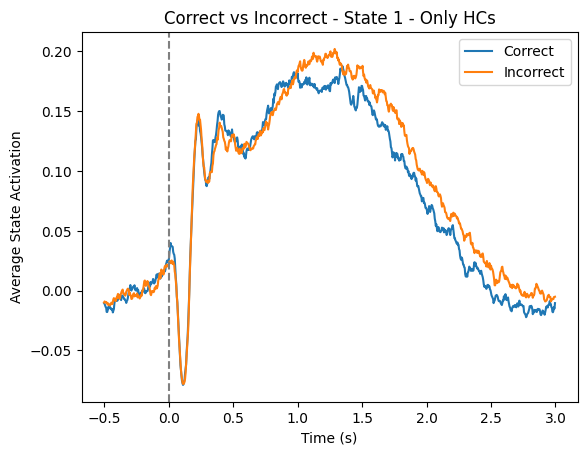

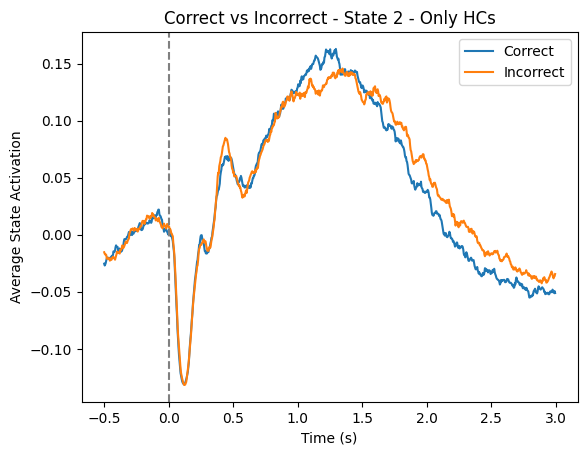

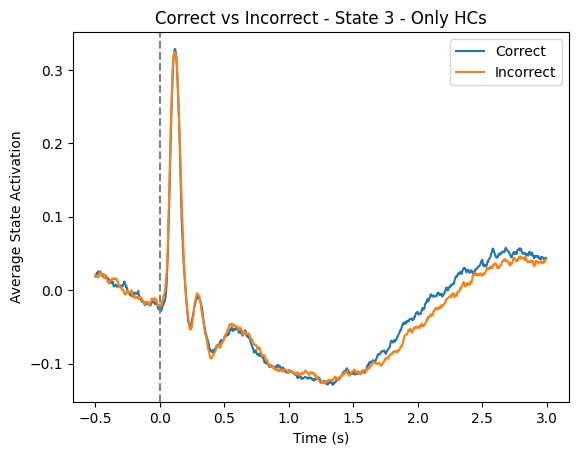

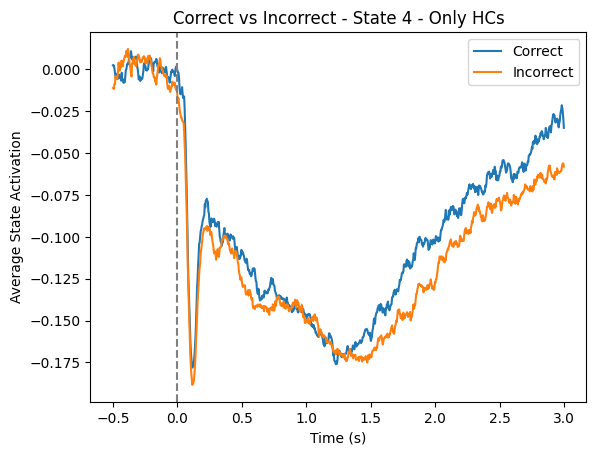

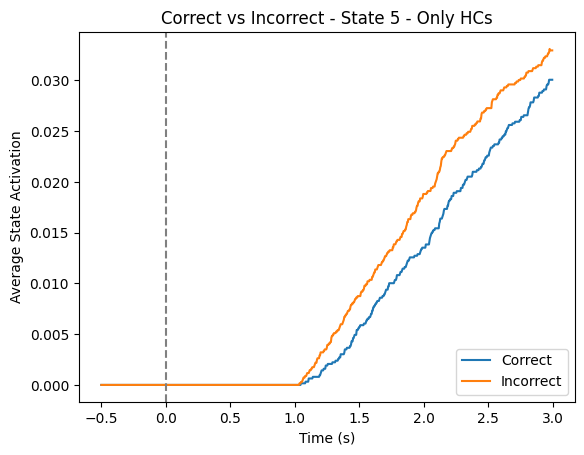

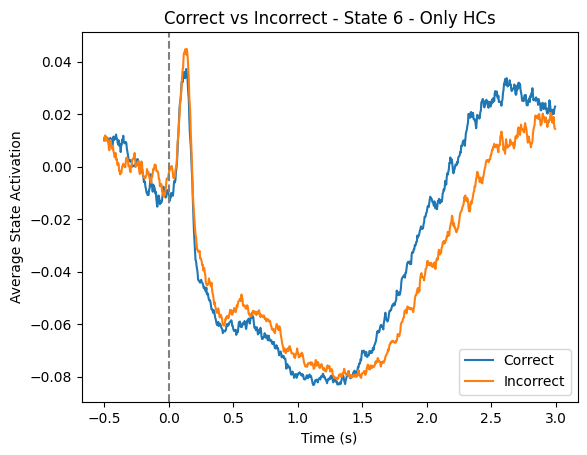

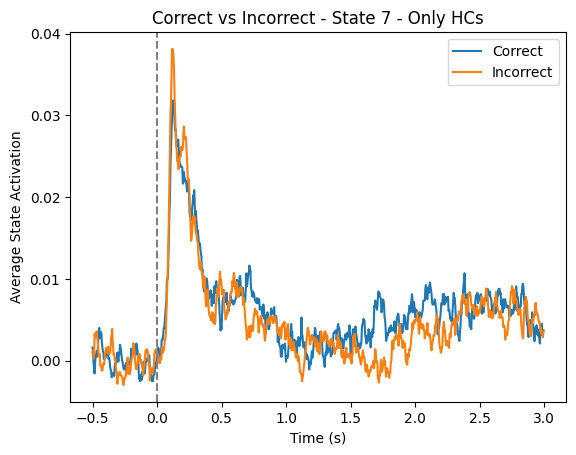

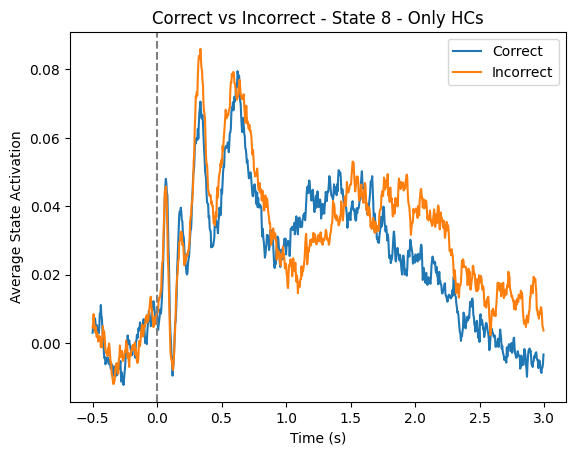

In [98]:
from collections import OrderedDict

## Plot RRMS vs. HC per state and group comparison stat. sign. diff.
for i in range(n_states):
    plt.figure()
    plt.plot(t,avg_stc_epoch_correct[:,i],label='Correct')
    plt.plot(t,avg_stc_epoch_incorrect[:,i],label='Incorrect')
    plt.title(f'Correct vs Incorrect - State {i+1} - Only HCs')
    plt.xlabel('Time (s)')
    plt.ylabel('Average State Activation')
    plt.legend()
    plt.axvline(color="gray", linestyle="--")

    significant = stimulus_type_diff_pvals_HC[i] < 0.05
    sig_times = t[significant]
    draw = min(np.min(avg_stc_epoch_correct[:,i]), np.min(avg_stc_epoch_incorrect[:,i]))
    if len(sig_times) > 0:
        dt = t[1] - t[0]
        y = -0.025 + i * 0.01 + draw                 # this value needs to be changed
        for st in sig_times:
            plt.plot((st - dt, st + dt), (y, y), linewidth=4, color='g', label='p < 0.05')
        
        # StackOverflow fix to remove duplicate labels (due to ex. a for loop) in the legend
        handles, labels = plt.gca().get_legend_handles_labels()
        by_label = OrderedDict(zip(labels, handles))
        plt.legend(by_label.values(), by_label.keys())

### **Only MS**

In [99]:
assignments_MS = []
for i in range(len(concatenated_epochs_corr_incorr)):
    if i < int(len(concatenated_epochs_corr_incorr)/2):
        if i in df_ms_idx: 
            assignments_MS.append(1)
        else:
            assignments_MS.append(0)
    else:
        if i in np.array(df_control_idx) + int(len(concatenated_epochs_corr_incorr)/2):
            assignments_MS.append(2)
        else:
            assignments_MS.append(0)

In [100]:
## Max stat permutation testing for statistically significant differences
stimulus_type_diff_pvals_MS = []
for i in range(n_states):
    data_test = concatenated_epochs_corr_incorr[:,:,i]
    print(np.shape(data_test))

    # Do stats testing
    diff, pvalues = statistics.group_diff_max_stat_perm(
        data_test,
        assignments_MS, 
        n_perm=5000,
    )
    stimulus_type_diff_pvals_MS.append(pvalues)
    print("Number of significant differences:", np.sum(pvalues < 0.05))

(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 1
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 1


/home/olivierb/.local/lib/python3.9/site-packages/glmtools/fit.py:464: RuntimeWarning: invalid value encountered in divide
  copes / denom,


Using tstats as metric
Number of significant differences: 106
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0
(220, 875)
Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 5000 permutations
	Taking max-stat across ['features 1'] dimensions
Using tstats as metric
Number of significant differences: 0


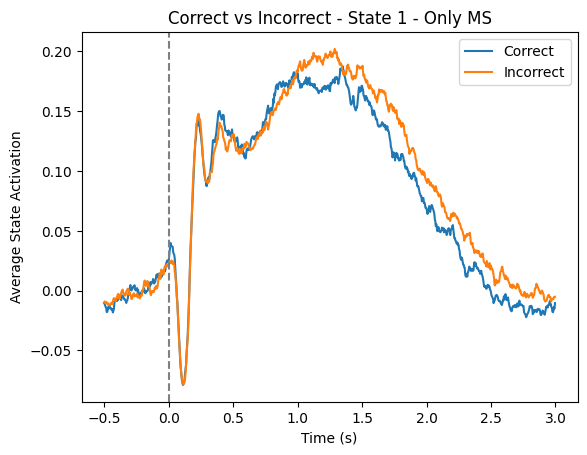

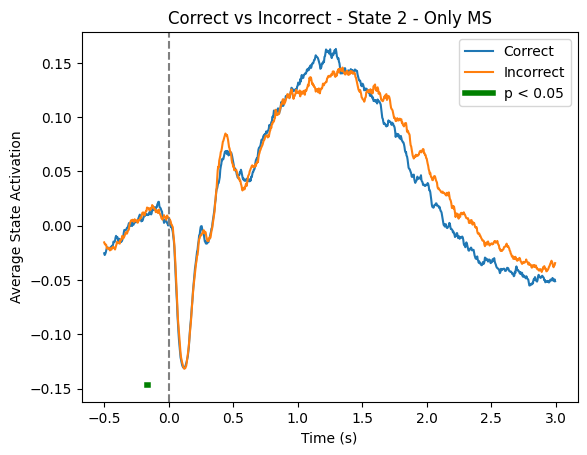

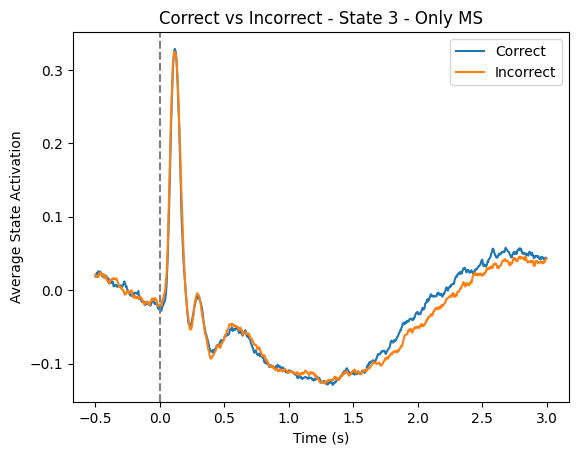

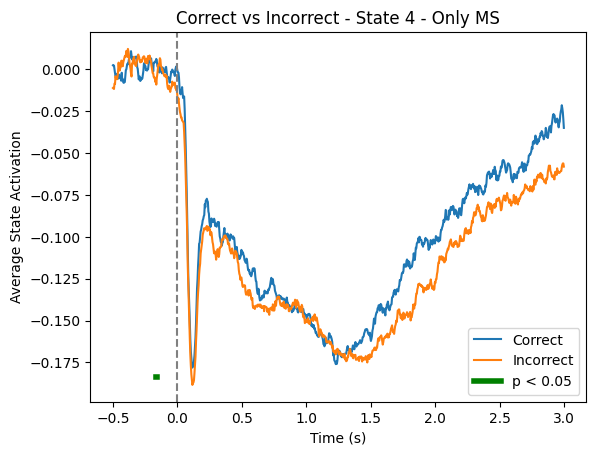

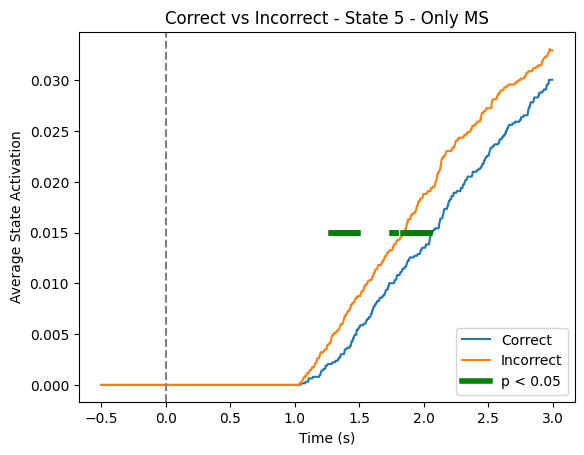

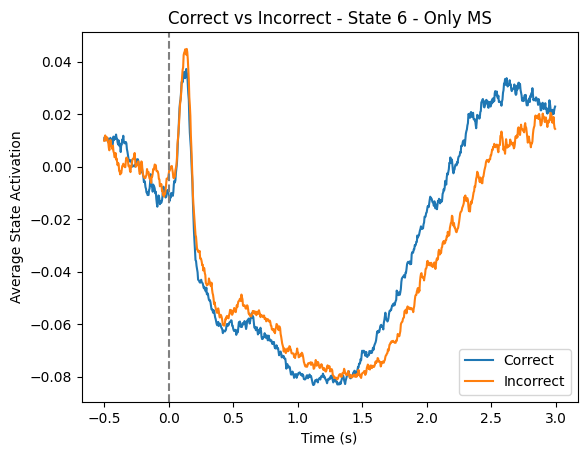

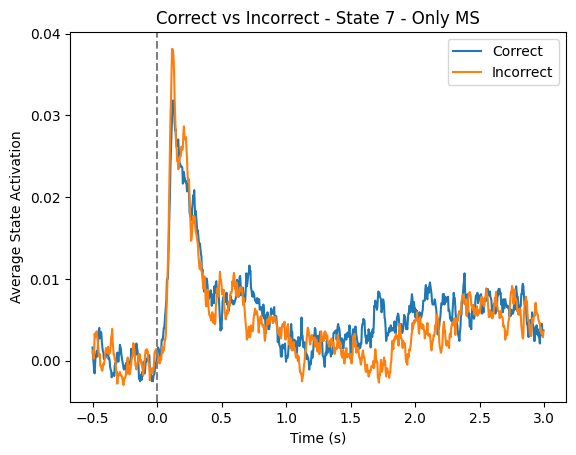

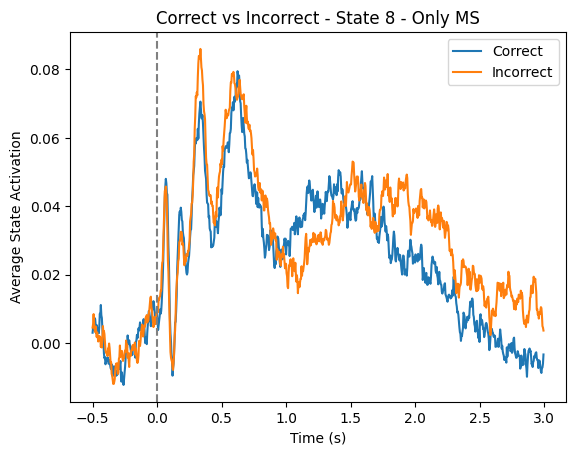

In [101]:
from collections import OrderedDict

## Plot RRMS vs. HC per state and group comparison stat. sign. diff.
for i in range(n_states):
    plt.figure()
    plt.plot(t,avg_stc_epoch_correct[:,i],label='Correct')
    plt.plot(t,avg_stc_epoch_incorrect[:,i],label='Incorrect')
    plt.title(f'Correct vs Incorrect - State {i+1} - Only MS')
    plt.xlabel('Time (s)')
    plt.ylabel('Average State Activation')
    plt.legend()
    plt.axvline(color="gray", linestyle="--")

    significant = stimulus_type_diff_pvals_MS[i] < 0.05
    sig_times = t[significant]
    draw = min(np.min(avg_stc_epoch_correct[:,i]), np.min(avg_stc_epoch_incorrect[:,i]))
    if len(sig_times) > 0:
        dt = t[1] - t[0]
        y = -0.025 + i * 0.01 + draw                 # this value needs to be changed
        for st in sig_times:
            plt.plot((st - dt, st + dt), (y, y), linewidth=4, color='g', label='p < 0.05')
        
        # StackOverflow fix to remove duplicate labels (due to ex. a for loop) in the legend
        handles, labels = plt.gca().get_legend_handles_labels()
        by_label = OrderedDict(zip(labels, handles))
        plt.legend(by_label.values(), by_label.keys())

# **3. Spatial Power maps & Coherence Networks**

1. Calculate power spectra & coherences **between [1-45] Hz ==> This range can be chosen, and for preprocessing I used 0.01-70 Hz...**
2. Plot power spectra - per state
3. Plot power spectra - substract static power
4. Extract data-driven approach - spectral components
4. State power maps **per relevant spectral component**
    - SC1 (delta 1-4 Hz & theta 4-8 Hz)
    - SC2 (alpha 8-12 Hz)
    - SC3 beta (13-30 Hz)n_weights=True,  # weighting for each subject when we average the spectra
5. Group differences **per oscillatory band**

### First, calculate **power spectra & coherences** (this step also is a bit **time-consuming**)

In [18]:
from osl_dynamics.analysis import spectral

model = load(model_name)
data = model.get_training_time_series(training_data, prepared=False)

# Calculate multitaper spectra for each state and subject (will take a few minutes)
f, psd, coh, w = spectral.multitaper_spectra(
    data=data,
    alpha=alpha,
    sampling_frequency=250,
    time_half_bandwidth=4,
    n_tapers=7,
    frequency_range=[1, 45],
    return_weights=True,   # weighting for each subject when we average the spectra
    # can be chosen freely here -> set to [0,01 - 70] Hz ?????????????
)

2024-05-06 08:18:02 INFO osl-dynamics [mod_base.py:589:load]: Loading model: Dynamic_Models/HMM_TDE_ALL_8states_25epochs
Calculating spectra: 100%|██████████| 110/110 [58:59<00:00, 32.18s/it] 


In [19]:
# Saving as numpy files
import numpy as np
np.save(model_name + "/data/f.npy", f)
np.save(model_name + "/data/psd.npy", psd)
np.save(model_name + "/data/coh.npy", coh)
np.save(model_name + "/data/w.npy", w)

print(f.shape)
print(psd.shape)
print(coh.shape)
print(w.shape)

(88,)
(110, 8, 38, 88)
(110, 8, 38, 38, 88)
(110,)


In [105]:
# Load in saved f, psd, coh
f = np.load(model_name + "/data/f.npy")
psd = np.load(model_name + "/data/psd.npy")
coh = np.load(model_name + "/data/coh.npy")
w = np.load(model_name + "/data/w.npy")
#wb_comp = np.load(model_name + "/data/nnmf.npy")  # (n_components, n_freq)

### **Data-driven approach to find frequency bands ==> Spectral factorization (Non-Negative Matrix Fractorization, NNMF)**

#### Here you also choose <font color='red'> n_components (= 4)

### **Try out 4 Spectral Components**

In [106]:
from osl_dynamics.analysis import spectral

# Perform NNMF on the coherence spectra of each subject (we concatenate each matrix)
wb_comp = spectral.decompose_spectra(coh, n_components=4) # into 4 frequency bands
print(wb_comp.shape)

2024-05-06 12:27:40 INFO osl-dynamics [spectral.py:895:decompose_spectra]: Performing spectral decomposition


(4, 88)


In [107]:
np.save(model_name + "/data/wb_comp.npy", wb_comp)

(<Figure size 700x400 with 1 Axes>,
 <Axes: title={'center': 'Data-driven Spectral Components'}, xlabel='Frequency (Hz)', ylabel='Spectral Component'>)

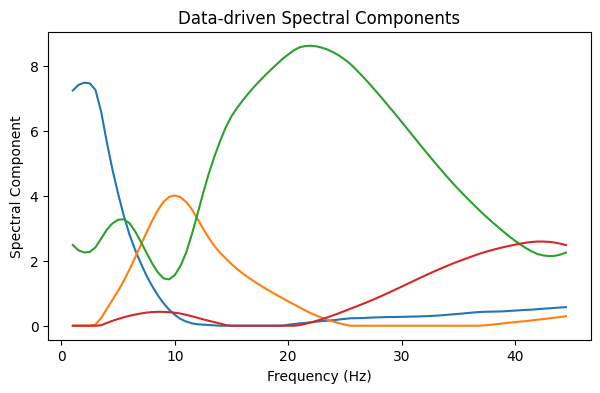

In [108]:
from osl_dynamics.utils import plotting

plotting.plot_line(
    [f, f, f, f],  # we need to repeat 4x because 4 components were fitted
    wb_comp,
    x_label="Frequency (Hz)",
    y_label="Spectral Component",
    title="Data-driven Spectral Components"
)

#np.save(model_name + "/data/nnmf.npy", wb_comp)

#### **a few extra plots using the Spectral Components**

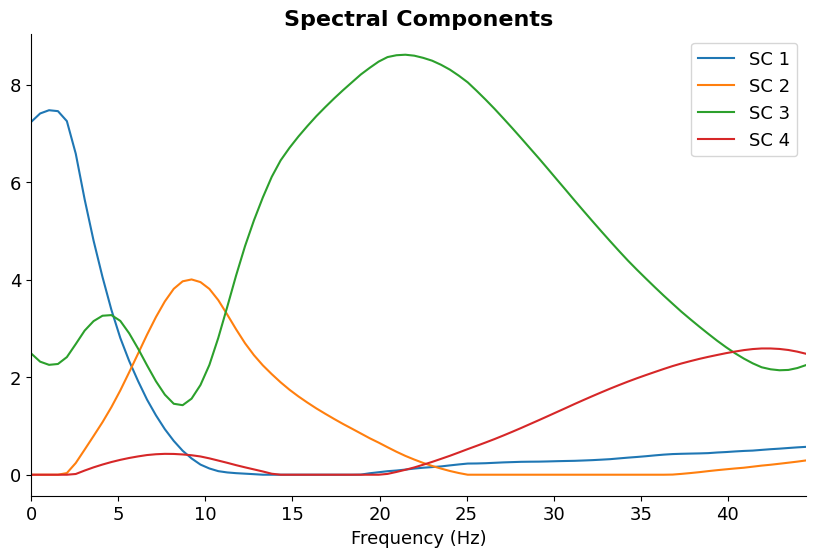

In [109]:
f_plot = np.linspace(0, f[-1], len(wb_comp[0]))
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red']
plt.figure(figsize=(10,6))

# Plot all spectral components:
for sc in range(len(wb_comp)):
    plt.plot(f_plot, wb_comp[sc], color=colors[sc], label=f'SC {sc+1}')

plt.xlabel('Frequency (Hz)', fontsize=13)
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)
plt.xlim([0,f_plot[-1]])
plt.title('Spectral Components' , weight='bold', fontsize=16)
plt.gca().spines['top'].set_visible(False)    # Hide the top spine
plt.gca().spines['right'].set_visible(False)  # Hide the right spine
plt.legend(fontsize=13)
plt.show()

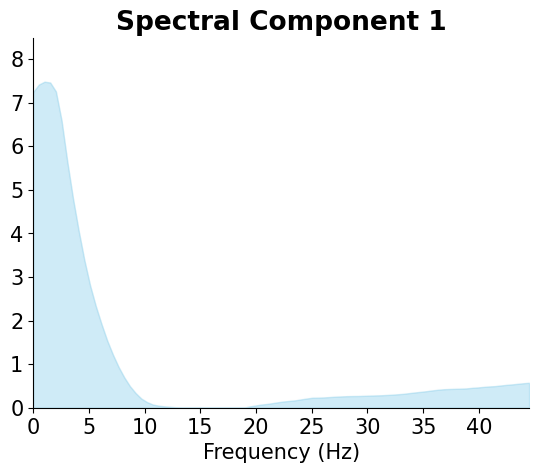

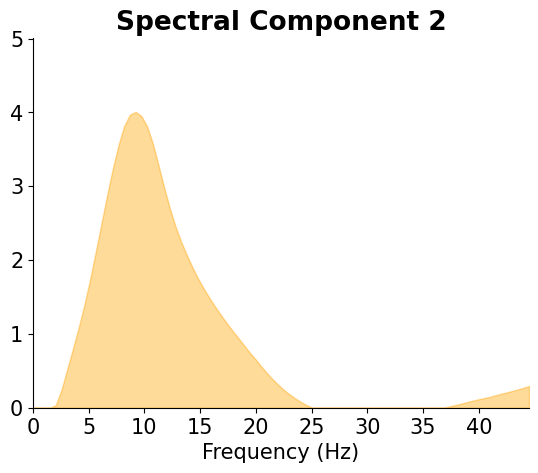

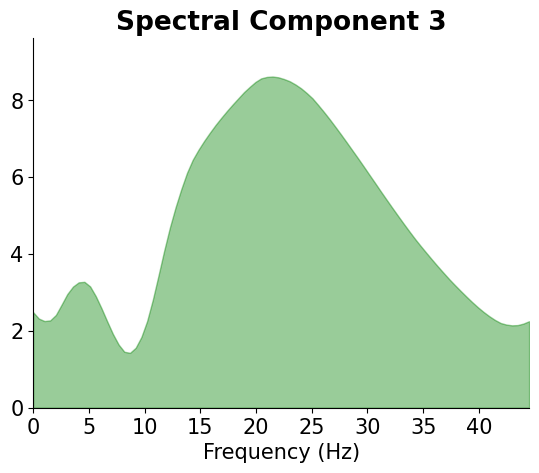

In [110]:
f_plot = np.linspace(0, f[-1], len(wb_comp[0]))
colors = ['skyblue', 'orange', 'green']

# Plot the first 3 spectral components:
for sc in range(len(wb_comp) - 1):
    plt.figure()
    plt.plot(f_plot, wb_comp[sc], color=colors[sc], alpha=0.01)
    plt.xlabel('Frequency (Hz)', fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.xlim([0,f_plot[-1]])
    plt.ylim([0,np.max(wb_comp[sc])+1])
    plt.fill_between(f_plot, wb_comp[sc], color=colors[sc], alpha=0.4)  # Fill under the curve
    plt.title('Spectral Component {}'.format(sc+1), weight='bold', fontsize=19)
    plt.gca().spines['top'].set_visible(False)    # Hide the top spine
    plt.gca().spines['right'].set_visible(False)  # Hide the right spine
    plt.show()
                

### Plot **MEAN** power spectra

(8, 88)


(<Figure size 700x400 with 1 Axes>,
 <Axes: xlabel='Frequency (Hz)', ylabel='PSD (a.u.)'>)

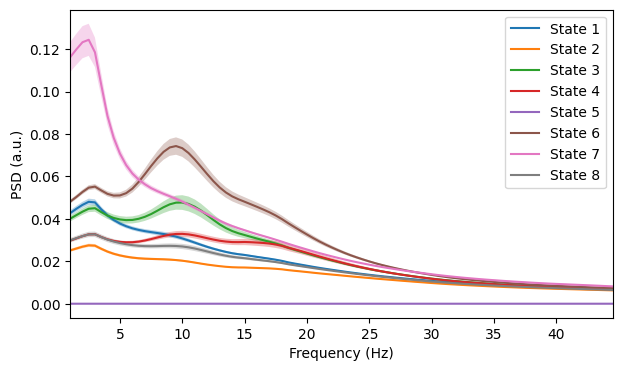

In [111]:
from osl_dynamics.utils import plotting

# Average over subjects and channels
psd_mean = np.mean(psd, axis=(0,2))
print(psd_mean.shape)

# Also get mean across channels and the standard error
gpsd = np.average(psd, axis=0, weights=w)
p = np.mean(gpsd, axis=-2)
e = np.std(gpsd, axis=-2) / np.sqrt(gpsd.shape[-2])

# Plot
n_states = psd_mean.shape[0]
plotting.plot_line(
    [f] * n_states,
    p,
    errors=[p-e, p+e],
    labels=[f"State {i}" for i in range(1, n_states + 1)],
    x_label="Frequency (Hz)",
    y_label="PSD (a.u.)",
    x_range=[f[0], f[-1]],
)

### **Same plot WITHOUT FLAT State**

In [112]:
print(e[np.array([True, True, True, True, False, True, True, True])].shape)

(7, 88)


(8, 88)


/tmp/ipykernel_2243037/3243611992.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=13)
/tmp/ipykernel_2243037/3243611992.py:33: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)


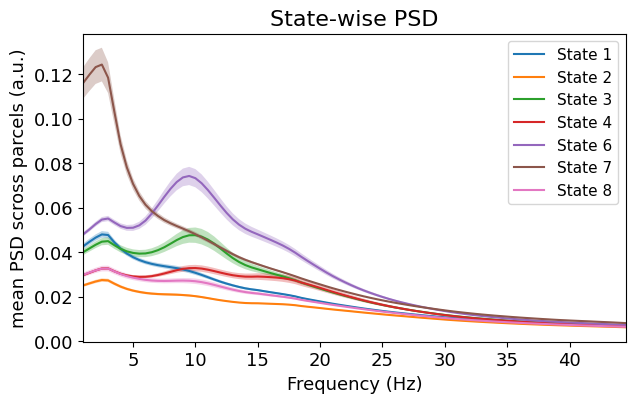

In [114]:
# Average over subjects and channels
psd_mean = np.mean(psd, axis=(0,2))
print(psd_mean.shape)

# Also get mean across channels and the standard error
gpsd = np.average(psd, axis=0, weights=w)
p = np.mean(gpsd, axis=-2)
e = np.std(gpsd, axis=-2) / np.sqrt(gpsd.shape[-2])

p_NEW = p[np.array([True, True, True, True, False, True, True, True])]
e_NEW = e[np.array([True, True, True, True, False, True, True, True])]


# Plot
n_states = psd_mean.shape[0] - 1
plotting.plot_line(
    [f] * n_states,
    p_NEW,
    errors=[p_NEW-e_NEW, p_NEW+e_NEW],
    labels=[f"State {i}" for i in [1, 2, 3, 4, 6, 7, 8]],
    x_label="Frequency (Hz)",
    y_label="PSD (a.u.)",
    x_range=[f[0], f[-1]],
)
# Access the ax object
ax = plt.gca()

# Set the fontsize for title, axis labels, and legend labels
ax.set_title("State-wise PSD", fontsize=16)
ax.set_xlabel("Frequency (Hz)", fontsize=13)
ax.set_ylabel("mean PSD scross parcels (a.u.)", fontsize=13)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=13)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)
ax.legend(fontsize=11)

#### Substract the static power spectrum from each state-specific power spectrum ==> To get a flavour of the **state-specific oscillatory activity**

(8, 88)


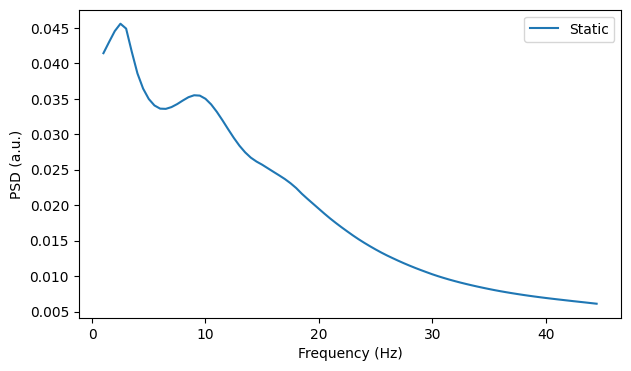

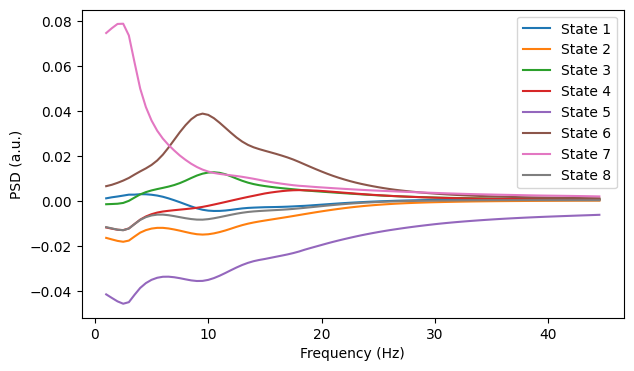

In [119]:
# Average over subjects and channels
psd_mean = np.mean(psd, axis=(0,2))
print(psd_mean.shape)

# Also get mean across channels and the standard error

gpsd = np.average(psd, axis=0, weights=w)
p = np.mean(gpsd, axis=-2)
e = np.std(gpsd, axis=-2) / np.sqrt(gpsd.shape[-2])

# Calculate static PSD and average over channels
gpsd_static = np.mean(gpsd, axis=0)
static_p = np.mean(gpsd_static, axis=0)

# Calculate state PSDs relative to the static PSD
p_rel_mean = p - static_p[np.newaxis, ...]

n_states = 8
# Plot
fig, ax = plotting.plot_line(
    [f],
    [static_p],
    labels=["Static"],
    x_label="Frequency (Hz)",
    y_label="PSD (a.u.)",
)
fig, ax = plotting.plot_line(
    [f] * n_states,
    p_rel_mean,
    labels=[f"State {i + 1}" for i in range(n_states)],
    x_label="Frequency (Hz)",
    y_label="PSD (a.u.)",
)

### Plot **MEAN** Coherence across all channels

(8, 88)


/tmp/ipykernel_2243037/4039232285.py:31: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), fontsize=13)
/tmp/ipykernel_2243037/4039232285.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)


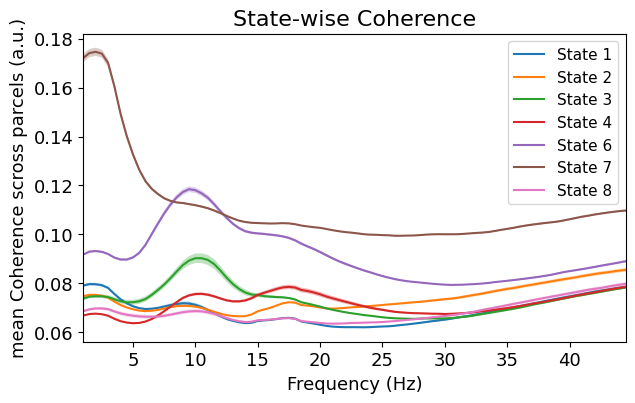

In [122]:
coh_across_chans = np.mean(np.mean(coh, axis=0),axis=(1,2))
print(np.shape(coh_across_chans))

gcoh = np.mean(np.mean(coh, axis=0), axis=1)
plot_coh = np.mean(gcoh, axis=-2)
e = np.std(gcoh, axis=-2) / np.sqrt(gcoh.shape[-2])

# Concatenate - remove State 3 because it has a coherence of almost 1 at all frequencies -> makes it unreadbale for other states
plot_coh_concat = np.concatenate((plot_coh[:4], plot_coh[5:]), axis=0)
e_concat = np.concatenate((e[:4], e[5:]), axis=0)
n_states = 8

# Plot
plotting.plot_line(
    [f] * (n_states-1),
    plot_coh_concat,
    errors=[plot_coh_concat-e_concat, plot_coh_concat+e_concat],
    labels=[f"State {i}" for i in [1, 2, 3, 4, 6, 7, 8]],
    x_label="Frequency (Hz)",
    y_label="Coherence across all channels (a.u.)",
    x_range=[f[0], f[-1]],
)

# Access the ax object
ax = plt.gca()

# Set the fontsize for title, axis labels, and legend labels
ax.set_title("State-wise Coherence", fontsize=16)
ax.set_xlabel("Frequency (Hz)", fontsize=13)
ax.set_ylabel("mean Coherence scross parcels (a.u.)", fontsize=13)
ax.set_xticklabels(ax.get_xticklabels(), fontsize=13)
ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)
ax.legend(fontsize=11)

## **State Power maps + Coherence Networks ==> Spectral Component-specific**

## **Spectral Component 1**

In [123]:
# Integrate the power spectra over a frequency range, weighted by the spectral compoents
p_sc_all = power.variance_from_spectra(f, gpsd, wb_comp)
p_sc1 = p_sc_all[0]

Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.02s/it]


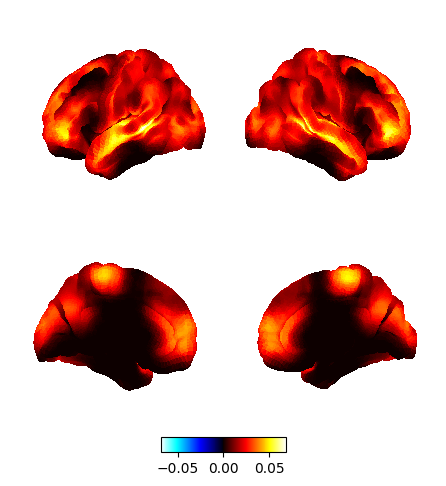

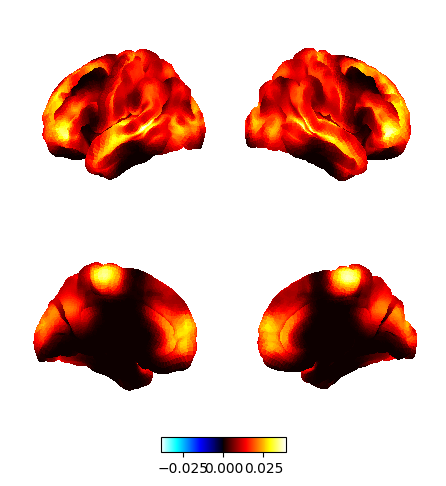

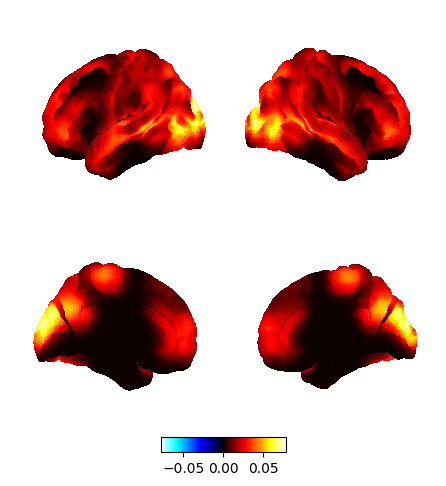

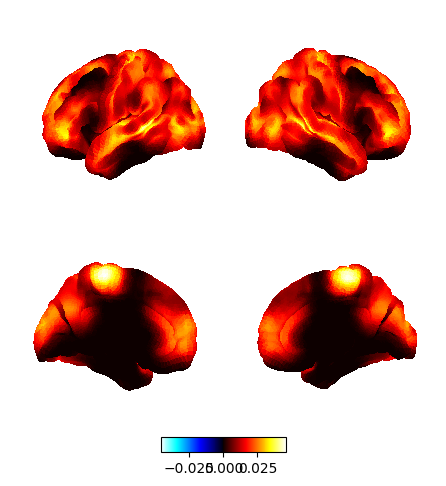

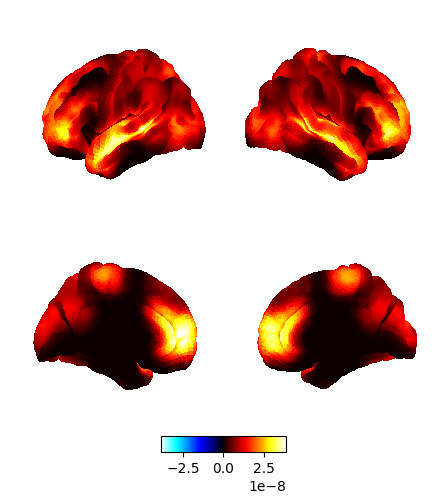

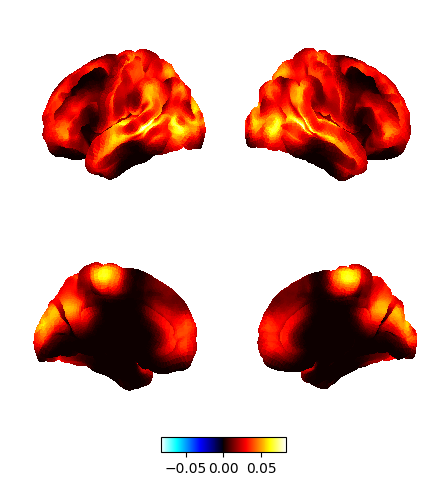

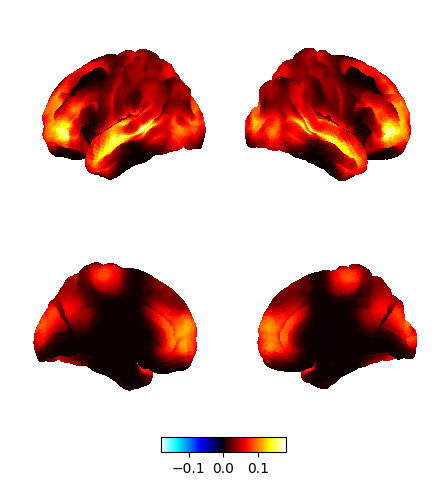

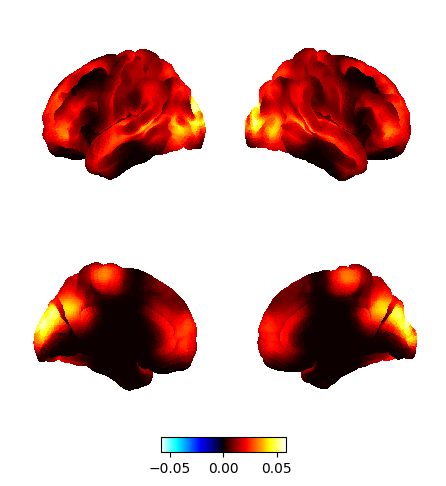

In [126]:
## Plotting power maps (averages over all subjects) per state
fig, ax = power.save(
    p_sc1,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

### Plot **relative** to something else (by **substracting the mean**)

Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.07s/it]


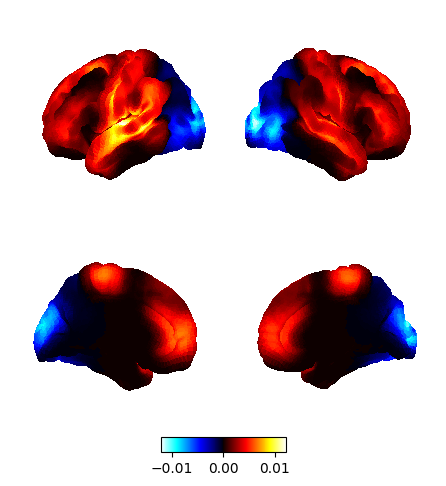

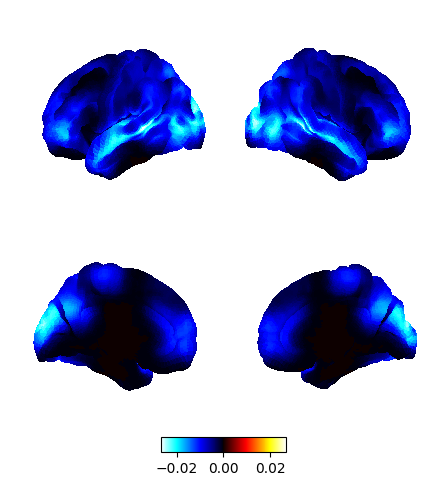

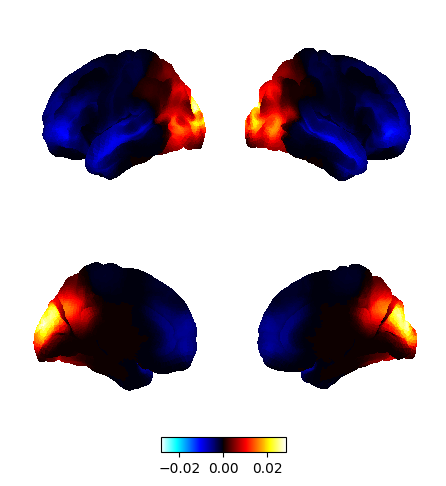

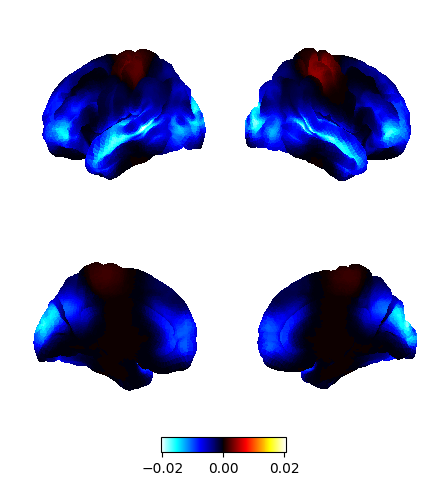

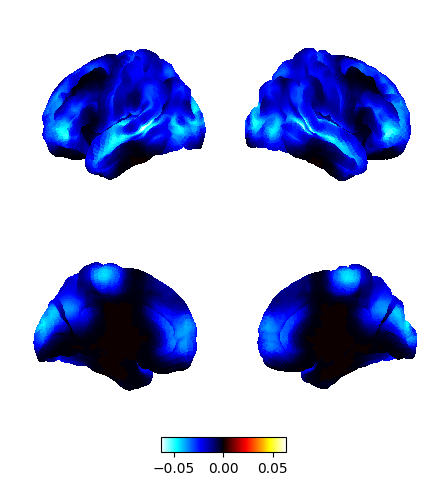

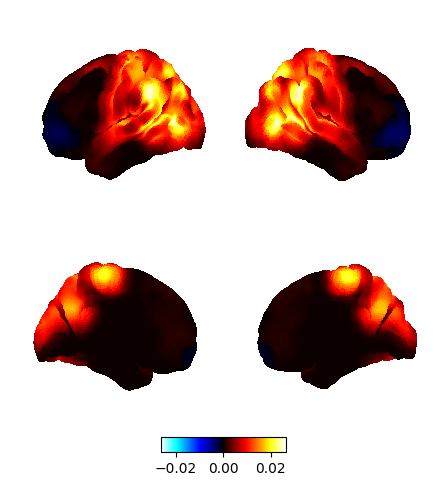

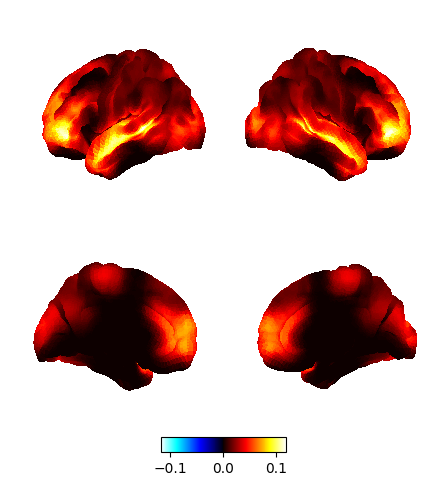

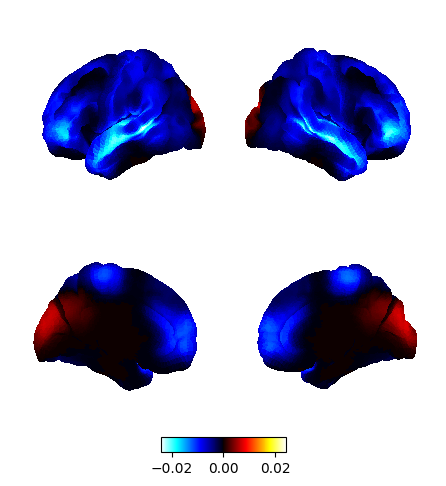

In [127]:
# Takes a few seconds for the power maps to appear
fig, ax = power.save(
    p_sc1,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
    subtract_mean=True,
)

### **Group analysis**

(37, 8, 38)
(8, 38)


Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.12s/it]


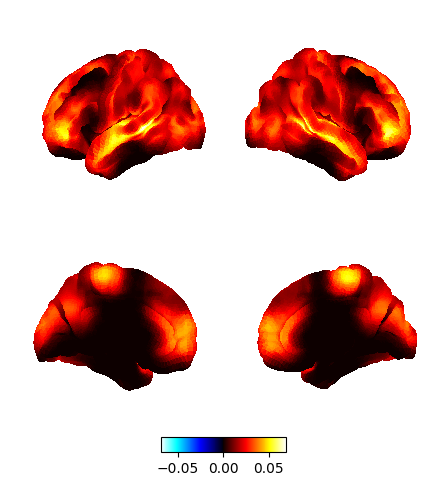

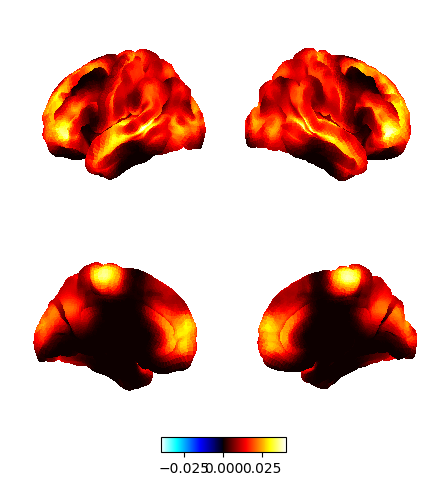

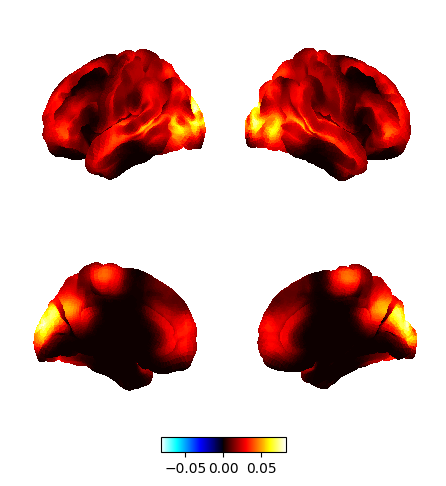

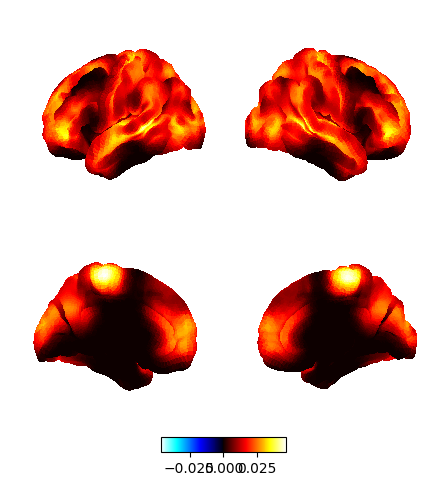

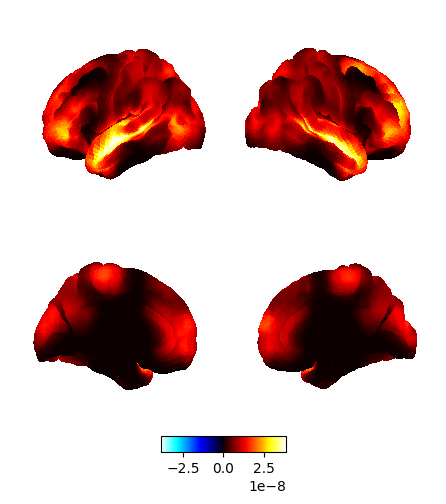

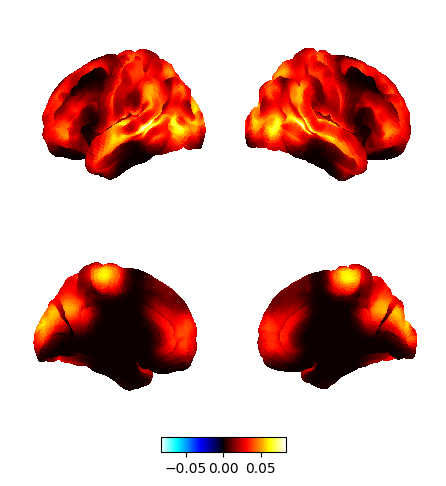

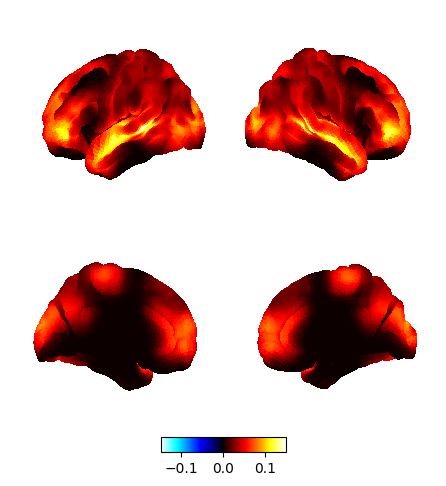

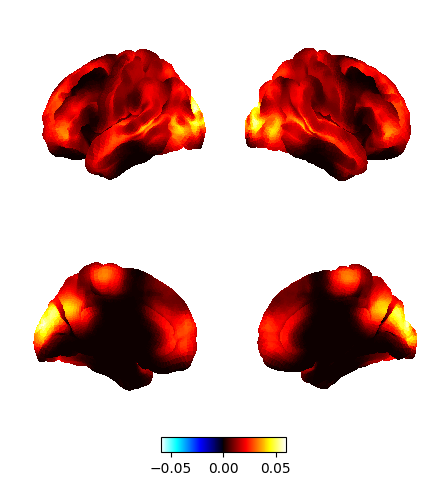

In [128]:
# Get the power arrays for group 1
p_sc1_control = power.variance_from_spectra(f, psd, wb_comp)[df_control_idx,0]

# Get the power arrays for group 2
p_sc1_ms = power.variance_from_spectra(f, psd, wb_comp)[df_ms_idx,0]

# Group means
p_sc1_control_mean = np.mean(p_sc1_control,axis=0)
p_sc1_ms_mean = np.mean(p_sc1_ms,axis=0)

print(np.shape(p_sc1_control))
print(np.shape(p_sc1_control_mean))

# Plot (it takes a few seconds for the brain maps to be shown)
fig, ax = power.save(
    [p_sc1_control_mean, p_sc1_ms_mean],
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

### Plot the **diffference between the 2 groups**

Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.05s/it]


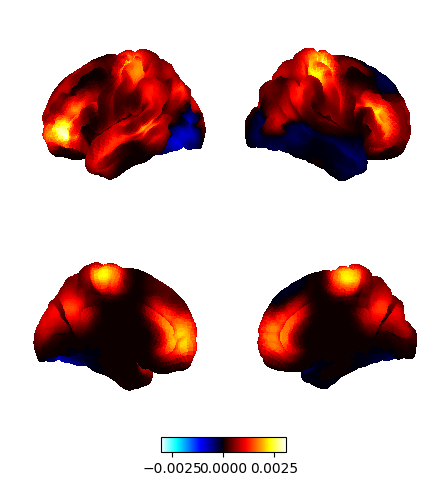

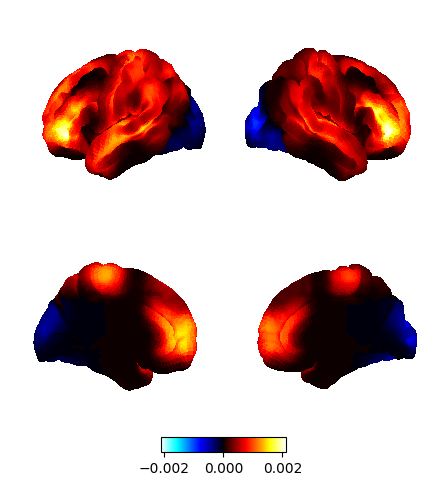

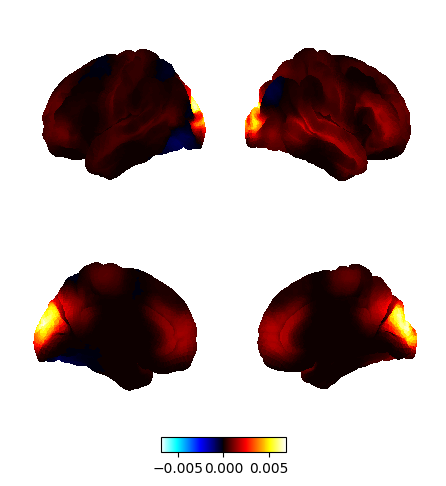

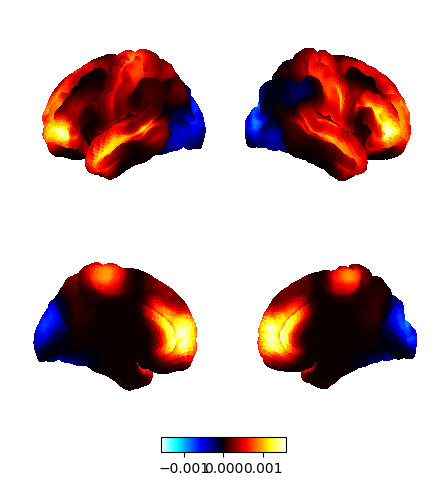

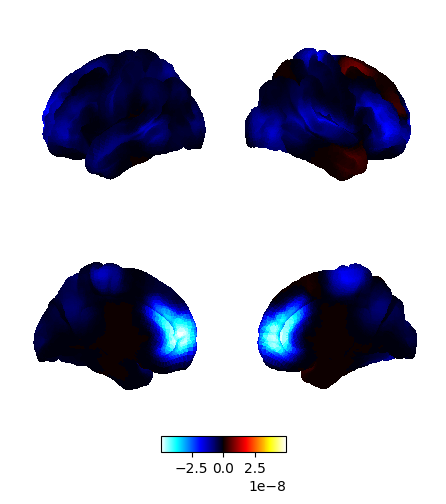

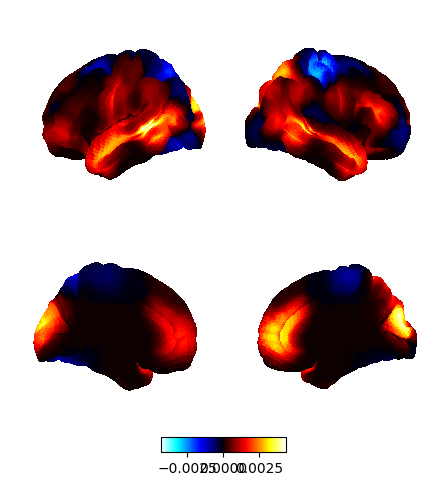

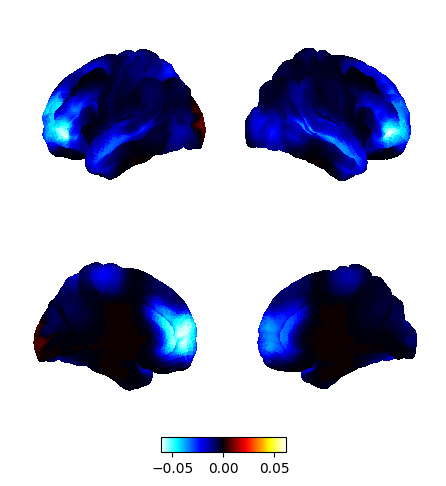

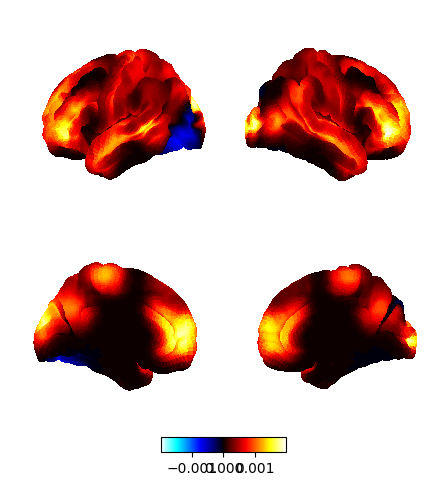

In [129]:
# Calculate the difference in power between the groups
p_diff = p_sc1_control_mean - p_sc1_ms_mean

# Plot
fig, ax = power.save(
    p_diff,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

#### **Statistical significance testing**

### **HC vs. MS**

In [131]:
from osl_dynamics.analysis import statistics

# Group assignments
## use assignments variable defined in the section of the Summary Statistics
p_sc1_gd = power.variance_from_spectra(f, psd, wb_comp)[:,0]

# Do significant testing
diff, pvalues = statistics.group_diff_max_stat_perm(
    p_sc1_gd,
    assignments,
    n_perm=500,
)

# Do we have any significant parcels?
print("Number of significant parcels:", np.sum(pvalues < 0.05))

Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 500 permutations
	Taking max-stat across ['features 1', 'features 2'] dimensions
Using tstats as metric
Number of significant parcels: 0


##### **If you have parcels with a significant difference in power between groups:**

Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.07s/it]


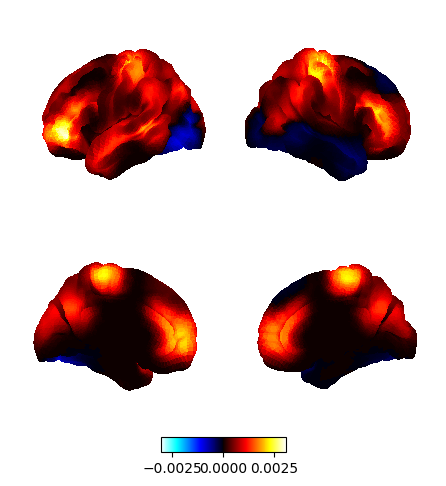

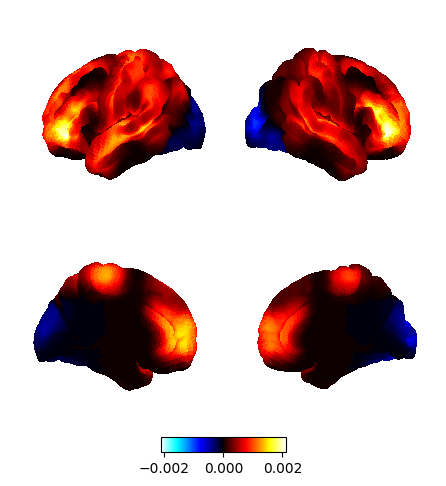

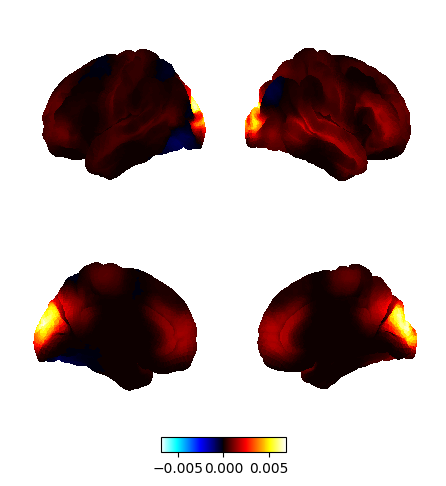

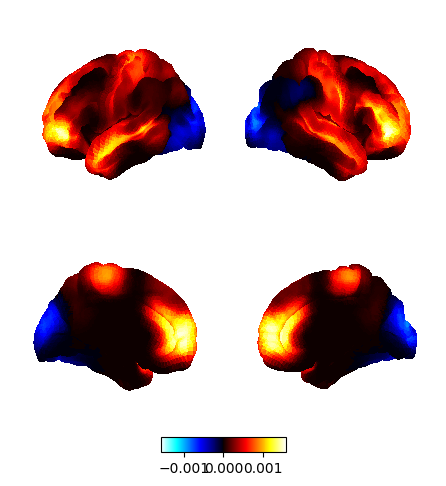

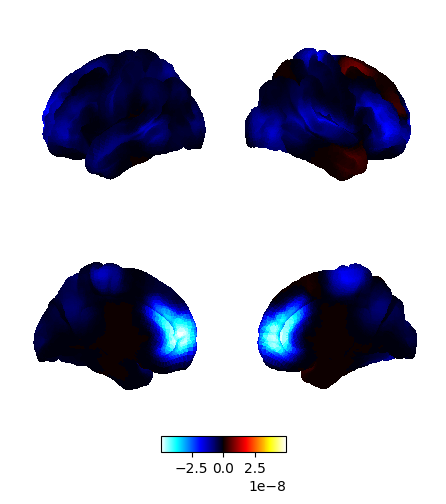

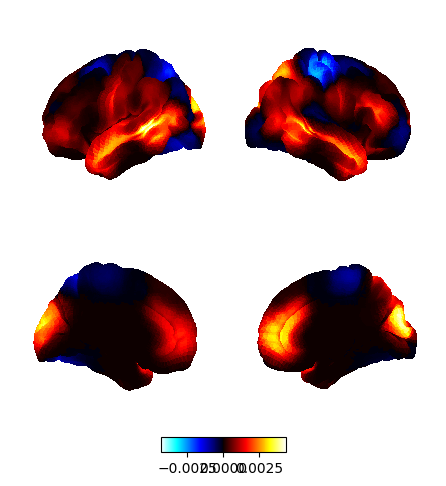

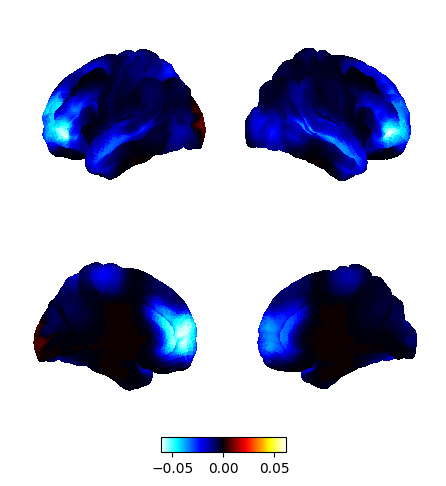

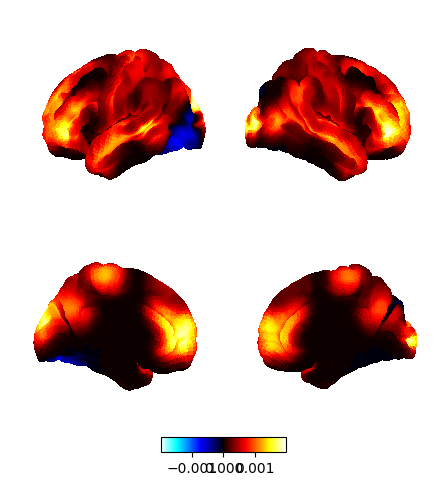

In [132]:
# Zero non-significant parcels
diff_sig = diff.copy()
diff_sig[pvalues < 0.05] = 0

# Plot
fig, ax = power.save(
    diff_sig,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

### **Coherence plots**

### **NNMF**

In [295]:
# Calculate the coherence network for each state by weighting with the spectral components
c = connectivity.mean_coherence_from_spectra(f, coh, wb_comp)
print(c.shape)

# Average over subjects
mean_c = np.mean(c, axis=0)
print(mean_c.shape)

# Threshold each network and look for the top 3% of connections relative to the mean
thres_mean_c = connectivity.threshold(mean_c, percentile=98, subtract_mean=True)
print(thres_mean_c.shape)

(110, 4, 8, 38, 38)
(4, 8, 38, 38)
(4, 8, 38, 38)


In [296]:
sc = 0
os.makedirs(model_name + "/data/Images" + "/Basic_Coherence_NNMF", exist_ok=True)
connectivity.save(
    thres_mean_c,
    parcellation_file="/home/olivierb/38_parcels.nii",
    component=sc, #1st spectral component
    filename=model_name + "/data/Images/Basic_Coherence_NNMF/coh_Spectral_Comp_" + str(sc+1) + "_State_.png"
)

Saving images: 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]


In [135]:
connectivity_6states_SC1 = thres_mean_c[0]
connectivity_6states_SC1_S1 = connectivity_6states_SC1[0]

print(connectivity_6states_SC1_S1)

[[0.9999999 0.        0.        ... 0.        0.        0.       ]
 [0.        0.        0.        ... 0.        0.        0.       ]
 [0.        0.        0.        ... 0.        0.        0.       ]
 ...
 [0.        0.        0.        ... 0.        0.        0.       ]
 [0.        0.        0.        ... 0.        0.        0.       ]
 [0.        0.        0.        ... 0.        0.        0.       ]]


### Get locations of parcel-centers for the 38 parcel data

In [136]:
import nibabel as nib
from nilearn import image, plotting
path_parcel = "/home/olivierb/38_parcels.nii"
nii_img = image.load_img(path_parcel)

# Get the coordinates of all voxels in realistic 3D space
shape = nii_img.shape

# Create a grid of voxel coordinates
x, y, z = np.meshgrid(range(shape[0]), range(shape[1]), range(shape[2]), indexing='ij')

# Stack the voxel coordinates into a single array
voxel_coords = np.column_stack((x.ravel(), y.ravel(), z.ravel()))

# Get the affine matrix
affine = nii_img.affine

world_coords = nib.affines.apply_affine(affine, voxel_coords)

x_min, x_max = np.min(world_coords[:,0]), np.max(world_coords[:,0]) 
y_min, y_max = np.min(world_coords[:,1]), np.max(world_coords[:,1]) 
z_min, z_max = np.min(world_coords[:,2]), np.max(world_coords[:,2])

x_axis = np.arange(x_min, x_max+8, 8)
y_axis = np.arange(y_min, y_max+8, 8)
z_axis = np.arange(z_min, z_max+8, 8)

parcel_centers = []

n_parcels = np.shape(nii_img)[3]
for i in range(n_parcels):
    one_volume_data = image.index_img(nii_img, i).get_fdata()
    location_center = np.where(one_volume_data == np.max(one_volume_data))
    loc = [location_center[axis][0] for axis in range(3)]
    loc_space = [x_axis[loc[0]], y_axis[loc[1]], z_axis[loc[2]]]
    parcel_centers.append(loc_space)

print(parcel_centers)

[[18.0, -94.0, 24.0], [-6.0, -94.0, 24.0], [42.0, -86.0, 0.0], [-38.0, -78.0, -8.0], [58.0, -6.0, 32.0], [-54.0, -6.0, 32.0], [66.0, -22.0, 8.0], [-54.0, -22.0, 8.0], [50.0, -22.0, 56.0], [-38.0, -22.0, 56.0], [26.0, -62.0, 56.0], [-14.0, -70.0, 56.0], [50.0, -70.0, 8.0], [-46.0, -70.0, 8.0], [42.0, -78.0, 40.0], [-30.0, -78.0, 40.0], [50.0, 10.0, -24.0], [-46.0, 10.0, -24.0], [10.0, -30.0, 72.0], [-6.0, -30.0, 72.0], [58.0, -46.0, 40.0], [-54.0, -46.0, 40.0], [50.0, 34.0, 16.0], [-38.0, 34.0, 16.0], [26.0, -94.0, 8.0], [-22.0, -94.0, 8.0], [26.0, 10.0, 56.0], [-22.0, 10.0, 56.0], [18.0, 42.0, 48.0], [-14.0, 42.0, 40.0], [42.0, 50.0, 0.0], [-38.0, 50.0, 0.0], [66.0, -46.0, 0.0], [-54.0, -46.0, 0.0], [26.0, 58.0, 16.0], [-22.0, 50.0, 24.0], [2.0, -62.0, 32.0], [2.0, 50.0, 0.0]]


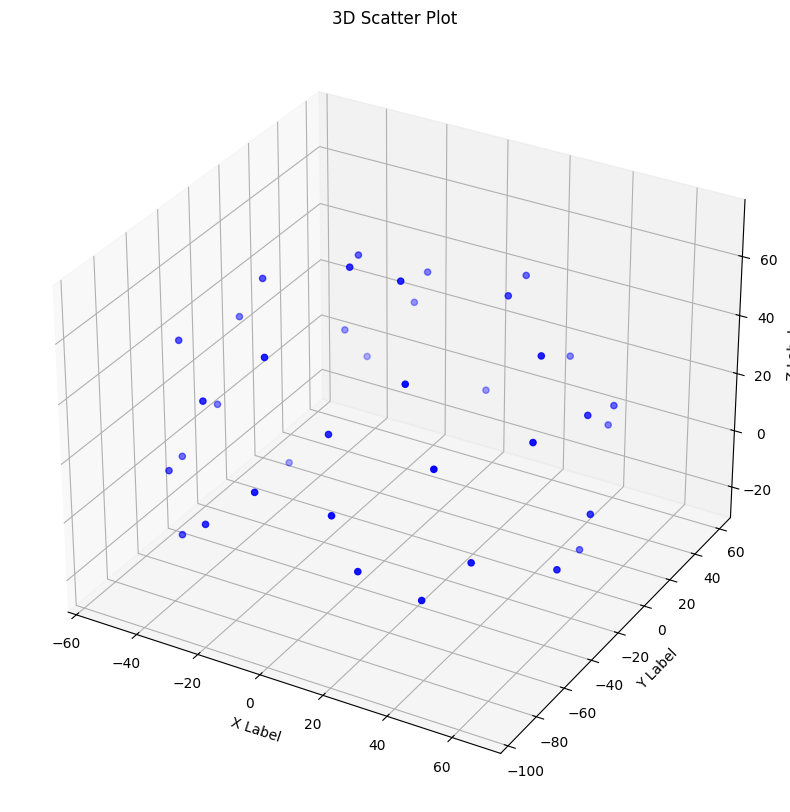

In [137]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # Import the 3D plotting toolkit

# Extract X, Y, and Z coordinates from the array
x = [parcel_centers[parcel][0] for parcel in range(len(parcel_centers))]
y = [parcel_centers[parcel][1] for parcel in range(len(parcel_centers))]
z = [parcel_centers[parcel][2] for parcel in range(len(parcel_centers))]

# Create a 3D scatter plot
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(x, y, z, c='b', marker='o')  # 'c' sets the color, 'marker' defines the marker style

# Set axis labels
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

plt.title('3D Scatter Plot')
plt.show()

In [138]:
import numpy as np
import matplotlib.pyplot as plt
from IPython import display

import mne
from mne.datasets import sample
from mne.minimum_norm import apply_inverse_epochs, read_inverse_operator
from mne.viz import circular_layout
from mne_connectivity import spectral_connectivity_epochs
from mne_connectivity.viz import plot_connectivity_circle

import numpy as np

from osl_dynamics.analysis import connectivity

In [210]:
# Adapted from: https://mne.tools/mne-connectivity/stable/auto_examples/mne_inverse_label_connectivity.html
def plot_spatial_map_connectivity(connectivity_matrix, parcel_names, percentile: int, plot_type: str, title: str, image_name: str, network: bool, color: str, y):
    
    ##### PLOT Circular graph
    
    ###  Throw except if shape mismatch between connectivity matrix & amount of parcels
    if np.shape(connectivity_matrix) != (len(parcel_names), len(parcel_names)):
        raise ValueError("Connectivity matrix shape must have same shape as the amount of parcels.")
    
    label_names = parcel_names
    
    ## Add a way to go from the back to the front of the brain (in the ordering, use y-axis parcel centers)
    # without the 2 non-symmetric parcels
    lh_idx = np.arange(0,38,2)
    rh_idx = np.arange(1,39,2)
    
    sorted_indices_lh = lh_idx[np.argsort(np.array(y)[lh_idx])]
    sorted_indices_rh = rh_idx[np.argsort(np.array(y)[rh_idx])]

    lh_labels = []
    rh_labels = []
    
    # Reorder the labels based on their location
    lh_labels = [label_names[i] for i in sorted_indices_lh]
    rh_labels = [label_names[i] for i in sorted_indices_rh]

    # Add the 2 extra parcels
    #lh_labels.append(label_names[36])
    #rh_labels.append(label_names[37])

    # Save the plot order and create a circular layout
    ## Double-checked to make sure that changing anything in the order here doesn't show false results for the fix 38x38 connectivity matrix

    node_order = []
    node_order.extend(lh_labels[::-1])
    node_order.extend(rh_labels)


    node_angles = circular_layout(label_names, node_order, start_pos=90,
                                  group_boundaries=[0, len(label_names) / 2])

    # Plot the graph using node colors from the FreeSurfer parcellation. We only
    # show the 300 strongest connections.
    fig, ax = plt.subplots(figsize=(10, 10), facecolor='white',   # this color defines the background
                                   subplot_kw=dict(polar=True))

    # Take a % of all strongest connections
    n_lines = 0
    if network:
        
        if plot_type == 'threshold':
        ################################################################################
        ## IF Percentile Thresholding
        ################################################################################
            n_lines = int((100-percentile)/100*len(label_names)*(len(label_names)-1)/2)
        
        if plot_type == 'GMM':
        ################################################################################
        ## IF GMM Thresholding
        ################################################################################
            n_lines = int(((0 < connectivity_matrix) & (connectivity_matrix < 0.99)).sum()/2)
        
            connectivity_matrix = np.array([[0 if element == 1.0000001 else element for element in row] for row in connectivity_matrix])

        plot_connectivity_circle(connectivity_matrix, label_names, n_lines=n_lines,
                                 node_angles=node_angles, title=title, ax=ax, colormap=color,
                                 facecolor='white', textcolor='black', fontsize_names=12,
                                 fontsize_title=16, padding=7, node_edgecolor='darkgrey', node_colors=[(1,1,1)], node_height=0.9, node_width=2, linewidth=2,
                                 colorbar_size=0.5, colorbar_pos=(-0.3,0.5), fontsize_colorbar=11)
        
    return

In [140]:
## Parcel names extract

# Open the .txt file for reading
file_path = "/home/olivierb/Downloads/Parcels_38_names.txt"
with open(file_path, 'r') as file:
    lines = file.readlines()

# Strip any leading/trailing whitespace and create a list of strings
parcel_names = [line.strip() for line in lines]

# Print the list of strings
print(parcel_names)

## Parcel indices (how the channel names are stored in the Python parceled .fif files)
parcel_idx= []
for i in range(len(parcel_names)):        # 38 parcels
    parcel_idx.append('parcel_' + str(i))
print(parcel_idx)

['L Cuneus', 'R Cuneus', 'L Inf Occ', 'R Inf Occ', 'L Supramarginal', 'R Supramarginal', 'L Sup Temp', 'R Sup Temp', 'L Lat SMC', 'R Lat SMC', 'L Sup Parietal', 'R Sup Parietal', 'L Middle Occ', 'R Middle Occ', 'L Sup Occ', 'R Sup Occ', 'L Ant Temp', 'R Ant Temp', 'L Medial SMC', 'R Medial SMC', 'L Angular', 'R Angular', 'L VL PFC', 'R VL PFC', 'L Occ pole', 'R Occ pole', 'L Sup PFC', 'R Sup PFC', 'L Sup Dorsal PFC', 'R Sup Dorsal PFC', 'L Orbitofrontal', 'R Orbitofrontal', 'L Post Temp', 'R Post Temp', 'L Inf Dorsal PFC', 'R Inf Dorsal PFC', 'Medial PFC', 'Posterior Cingulate Cortex']
['parcel_0', 'parcel_1', 'parcel_2', 'parcel_3', 'parcel_4', 'parcel_5', 'parcel_6', 'parcel_7', 'parcel_8', 'parcel_9', 'parcel_10', 'parcel_11', 'parcel_12', 'parcel_13', 'parcel_14', 'parcel_15', 'parcel_16', 'parcel_17', 'parcel_18', 'parcel_19', 'parcel_20', 'parcel_21', 'parcel_22', 'parcel_23', 'parcel_24', 'parcel_25', 'parcel_26', 'parcel_27', 'parcel_28', 'parcel_29', 'parcel_30', 'parcel_31', 

In [141]:
#connectivity_6states_SC1_S1

## **Thresholded 2%**

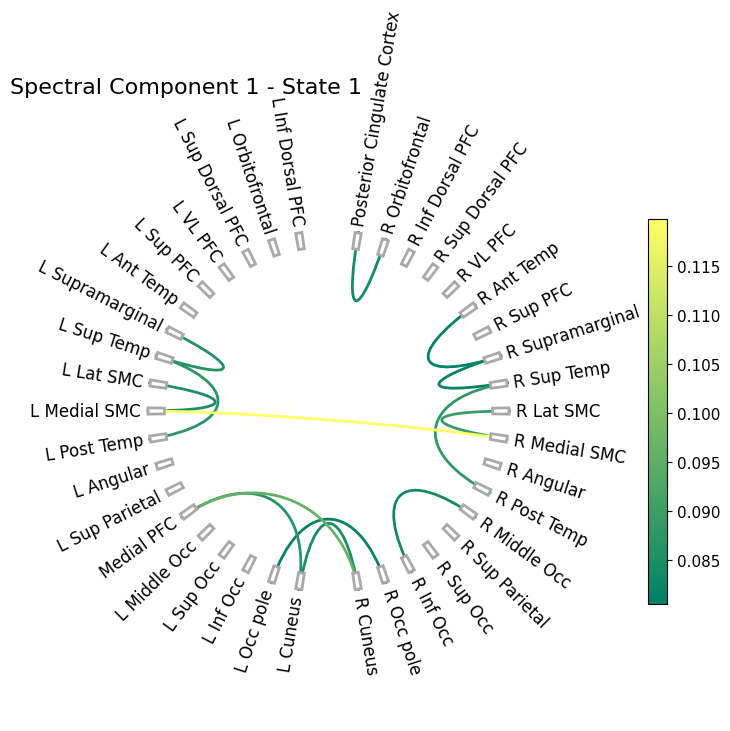

In [211]:
sc=0
title = 'Spectral Component 1 - State 1                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S1, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

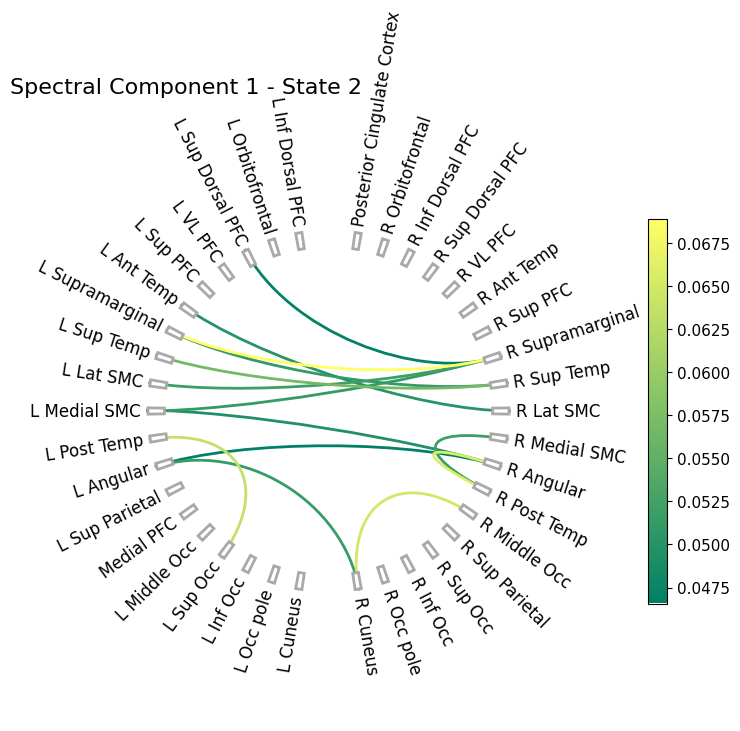

In [212]:
connectivity_6states_SC1_S2 = connectivity_6states_SC1[1]

sc=0
title = 'Spectral Component 1 - State 2                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S2, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

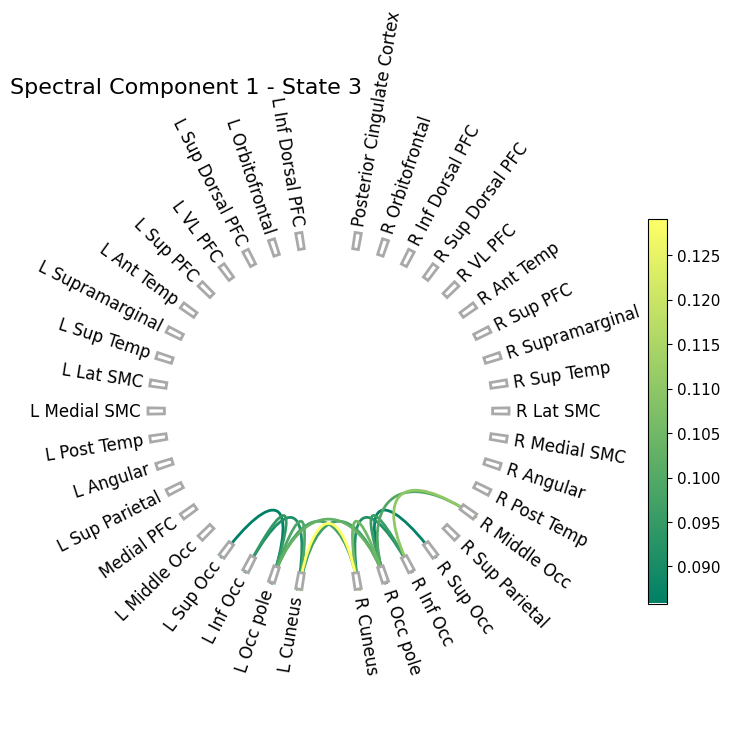

In [214]:
connectivity_6states_SC1_S3 = connectivity_6states_SC1[2]

sc=0
title = 'Spectral Component 1 - State 3                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S3, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

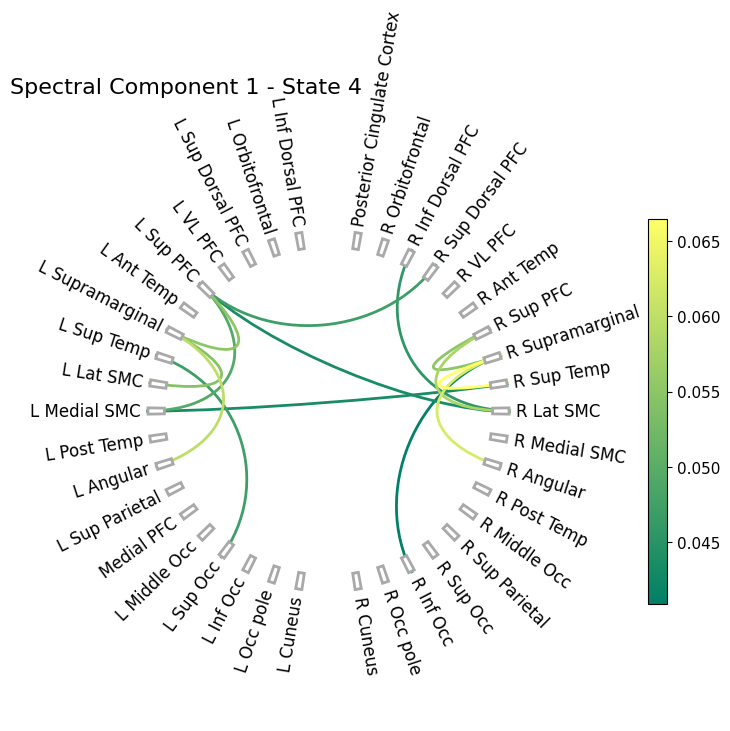

In [215]:
connectivity_6states_SC1_S4 = connectivity_6states_SC1[3]

sc=0
title = 'Spectral Component 1 - State 4                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S4, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

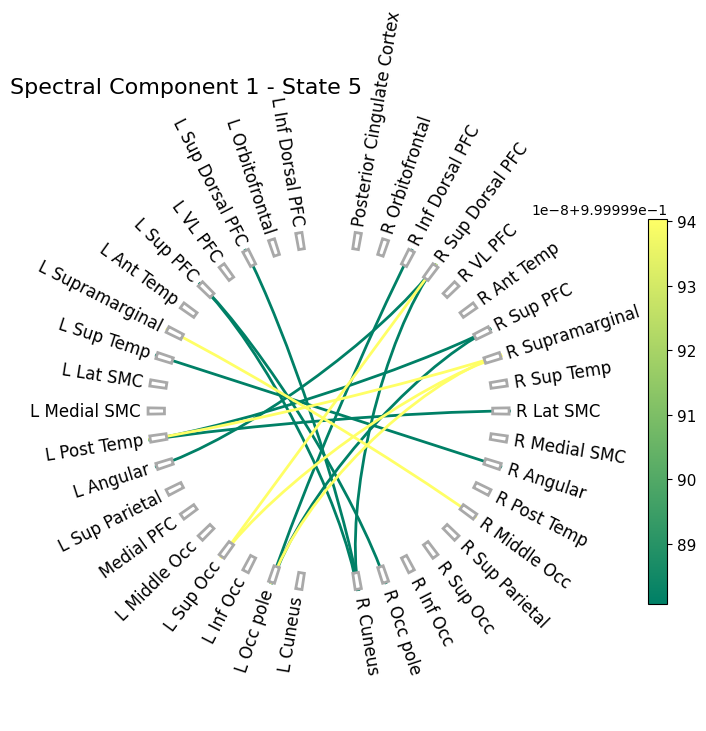

In [216]:
connectivity_6states_SC1_S5 = connectivity_6states_SC1[4]

sc=0
title = 'Spectral Component 1 - State 5                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S5, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

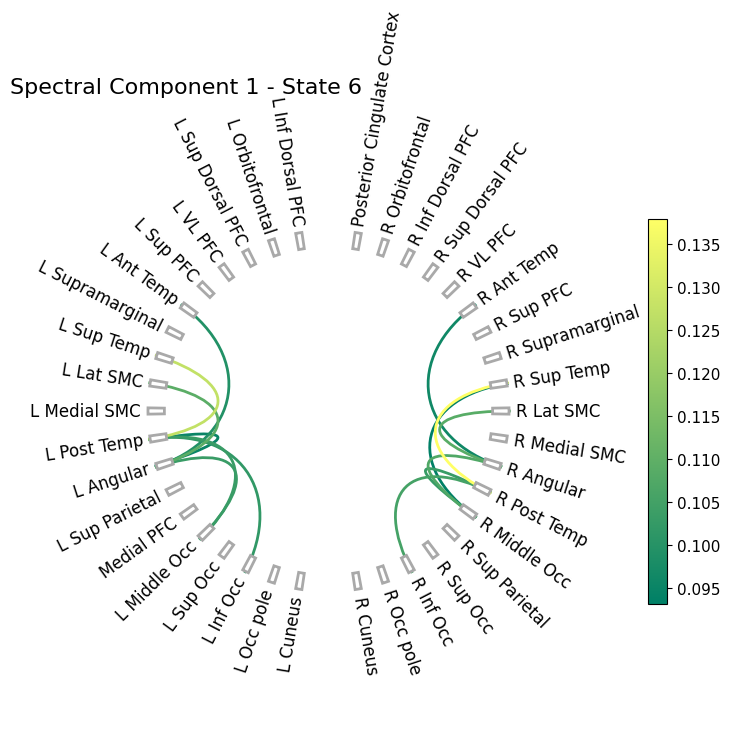

In [217]:
connectivity_6states_SC1_S6 = connectivity_6states_SC1[5]

sc=0
title = 'Spectral Component 1 - State 6                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S6, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

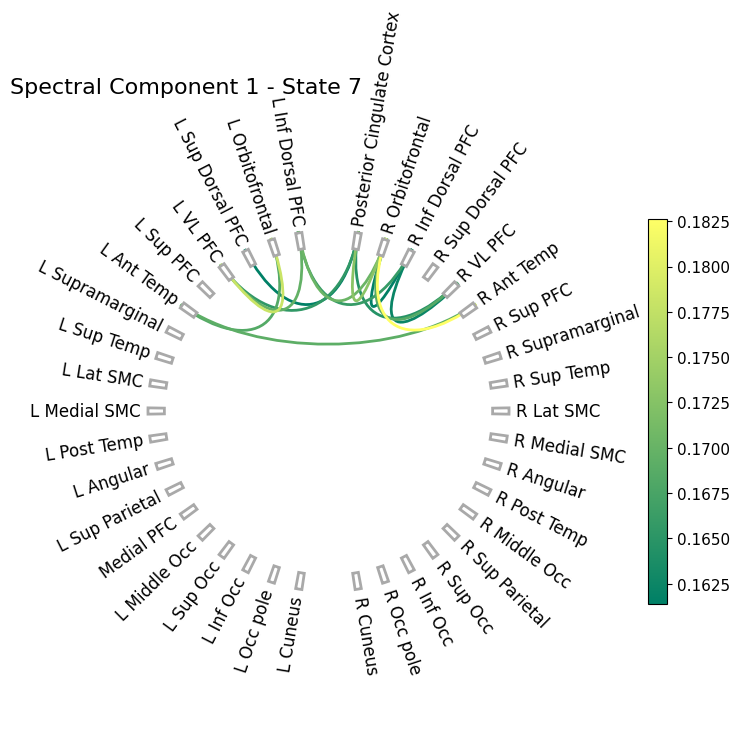

In [218]:
connectivity_6states_SC1_S7 = connectivity_6states_SC1[6]

sc=0
title = 'Spectral Component 1 - State 7                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S7, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

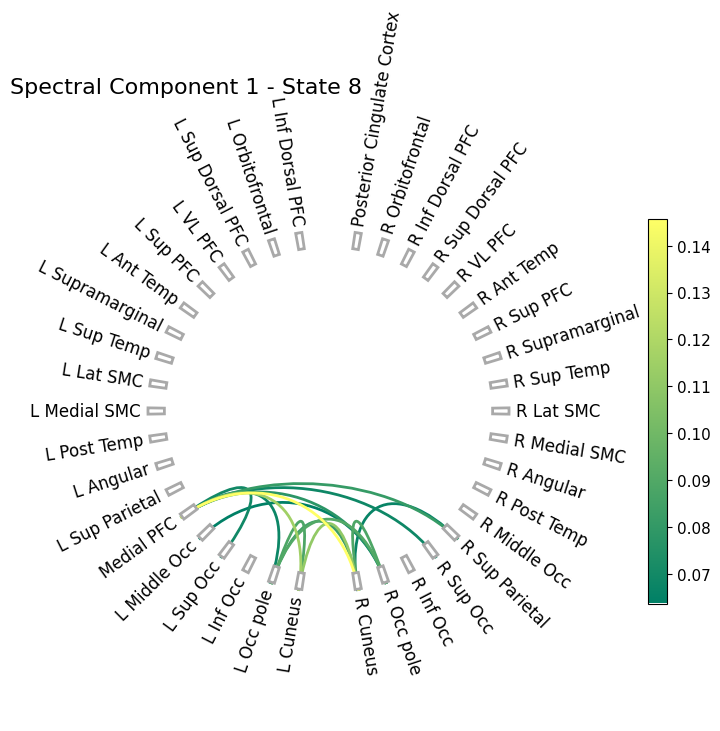

In [219]:
connectivity_6states_SC1_S8 = connectivity_6states_SC1[7]

sc=0
title = 'Spectral Component 1 - State 8                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S8, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

## **Data-driven thresholding: Gaussian Mixture Model (GMM)**

### **Spectral component 1**

In [ ]:
mean_c = mean_c[:][:,np.array([True, True, True, True, False, True, True, True])]
print(np.shape(mean_c))

/home/olivierb/osl-dynamics/osl_dynamics/utils/plotting.py:72: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(*args, **kwargs)


(4, 7, 38, 38)


Saving images: 100%|██████████| 7/7 [00:09<00:00,  1.35s/it]


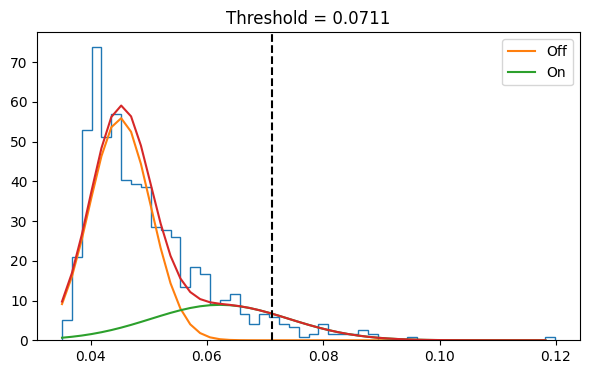

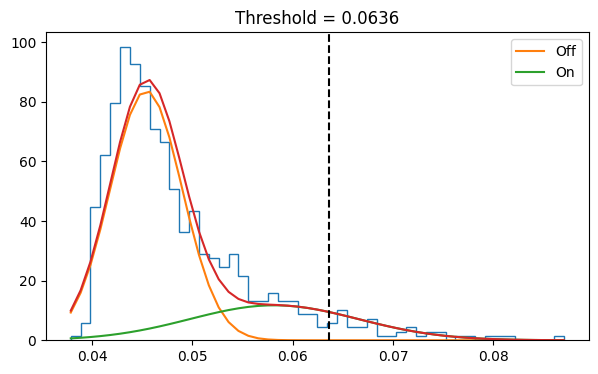

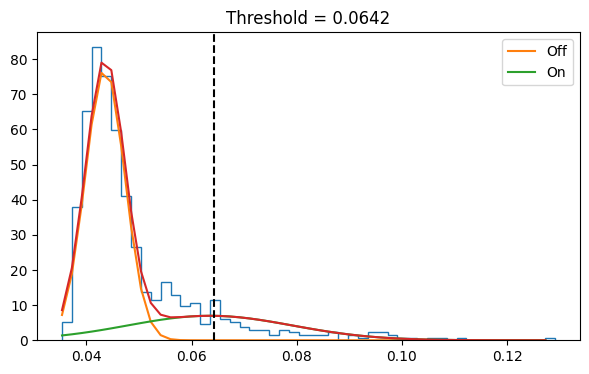

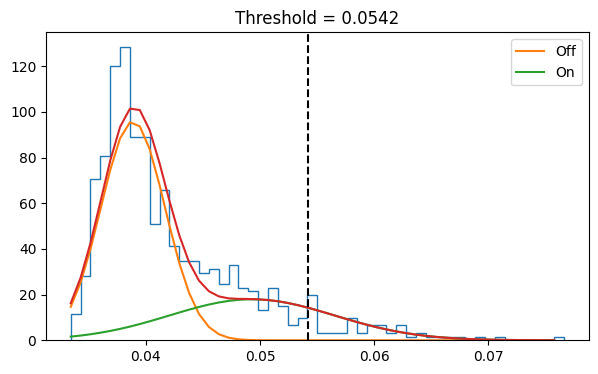

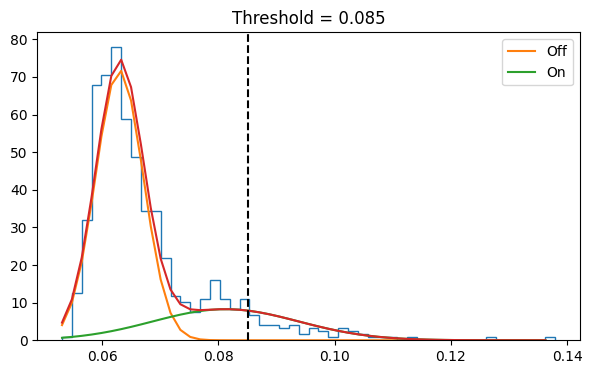

...

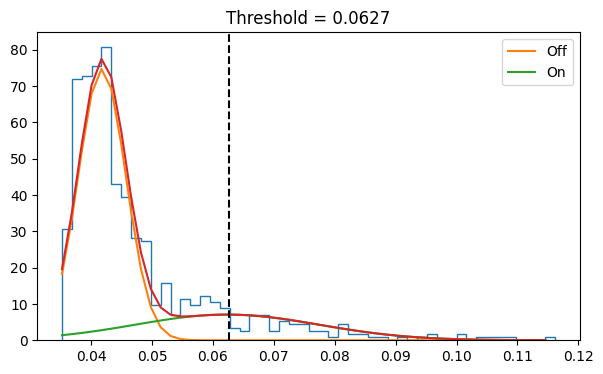

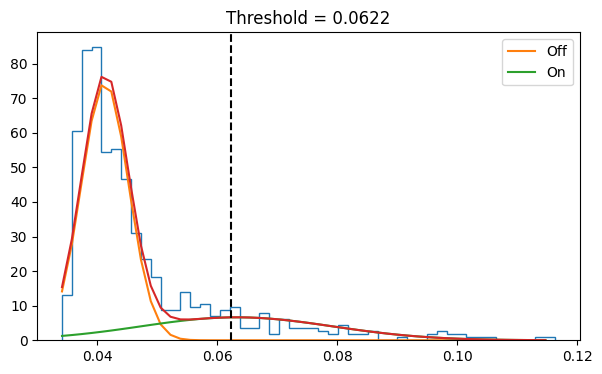

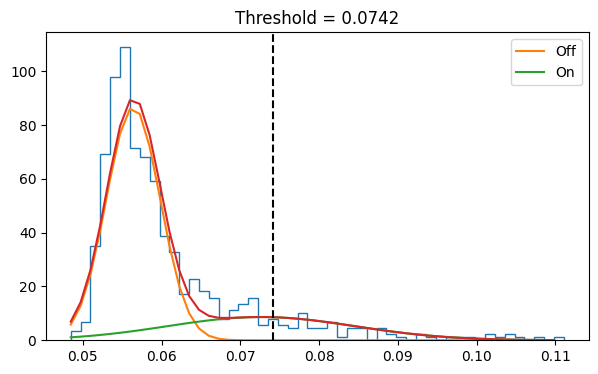

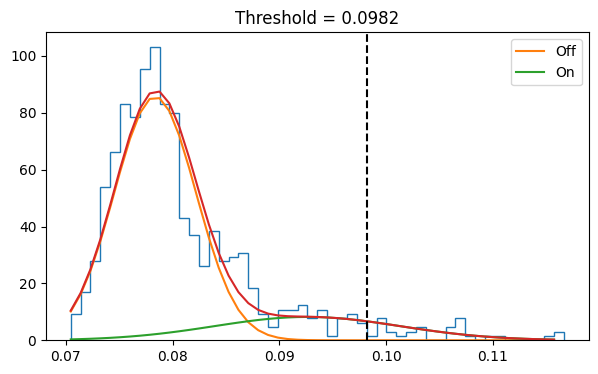

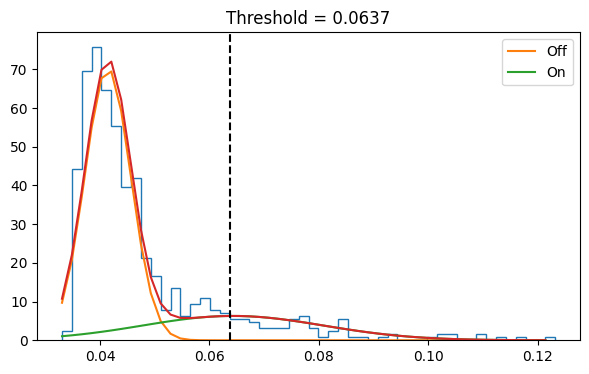

In [158]:
## This only needs to be ran once (it does the GMM data-driven thresholding for all SCs and all states together

sc = 0

# Threshold each network using a GMM
thres_mean_c = connectivity.gmm_threshold(
    mean_c,
    p_value=0.05,
    keep_positive_only=True,
    #subtract_mean=True,
    show=True,
)
print(thres_mean_c.shape)

os.makedirs(model_name + "/data/Images" + "/Basic_Coherence_GMM", exist_ok=True)

# Plot
connectivity.save(
    thres_mean_c,
    parcellation_file="/home/olivierb/38_parcels.nii",
    component=sc,
    filename=model_name + "/data/Images/Basic_Coherence_GMM/coh_Spectral_Comp_" + str(sc) + "_State_.png",
)

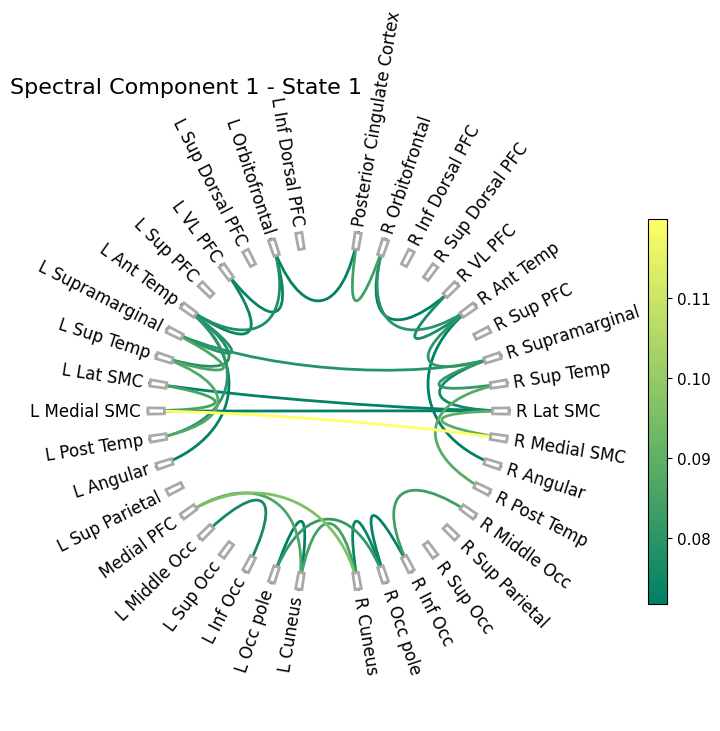

In [196]:
connectivity_6states_SC1_S1 = thres_mean_c[0][0]  # comp 1 state 1

sc=0
title = 'Spectral Component 1 - State 1                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S1, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

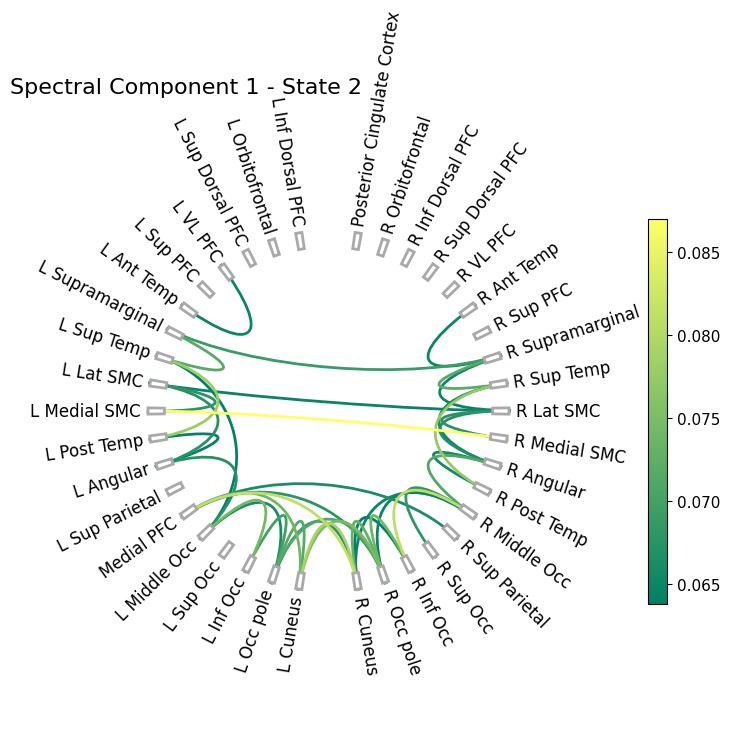

In [198]:
connectivity_6states_SC1_S2 = thres_mean_c[0][1]  # comp 1 state 3

sc=0
title = 'Spectral Component 1 - State 2                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S2, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

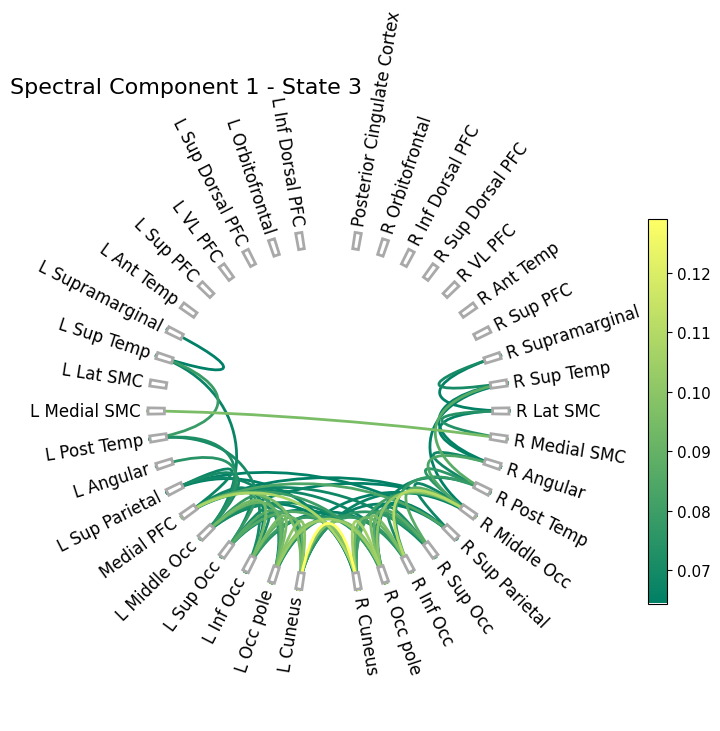

In [199]:
connectivity_6states_SC1_S3 = thres_mean_c[0][2]  # comp 1 state 3

sc=0
title = 'Spectral Component 1 - State 3                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S3, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

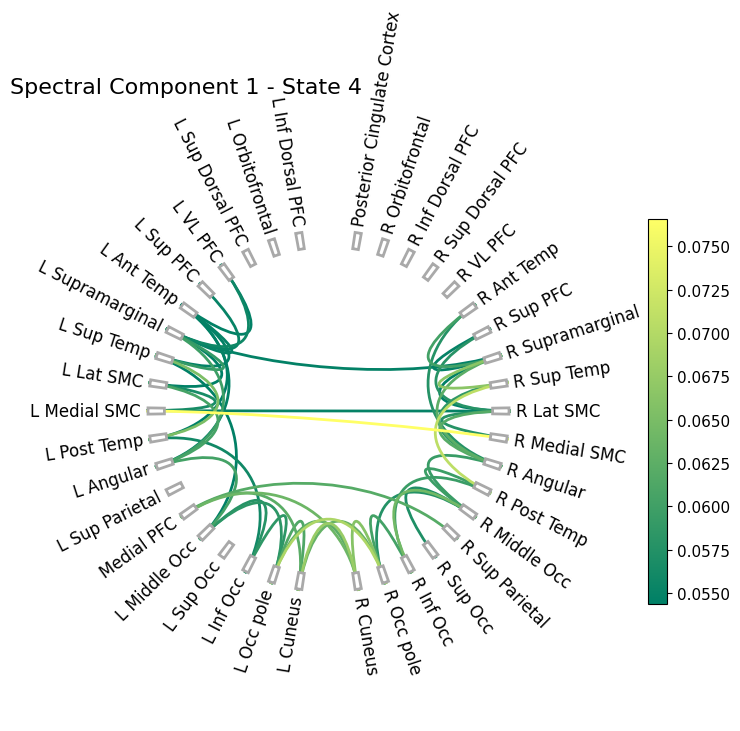

In [200]:
connectivity_6states_SC1_S4 = thres_mean_c[0][3]  # comp 1 state 4

sc=0
title = 'Spectral Component 1 - State 4                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S4, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

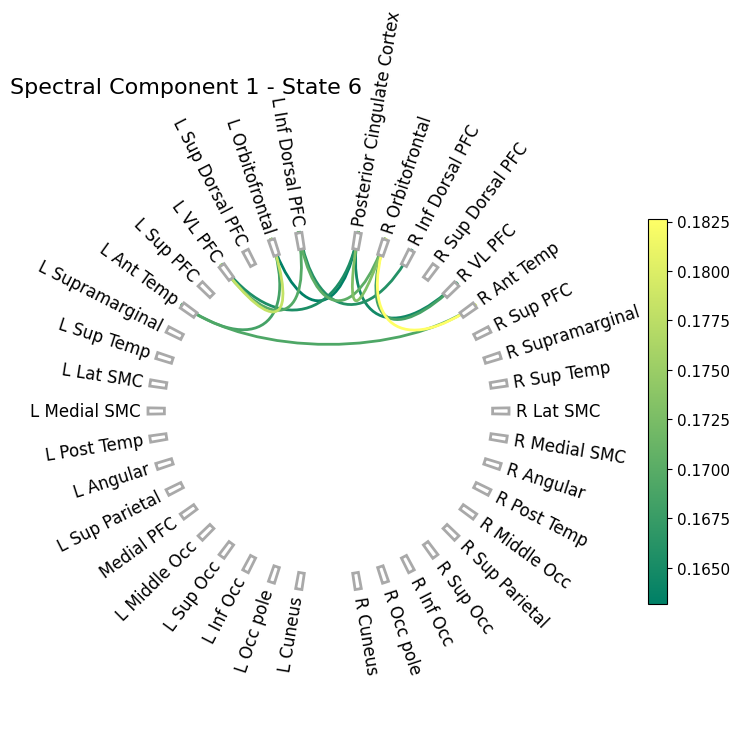

In [206]:
connectivity_6states_SC1_S5 = thres_mean_c[0][4]  # comp 1 state 6

sc=0
title = 'Spectral Component 1 - State 6                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S6, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

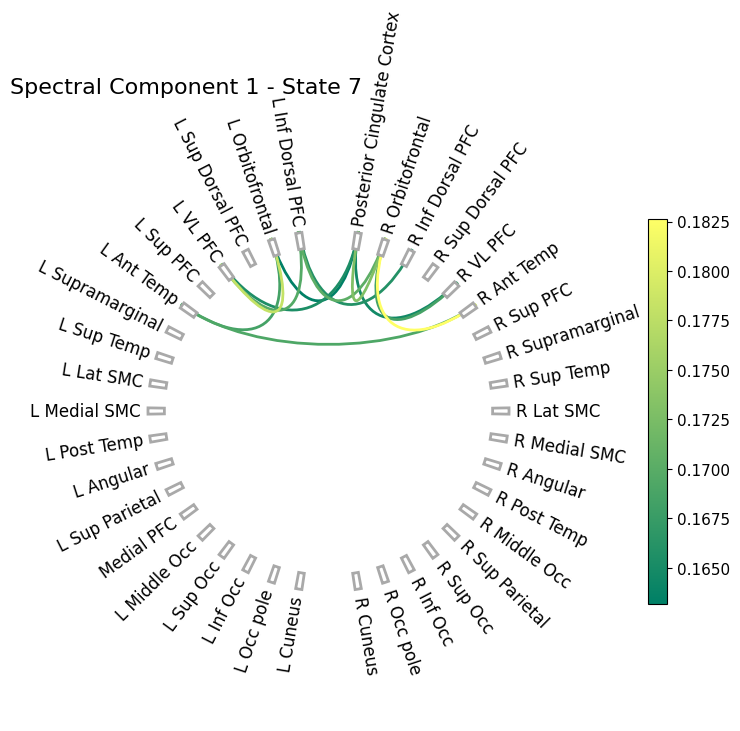

In [209]:
connectivity_6states_SC1_S7 = thres_mean_c[0][5]  # comp 1 state 7

sc=0
title = 'Spectral Component 1 - State 7                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S7, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

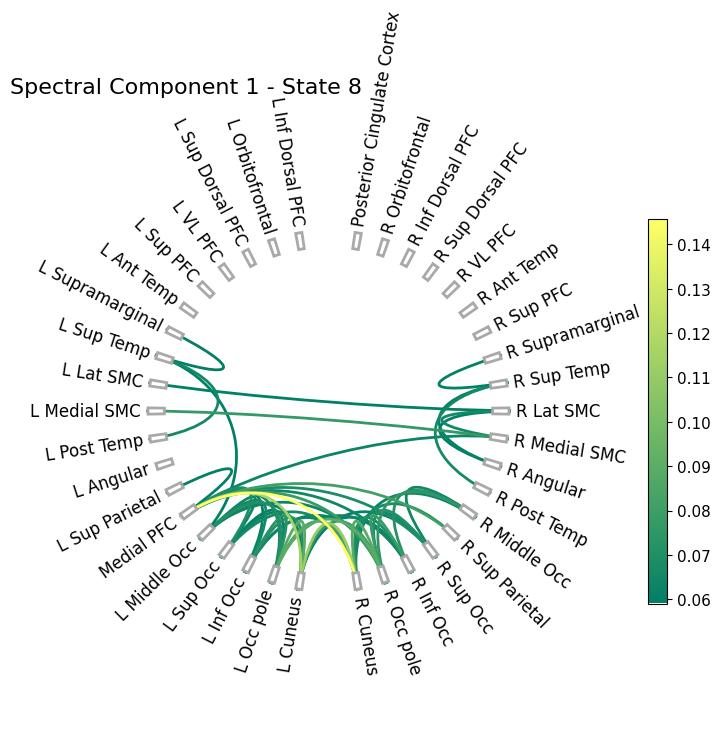

In [208]:
connectivity_6states_SC1_S8 = thres_mean_c[0][6]  # comp 1 state 8

sc=0
title = 'Spectral Component 1 - State 8                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC1_S8, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

## **Spectral Component 2**

In [220]:
# Integrate the power spectra over a frequency range, weighted by the spectral compoents
p_sc_all = power.variance_from_spectra(f, gpsd, wb_comp)
p_sc2 = p_sc_all[1]

Saving images: 100%|██████████| 8/8 [00:07<00:00,  1.02it/s]


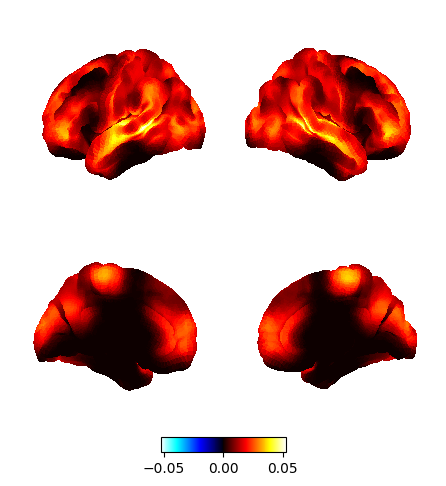

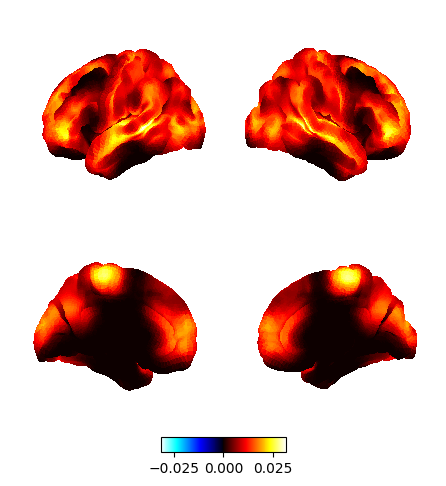

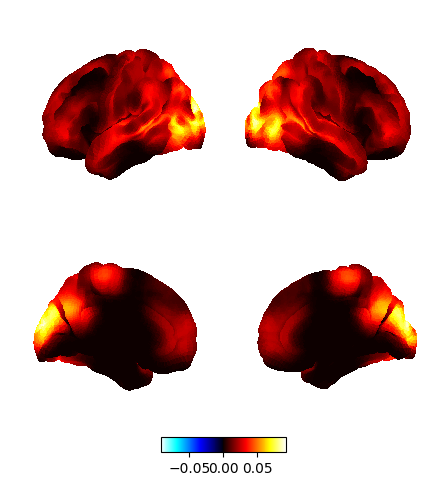

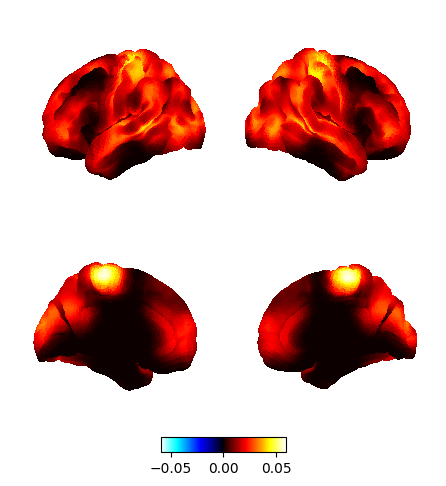

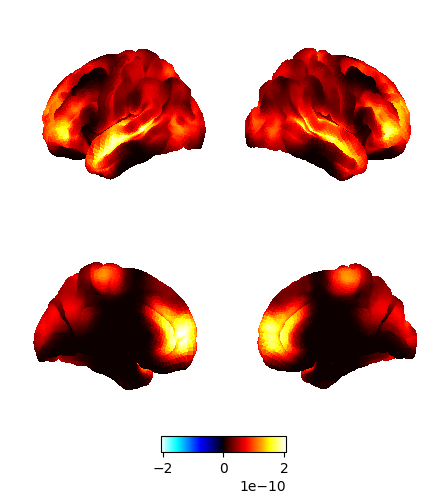

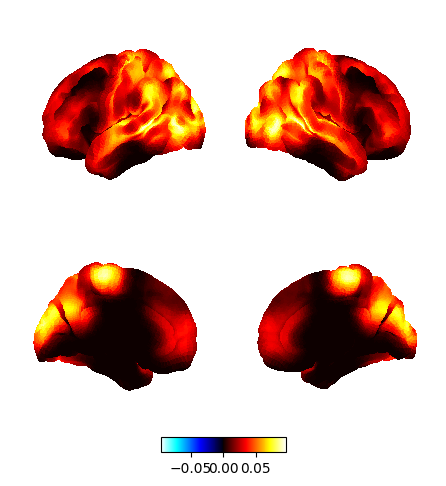

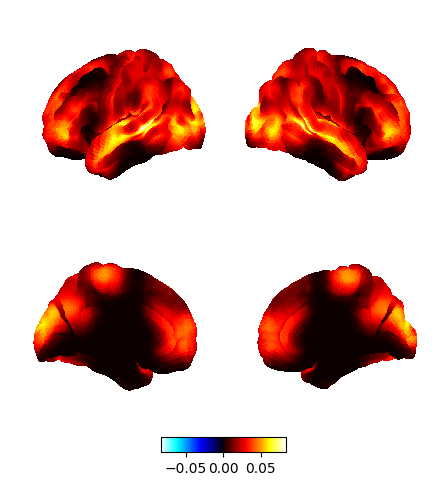

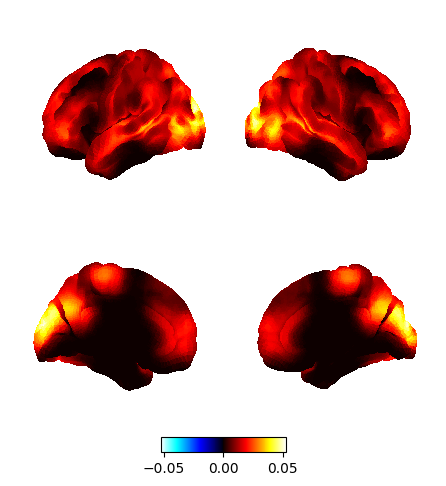

In [221]:
## Plotting power maps (averages over all subjects) per state
fig, ax = power.save(
    p_sc2,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

### Plot **relative** to something else (by **substracting the mean**)

Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.10s/it]


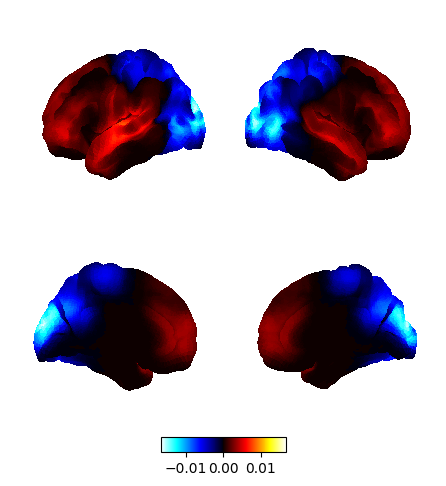

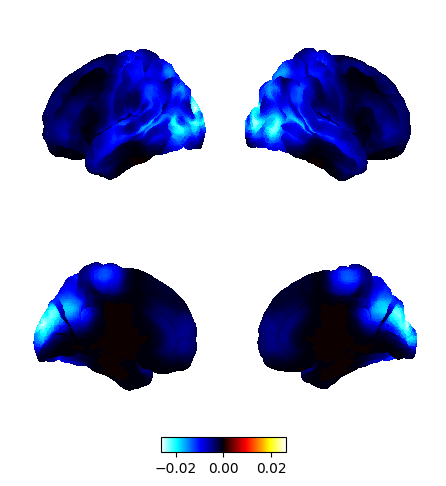

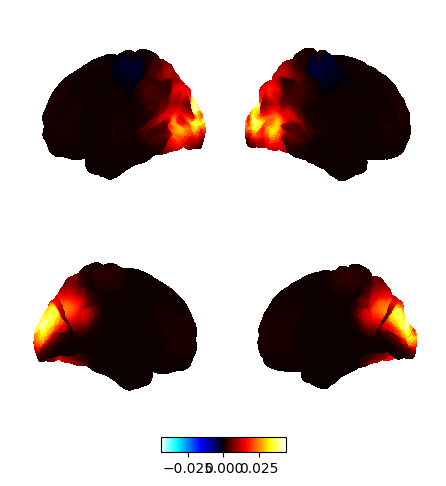

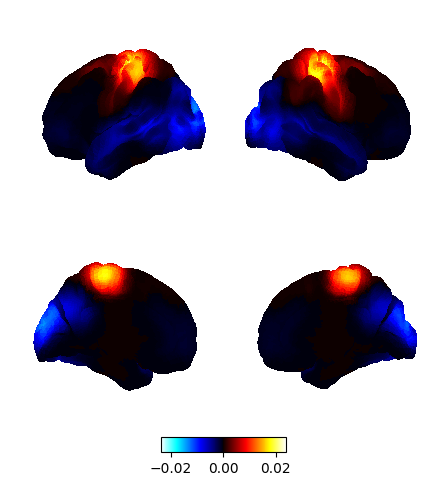

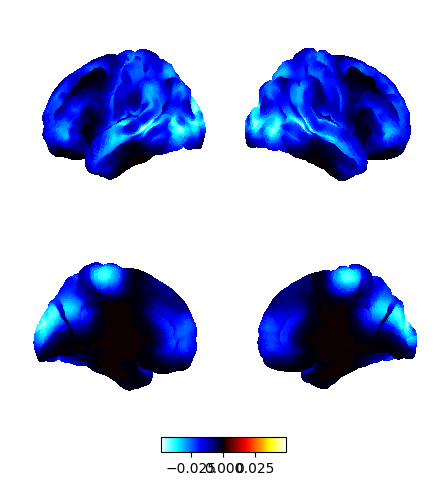

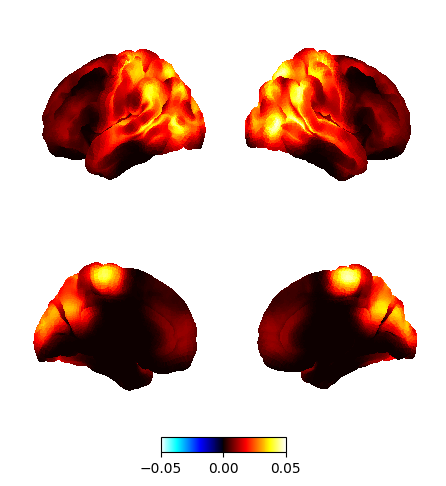

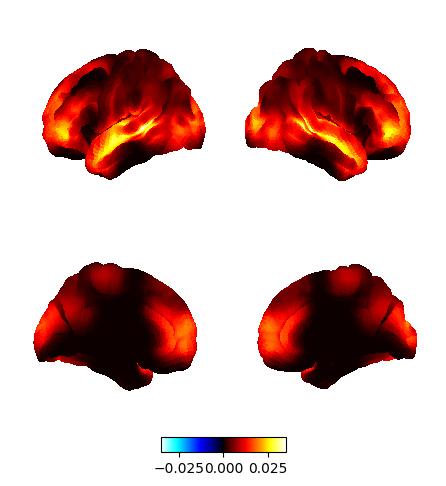

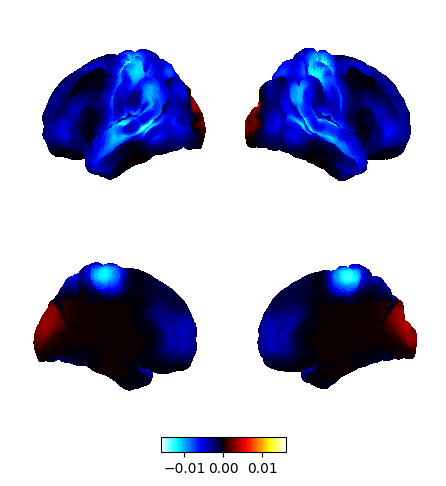

In [222]:
# Takes a few seconds for the power maps to appear
fig, ax = power.save(
    p_sc2,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
    subtract_mean=True,
)

### **Group analysis**

(37, 8, 38)
(8, 38)


Saving images: 100%|██████████| 8/8 [00:09<00:00,  1.13s/it]


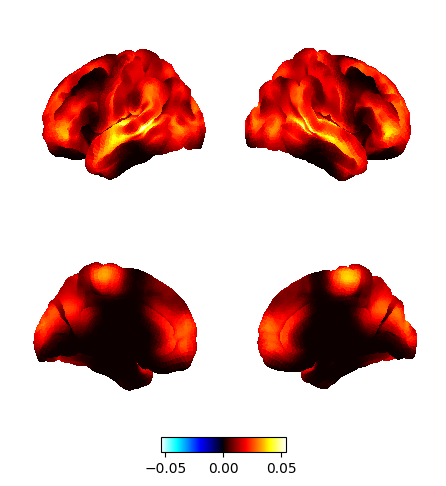

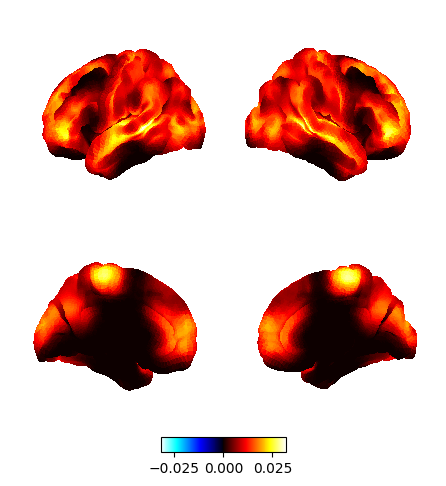

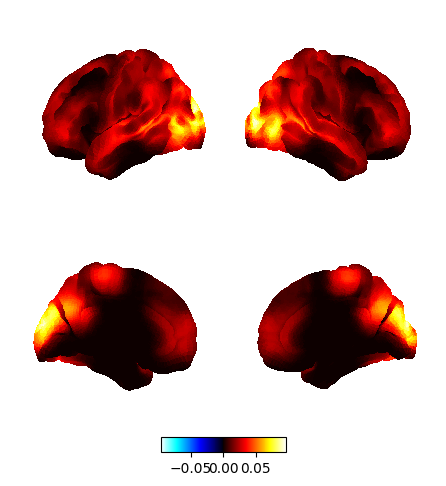

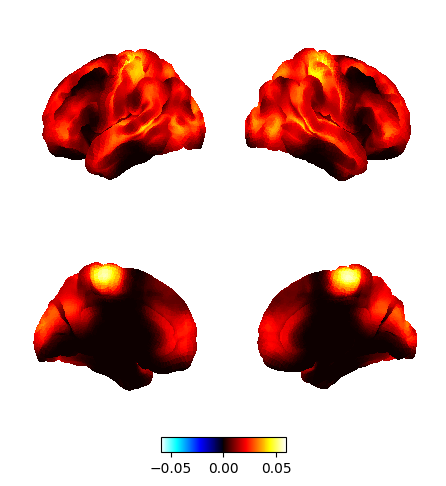

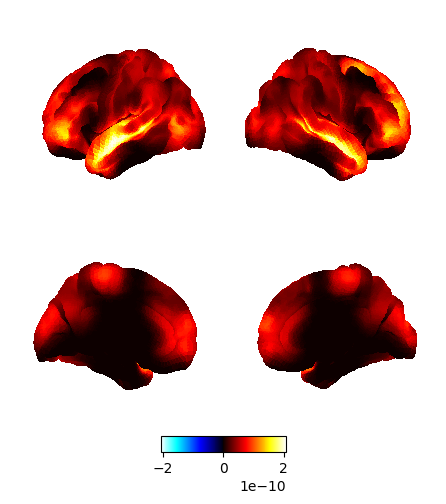

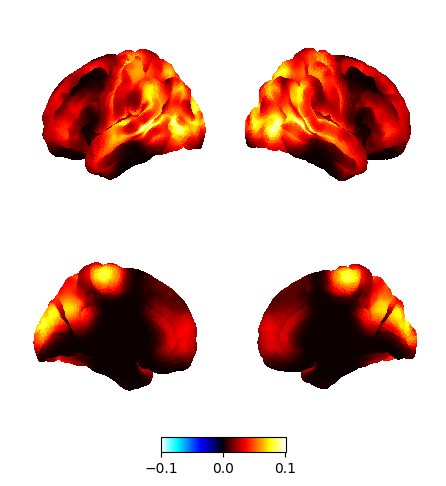

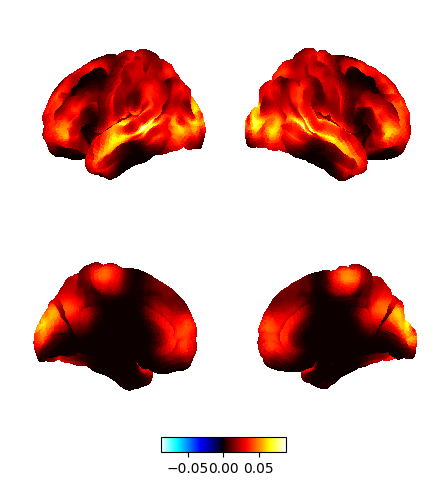

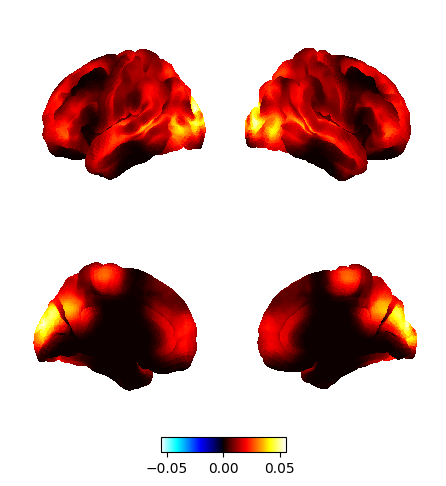

In [223]:
# Get the power arrays for group 1
p_sc2_control = power.variance_from_spectra(f, psd, wb_comp)[df_control_idx,1]

# Get the power arrays for group 2
p_sc2_ms = power.variance_from_spectra(f, psd, wb_comp)[df_ms_idx,1]


# Group means
p_sc2_control_mean = np.mean(p_sc2_control,axis=0)
p_sc2_ms_mean = np.mean(p_sc2_ms,axis=0)

print(np.shape(p_sc2_control))
print(np.shape(p_sc2_control_mean))

# Plot (it takes a few seconds for the brain maps to be shown)
fig, ax = power.save(
    [p_sc2_control_mean, p_sc2_ms_mean],
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

### Plot the **diffference between the 2 groups**

Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.08s/it]


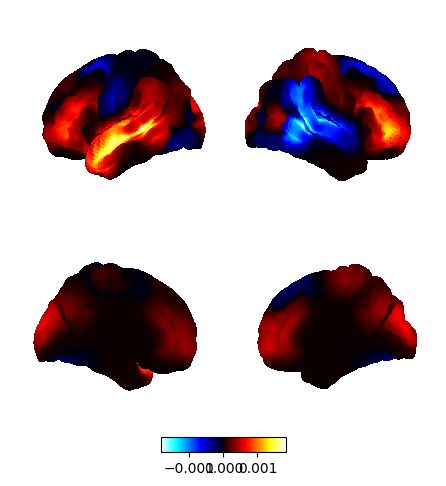

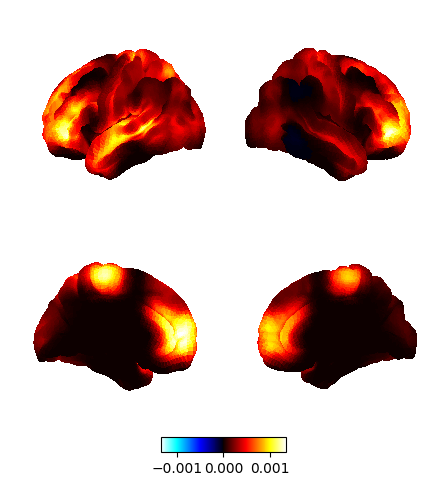

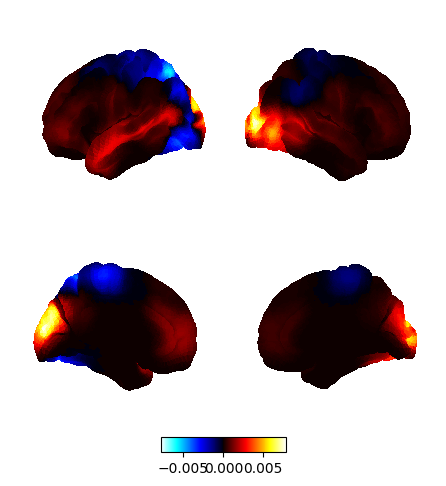

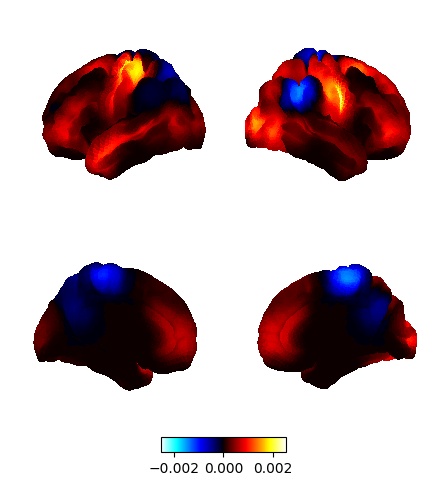

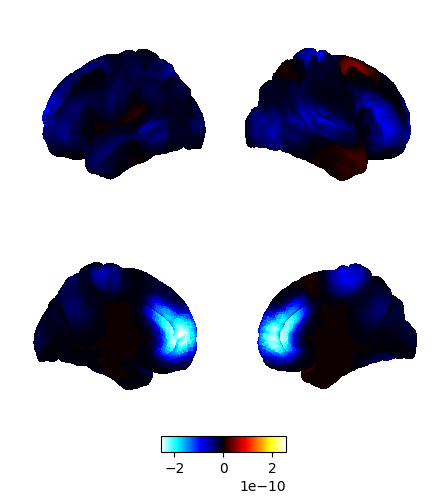

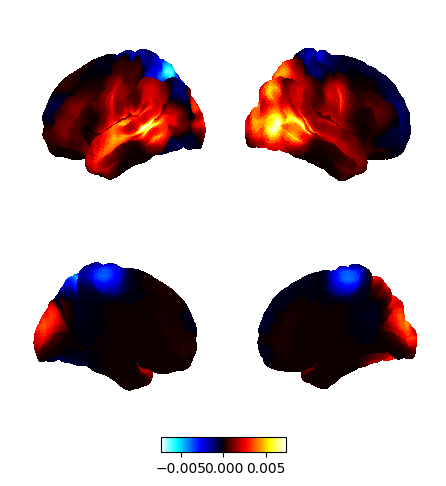

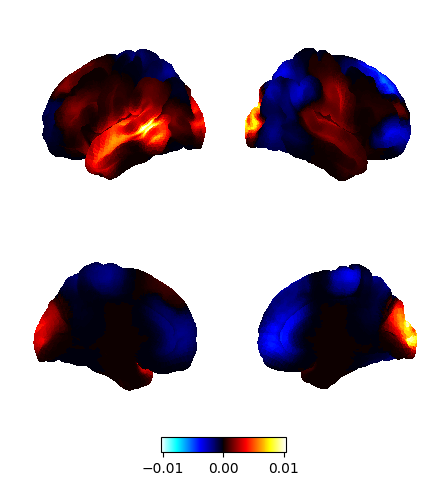

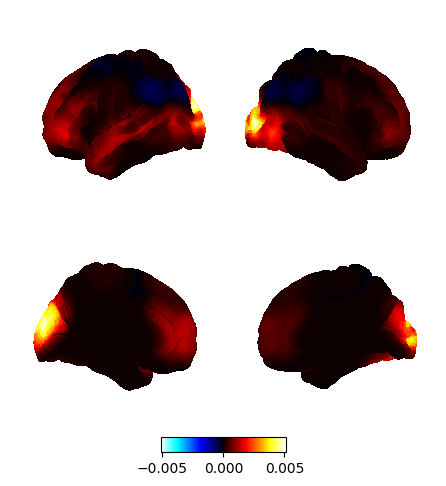

In [224]:
# Calculate the difference in power between the groups
p_diff = p_sc2_control_mean - p_sc2_ms_mean

# Plot
fig, ax = power.save(
    p_diff,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

#### **Statistical significance testing**

### **HC vs. MS**

In [225]:
from osl_dynamics.analysis import statistics

# Group assignments
## use assignments variable defined in the section of the Summary Statistics
p_sc2_gd = power.variance_from_spectra(f, psd, wb_comp)[:,1]

# Do significant testing
diff, pvalues = statistics.group_diff_max_stat_perm(
    p_sc2_gd,
    assignments,
    n_perm=500,
)

# Do we have any significant parcels?
print("Number of significant parcels:", np.sum(pvalues < 0.05))

Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 500 permutations
	Taking max-stat across ['features 1', 'features 2'] dimensions
Using tstats as metric
Number of significant parcels: 0


##### **If you have parcels with a significant difference in power between groups:**

Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.09s/it]


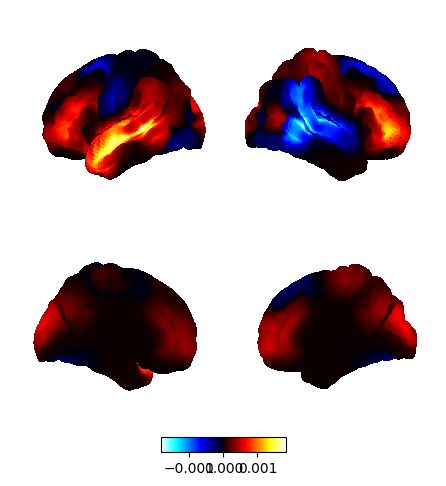

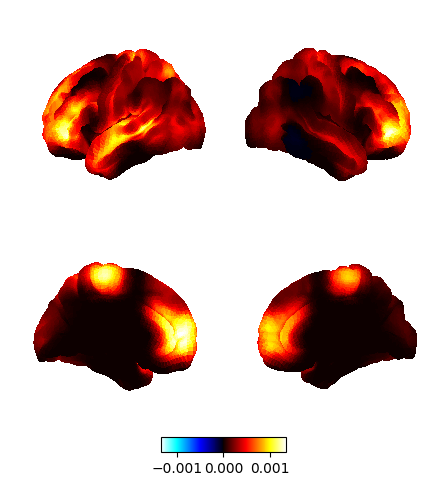

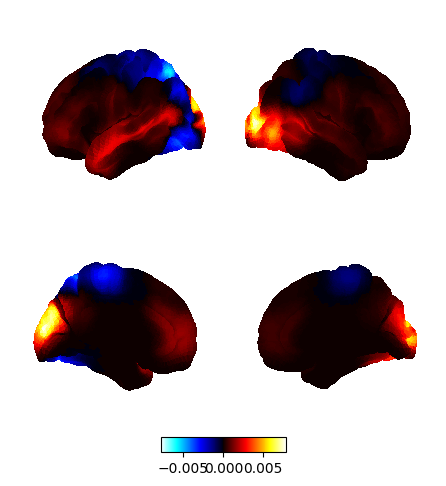

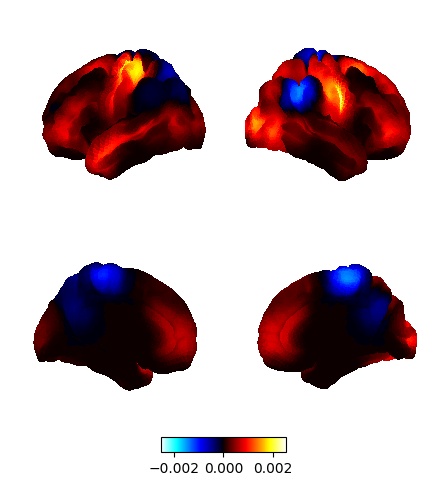

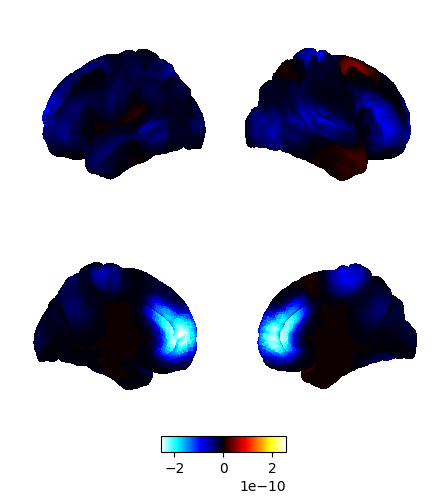

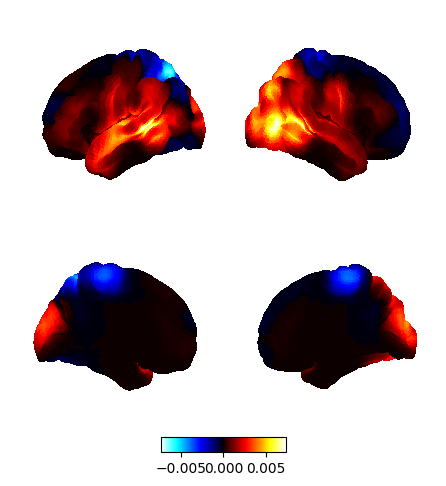

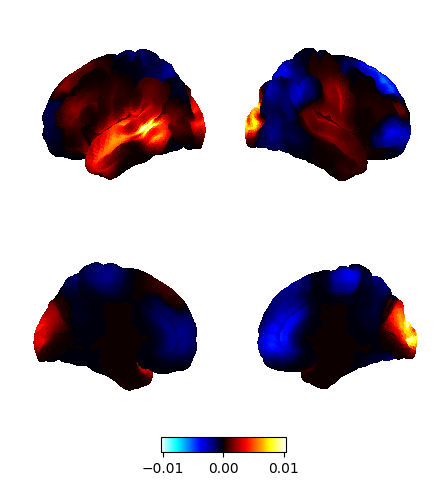

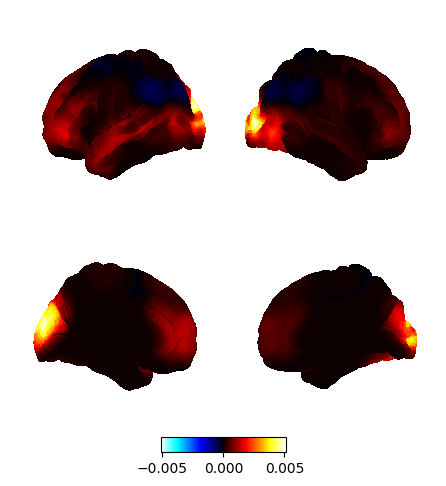

In [226]:
# Zero non-significant parcels
diff_sig = diff.copy()
diff_sig[pvalues < 0.05] = 0

# Plot
fig, ax = power.save(
    diff_sig,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

### **Coherence plots**

### **NNMF**

In [297]:
# Calculate the coherence network for each state by weighting with the spectral components
c = connectivity.mean_coherence_from_spectra(f, coh, wb_comp)
print(c.shape)

# Average over subjects
mean_c = np.mean(c, axis=0)
print(mean_c.shape)

# Threshold each network and look for the top 3% of connections relative to the mean
thres_mean_c = connectivity.threshold(mean_c, percentile=98, subtract_mean=True)
print(thres_mean_c.shape)

(110, 4, 8, 38, 38)
(4, 8, 38, 38)
(4, 8, 38, 38)


In [298]:
sc = 1
os.makedirs(model_name + "/data/Images" + "/Basic_Coherence_NNMF", exist_ok=True)
connectivity.save(
    thres_mean_c,
    parcellation_file="/home/olivierb/38_parcels.nii",
    component=sc, #1st spectral component
    filename=model_name + "/data/Images/Basic_Coherence_NNMF/coh_Spectral_Comp_" + str(sc+1) + "_State_.png"
)

Saving images: 100%|██████████| 8/8 [00:09<00:00,  1.23s/it]


## **Thresholded 2%**

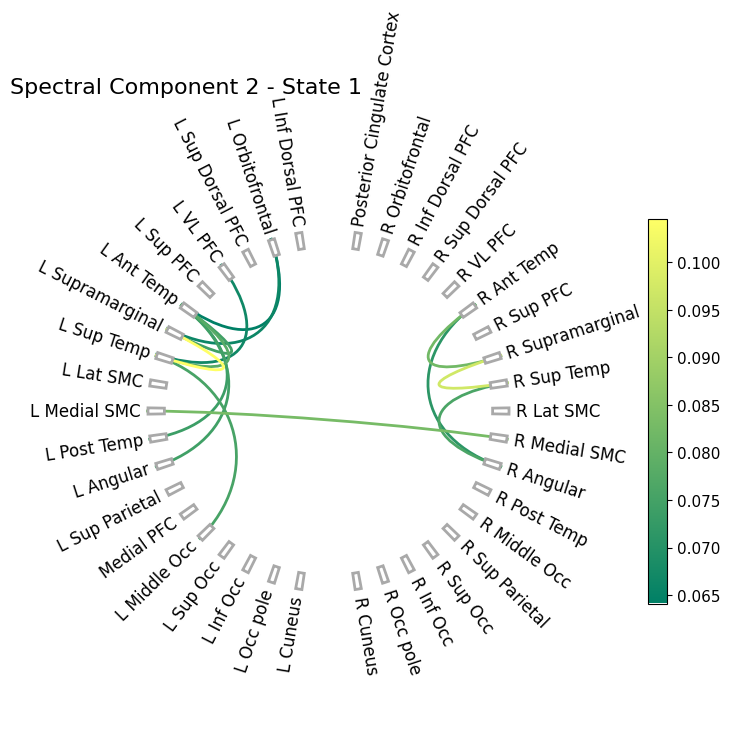

In [229]:
connectivity_6states_SC2 = thres_mean_c[1]
connectivity_6states_SC2_S1 = connectivity_6states_SC2[0]

sc=1
title = 'Spectral Component 2 - State 1                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S1, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

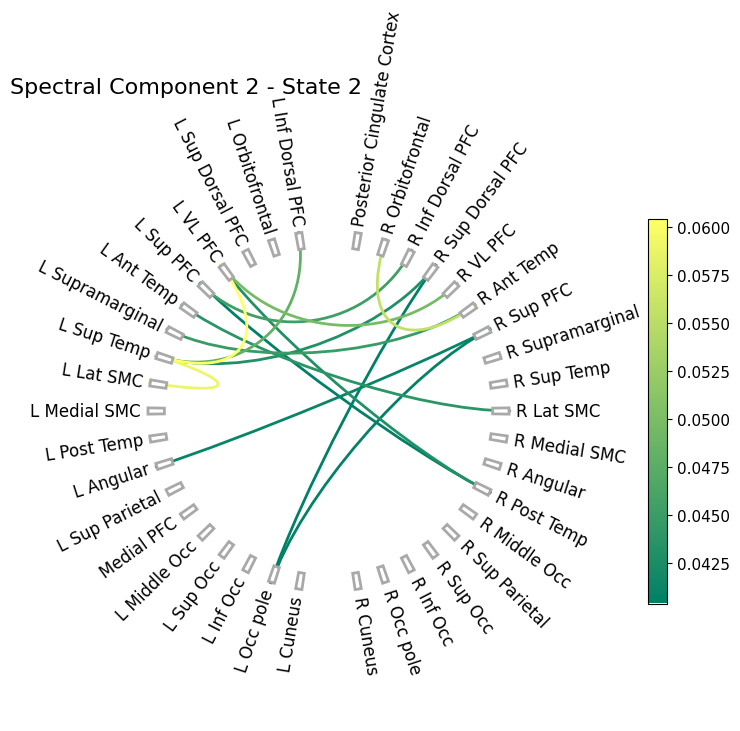

In [230]:
connectivity_6states_SC2_S2 = connectivity_6states_SC2[1]

sc=1
title = 'Spectral Component 2 - State 2                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S2, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

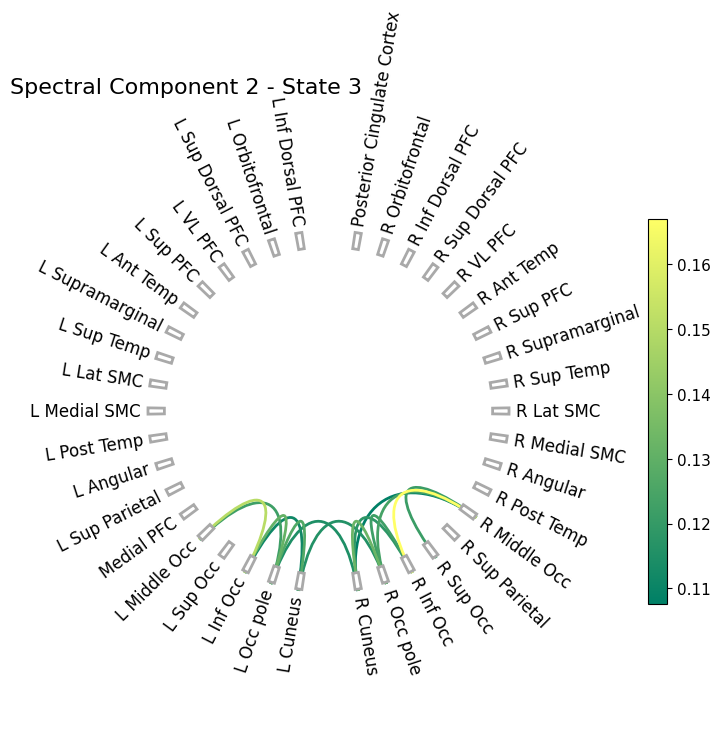

In [231]:
connectivity_6states_SC2_S3 = connectivity_6states_SC2[2]

sc=1
title = 'Spectral Component 2 - State 3                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S3, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

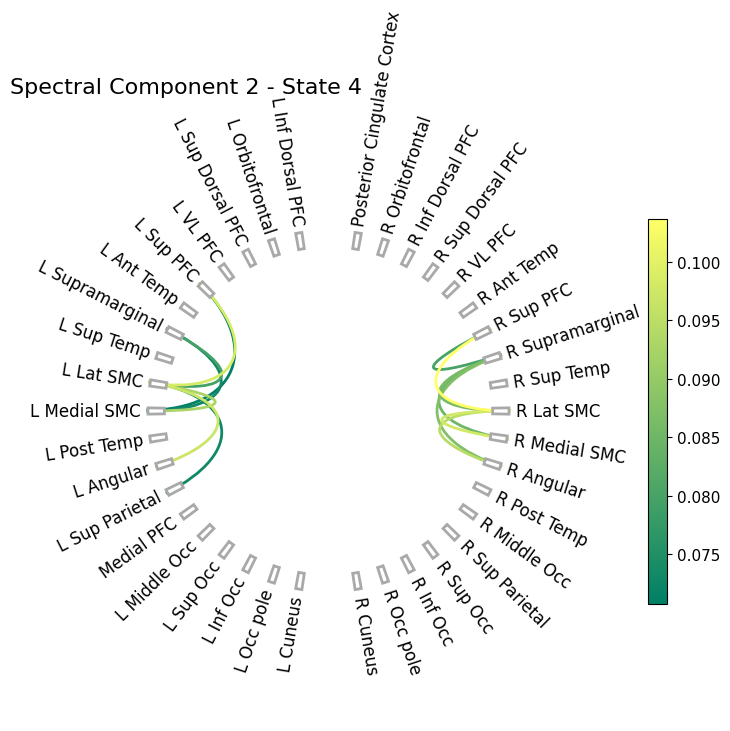

In [232]:
connectivity_6states_SC2_S4 = connectivity_6states_SC2[3]

sc=1
title = 'Spectral Component 2 - State 4                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S4, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

/home/olivierb/.local/lib/python3.9/site-packages/mne/viz/circle.py:289: RuntimeWarning: invalid value encountered in divide
  con_val_scaled = (con - vmin) / vrange


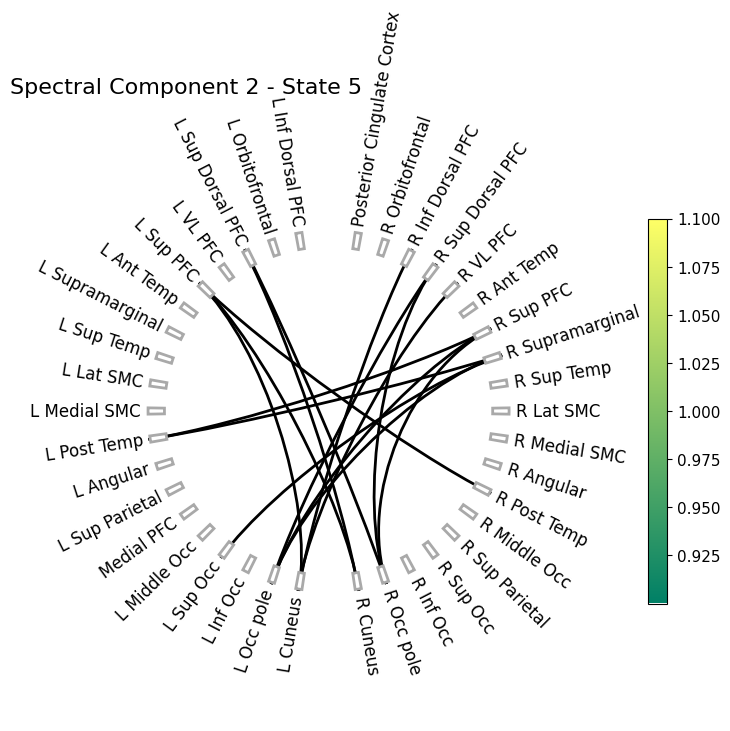

In [233]:
connectivity_6states_SC2_S5 = connectivity_6states_SC2[4]

sc=1
title = 'Spectral Component 2 - State 5                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S5, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

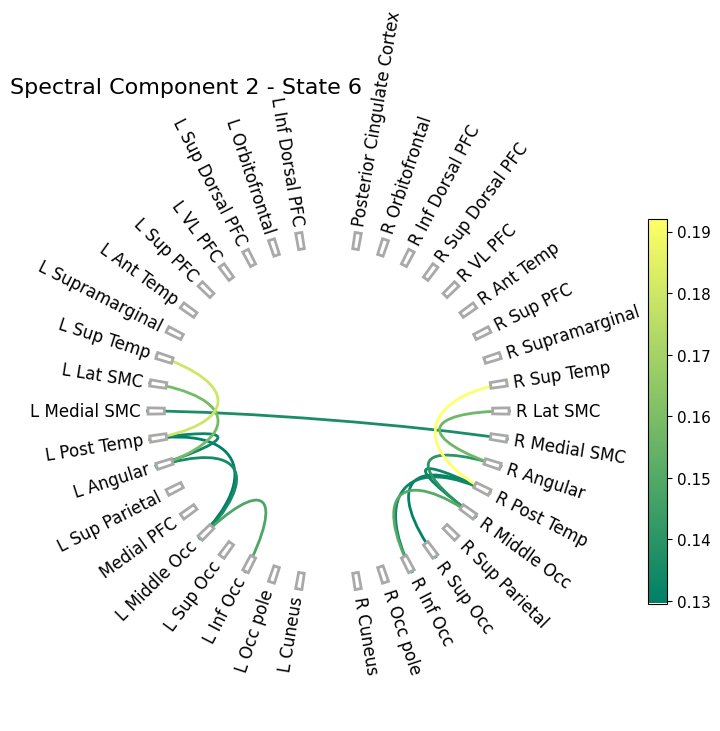

In [234]:
connectivity_6states_SC2_S6 = connectivity_6states_SC2[5]

sc=1
title = 'Spectral Component 2 - State 6                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S6, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

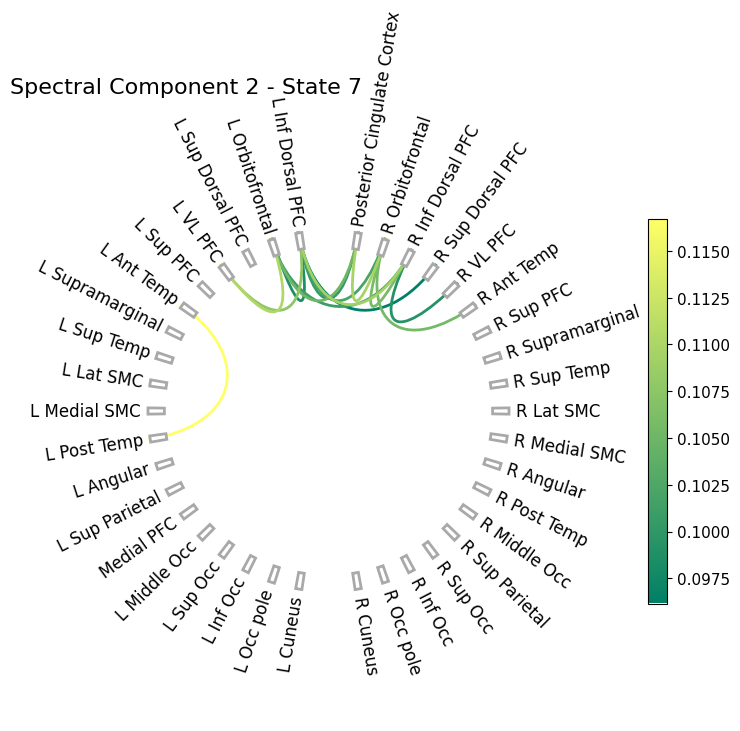

In [235]:
connectivity_6states_SC2_S7 = connectivity_6states_SC2[6]

sc=1
title = 'Spectral Component 2 - State 7                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S7, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

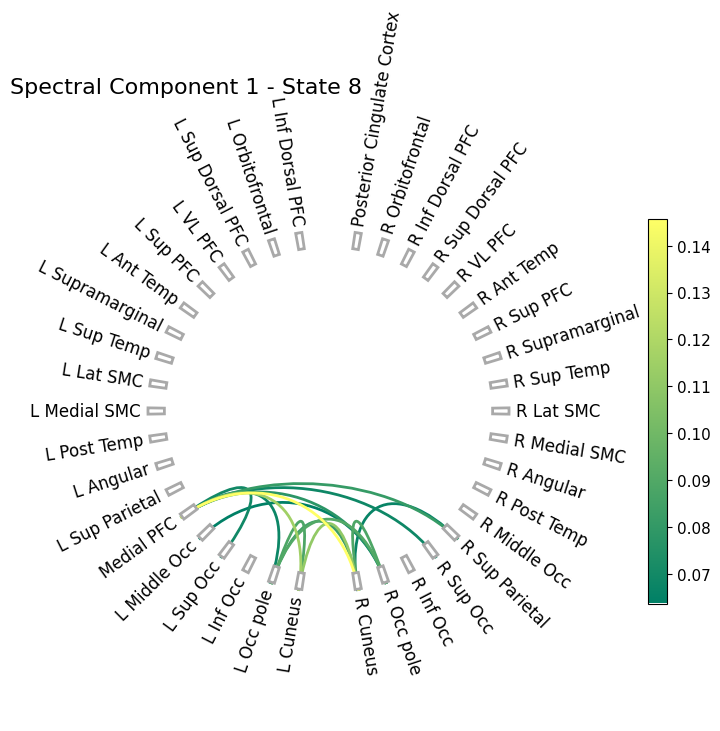

In [219]:
connectivity_6states_SC2_S8 = connectivity_6states_SC2[7]

sc=1
title = 'Spectral Component 2 - State 8                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S8, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

## **Data-driven thresholding: Gaussian Mixture Model (GMM)**

In [244]:
mean_c = mean_c[:][:,np.array([True, True, True, True, False, True, True, True])]
print(np.shape(mean_c))

(4, 7, 38, 38)


/home/olivierb/osl-dynamics/osl_dynamics/utils/plotting.py:72: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(*args, **kwargs)


(4, 7, 38, 38)


Saving images: 100%|██████████| 7/7 [00:08<00:00,  1.25s/it]


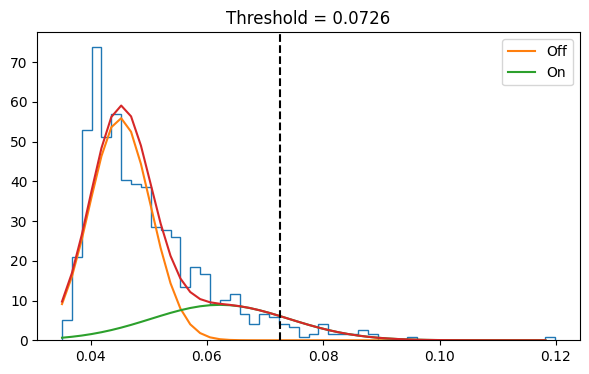

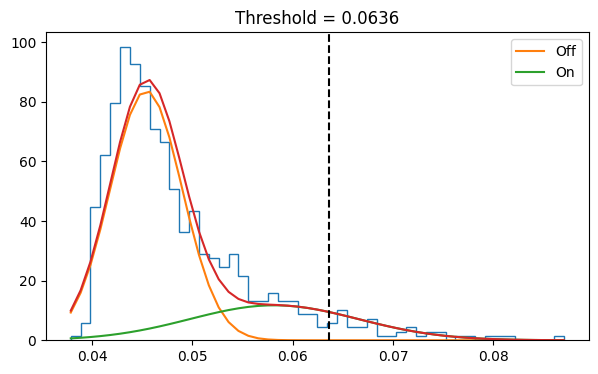

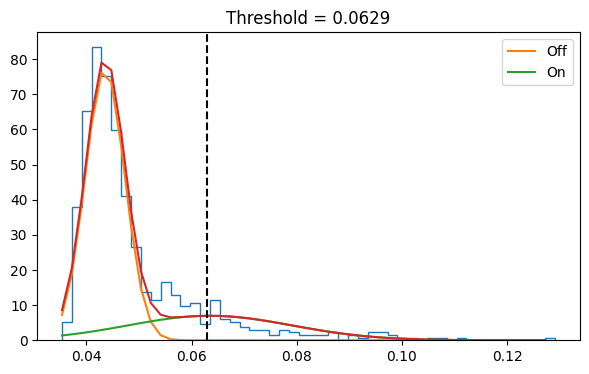

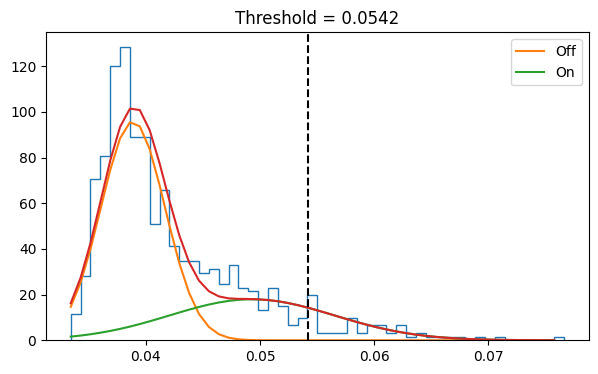

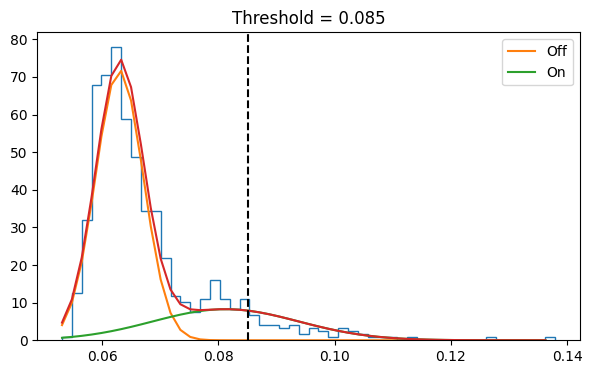

...

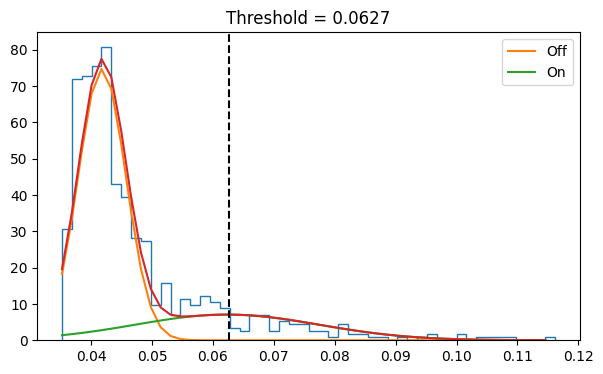

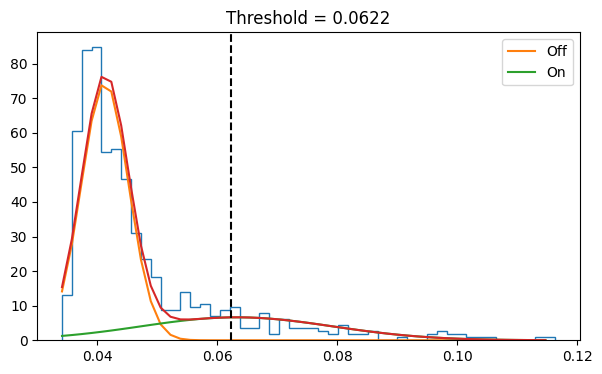

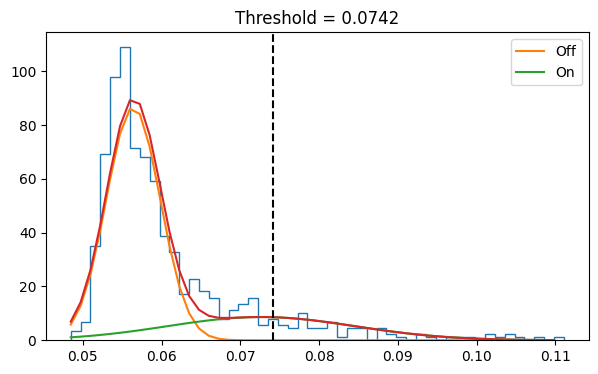

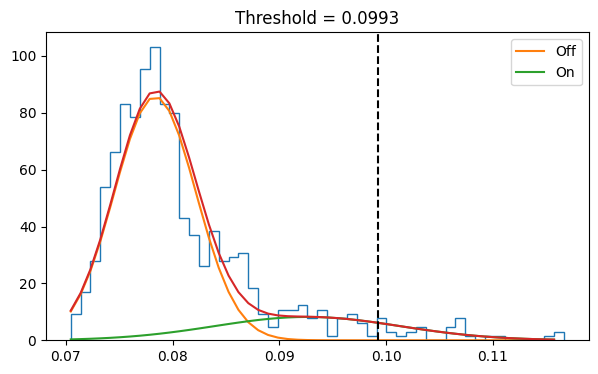

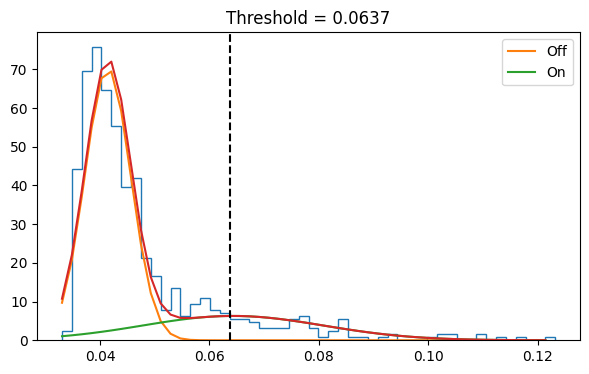

In [245]:
## This only needs to be ran once (it does the GMM data-driven thresholding for all SCs and all states together

sc = 1

# Threshold each network using a GMM
thres_mean_c = connectivity.gmm_threshold(
    mean_c,
    p_value=0.05,
    keep_positive_only=True,
    #subtract_mean=True,
    show=True,
)
print(thres_mean_c.shape)

os.makedirs(model_name + "/data/Images" + "/Basic_Coherence_GMM", exist_ok=True)

# Plot
connectivity.save(
    thres_mean_c,
    parcellation_file="/home/olivierb/38_parcels.nii",
    component=sc,
    filename=model_name + "/data/Images/Basic_Coherence_GMM/coh_Spectral_Comp_" + str(sc) + "_State_.png",
)

### **Spectral component 2**

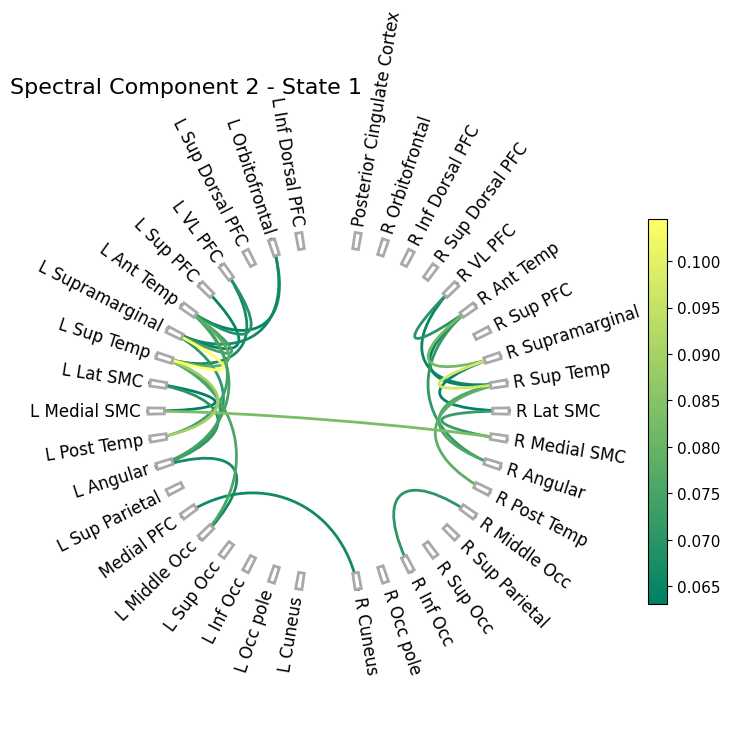

In [246]:
connectivity_6states_SC2_S1 = thres_mean_c[1][0]  # comp 2 state 1

sc=1
title = 'Spectral Component 2 - State 1                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S1, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

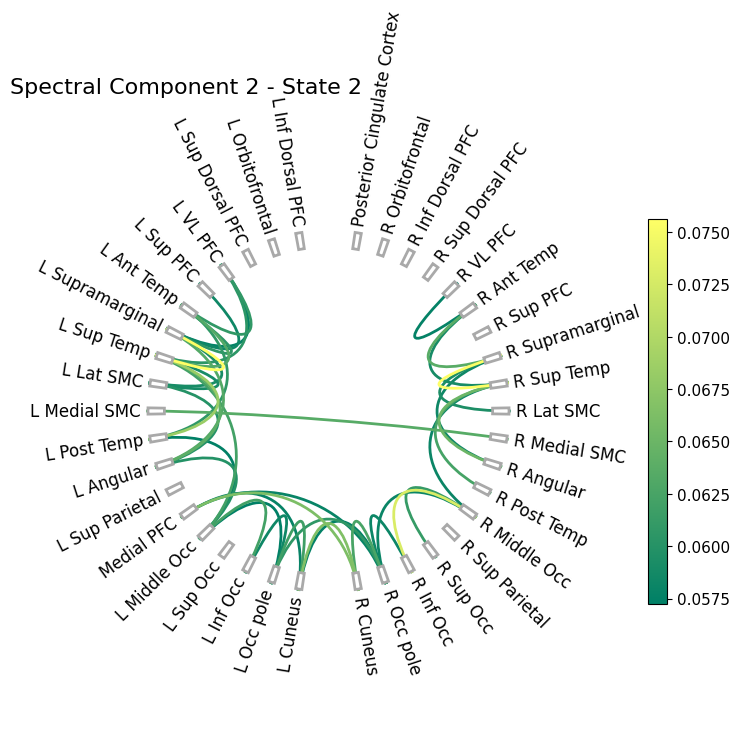

In [247]:
connectivity_6states_SC2_S2 = thres_mean_c[1][1]  # comp 2 state 2

sc=1
title = 'Spectral Component 2 - State 2                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S2, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

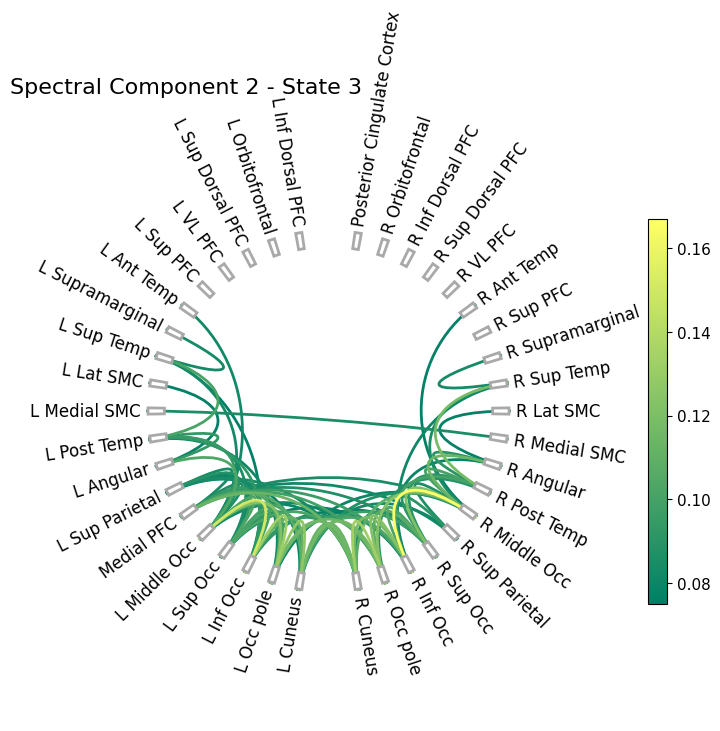

In [248]:
connectivity_6states_SC2_S3 = thres_mean_c[1][2]  # comp 2 state 3

sc=1
title = 'Spectral Component 2 - State 3                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S3, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

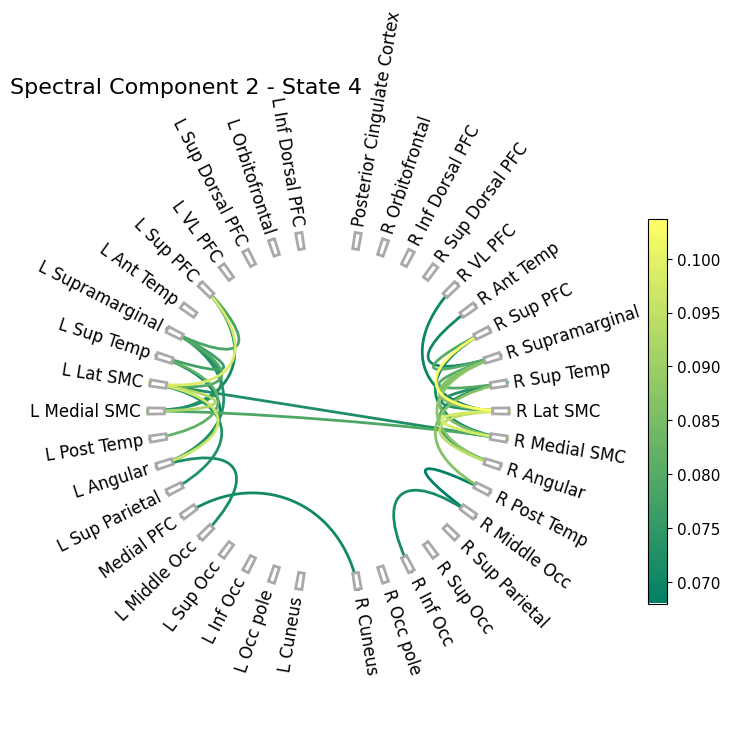

In [249]:
connectivity_6states_SC2_S4 = thres_mean_c[1][3]  # comp 2 state 4

sc=1
title = 'Spectral Component 2 - State 4                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S4, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

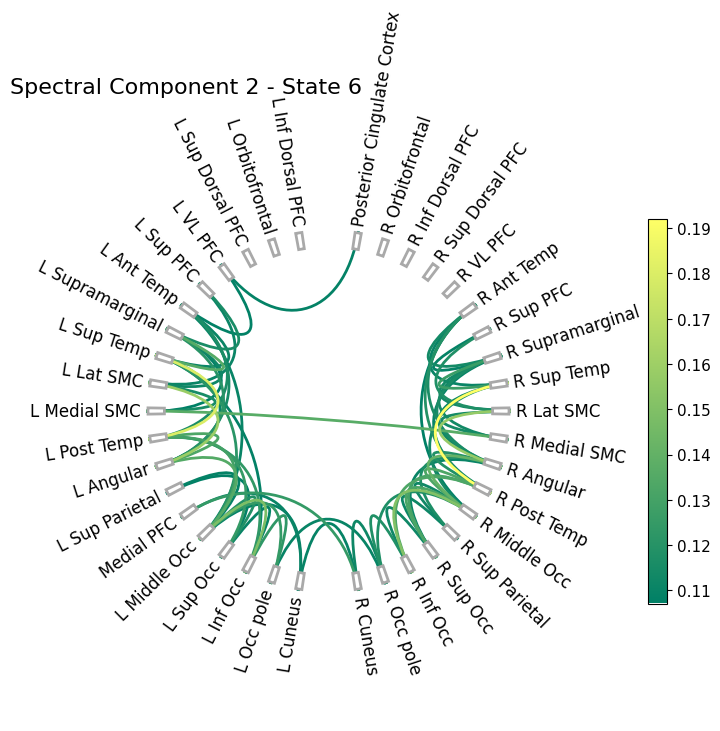

In [251]:
connectivity_6states_SC2_S6 = thres_mean_c[1][4]  # comp 2 state 6

sc=1
title = 'Spectral Component 2 - State 6                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S6, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

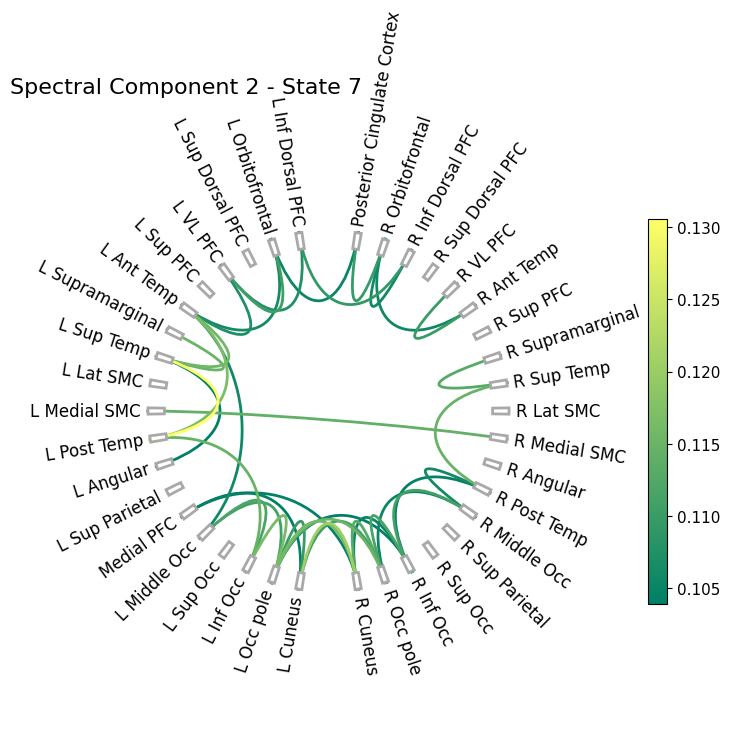

In [252]:
connectivity_6states_SC2_S7 = thres_mean_c[1][5]  # comp 2 state 7

sc=1
title = 'Spectral Component 2 - State 7                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S7, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

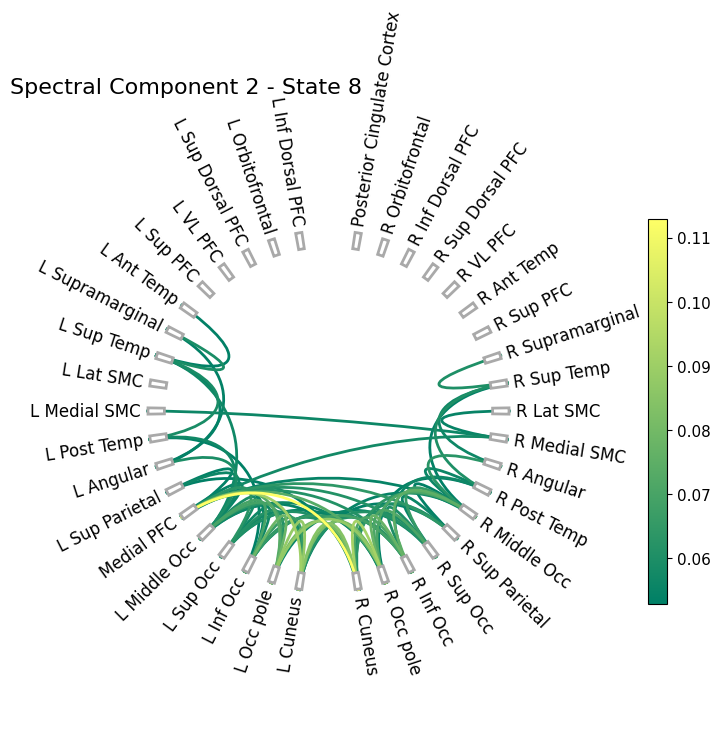

In [253]:
connectivity_6states_SC2_S8 = thres_mean_c[1][6]  # comp 2 state 8

sc=1
title = 'Spectral Component 2 - State 8                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC2_S8, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

## **Spectral Component 3**

In [254]:
# Integrate the power spectra over a frequency range, weighted by the spectral compoents
p_sc_all = power.variance_from_spectra(f, gpsd, wb_comp)
p_sc3 = p_sc_all[2]

Saving images: 100%|██████████| 8/8 [00:09<00:00,  1.15s/it]


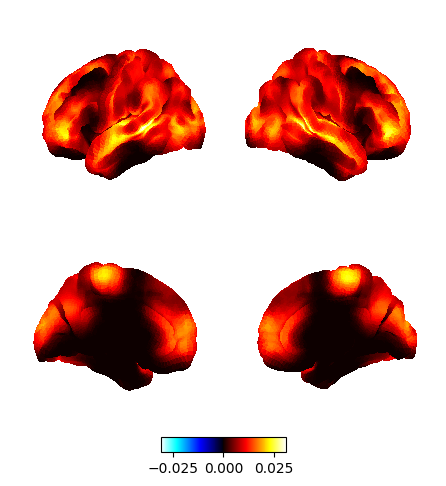

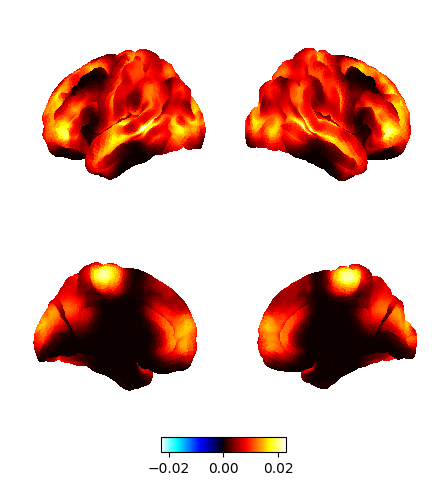

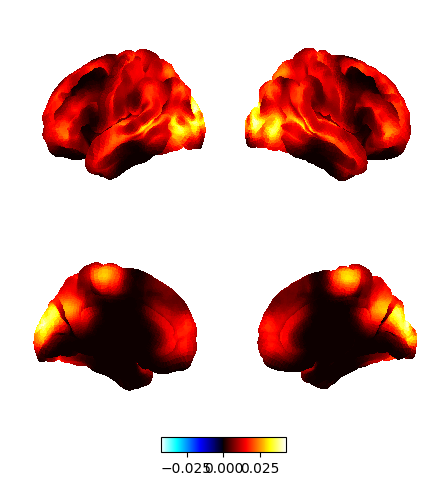

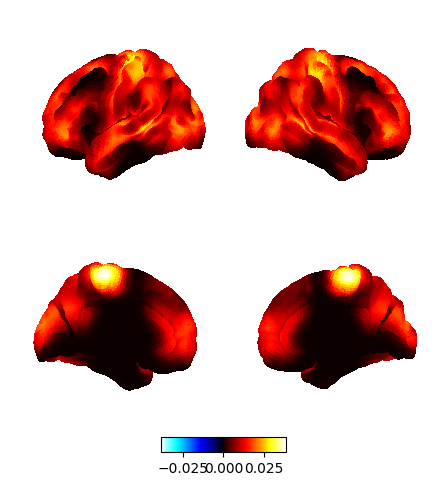

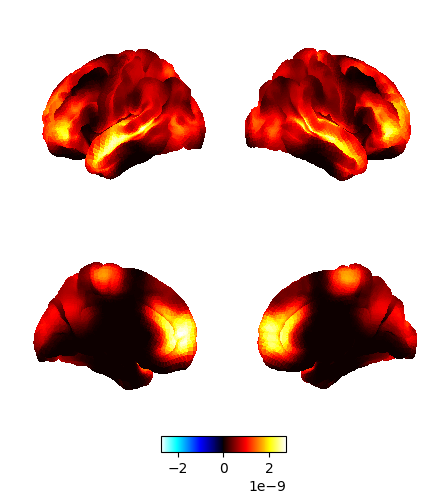

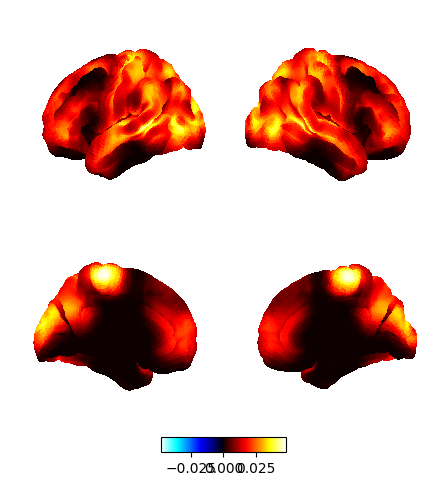

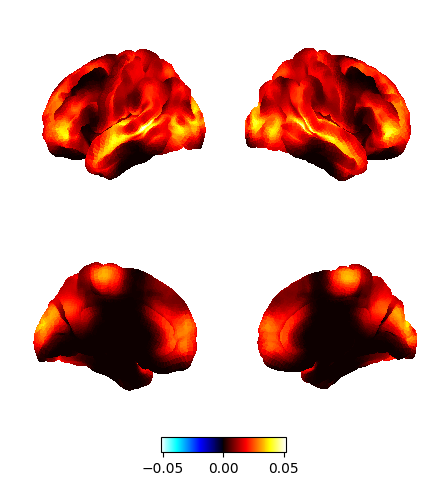

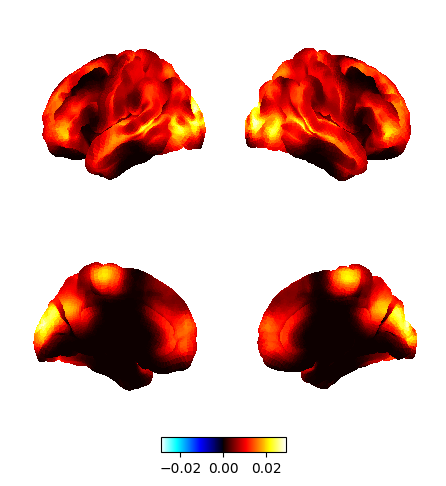

In [255]:
## Plotting power maps (averages over all subjects) per state
fig, ax = power.save(
    p_sc3,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

### Plot **relative** to something else (by **substracting the mean**)

Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.12s/it]


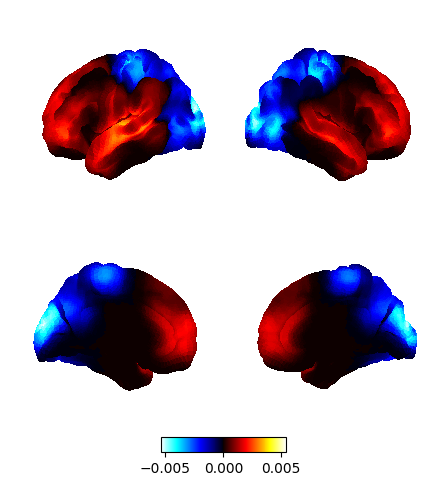

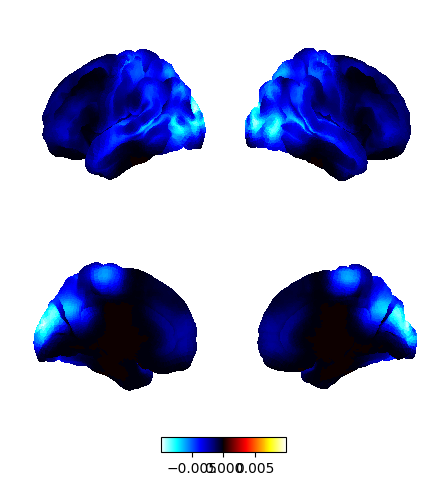

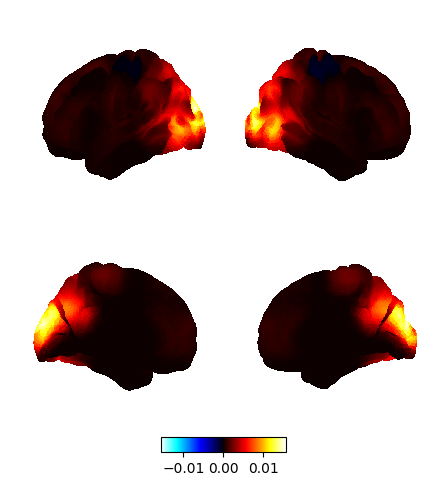

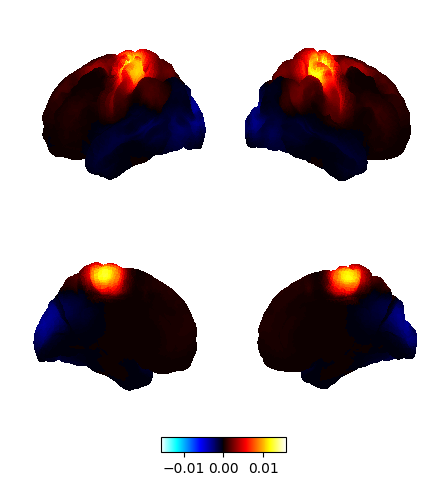

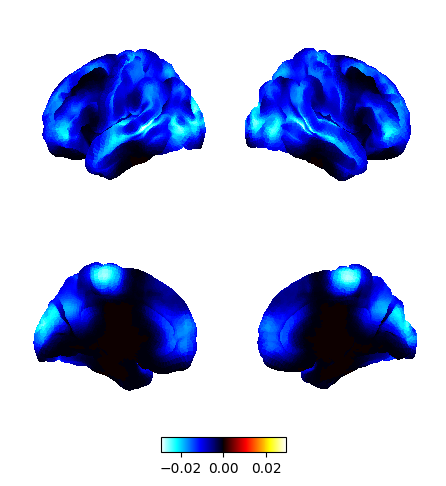

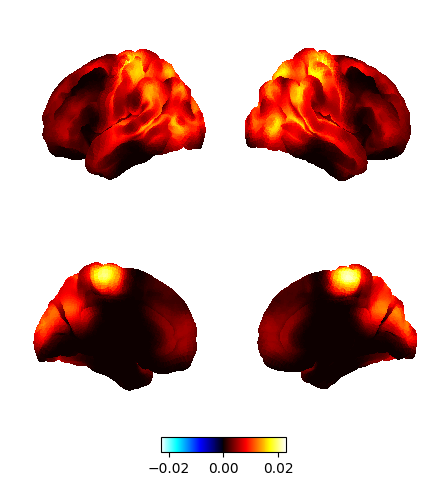

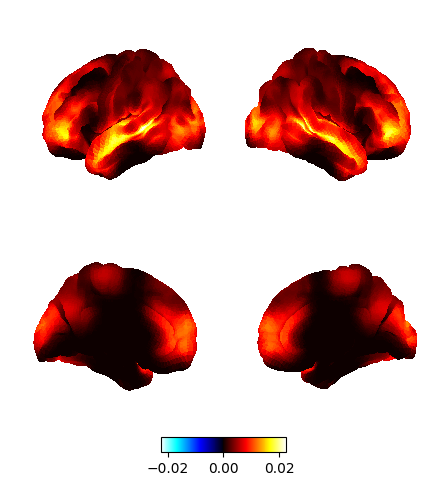

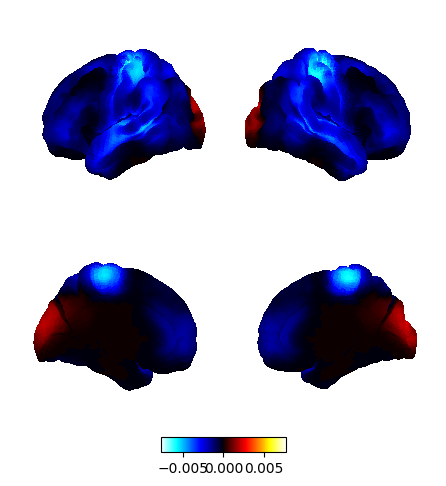

In [256]:
# Takes a few seconds for the power maps to appear
fig, ax = power.save(
    p_sc3,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
    subtract_mean=True,
)

### **Group analysis**

(37, 8, 38)
(8, 38)


Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.12s/it]


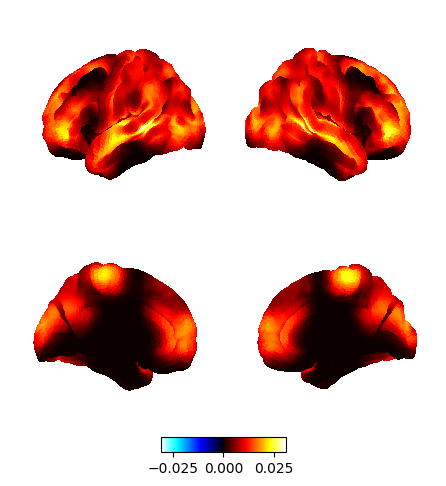

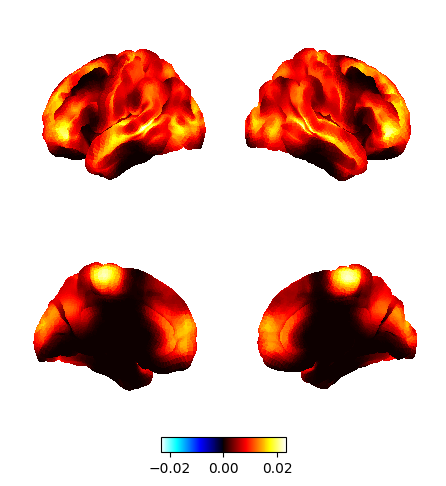

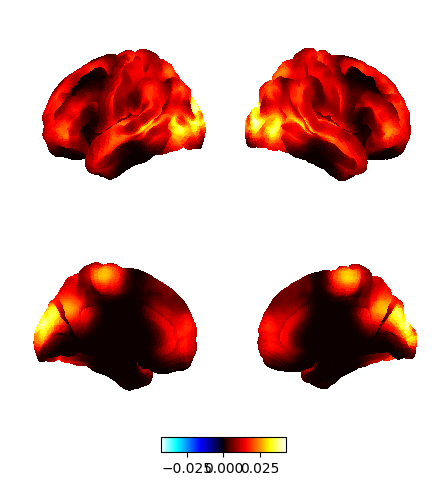

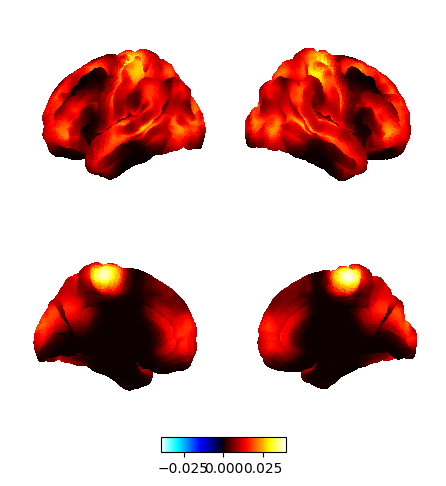

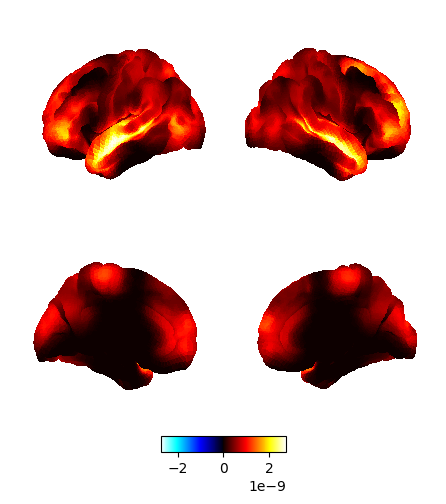

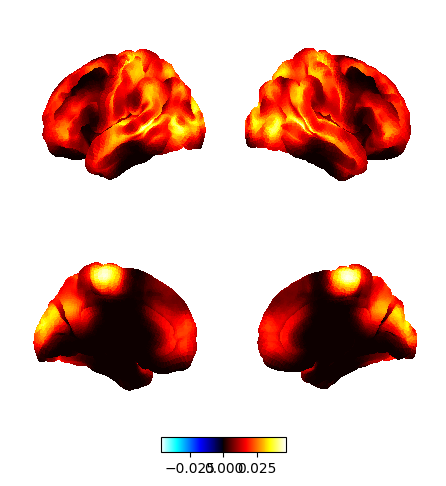

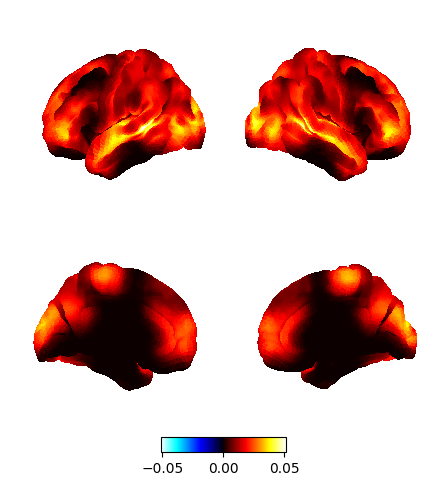

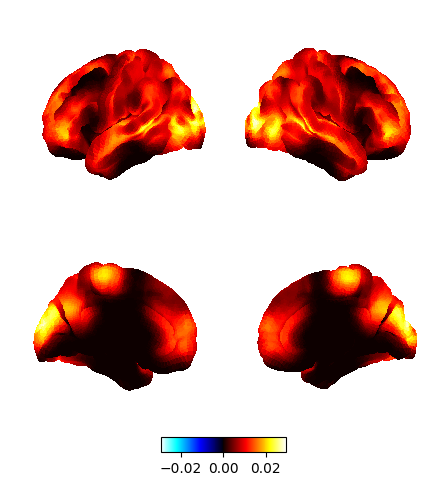

In [257]:
# Get the power arrays for group 1
p_sc3_control = power.variance_from_spectra(f, psd, wb_comp)[df_control_idx,2]

# Get the power arrays for group 2
p_sc3_ms = power.variance_from_spectra(f, psd, wb_comp)[df_ms_idx,2]


# Group means
p_sc3_control_mean = np.mean(p_sc3_control,axis=0)
p_sc3_ms_mean = np.mean(p_sc3_ms,axis=0)

print(np.shape(p_sc3_control))
print(np.shape(p_sc3_control_mean))

# Plot (it takes a few seconds for the brain maps to be shown)
fig, ax = power.save(
    [p_sc3_control_mean, p_sc3_ms_mean],
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

### Plot the **diffference between the 2 groups**

Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.07s/it]


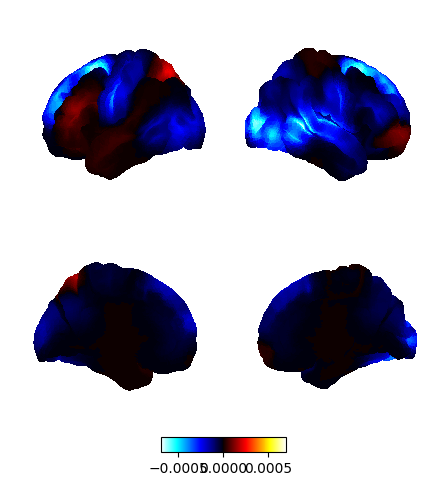

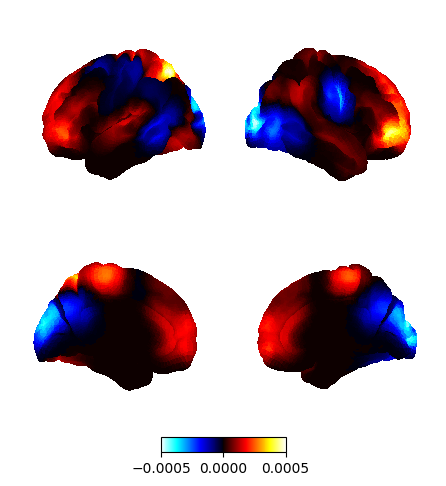

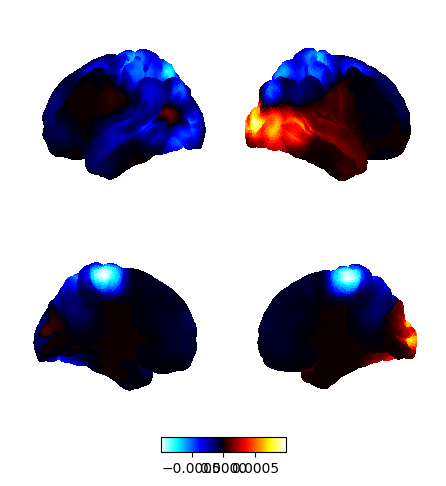

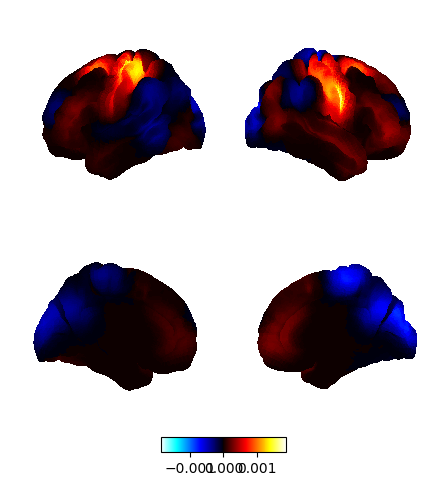

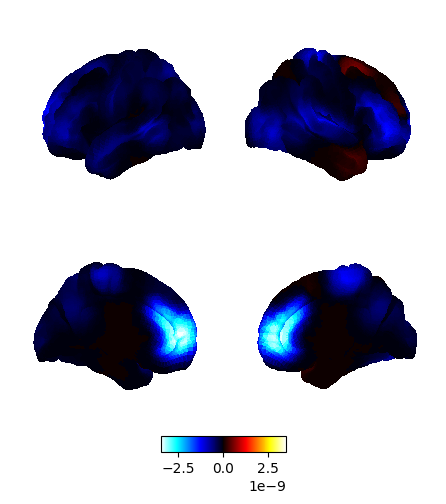

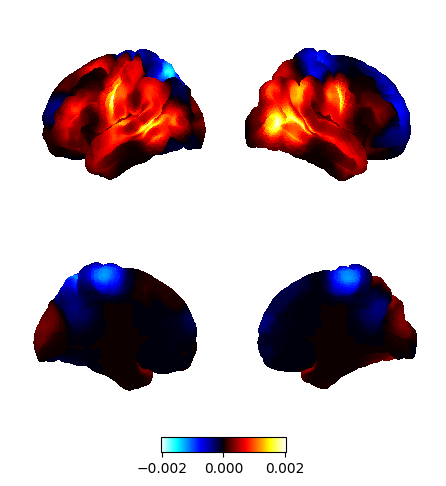

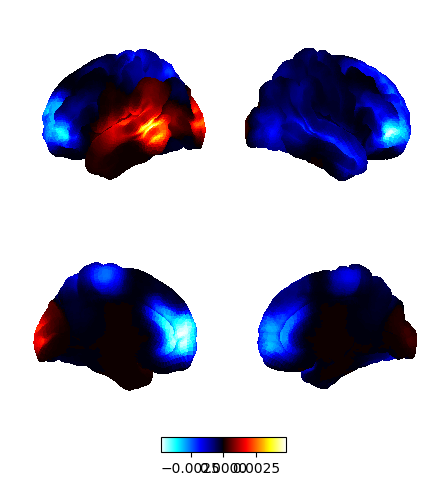

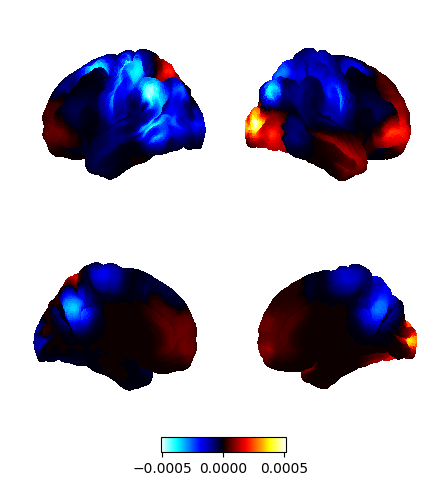

In [258]:
# Calculate the difference in power between the groups
p_diff = p_sc3_control_mean - p_sc3_ms_mean

# Plot
fig, ax = power.save(
    p_diff,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

#### **Statistical significance testing**

### **HC vs. MS**

In [259]:
from osl_dynamics.analysis import statistics

# Group assignments
## use assignments variable defined in the section of the Summary Statistics
p_sc3_gd = power.variance_from_spectra(f, psd, wb_comp)[:,2]

# Do significant testing
diff, pvalues = statistics.group_diff_max_stat_perm(
    p_sc3_gd,
    assignments,
    n_perm=500,
)

# Do we have any significant parcels?
print("Number of significant parcels:", np.sum(pvalues < 0.05))

Permuting contrast <class 'glmtools.design.Contrast'>(GroupDiff,Differential) with mode=row-shuffle
	Computing 500 permutations
	Taking max-stat across ['features 1', 'features 2'] dimensions
Using tstats as metric
Number of significant parcels: 0


##### **If you have parcels with a significant difference in power between groups:**

Saving images: 100%|██████████| 8/8 [00:08<00:00,  1.12s/it]


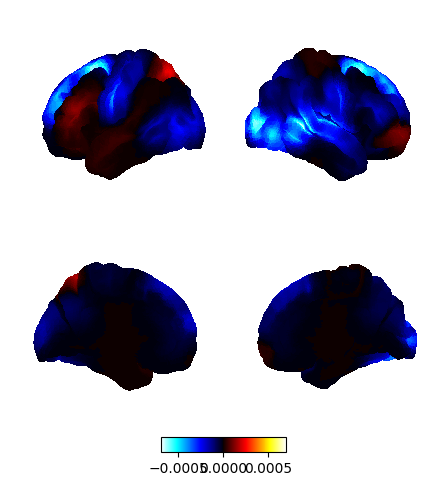

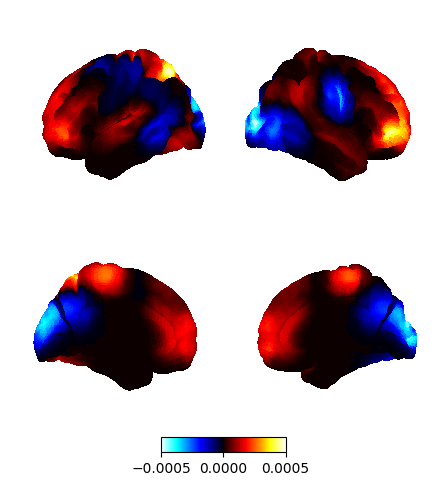

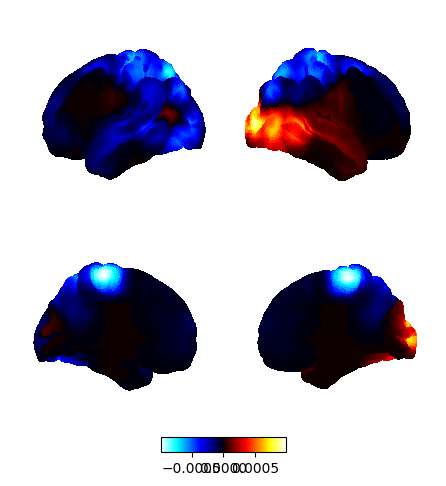

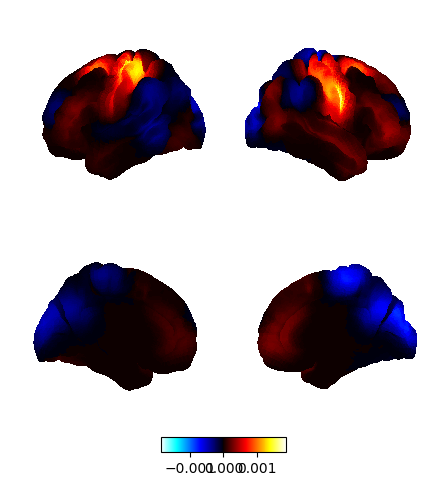

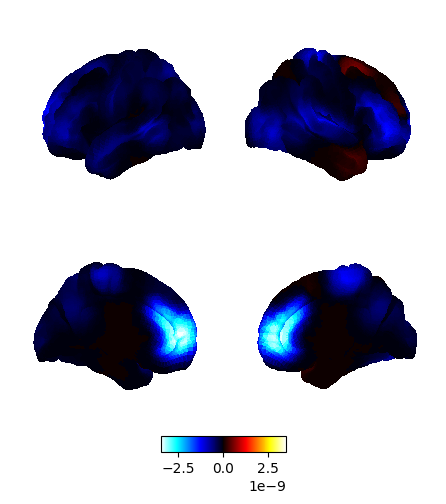

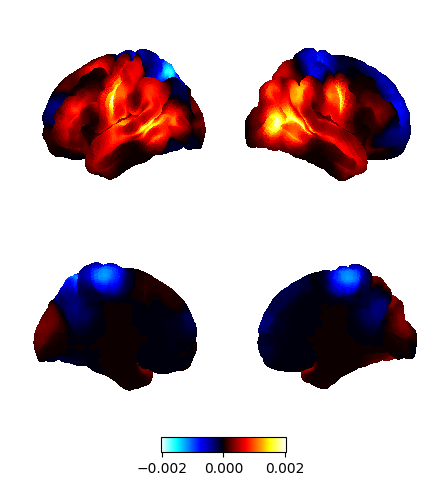

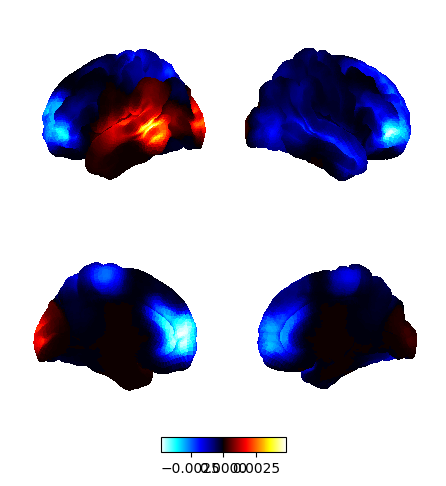

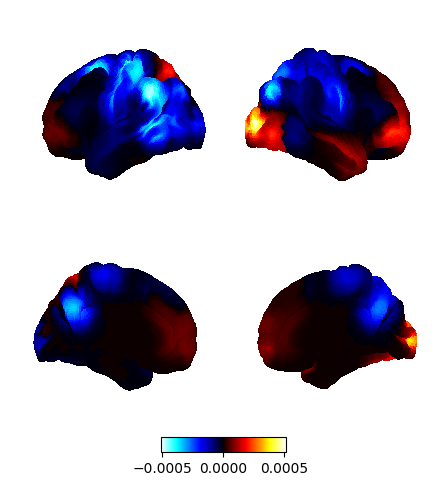

In [260]:
# Zero non-significant parcels
diff_sig = diff.copy()
diff_sig[pvalues < 0.05] = 0

# Plot
fig, ax = power.save(
    diff_sig,
    mask_file="/home/fakbaria/osl/std_masks/MNI152_T1_8mm_brain.nii.gz",
    parcellation_file="/home/olivierb/38_parcels.nii",
)

### **Coherence plots**

### **NNMF**

In [299]:
# Calculate the coherence network for each state by weighting with the spectral components
c = connectivity.mean_coherence_from_spectra(f, coh, wb_comp)
print(c.shape)

# Average over subjects
mean_c = np.mean(c, axis=0)
print(mean_c.shape)

# Threshold each network and look for the top 3% of connections relative to the mean
thres_mean_c = connectivity.threshold(mean_c, percentile=98, subtract_mean=True)
print(thres_mean_c.shape)

(110, 4, 8, 38, 38)
(4, 8, 38, 38)
(4, 8, 38, 38)


In [300]:
sc = 2
os.makedirs(model_name + "/data/Images" + "/Basic_Coherence_NNMF", exist_ok=True)
connectivity.save(
    thres_mean_c,
    parcellation_file="/home/olivierb/38_parcels.nii",
    component=sc, #1st spectral component
    filename=model_name + "/data/Images/Basic_Coherence_NNMF/coh_Spectral_Comp_" + str(sc+1) + "_State_.png"
)

Saving images: 100%|██████████| 8/8 [00:10<00:00,  1.35s/it]


## **Thresholded 2%**

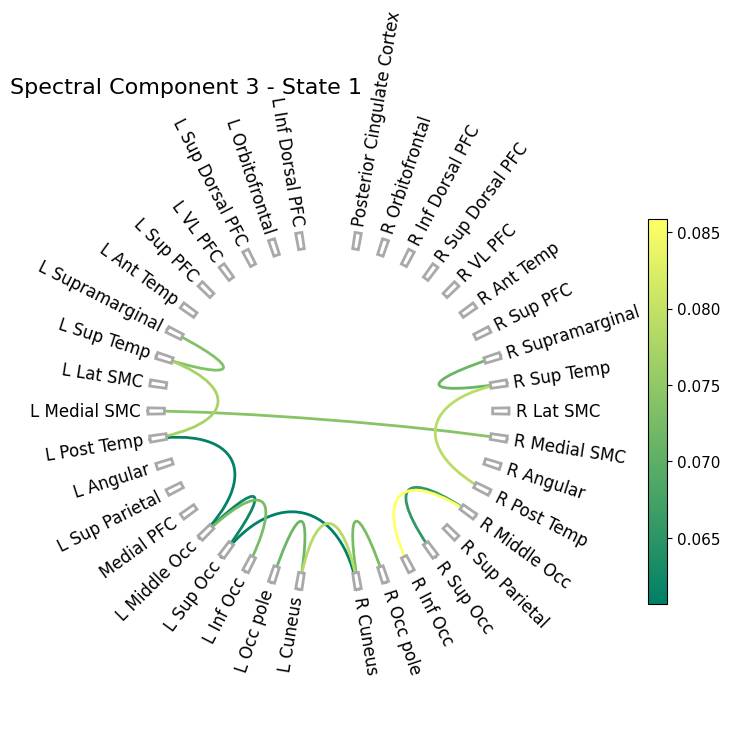

In [278]:
connectivity_6states_SC3 = thres_mean_c[2]
connectivity_6states_SC3_S1 = connectivity_6states_SC3[0]

sc=2
title = 'Spectral Component 3 - State 1                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S1, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

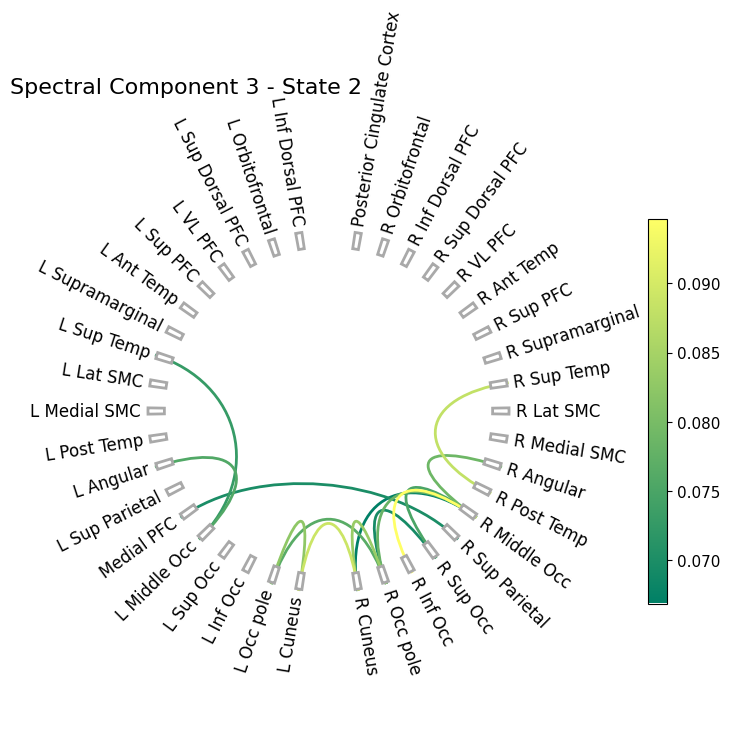

In [279]:
connectivity_6states_SC3_S2 = connectivity_6states_SC3[1]

sc=2
title = 'Spectral Component 3 - State 2                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S2, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

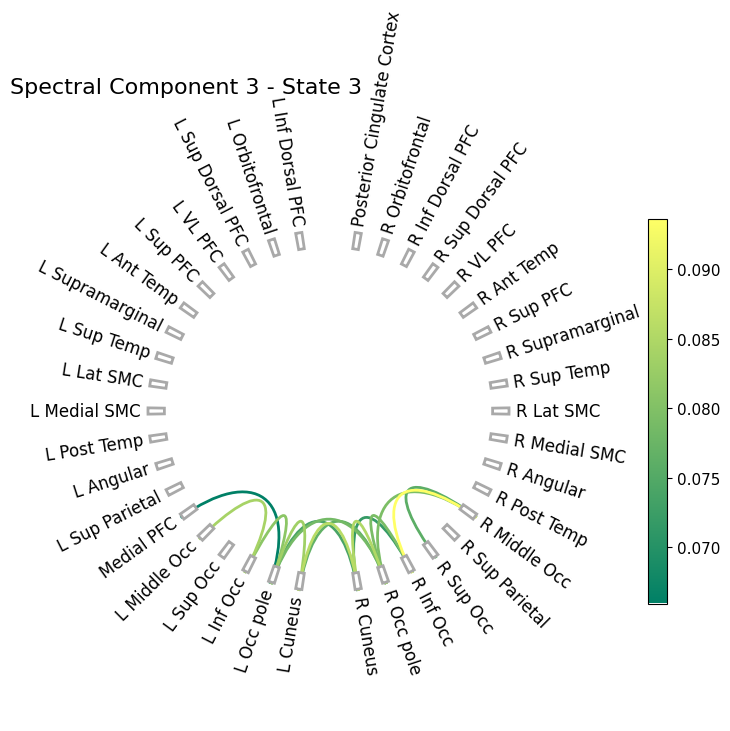

In [280]:
connectivity_6states_SC3_S3 = connectivity_6states_SC3[2]

sc=2
title = 'Spectral Component 3 - State 3                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S3, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

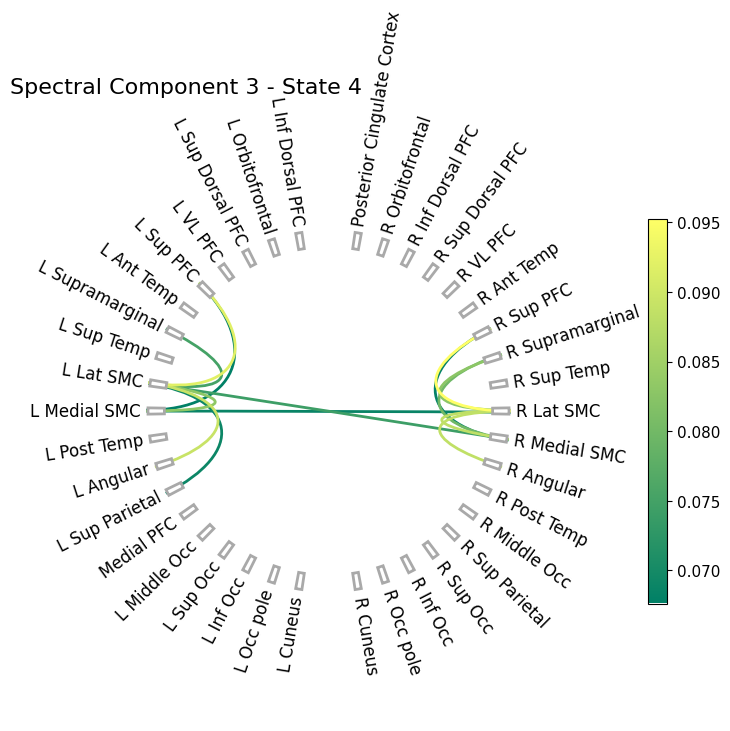

In [281]:
connectivity_6states_SC3_S4 = connectivity_6states_SC3[3]

sc=2
title = 'Spectral Component 3 - State 4                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S4, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

/home/olivierb/.local/lib/python3.9/site-packages/mne/viz/circle.py:289: RuntimeWarning: invalid value encountered in divide
  con_val_scaled = (con - vmin) / vrange


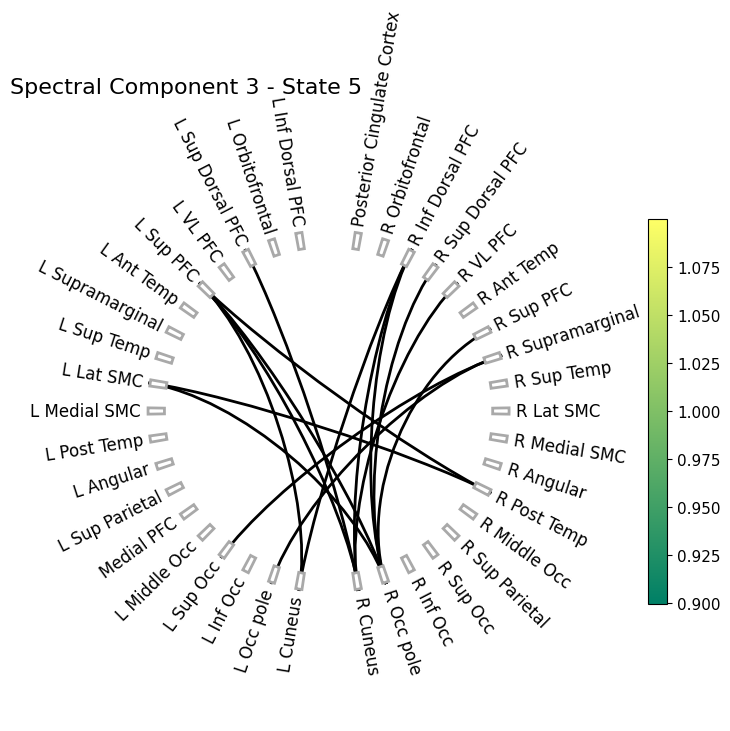

In [282]:
connectivity_6states_SC3_S5 = connectivity_6states_SC3[4]

sc=2
title = 'Spectral Component 3 - State 5                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S5, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

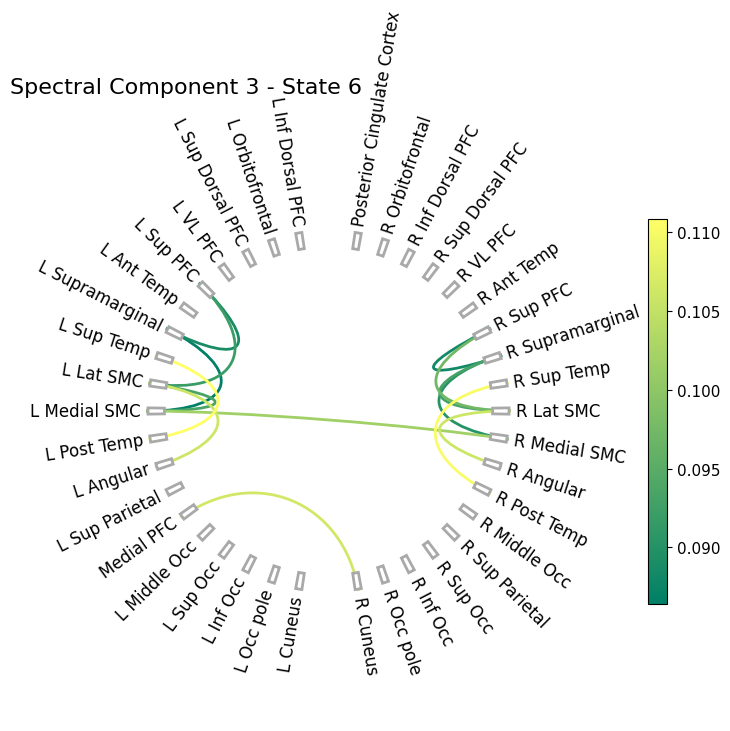

In [283]:
connectivity_6states_SC3_S6 = connectivity_6states_SC3[5]

sc=2
title = 'Spectral Component 3 - State 6                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S6, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

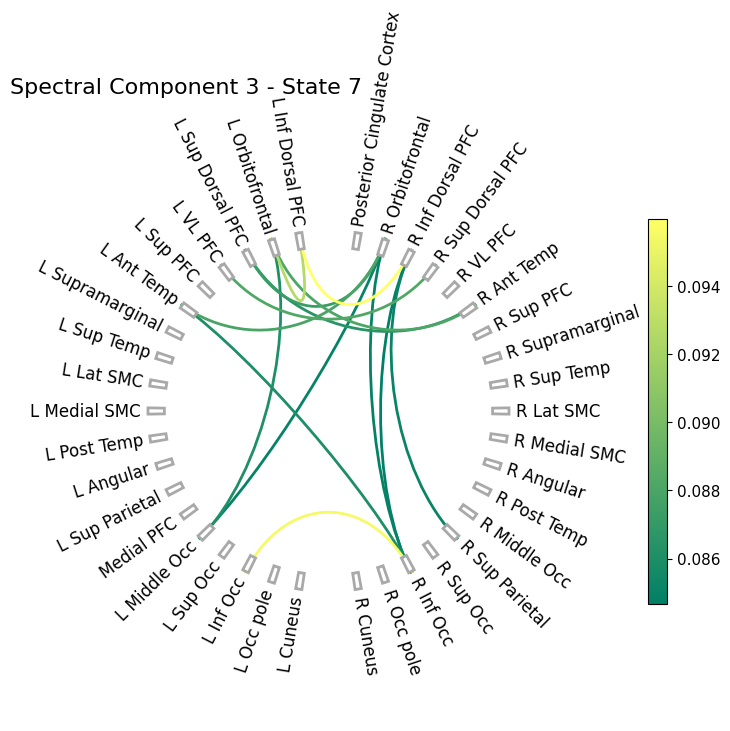

In [284]:
connectivity_6states_SC3_S7 = connectivity_6states_SC3[6]

sc=2
title = 'Spectral Component 3 - State 7                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S7, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

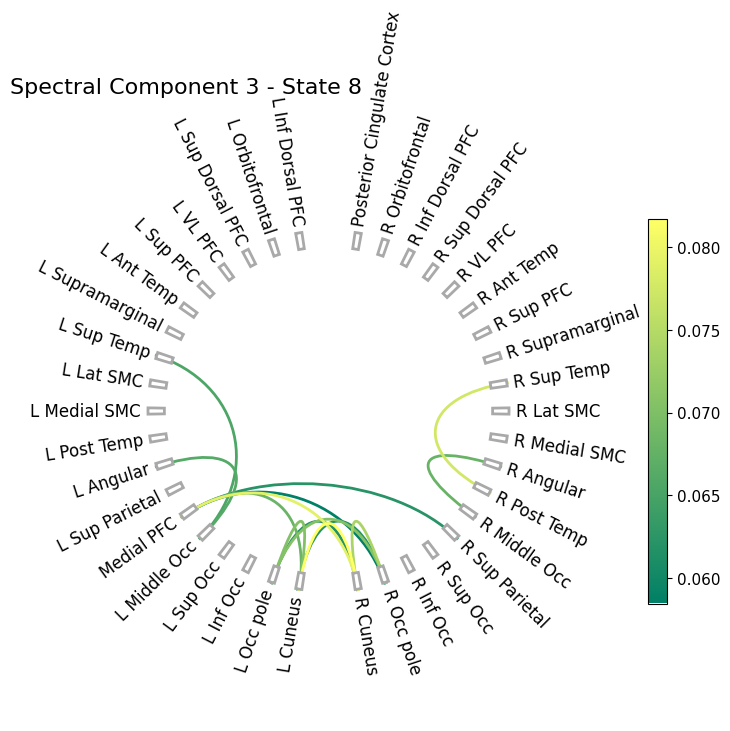

In [285]:
connectivity_6states_SC3_S8 = connectivity_6states_SC3[7]

sc=2
title = 'Spectral Component 3 - State 8                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S8, parcel_names=parcel_names, percentile=98, plot_type='threshold',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

## **Data-driven thresholding: Gaussian Mixture Model (GMM)**

In [286]:
mean_c = mean_c[:][:,np.array([True, True, True, True, False, True, True, True])]
print(np.shape(mean_c))

(4, 7, 38, 38)


/home/olivierb/osl-dynamics/osl_dynamics/utils/plotting.py:72: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(*args, **kwargs)


(4, 7, 38, 38)


Saving images: 100%|██████████| 7/7 [00:10<00:00,  1.53s/it]


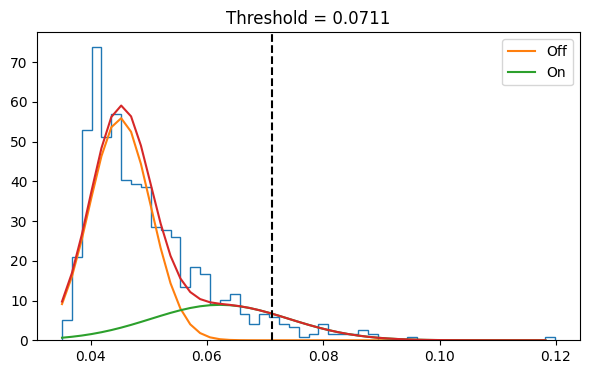

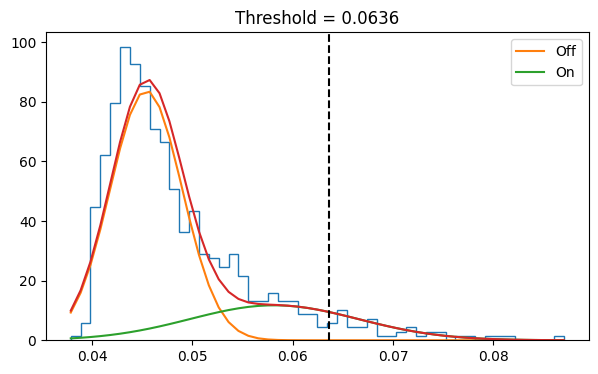

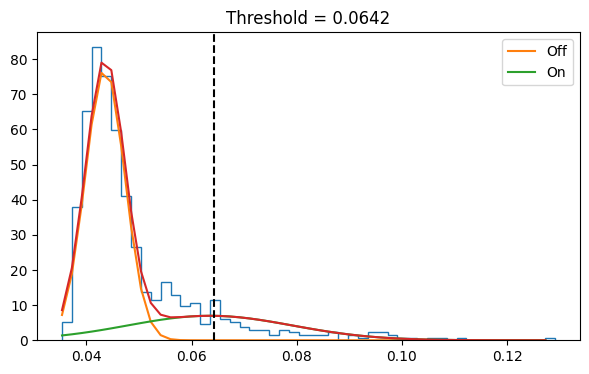

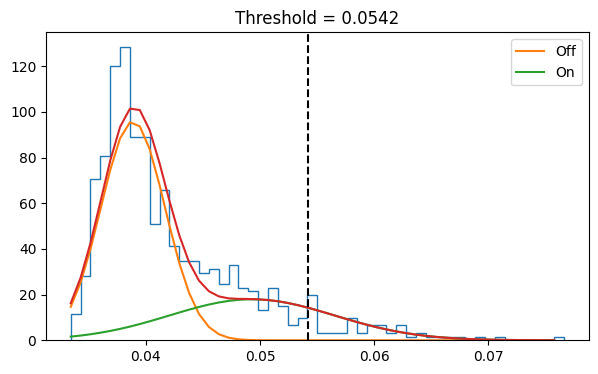

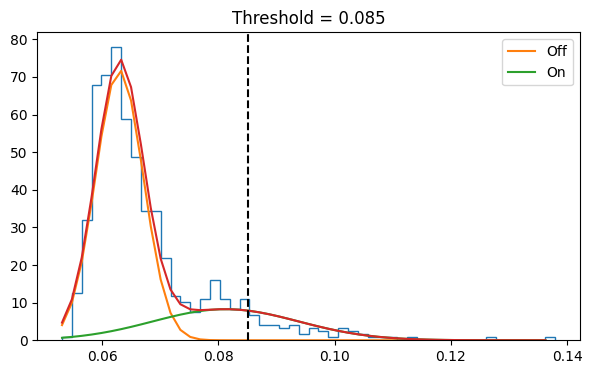

...

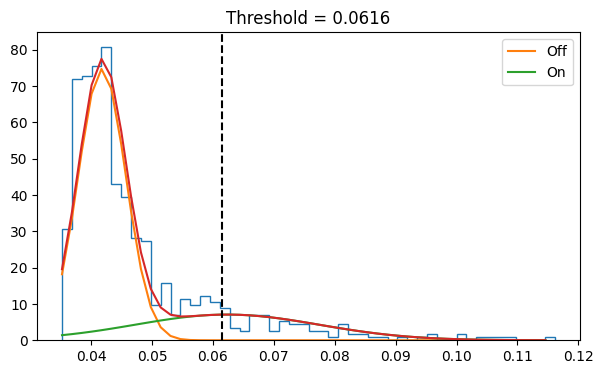

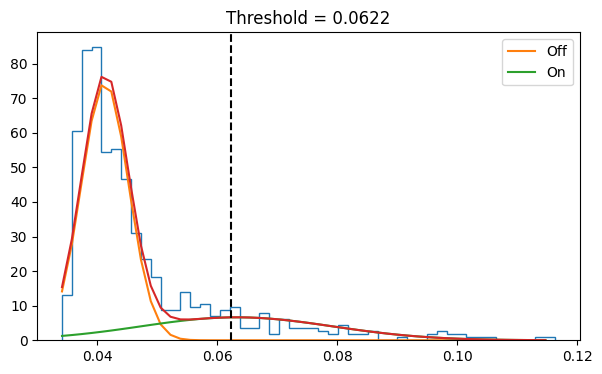

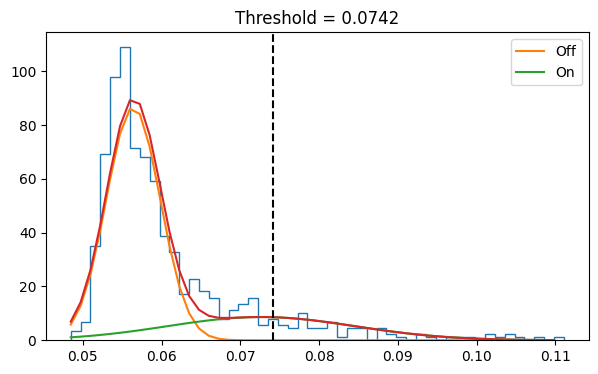

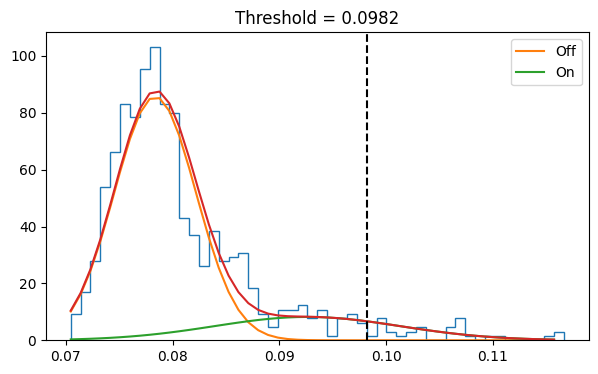

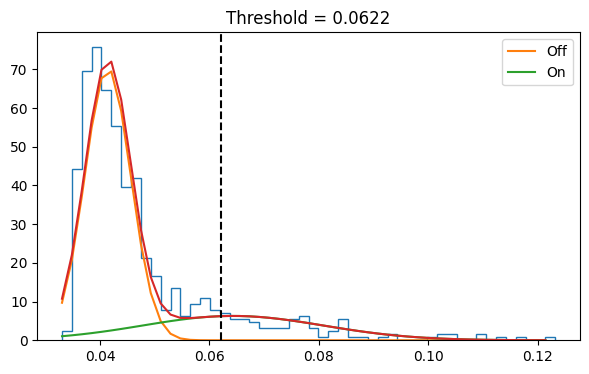

In [287]:
## This only needs to be ran once (it does the GMM data-driven thresholding for all SCs and all states together

sc = 2

# Threshold each network using a GMM
thres_mean_c = connectivity.gmm_threshold(
    mean_c,
    p_value=0.05,
    keep_positive_only=True,
    #subtract_mean=True,
    show=True,
)
print(thres_mean_c.shape)

os.makedirs(model_name + "/data/Images" + "/Basic_Coherence_GMM", exist_ok=True)

# Plot
connectivity.save(
    thres_mean_c,
    parcellation_file="/home/olivierb/38_parcels.nii",
    component=sc,
    filename=model_name + "/data/Images/Basic_Coherence_GMM/coh_Spectral_Comp_" + str(sc) + "_State_.png",
)

### **Spectral component 2**

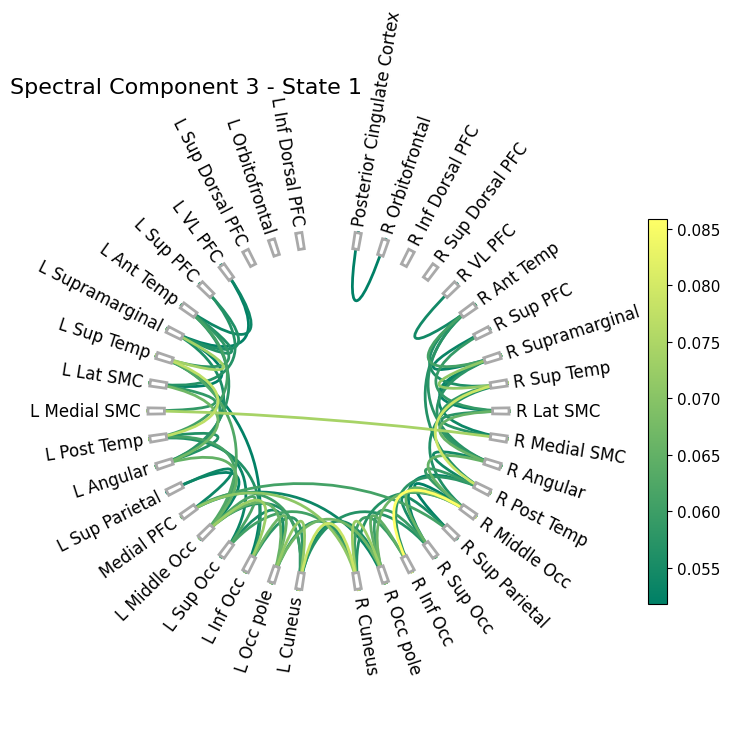

In [288]:
connectivity_6states_SC3_S1 = thres_mean_c[2][0]  # comp 3 state 1

sc=2
title = 'Spectral Component 3 - State 1                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S1, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

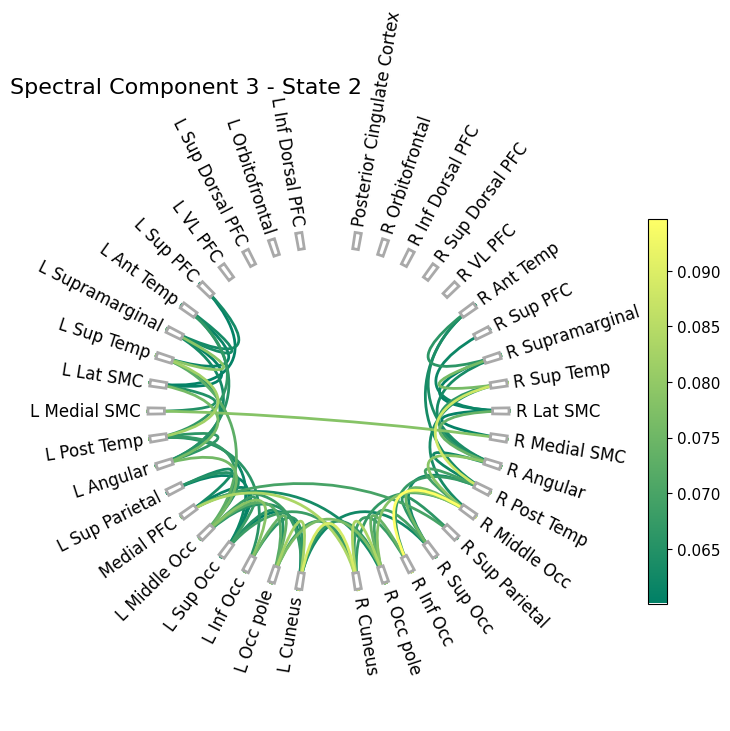

In [289]:
connectivity_6states_SC3_S2 = thres_mean_c[2][1]  # comp 3 state 2

sc=2
title = 'Spectral Component 3 - State 2                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S2, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

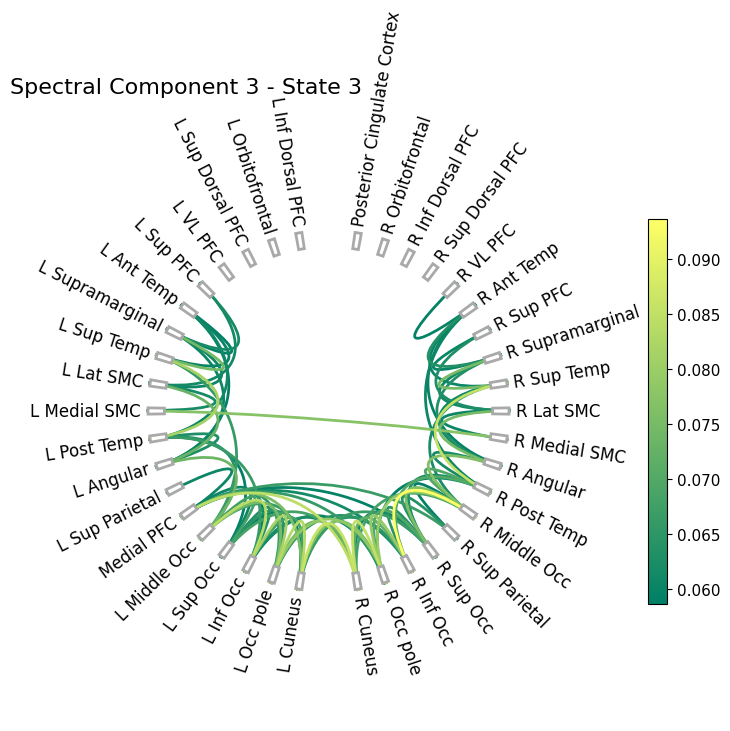

In [290]:
connectivity_6states_SC3_S3 = thres_mean_c[2][2]  # comp 3 state 3

sc=2
title = 'Spectral Component 3 - State 3                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S3, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

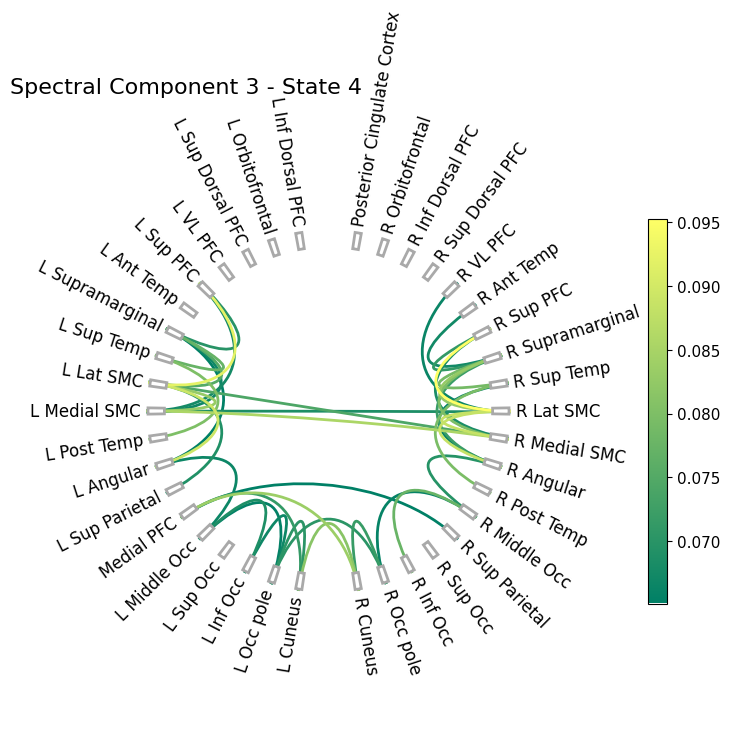

In [291]:
connectivity_6states_SC3_S4 = thres_mean_c[2][3]  # comp 3 state 4

sc=2
title = 'Spectral Component 3 - State 4                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S4, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

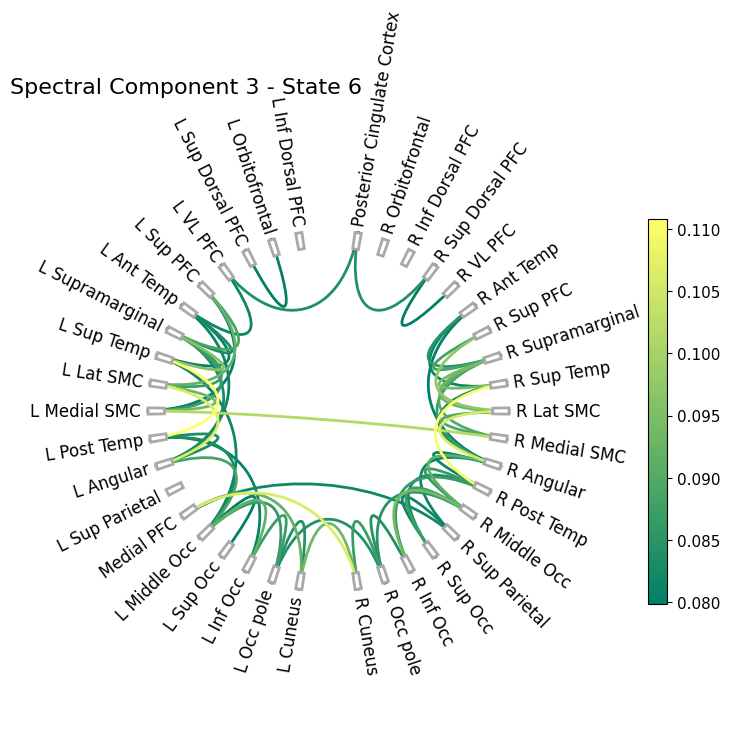

In [292]:
connectivity_6states_SC3_S6 = thres_mean_c[2][4]  # comp 3 state 6

sc=2
title = 'Spectral Component 3 - State 6                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S6, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

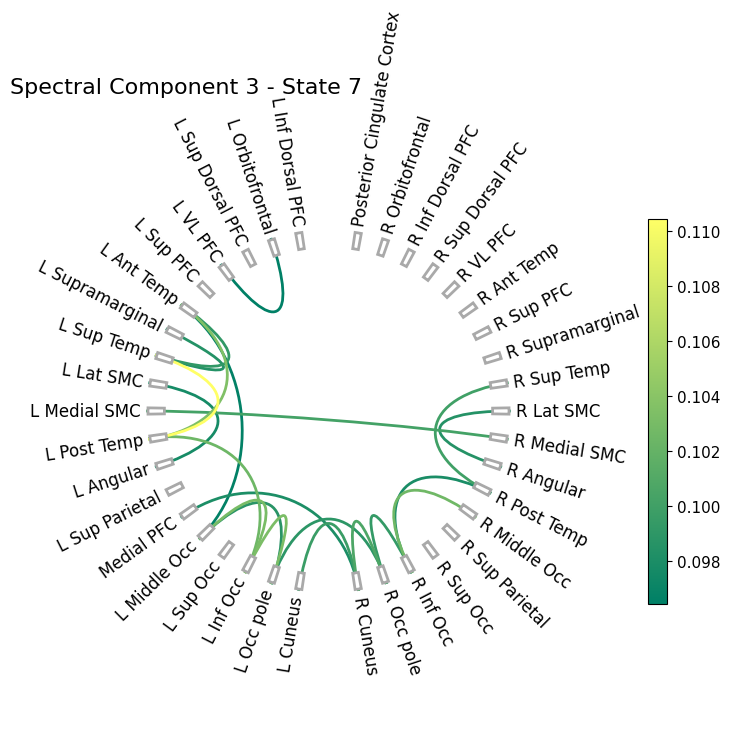

In [293]:
connectivity_6states_SC3_S7 = thres_mean_c[2][5]  # comp 3 state 7

sc=2
title = 'Spectral Component 3 - State 7                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S7, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)

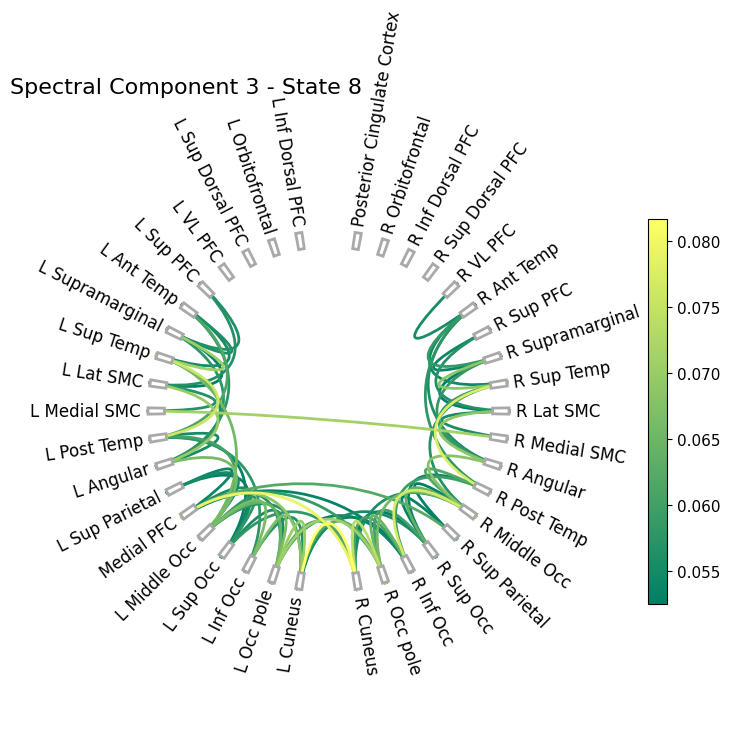

In [294]:
connectivity_6states_SC3_S8 = thres_mean_c[2][6]  # comp 3 state 8

sc=2
title = 'Spectral Component 3 - State 8                                        '
img_name = 'Spectral_Comp_' + str(sc+1) +'_State_.png'
plot_spatial_map_connectivity(connectivity_matrix=connectivity_6states_SC3_S8, parcel_names=parcel_names, percentile=98, plot_type='GMM',
                              title=title, image_name=img_name, network=True, color='summer', y=y)